In [ ]:
# in this notebook, I will try to fit a model relating the mean behavior of L4, L2/3, SST and VIP cells

In [ ]:
# load the data

In [1]:
import pyute as ut
import autograd.numpy as np
import matplotlib.pyplot as plt
import sklearn
import h5py
import pdb
import scipy.optimize as sop
from mpl_toolkits.mplot3d import Axes3D
import sklearn.discriminant_analysis as skd
import autograd.scipy.special as ssp
from autograd import elementwise_grad as egrad
from autograd import grad
from autograd import jacobian
from autograd import hessian
import size_contrast_analysis as sca
import scipy.stats as sst
import sim_utils
from importlib import reload
reload(sim_utils)
import calnet.utils
import calnet.fitting_spatial_feature_opto
import opto_utils
import glob
import scipy.signal as ssi
import calnet.calnet as cc
import calnet.dynamics as dyn
%matplotlib notebook

/Users/dan/Documents/code/downloads/OASIS/oasis/functions.py:14: UserWarning: Could not find cvxpy. Don't worry, you can still use OASIS, just not the slower interior point methods we compared to in the papers.
  "just not the slower interior point methods we compared to in the papers.")


In [2]:
npfile = np.load('rs_vm_denoise_200605.npy',allow_pickle=True)[()]#,{'rs':rs,'rs_denoise':rs_denoise},allow_pickle=True)
rs = npfile['rs']
rs_denoise = npfile['rs_denoise']

<IPython.core.display.Javascript object>


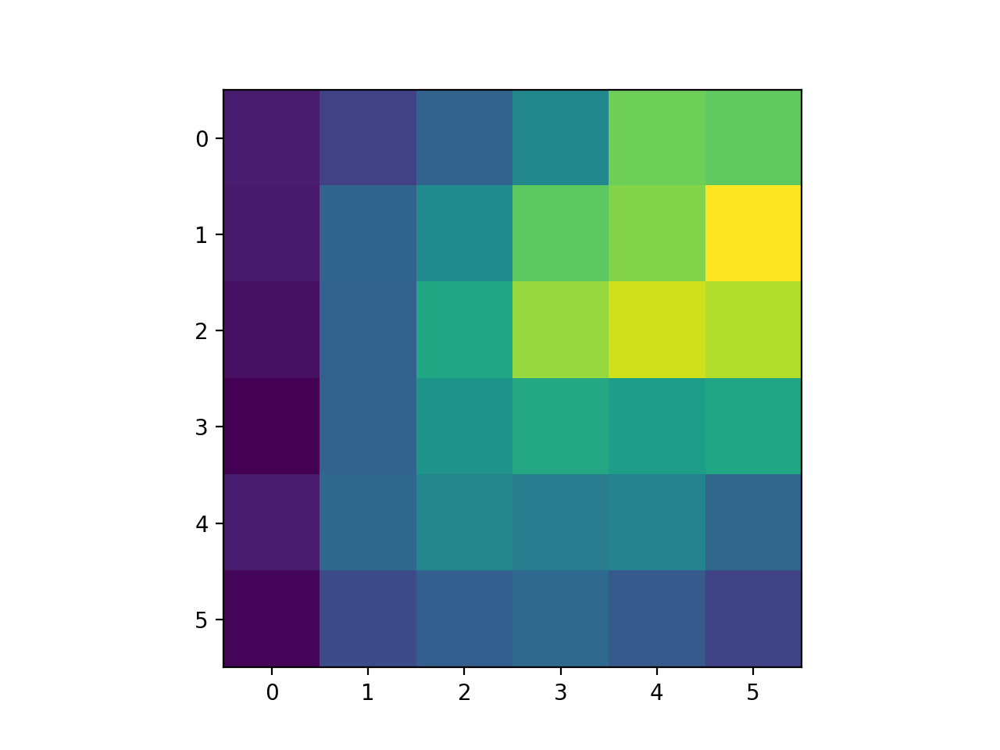

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/autograd/tracer.py:48: RuntimeWarning: Mean of empty slice
  return f_raw(*args, **kwargs)


In [3]:
plt.figure()
icelltype = 0
plt.imshow(np.nanmean(np.nanmean(rs[icelltype][0],-1),0))

In [4]:
nsize,ncontrast,ndir = 6,6,8
ori_dirs = [[0,1,2,3,4,5,6,7]]#[[0,4],[2,6]] #[[0,4],[1,3,5,7],[2,6]]
nT = len(ori_dirs)
nS = len(rs_denoise[0])

def sum_to_1(r):
    R = r.reshape((r.shape[0],-1))
    R = R/np.nansum(R[:,~np.isnan(R.sum(0))],axis=1)[:,np.newaxis]
    return R

def norm_to_mean(r):
    R = r.reshape((r.shape[0],-1))
    R = R/np.nanmean(R[:,~np.isnan(R.sum(0))],axis=1)[:,np.newaxis]
    return R

Rs = [[None,None] for i in range(len(rs))]
Rso = [[[None for iT in range(nT)] for iS in range(nS)] for icelltype in range(len(rs))]
rso = [[[None for iT in range(nT)] for iS in range(nS)] for icelltype in range(len(rs))]

for iR,r in enumerate(rs):#_denoise):
    print(iR)
    for ialign in range(nS):
        Rs[iR][ialign] = sum_to_1(r[ialign][:,:nsize,:])
#         Rs[iR][ialign] = von_mises_denoise(Rs[iR][ialign].reshape((-1,nsize,ncontrast,ndir)))

kernel = np.ones((1,2,2))
kernel = kernel/kernel.sum()

for iR,r in enumerate(rs):
    for ialign in range(nS):
        for iori in range(nT):
            Rso[iR][ialign][iori] = np.nanmean(Rs[iR][ialign].reshape((-1,nsize,ncontrast,ndir))[:,:,:,ori_dirs[iori]],-1)
            Rso[iR][ialign][iori][:,:,0] = np.nanmean(Rso[iR][ialign][iori][:,:,0],1)[:,np.newaxis]
            Rso[iR][ialign][iori][:,1:,1:] = ssi.convolve(Rso[iR][ialign][iori],kernel,'valid')
            Rso[iR][ialign][iori] = Rso[iR][ialign][iori].reshape(Rso[iR][ialign][iori].shape[0],-1)

0
1
2
3
4


In [37]:
nS = 2
nT = 1
ndims = 5
ncelltypes = 5
Yhat = [[None for iT in range(nT)] for iS in range(nS)]
Xhat = [[None for iT in range(nT)] for iS in range(nS)]
Ypc_list = [[None for iT in range(nT)] for iS in range(nS)]
Xpc_list = [[None for iT in range(nT)] for iS in range(nS)]
for iS in range(nS):
    mx = np.zeros((ncelltypes,))
    yy = [None for icelltype in range(ncelltypes)]
    for icelltype in range(ncelltypes):
        yy[icelltype] = np.nanmean(Rso[icelltype][iS][0],0)
        mx[icelltype] = np.nanmax(yy[icelltype])
    for iT in range(nT):
        y = [np.nanmean(Rso[icelltype][iS][iT]/mx[icelltype],axis=0)[:,np.newaxis] for icelltype in range(1,ncelltypes)]#
        Ypc_list[iS][iT] = [None for icelltype in range(1,ncelltypes)]
        for icelltype in range(1,ncelltypes):
            print((icelltype,iS,iT))
            rss = Rso[icelltype][iS][iT].copy() #.reshape(Rs[icelltype][ialign].shape[0],-1)
            rss = rss[np.isnan(rss).sum(1)==0]
    #         print(rss.max())
    #         rss[rss<0] = 0
    #         rss = rss[np.random.randn(rss.shape[0])>0]
            try:
                u,s,v = np.linalg.svd(rss-np.mean(rss,0)[np.newaxis])
                Ypc_list[iS][iT][icelltype-1] = [(s[idim],v[idim]) for idim in range(ndims)]
#                 print('yep on Y')
#                 print(np.min(np.sum(rs[icelltype][iS][iT],axis=1)))
            except:
#                 print('nope on Y')
                print(np.mean(np.isnan(rss)))
                print(np.min(np.sum(rs[icelltype][iS][iT],axis=1)))
        Yhat[iS][iT] = np.concatenate(y,axis=1)
#         x = sim_utils.columnize(Rso[0][iS][iT])[:,np.newaxis]
        icelltype = 0
        x = np.nanmean(Rso[icelltype][iS][iT]/mx[icelltype],0)[:,np.newaxis]#/mx[icelltype]
#         opto_column = np.concatenate((np.zeros((nN,)),np.zeros((nNO/2,)),np.ones((nNO/2,))),axis=0)[:,np.newaxis]
        Xhat[iS][iT] = np.concatenate((x,np.ones_like(x)),axis=1)
#         Xhat[iS][iT] = np.concatenate((x,np.ones_like(x),opto_column),axis=1)
        icelltype = 0
        rss = Rso[icelltype][iS][iT].copy()
        rss = rss[np.isnan(rss).sum(1)==0]
#         try:
        u,s,v = np.linalg.svd(rss-rss.mean(0)[np.newaxis])
        Xpc_list[iS][iT] = [None for iinput in range(2)]
        Xpc_list[iS][iT][0] = [(s[idim],v[idim]) for idim in range(ndims)]
        Xpc_list[iS][iT][1] = [(0,np.zeros((Xhat[0][0].shape[0],))) for idim in range(ndims)]
#         except:
#             print('nope on X')
#             print(np.mean(np.isnan(rss)))
#             print(np.min(np.sum(Rso[icelltype][iS][iT],axis=1)))
nN,nP = Xhat[0][0].shape
nQ = Yhat[0][0].shape[1]

(1, 0, 0)
(2, 0, 0)
(3, 0, 0)
(4, 0, 0)
(1, 1, 0)
(2, 1, 0)
(3, 1, 0)
(4, 1, 0)


In [5]:
def compute_f_(Eta,Xi,s02):
    return sim_utils.f_miller_troyer(Eta,Xi**2+np.concatenate([s02 for ipixel in range(nS*nT)]))

def compute_fprime_m_(Eta,Xi,s02):
    return sim_utils.fprime_miller_troyer(Eta,Xi**2+np.concatenate([s02 for ipixel in range(nS*nT)]))*Xi

def compute_fprime_s_(Eta,Xi,s02):
    s2 = Xi**2+np.concatenate((s02,s02),axis=0)
    return sim_utils.fprime_s_miller_troyer(Eta,s2)*(Xi/s2)

def sorted_r_eigs(w):
    drW,prW = np.linalg.eig(w)
    srtinds = np.argsort(drW)
    return drW[srtinds],prW[:,srtinds]

# def gen_Weight(W,K,kappa):
#     WW0 = np.concatenate((W,W*K[np.newaxis,:]),axis=1)
#     WW1 = np.concatenate((W*K[np.newaxis,:]*kappa,W),axis=1)
#     WW = np.concatenate((WW0,WW1),axis=0)
#     return WW

def u_fn(XX,YY,Wx,Wy,k,kappa):
    WWx,WWy = [gen_Weight(W,k,kappa) for W in [Wx,Wy]]
    return u_fn_WW(XX,YY,WWx,WWy)# XX @ WWx + YY @ WWy

def u_fn_WW(XX,YY,WWx,WWy):
    return XX @ WWx + YY @ WWy

def compute_steady_state(Wlist,Niter=int(4e2),max_val=2.5,Ny=50,fix_dim=None,stim_vals=None,dt=1e-2,perturbation_size=5e-2):
    Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wlist
    nQ = Wmy.shape[0]
    nN = Eta.shape[0]
    nS = int(Eta.shape[1]/nQ)
    
    if fix_dim is None:
        fix_dim = [None]
        Nfix = 1
        yvals = (0,)
        Ny = 1
        max_val = 0
    else:
        Nfix = len(fix_dim)
        yvals = np.linspace(0,max_val,Ny)
    
    if stim_vals is None:
        stim_vals = np.arange(nN)
    Nstim = len(stim_vals)
    
    fval = compute_f_(Eta,Xi,s02)
    resEta = Eta - u_fn(XX,fval,Wmx,Wmy,k,kappa)
    resXi = Xi - u_fn(XX,fval,Wsx,Wsy,k,kappa)
    
    def fY(XX,YY):
        return compute_f_(resEta[stim_val]+u_fn(XX,YY,Wmx,Wmy,k,kappa),resXi[stim_val]+u_fn(XX,YY,Wsx,Wsy,k,kappa),s02)
    def predict_YY_fix_dim(XX,YY0,fix_dim=None,run_backward=False,):
        def dYYdt(YY):
            return -YY + fY(XX,YY)
        YY = np.zeros((Niter+1,nS*nQ))
        YY[0] = YY0 #np.zeros((nN,nS*nQ))
        dYY = np.zeros_like(YY[0])
        iiter = 0
        while iiter < Niter: #np.abs(dYY).sum()>1e-8*np.abs(YY).sum():
            dYY = dt*dYYdt(YY[iiter])
            if not fix_dim is None:
                dYY[fix_dim] = 0
            if run_backward:
                dYY = -dYY
            YY[iiter+1] = YY[iiter] + dYY
            iiter = iiter+1
        return YY
    
    YY_ss = np.zeros((Nfix,Nstim,Ny,Niter+1,nS*nQ))
    YY0 = compute_f_(Eta,Xi,s02)
    for istim,stim_val in enumerate(stim_vals): #range(nN):
        print(istim)
        for iy,yval in enumerate(yvals):
            for ifix in range(Nfix):
                yy0 = YY0[stim_val] + perturbation_size*np.random.randn(*(YY0[stim_val].shape))
                if not fix_dim[ifix] is None:
                    yy0[fix_dim[ifix]] = yval
                YY_ss[ifix,istim,iy] = predict_YY_fix_dim(XX[stim_val],yy0,fix_dim=fix_dim[ifix])
    if fix_dim[0] is None:
        YY_ss = YY_ss[0,:,0,:,:]
    return YY_ss

In [6]:
npyfile = np.load('/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/vip_halo_data_for_sim_vip_full_info.npy',allow_pickle=True)[()]
Yhat_opto = npyfile['Yhat_opto']

In [7]:
Yhat_opto.shape

(72, 16)

<IPython.core.display.Javascript object>


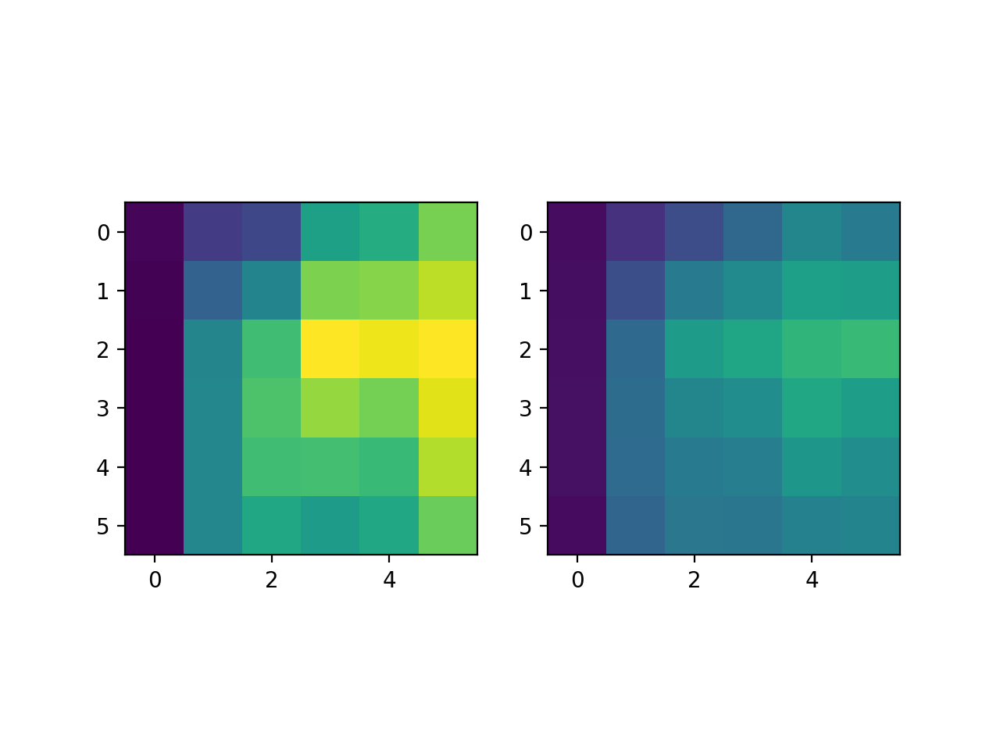

<IPython.core.display.Javascript object>


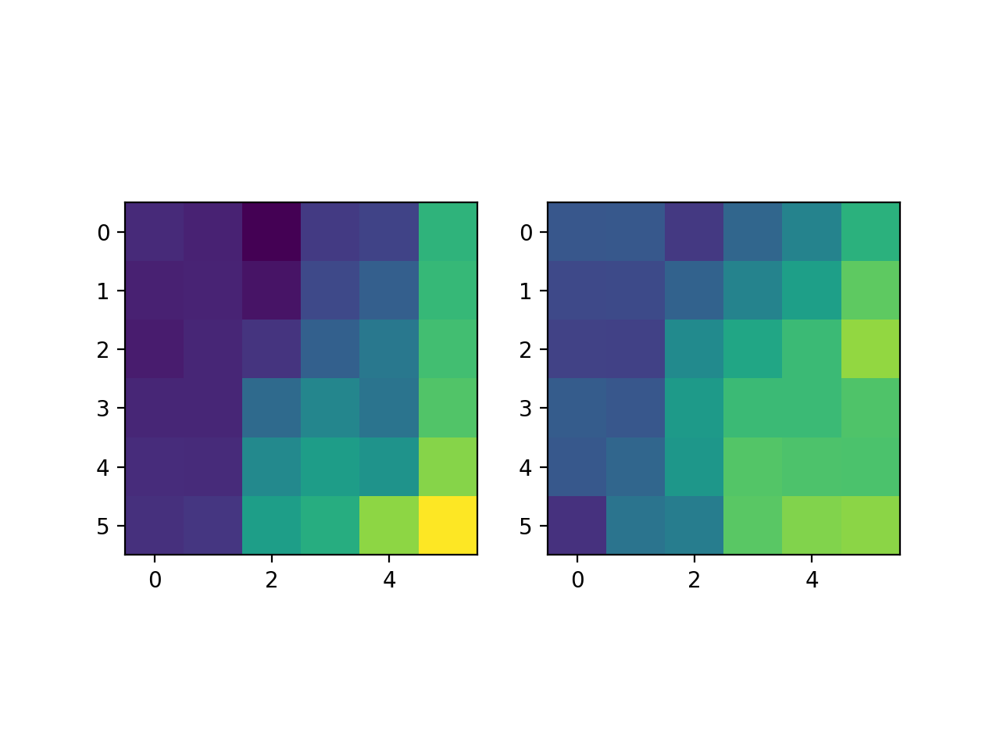

<IPython.core.display.Javascript object>


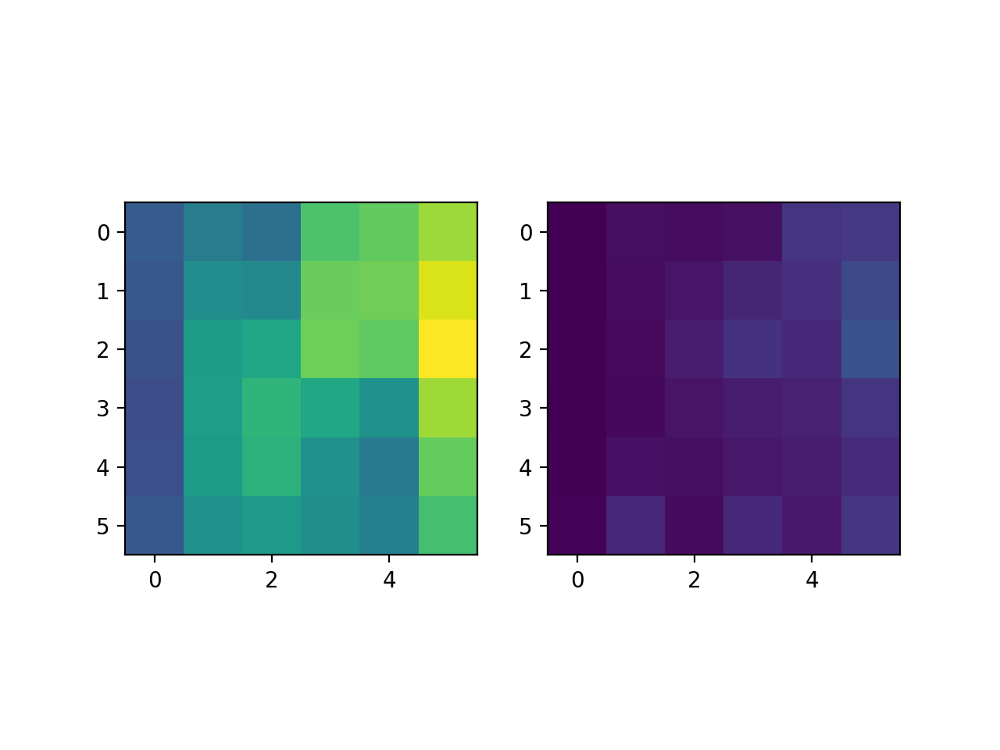

<IPython.core.display.Javascript object>


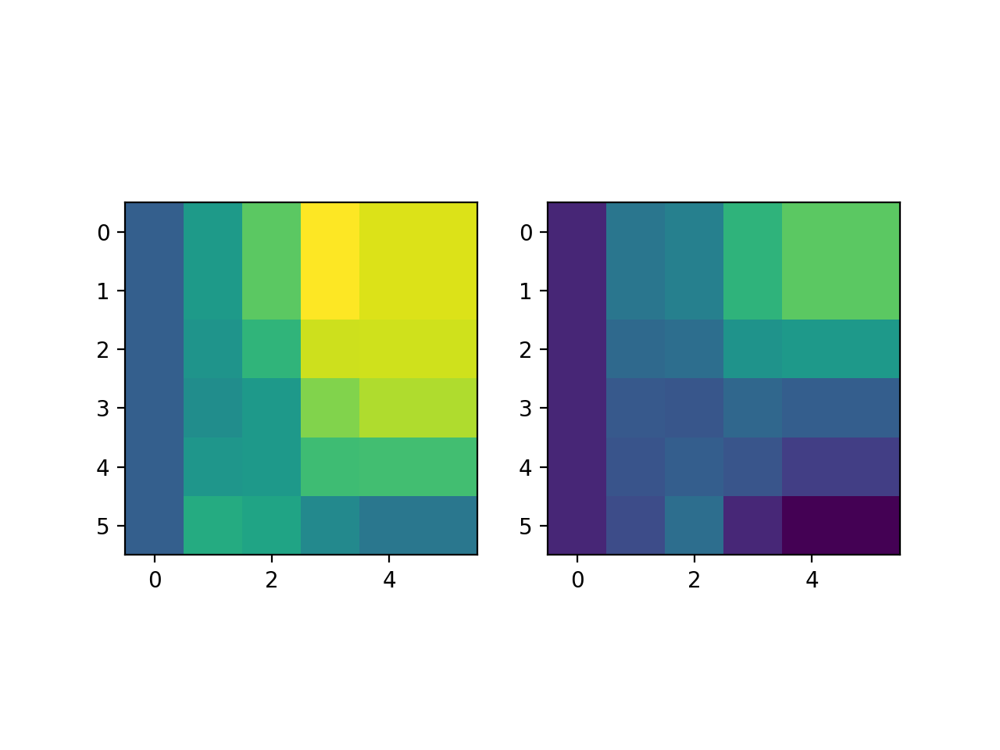

In [8]:
for itype in range(4):
    data = Yhat_opto.reshape((6,6,2,16))[:,:,:,itype]
    plt.figure()
    for ilight in range(2):
        plt.subplot(1,2,ilight+1)
        plt.imshow(data[:,:,ilight],vmin=data.min(),vmax=data.max())

In [10]:
weights_files = glob.glob('/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_200714c/*.npy')
weights_files.sort()

In [9]:
plt.close('all')
Wmys = np.zeros((len(weights_files),nQ,nQ))
for iwt,weights_file in enumerate(weights_files):
    Wstar_dict = np.load(weights_file,allow_pickle=True)[()]
    Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h = Wstar_dict['as_list']
    Wmys[iwt] = Wmy

    YY = compute_f_(Eta,Xi,s02)

    plt.figure(figsize=(4,2))
    ntypes = 4
    for itype in range(ntypes):
        plt.subplot(2,ntypes,itype+1)
        sca.show_size_contrast(YY[:,itype].reshape((6,6)),flipud=True)
        plt.axis('off')
        plt.subplot(2,ntypes,ntypes+itype+1)
        sca.show_size_contrast(YY[:,itype+8].reshape((6,6)),flipud=True)
        plt.axis('off')

NameError: name 'weights_files' is not defined

In [10]:
Wstar_dict['wt_dict']

NameError: name 'Wstar_dict' is not defined

<IPython.core.display.Javascript object>


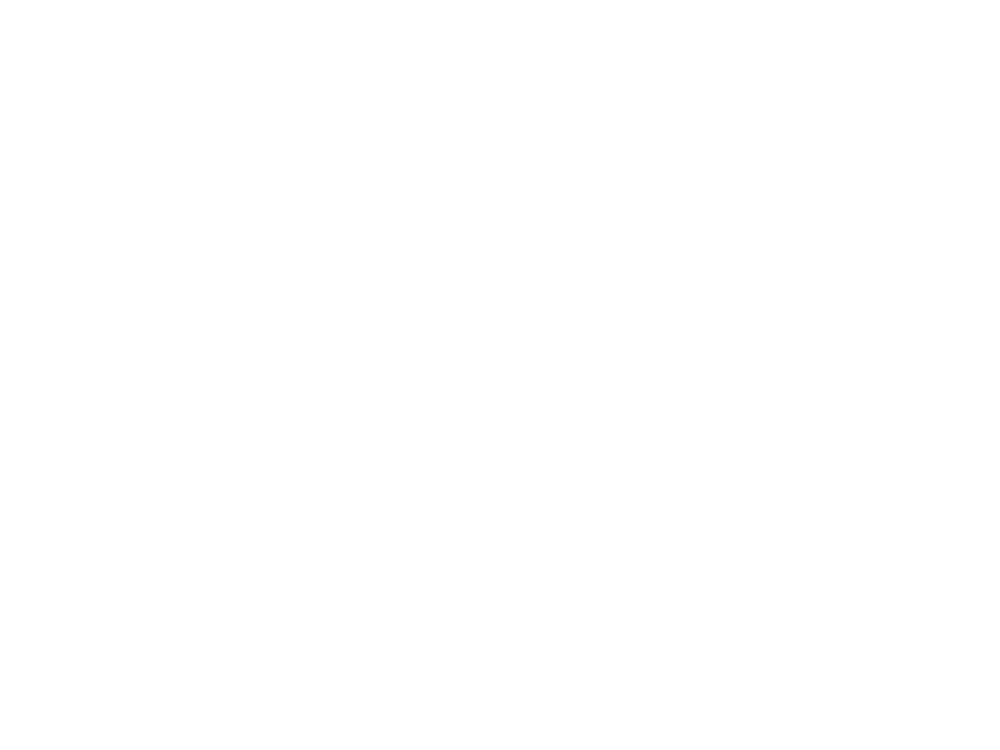

NameError: name 'YY' is not defined

In [11]:
plt.figure()
plt.imshow(YY[:,0].reshape((6,6)))
plt.colorbar()

In [ ]:
plt.figure()
for iwt in range(10):
    plt.subplot(2,5,iwt+1)
    plt.imshow(Wmys[iwt],vmin=Wmys.min(),vmax=Wmys.max())
plt.colorbar()

In [12]:
WWmy = calnet.utils.gen_Weight_k_kappa_t(Wmy,K,kappa,T)
plt.figure()
plt.imshow(WWmy)

NameError: name 'Wmy' is not defined

In [13]:
import calnet.fitting_spatial_feature_opto_nonlinear
YYhat = calnet.fitting_spatial_feature_opto_nonlinear.flatten_nested_list_of_2d_arrays(Yhat)
XXhat = calnet.fitting_spatial_feature_opto_nonlinear.flatten_nested_list_of_2d_arrays(Xhat)

AttributeError: module 'calnet.fitting_spatial_feature_opto_nonlinear' has no attribute 'flatten_nested_list_of_2d_arrays'

In [14]:
# def invert_f_mt(y):
#     xstar = np.zeros_like(y)
#     for iy,yy in enumerate(y):
#         to_invert = lambda x: sim_utils.f_miller_troyer(x,1)-yy
#         xstar[iy] = sop.root_scalar(to_invert,x0=yy,x1=0).root
#     return xstar

In [15]:
# ninputs = 2
# Wmy0 = np.zeros((ntypes,ntypes))
# Ymatrix_pred = np.zeros((nN,ntypes))
# Ymatrix = np.zeros((nN,ntypes))
# for itype in range(ntypes):
#     Ymatrix[:,itype] = invert_f_mt(YYhat[:,itype])
#     others = np.setdiff1d(np.arange(ntypes),itype)
#     Xmatrix = np.concatenate((XXhat[:,:ninputs],YYhat[:,others]),axis=1)
#     Bmatrix = np.linalg.pinv(Xmatrix) @ Ymatrix[:,itype]
#     Wmy0[others,itype] = Bmatrix[-ntypes+1:]
#     Ymatrix_pred[:,itype] = Xmatrix @ Bmatrix

In [16]:
# plt.figure()
# plt.imshow(Wmy0)
# plt.colorbar()

In [17]:
# plt.figure()
# for itype in range(4):
#     plt.scatter(Ymatrix[:,itype],Ymatrix_pred[:,itype])

In [18]:
Ymatrix.shape

NameError: name 'Ymatrix' is not defined

In [19]:
sim_utils.f_miller_troyer(0.8995,1)

1.0000232004149898

<IPython.core.display.Javascript object>


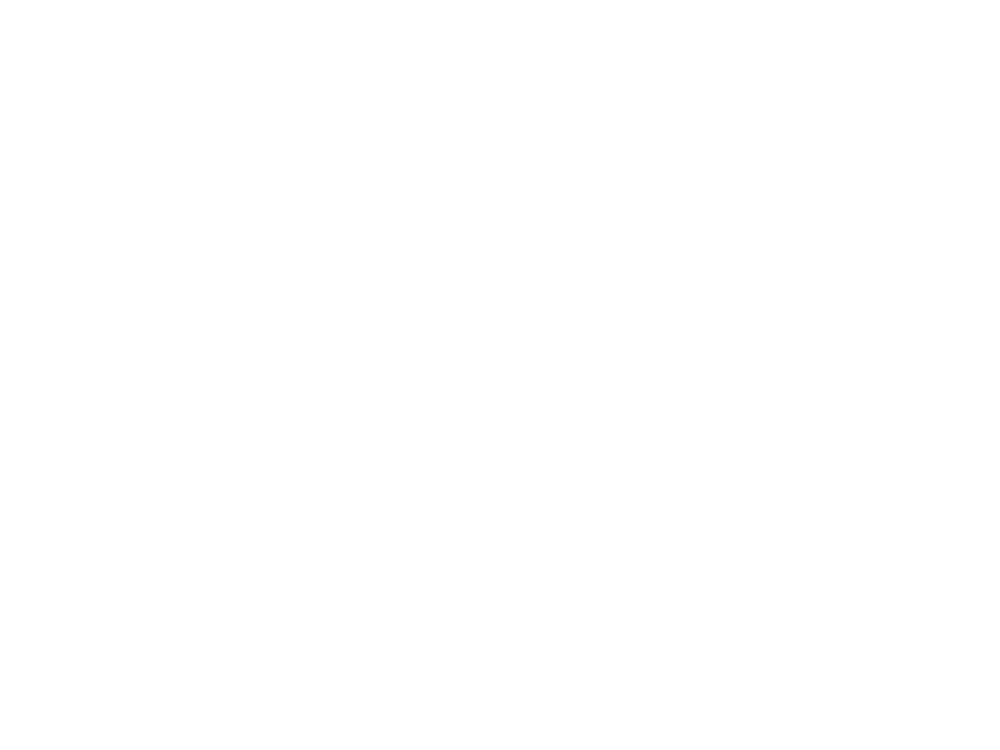

NameError: name 'YYhat' is not defined

In [20]:
plt.figure()
sca.scatter_size_contrast(YYhat[:,2].reshape((6,6)),YYhat[:,1].reshape((6,6)),equate_0=True)

In [12]:
    def gen_Weight(W,K,kappa,T):
#         MuT = np.array((1,2,1))
#         MuK = np.array((1,kappa))
#         WT = circulate(W,T,nT,Mu=MuT)
#         KKlist = [K for iT in range(nT)]
#         KK = np.concatenate(KKlist,axis=0)
#         WW = circulate(WT,KK,nS,Mu=MuK)
#         return WW
        return calnet.utils.gen_Weight_k_kappa_t(W,K,kappa,T,nS=nS,nT=nT)


In [21]:
#     def circulate(V,M,nZ,Mu=None):
#         Vpartlist = [V*(M[np.newaxis,:]**np.abs(iZ)) for iZ in range(-nZ+1,nZ)]
#         if Mu is None:
#             Mu = np.ones((nZ,))
#         #VVlist = [np.concatenate([m*v for m,v in zip(Mu,Vpartlist[nZ-iZ-1:2*nZ-iZ-1])],axis=1) for iZ in range(nZ)]
#         VVlist = [np.concatenate(Vpartlist[nZ-iZ-1:2*nZ-iZ-1],axis=1) for iZ in range(nZ)]
#         #VV = np.concatenate(VVlist,axis=0)
#         VV = np.concatenate([m*v for m,v in zip(Mu,VVlist)],axis=0)
#         return VV

In [22]:
    calnet_data_fold = '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/'
    ca_data_file = calnet_data_fold+'rs_200828.npy'
    opto_silencing_data_file = calnet_data_fold+'vip_halo_data_for_sim_vip_full_info.npy'
    opto_activation_data_file = calnet_data_fold+'vip_chrimson_data_for_sim.npy'
    
    opto_dict = np.load(opto_silencing_data_file,allow_pickle=True)[()]

    Yhat_opto = opto_dict['Yhat_opto']
    Yhat_opto = np.nanmean(np.reshape(Yhat_opto,(nN,2,nS,2,nQ)),3).reshape((nN*2,-1))
    Yhat_opto = Yhat_opto/Yhat_opto[0::2].max(0)[np.newaxis,:]
    print(Yhat_opto.shape)
    h_opto = opto_dict['h_opto']
    dYY1 = Yhat_opto[1::2]-Yhat_opto[0::2]
    for to_overwrite in [1,2]:
        dYY1[:,to_overwrite] = dYY1[:,to_overwrite+4]
    for to_overwrite in [7]:
        dYY1[:,to_overwrite] = dYY1[:,to_overwrite-4]
    YYhat_halo = Yhat_opto.reshape((36,2,-1))

    opto_dict = np.load(opto_activation_data_file,allow_pickle=True)[()]

    Yhat_opto = opto_dict['Yhat_opto']
    Yhat_opto = np.nanmean(np.reshape(Yhat_opto,(nN,2,nS,2,nQ)),3).reshape((nN*2,-1))
    Yhat_opto = Yhat_opto/Yhat_opto[0::2].max(0)[np.newaxis,:]
    print(Yhat_opto.shape)
    h_opto = opto_dict['h_opto']
    dYY2 = Yhat_opto[1::2]-Yhat_opto[0::2]
    YYhat_chrimson = Yhat_opto.reshape((36,2,-1))

NameError: name 'nN' is not defined

In [23]:
reload(calnet.utils)
YYhat_halo_sim = calnet.utils.simulate_opto_effect(YYhat,YYhat_halo)
YYhat_chrimson_sim = calnet.utils.simulate_opto_effect(YYhat,YYhat_chrimson)

NameError: name 'YYhat' is not defined

<IPython.core.display.Javascript object>


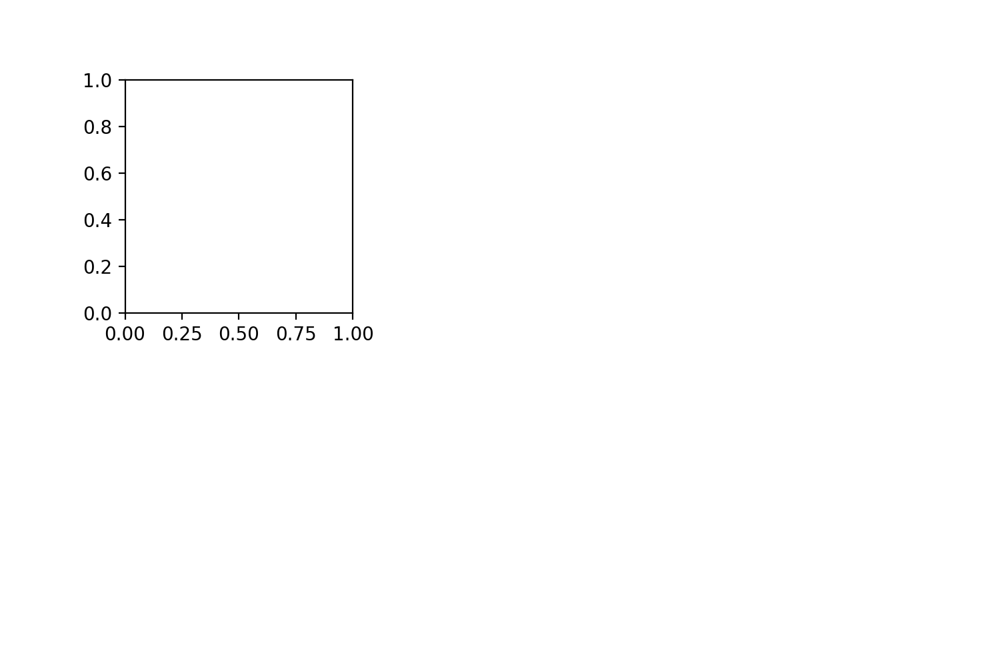

NameError: name 'YYhat' is not defined

In [24]:
itype = 0
lbls = ['pc','sst','vip','pv']
def this_scatter_size_contrast(xdata,ydata):
    if np.sum(np.isnan(xdata))==0 and np.sum(np.isnan(ydata))==0:
        sca.scatter_size_contrast(xdata,ydata,nsize=6,ncontrast=6,mn=0)
for itype in range(4):
    plt.figure(figsize=(7.5,5))
    plt.subplot(2,3,1)
    this_scatter_size_contrast(YYhat[:,itype],YYhat[:,itype]+dYY1[:,itype])
    plt.title('YYhat + dYY_halo')
    plt.subplot(2,3,2)
    this_scatter_size_contrast(YYhat_halo_sim[:,0,itype],YYhat_halo_sim[:,1,itype])
    plt.title('linearly transformed YYhat')
    plt.subplot(2,3,3)
    this_scatter_size_contrast(YYhat_halo[:,0,itype],YYhat_halo[:,1,itype])
    plt.title('YYhat_halo')
    plt.subplot(2,3,4)
    this_scatter_size_contrast(YYhat[:,itype],YYhat[:,itype]+dYY2[:,itype])
    plt.title('YYhat + dYY_chrimson')
    plt.subplot(2,3,5)
    this_scatter_size_contrast(YYhat_chrimson_sim[:,0,itype],YYhat_chrimson_sim[:,1,itype])
    plt.title('linearly transformed YYhat')
    plt.subplot(2,3,6)
    this_scatter_size_contrast(YYhat_chrimson[:,0,itype],YYhat_chrimson[:,1,itype])
    plt.title('YYhat_chrimson')
    for iplot in range(6):
        plt.subplot(2,3,iplot+1)
        ut.erase_top_right()
        plt.xlabel('PC event rate, \n light off')
        plt.ylabel('PC event rate, \n light on')
    plt.tight_layout()
#     plt.savefig('figures/dYY_discrepancy_%s.eps'%lbls[itype])

In [65]:
def read_list(Wstar_dict):
    try:
        Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2 = Wstar_dict['as_list']
        bl = np.zeros((nQ,))
        amp = np.ones((nQ*nS*nT,))
    except:
        try:
            Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl = Wstar_dict['as_list']
            amp = np.ones((nQ*nS*nT,))
        except:
            Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl,amp = Wstar_dict['as_list']
    return Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl,amp

In [25]:
basefold = '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/'
subfold = 'weights_201203g/'
plots_fold = basefold + 'fit_graphics/' + subfold
ut.mkdir(plots_fold)
weights_fold = basefold + 'weights/' + subfold
weights_files = glob.glob(weights_fold+'*.npy')
weights_files.sort()
nfiles = len(weights_files)
weights_filenames = [weights_file.split('/')[-1][:-4] for weights_file in weights_files]
# weights_filenames = [s.split('/')[-1][:-4] for s in weights_files]


In [26]:
# trystars_i,trystars_j = [0],[0]
# itry = 0
# Wmx,Wmy,Wsx,Wsy,s02,k,kappa,T,XX,XXp,Eta,Xi,h = Wt[trystars_i[itry]][trystars_j[itry]]
# Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wstar_dict['as_list']
# def gen_Weight(W,K,kappa):
#     WW0 = np.concatenate((W,W*K[np.newaxis,:]),axis=1)
#     WW1 = np.concatenate((W*K[np.newaxis,:]*kappa,W),axis=1)
#     WW = np.concatenate((WW0,WW1),axis=0)
#     return WW

def u_fn(XX,YY,Wx,Wy,k,kappa,T):
    WWx,WWy = [gen_Weight(W,k,kappa,T) for W in [Wx,Wy]]
    return u_fn_WW(XX,YY,WWx,WWy)# XX @ WWx + YY @ WWy

def u_fn_WW(XX,YY,WWx,WWy):
    return XX @ WWx + YY @ WWy

def colorful_scatter(a,b):
    for icelltype in range(ncelltypes-1):
        plt.scatter(a[:,icelltype],b[:,icelltype],s=10)

for weights_file in weights_files:
    plt.close('all')
    Wstar_dict = np.load(weights_file,allow_pickle=True)[()]
#     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2 = Wstar_dict['as_list']
#     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl = Wstar_dict['as_list']
    Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl,amp = read_list(Wstar_dict)
#     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h = Wstar_dict['as_list']
    
    weights_filename = weights_file.split('/')[-1][:-4]

    XXhat = np.concatenate([np.concatenate(x,axis=1) for x in Xhat],axis=1)
    YYhat = np.concatenate([np.concatenate(x,axis=1) for x in Yhat],axis=1)
    YY = compute_f_(Eta,Xi,s02)
    Etastar = u_fn(XX,YY,Wmx,Wmy,K,kappa,T)
    Xistar = u_fn(XX,YY,Wsx,Wsy,K,kappa,T)
#     amp = np.ones_like(amp)
    YY =  amp*YY + np.tile(bl,nS*nT)[np.newaxis]
    YYstar = amp*compute_f_(Etastar,Xistar,s02) + np.tile(bl,nS*nT)[np.newaxis]
    nrows = 3
    ncols = 2
    plt.figure(1,figsize=(2*ncols,2*nrows))
    plt.subplot(nrows,ncols,1)
    colorful_scatter(YYhat,YY)
    plt.xlabel('Measured Y')
    plt.ylabel('Modeled Y')
    plt.plot((0,1),(0,1),c='k')
    plt.subplot(nrows,ncols,2)
    plt.scatter(XXhat,XX,s=10)
    plt.xlabel('Measured X')
    plt.ylabel('Modeled X')
    plt.plot((0,1),(0,1),c='k')
    plt.subplot(nrows,ncols,3)
    colorful_scatter(Eta,Etastar)
    plt.xlabel('Modeled input current')
    plt.ylabel('Self-consistent input current')
    lim = np.max(np.abs(Etastar))
    plt.plot((-lim,lim),(-lim,lim),c='k')
    plt.subplot(nrows,ncols,4)
    colorful_scatter(Xi,Xistar)
    plt.xlabel('Modeled input current var')
    plt.ylabel('Self-consistent input current var')
    lim = np.max(np.abs(Xistar))
    plt.plot((-lim,lim),(-lim,lim),c='k')
    plt.subplot(nrows,ncols,5)
    colorful_scatter(YY,YYstar)
    plt.xlabel('Modeled Y')
    plt.ylabel('Self-consistent Y')
    plt.plot((0,1),(0,1),c='k')
    plt.subplot(nrows,ncols,6)
    colorful_scatter(YYhat,YYstar)
    plt.xlabel('Measured Y')
    plt.ylabel('Self-consistent Y')
    plt.plot((0,1),(0,1),c='k')
    plt.tight_layout()
    plt.savefig(plots_fold+weights_filename+'.jpg',dpi=300)

NameError: name 'read_list' is not defined

In [27]:
# nfiles = len(weights_files)a
# Ts = np.zeros((nfiles,nQ))
# Ks = np.zeros((nfiles,nQ))
# Wmys = np.zeros((nfiles,nQ,nQ))
# couplings = np.zeros((nfiles,nN,nQ*nS*nT,nQ*nS*nT))
# Xcouplings = np.zeros((nfiles,nN,nP*nS*nT,nQ*nS*nT))
# for iwt,weights_file in enumerate(weights_files):
#     Wstar_dict = np.load(weights_file,allow_pickle=True)[()]
#     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h = Wstar_dict['as_list']
#     WWmy = calnet.utils.gen_Weight_k_kappa_t(Wmy,K,kappa,T)
#     WWmx = calnet.utils.gen_Weight_k_kappa_t(Wmx,K,kappa,T)
#     tiled_s02 = np.tile(s02,nS*nT)
#     Ts[iwt] = T
#     Ks[iwt] = K
#     Wmys[iwt] = Wmy
#     for istim in range(nN):
#         Phi = np.diag(calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+tiled_s02))
#         couplings[iwt,istim] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
#         Xcouplings[iwt,istim] = WWmx @ Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)

In [28]:
nsize,ncontrast = 6,6

In [29]:
Wpcpc = np.zeros((len(weights_files),nsize,ncontrast))
max_eig = np.zeros((len(weights_files),nsize,ncontrast))
min_eig = np.zeros((len(weights_files),nsize,ncontrast))
vs = np.zeros((len(weights_files),nsize,ncontrast,2,2))
for iwt in range(len(weights_files)):
    Wstar_dict = np.load(weights_files[iwt],allow_pickle=True)[()]
    Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl,amp = read_list(Wstar_dict)
    tiled_s02 = np.tile(s02,nS*nT)
#     plt.figure()
    Weff = np.zeros((nsize,ncontrast,2,2))
    for istim in range(nN):
        iistim,jjstim = np.unravel_index(istim,(6,6))
        Phi = np.diag(calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+tiled_s02))
        Weff[iistim,jjstim] = Wmy[[0,3]][:,[0,3]] @ Phi[[0,3]][:,[0,3]]
        Wpcpc[iwt,iistim,jjstim] = Wmy[0,0] * Phi[0,0]
    for istim in range(nN):
        iistim,jjstim = np.unravel_index(istim,(nsize,ncontrast))
#         plt.subplot(nsize,ncontrast,istim+1)
#         plt.imshow(Weff[iistim,jjstim],vmin=Weff.min(),vmax=Weff.max())
        w,v = np.linalg.eig(Weff[iistim,jjstim].T)
        vs[iwt,iistim,jjstim] = v[:,np.argsort(w)]
        max_eig[iwt,iistim,jjstim] = np.max(w)
        min_eig[iwt,iistim,jjstim] = np.min(w)
    # plt.colorbar()

NameError: name 'read_list' is not defined

In [30]:
reload(calnet.utils)
Wpcpc = np.zeros((len(weights_files),nsize,ncontrast))
YYs = np.zeros((len(weights_files),nsize,ncontrast,nQ*nS*nT))
YY1s = np.zeros((len(weights_files),nsize,ncontrast,nQ*nS*nT))
YY2s = np.zeros((len(weights_files),nsize,ncontrast,nQ*nS*nT))
h1s = np.zeros((len(weights_files),))
h2s = np.zeros((len(weights_files),))
bls = np.zeros((len(weights_files),nQ))
amps = np.zeros((len(weights_files),nQ*nS*nT))
losses = np.zeros((len(weights_files),))
for iwt in range(len(weights_files)):
    Wstar_dict = np.load(weights_files[iwt],allow_pickle=True)[()]
    Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl,amp = read_list(Wstar_dict)
#     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2 = Wstar_dict['as_list']
    tiled_s02 = np.tile(s02,nS*nT)
    YYs[iwt] = amp*compute_f_(Eta,Xi,s02).reshape((nsize,ncontrast,-1)) + np.tile(bl,nS*nT)[np.newaxis]
    YY12,_ = amp*calnet.utils.compute_f_fprime_t_avg(Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1=h1,h2=h2,perturbation=0,opto=True) + np.tile(bl,nS*nT)[np.newaxis]
    YY1s[iwt] = YY12[:nN].reshape((nsize,ncontrast,nQ*nS*nT))
    YY2s[iwt] = YY12[nN:].reshape((nsize,ncontrast,nQ*nS*nT))
#     YY1s[iwt] = compute_f_(Eta1,Xi,s02).reshape((nsize,ncontrast,-1))
#     YY2s[iwt] = compute_f_(Eta2,Xi,s02).reshape((nsize,ncontrast,-1))
    h1s[iwt] = h1
    h2s[iwt] = h2
    bls[iwt] = bl
    amps[iwt] = amp
    losses[iwt] = Wstar_dict['loss']
    

NameError: name 'nQ' is not defined

In [31]:
len(weights_files)


372

<IPython.core.display.Javascript object>


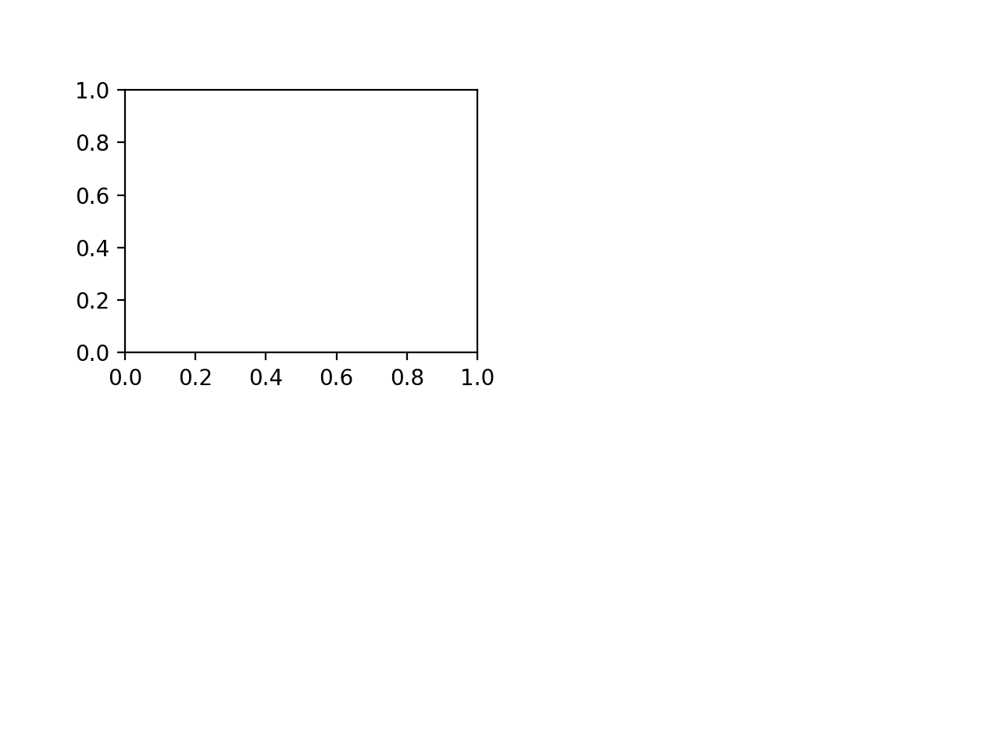

NameError: name 'YYstemp' is not defined

In [32]:
plt.figure()
for itype in range(4):
    plt.subplot(2,2,itype+1)
    plt.imshow(np.nanmean(YYstemp[:,:,:,itype],0))

<IPython.core.display.Javascript object>


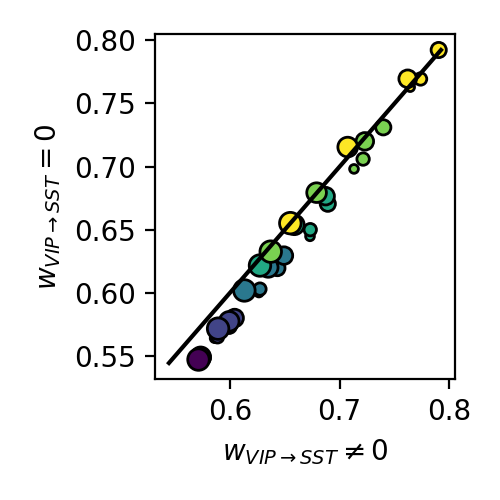

<IPython.core.display.Javascript object>


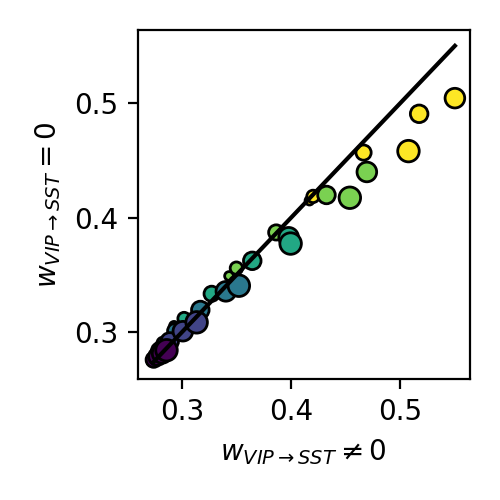

<IPython.core.display.Javascript object>


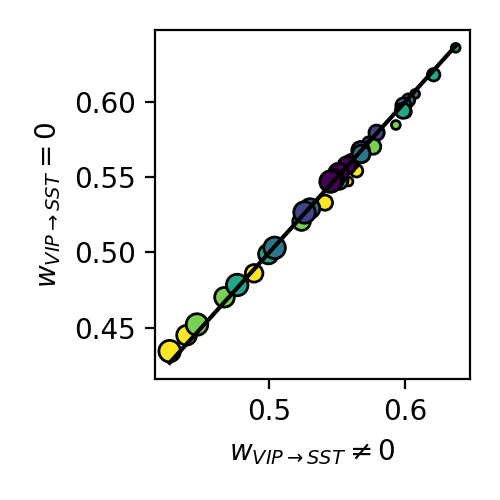

In [392]:
for itype in [0,1,2]:
    plt.figure(figsize=(2.5,2.5))
    sca.scatter_size_contrast(np.nanmean(YYstemp[:,:,:,itype],0),np.nanmean(YYs[:,:,:,itype],0))
    plt.xlabel(r'$w_{VIP\rightarrow SST} \neq 0$')
    plt.ylabel(r'$w_{VIP\rightarrow SST} = 0$')
    plt.tight_layout()

In [33]:
YYs.shape

NameError: name 'YYs' is not defined

In [331]:
# YYstemp = YYs.copy()

In [284]:
YYs.shape

(50, 6, 6, 8)

<IPython.core.display.Javascript object>


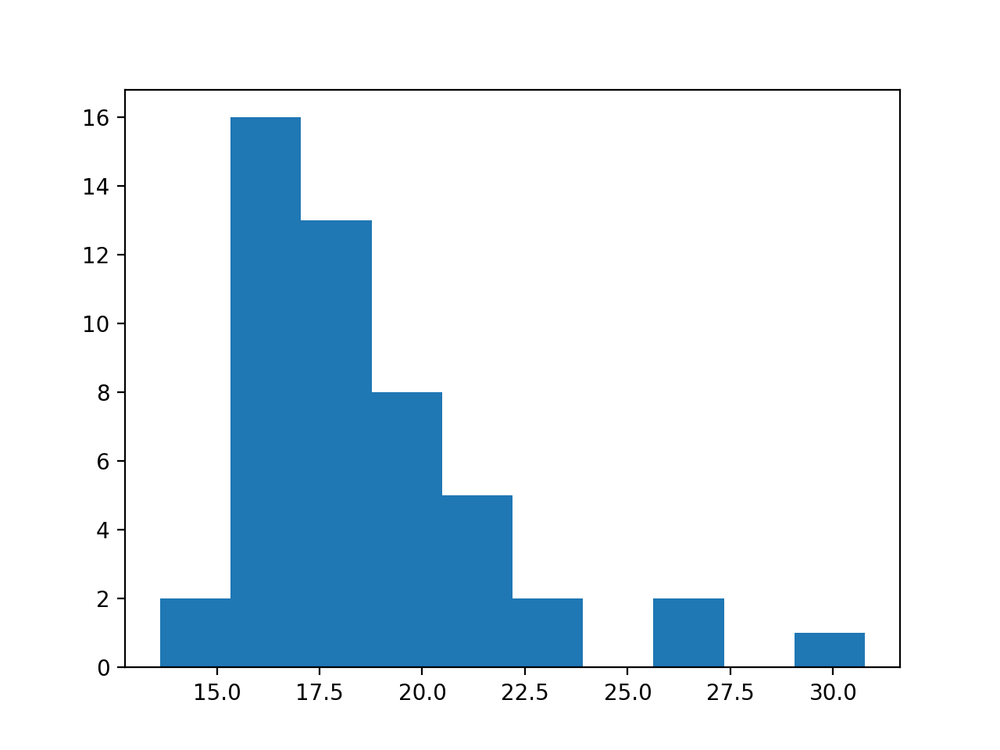

(array([ 2., 16., 13.,  8.,  5.,  2.,  0.,  2.,  0.,  1.]),
 array([13.62274568, 15.33747654, 17.0522074 , 18.76693826, 20.48166913,
        22.19639999, 23.91113085, 25.62586172, 27.34059258, 29.05532344,
        30.7700543 ]),
 <a list of 10 Patch objects>)

In [283]:
plt.figure()
plt.hist(losses[losses<100])

<IPython.core.display.Javascript object>


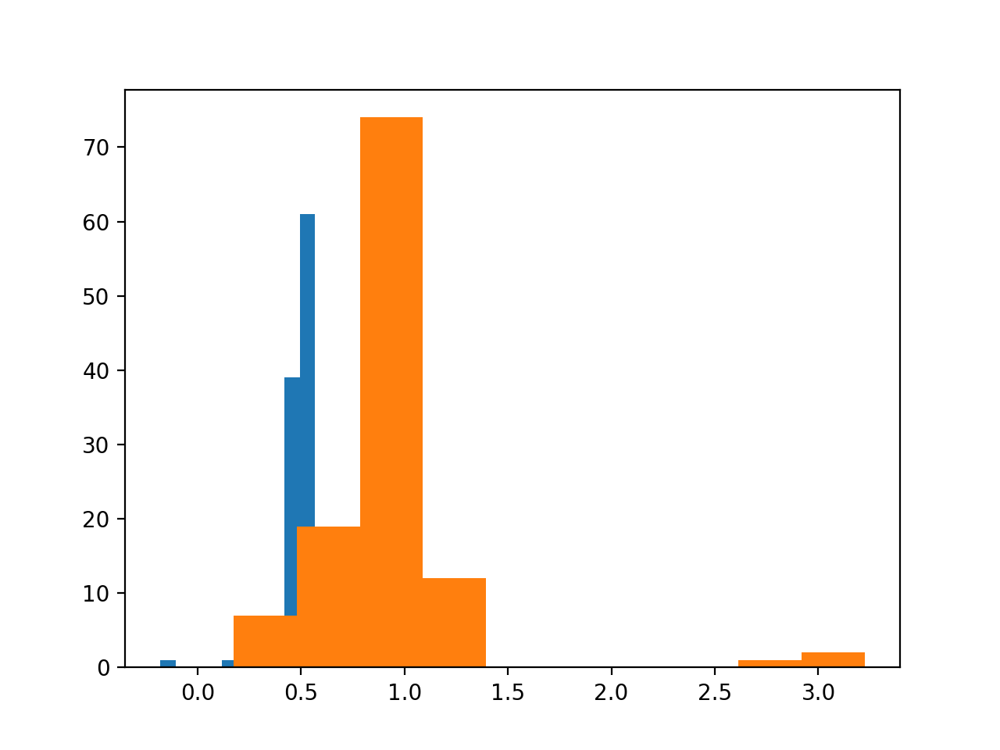

(array([ 7., 19., 74., 12.,  0.,  0.,  0.,  0.,  1.,  2.]),
 array([0.17465544, 0.47963728, 0.78461911, 1.08960094, 1.39458278,
        1.69956461, 2.00454644, 2.30952828, 2.61451011, 2.91949194,
        3.22447378]),
 <a list of 10 Patch objects>)

In [148]:
plt.figure()
plt.hist(YY1s.min(1).min(1)[:,0])
plt.hist(YY2s.min(1).min(1)[:,0])

<IPython.core.display.Javascript object>


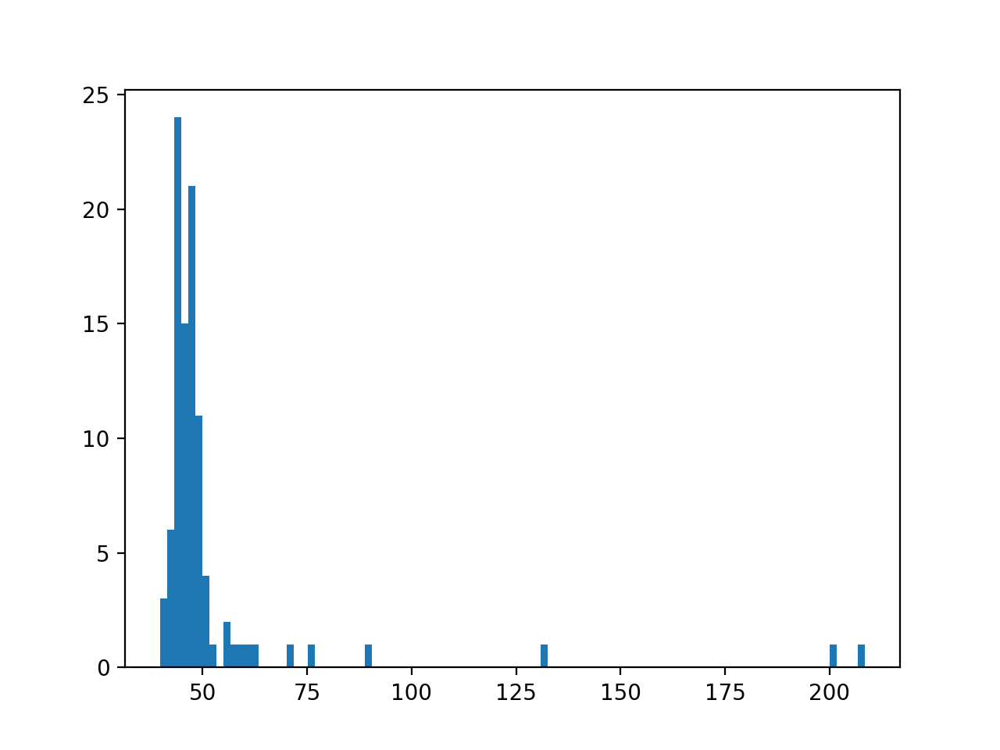

(array([ 3.,  6., 24., 15., 21., 11.,  4.,  1.,  0.,  2.,  1.,  1.,  1.,
         1.,  0.,  0.,  0.,  0.,  1.,  0.,  0.,  1.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  1.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  1.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  1.,  0.,  0.,  0.,  1.]),
 array([ 39.85729737,  41.54320942,  43.22912147,  44.91503352,
         46.60094558,  48.28685763,  49.97276968,  51.65868173,
         53.34459378,  55.03050584,  56.71641789,  58.40232994,
         60.08824199,  61.77415405,  63.4600661 ,  65.14597815,
         66.8318902 ,  68.51780226,  70.20371431,  71.88962636,
         73.57553841,  75.26145047,  76.94736252,  78.63327457,
         80.31918662,  82.00509868,  83.69101073, 

In [135]:
plt.figure()
plt.hist(losses[losses<1e3],bins=100)

<IPython.core.display.Javascript object>


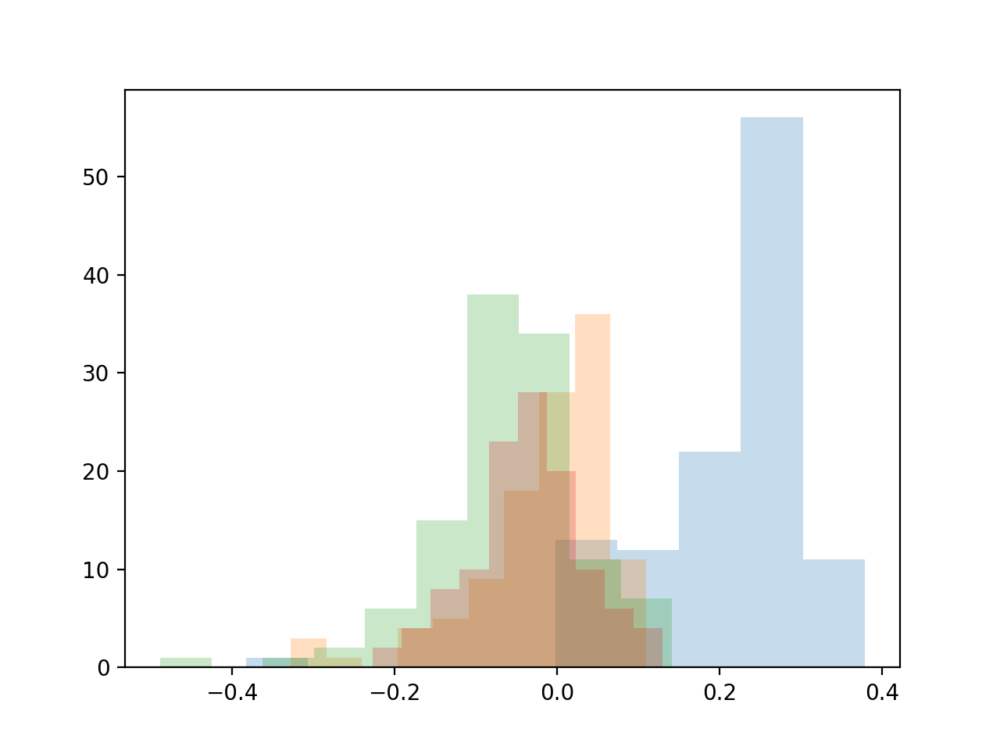

<IPython.core.display.Javascript object>


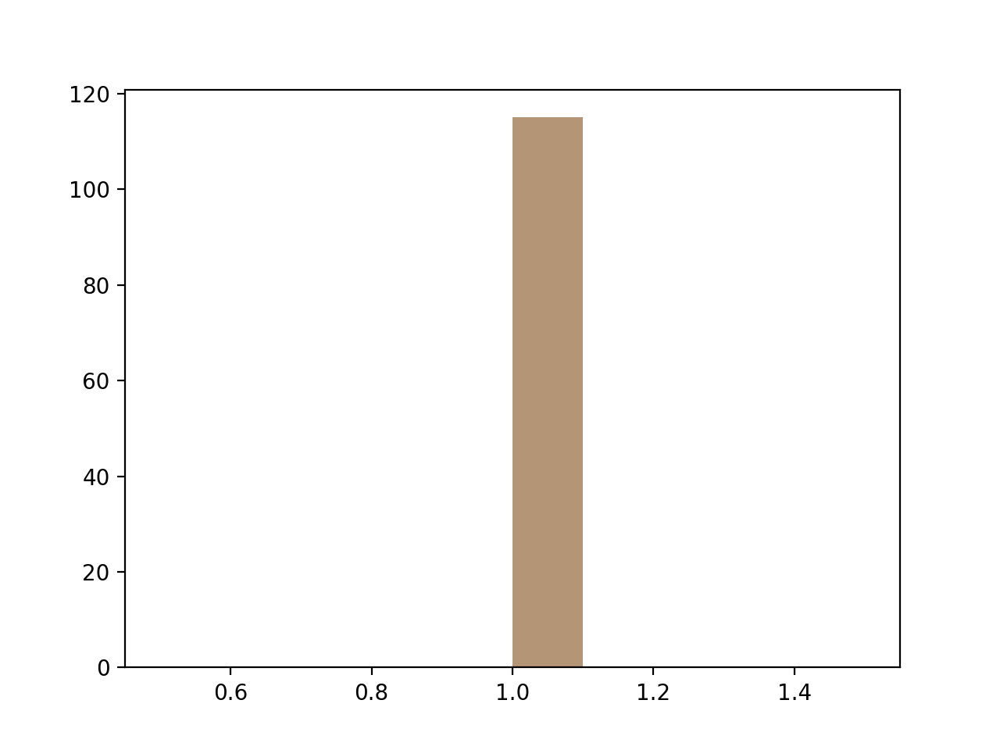

In [138]:
plt.figure()
for itype in range(nQ):
    plt.hist(bls[:,itype],alpha=0.25)
plt.figure()
for itype in range(nQ):
    plt.hist(amps[:,itype],alpha=0.25)

In [1128]:
lkat = losses < np.nanpercentile(losses,10)


<IPython.core.display.Javascript object>


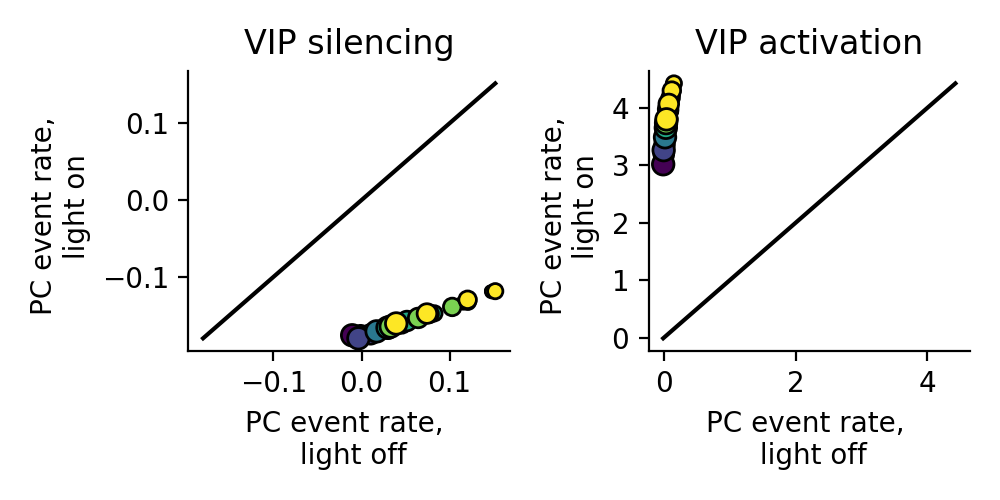

In [149]:
itype = 0
plt.figure(figsize=(5,2.5))
titles = ['VIP silencing','VIP activation']
for iyy,yy in enumerate([YY1s,YY2s]):
    plt.subplot(1,2,iyy+1)
    for iwt in [np.argmin(losses)]:#range(YYs.shape[0]):#
        sca.scatter_size_contrast(YYs[iwt,:,:,itype],yy[iwt,:,:,itype])#,mn=0.5,mx=1.25)
    plt.title(titles[iyy])
    plt.xlabel('PC event rate, \n light off')
    plt.ylabel('PC event rate, \n light on')
    ut.erase_top_right()
plt.tight_layout()
# plt.savefig('figures/bidi_nonlinear_pc_scatter_size_contrast_best.eps')

<IPython.core.display.Javascript object>


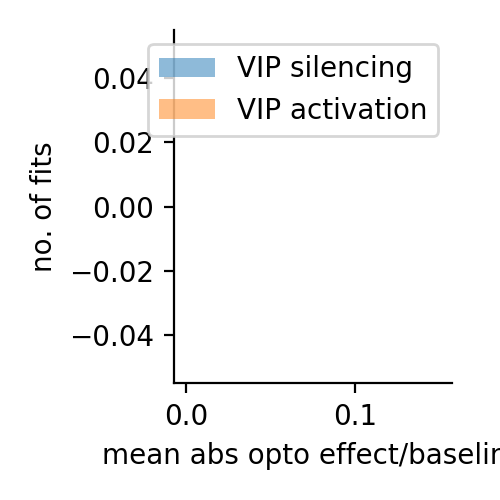

<IPython.core.display.Javascript object>


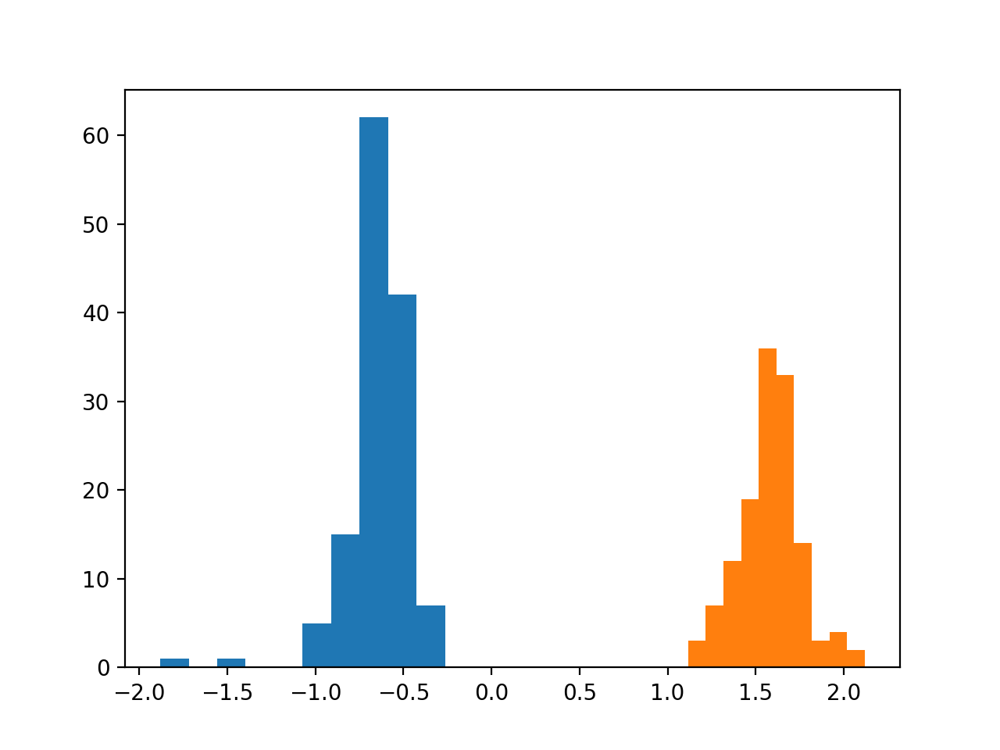

(array([ 3.,  7., 12., 19., 36., 33., 14.,  3.,  4.,  2.]),
 array([1.11644252, 1.21674306, 1.31704359, 1.41734413, 1.51764467,
        1.6179452 , 1.71824574, 1.81854628, 1.91884682, 2.01914735,
        2.11944789]),
 <a list of 10 Patch objects>)

In [38]:
plt.figure(figsize=(2.5,2.5))
bins = np.linspace(0,0.15,30)
plt.hist(np.mean(np.mean(np.mean(np.abs(YYs-YY1s)/YYs,1),1),1),bins=bins,alpha=0.5)
plt.hist(np.mean(np.mean(np.mean(np.abs(YYs-YY2s)/YYs,1),1),1),bins=bins,alpha=0.5)
plt.xlabel('mean abs opto effect/baseline')
plt.ylabel('no. of fits')
plt.legend(['VIP silencing','VIP activation'])
ut.erase_top_right()
plt.tight_layout()
plt.figure()
plt.hist(h1s)
plt.hist(h2s)

<IPython.core.display.Javascript object>


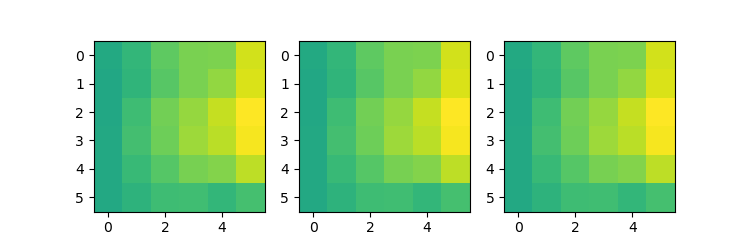

In [56]:
iwt = 10
itype = 0
mx = np.max([np.nanmax(yy[iwt,:,:,itype]) for yy in [YYs,YY1s,YY2s]])
plt.figure(figsize=(7.5,2.5))
for iyy,yy in enumerate([YYs,YY1s,YY2s]):
    plt.subplot(1,3,iyy+1)
    plt.imshow(yy[iwt,:,:,itype],vmin=0,vmax=mx)

In [39]:
[np.nanmax(yy[iwt,:,:,itype]) for yy in [YYs,YY1s,YY2s]]

[0.8373357379920496, 0.6621752126254716, 1.3193256376168134]

In [40]:
def compute_smi(YYs):
    itype = 0
    smis = YYs[:,-1,:,itype]/YYs.max(1)[:,:,itype]
    return smis

In [41]:
smi1s.shape

NameError: name 'smi1s' is not defined

In [42]:
smis,smi1s,smi2s = [compute_smi(yy) for yy in [YYs,YY1s,YY2s]]
smis_all = np.concatenate([s[:,np.newaxis] for s in [smis,smi1s,smi2s]],axis=1)

In [43]:
opto_colors = [np.array((0,0,0)),np.array((1,0.8,0)),np.array((1,0,0))]

<IPython.core.display.Javascript object>


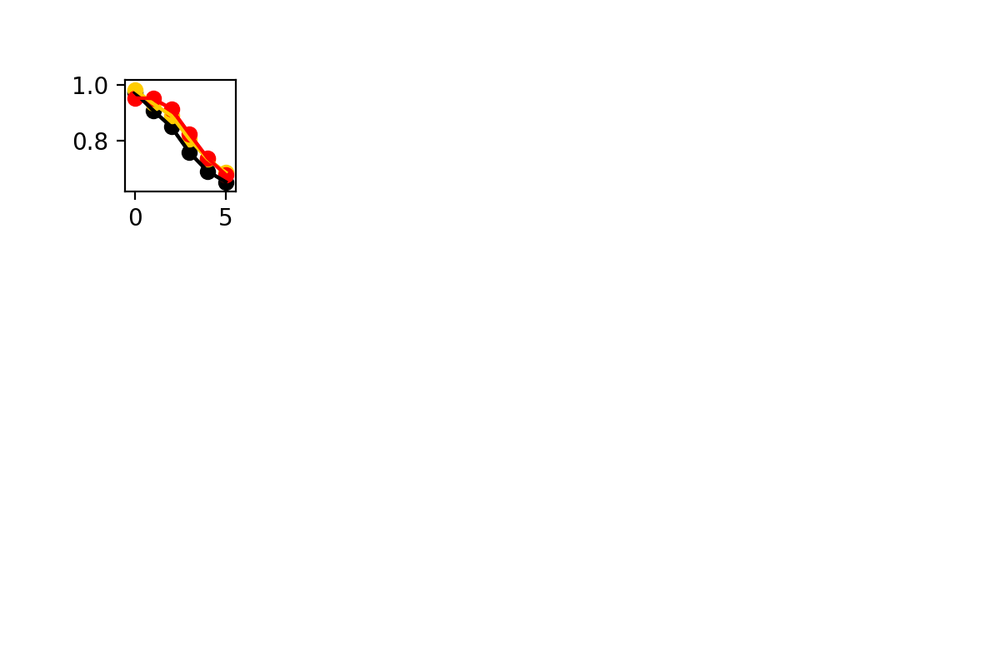

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.9810914777770322


NameError: name 'ucontrast' is not defined

In [44]:
plt.figure(figsize=(6,4))
x = np.arange(6)
for iwt in range(nfiles):
    plt.subplot(4,6,iwt+1)
    ut.plot_bootstrapped_errorbars_hillel(x,smis_all[iwt:iwt+1,:],colors = opto_colors)
    plt.xticks(x,ucontrast)
    plt.ylabel('SMI')
    plt.xlabel('contrast (%)')
    plt.axis('off')
    plt.ylim((0.5,1.1))
# plt.legend(['baseline','VIP silencing','VIP activation'])
    plt.tight_layout()
#     plt.plot(smi1s[iwt])
#     plt.plot(smi2s[iwt])

<IPython.core.display.Javascript object>


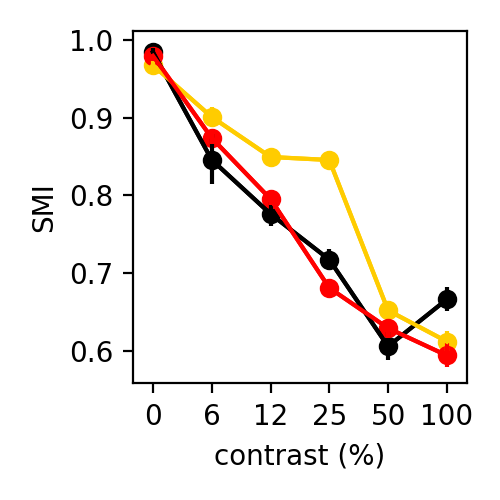

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.979613170987218


In [1287]:
plt.figure(figsize=(2.5,2.5))
x = np.arange(6)
ut.plot_bootstrapped_errorbars_hillel(x,smis_all,colors = opto_colors)
plt.xticks(x,ucontrast)
plt.ylabel('SMI')
plt.xlabel('contrast (%)')
# plt.legend(['baseline','VIP silencing','VIP activation'])
plt.tight_layout()
#     plt.plot(smi1s[iwt])
#     plt.plot(smi2s[iwt])

<IPython.core.display.Javascript object>


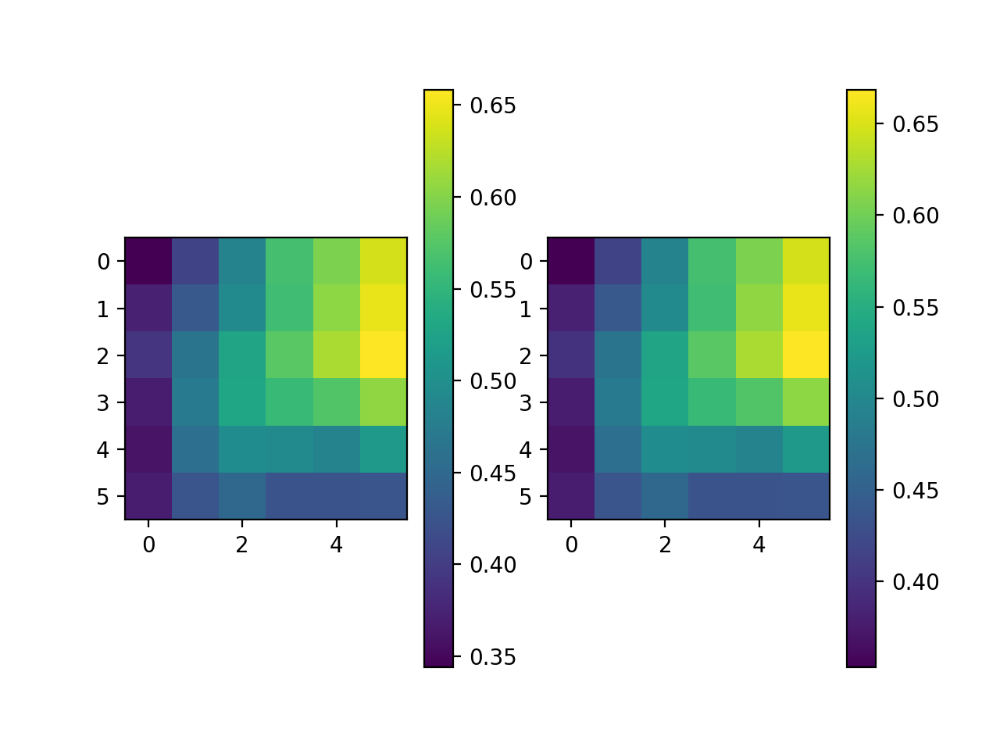

In [45]:
plt.figure()
plt.subplot(1,2,1)
plt.imshow(np.nanmean(min_eig,0))
plt.colorbar()
plt.subplot(1,2,2)
plt.imshow(np.nanmean(max_eig,0))
plt.colorbar()

<IPython.core.display.Javascript object>


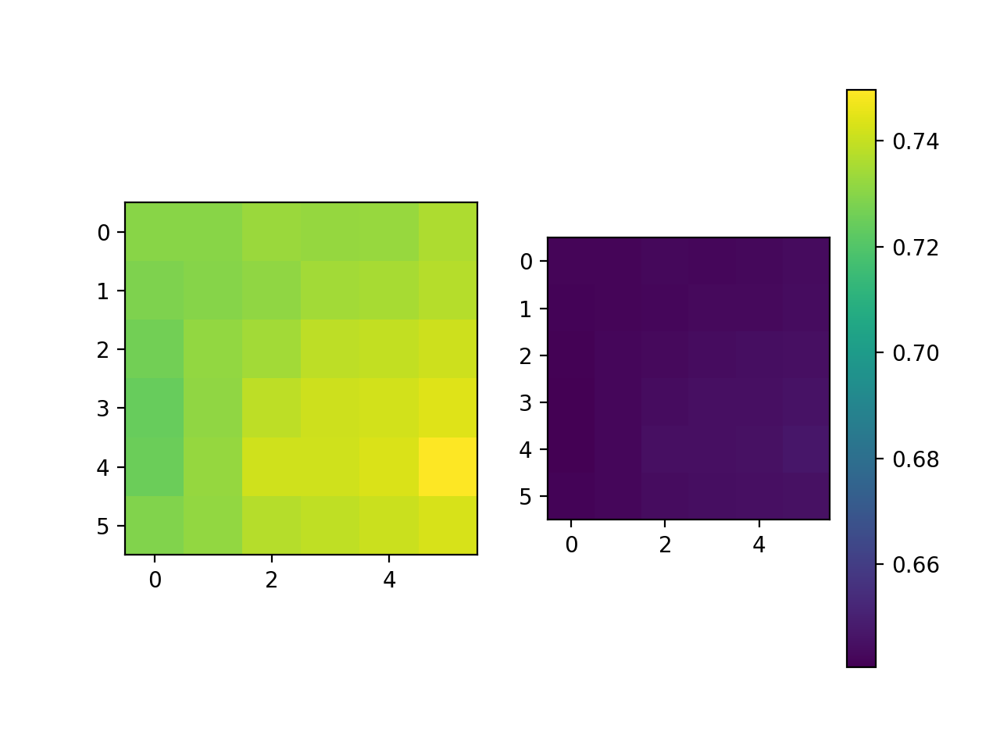

In [332]:
plt.figure()
data = np.nanmean(vs[:,:,:,:,:]/np.sign(vs[:,:,:,0:1,:]),0)
for idata in range(2):
    plt.subplot(1,2,idata+1)
    plt.imshow(data[:,:,idata,1],vmin=data.min(),vmax=data.max())
plt.colorbar()

<IPython.core.display.Javascript object>


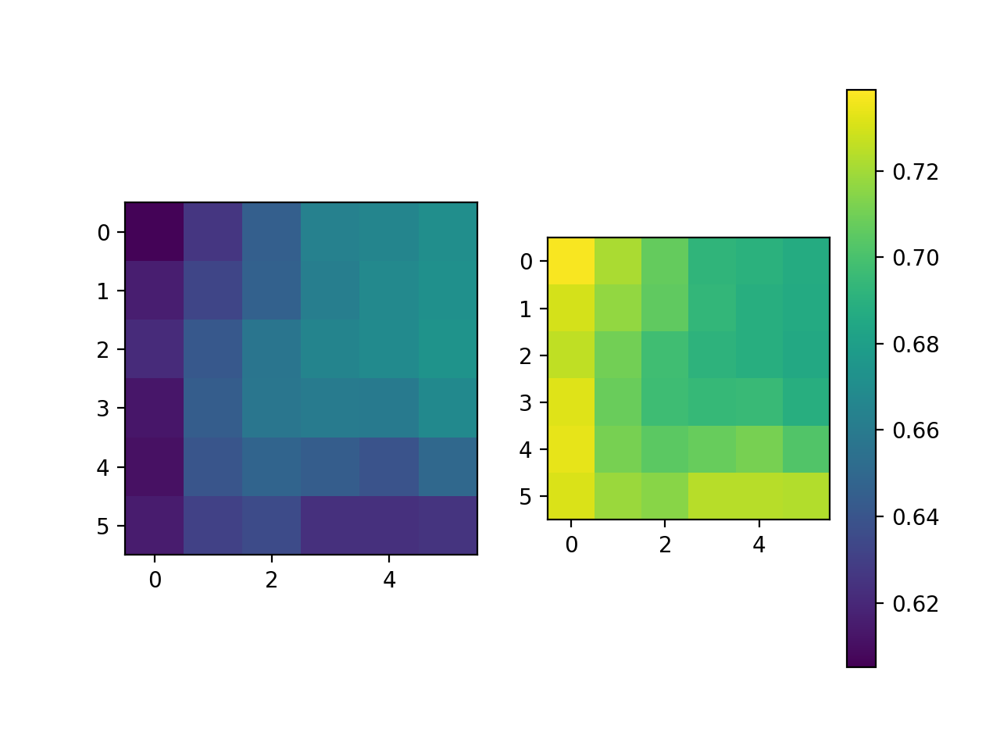

In [46]:
plt.figure()
data = np.nanmean(vs[:,:,:,:,:]/np.sign(vs[:,:,:,0:1,:]),0)
for idata in range(2):
    plt.subplot(1,2,idata+1)
    plt.imshow(data[:,:,idata,1],vmin=data.min(),vmax=data.max())
plt.colorbar()

In [47]:
v

array([[0.63750354+0.22530503j, 0.63750354-0.22530503j],
       [0.73676786+0.j        , 0.73676786-0.j        ]])

<IPython.core.display.Javascript object>


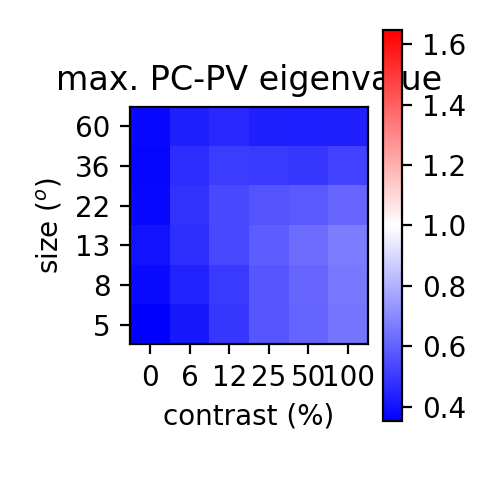

Text(0.5, 1, 'max. PC-PV eigenvalue')

In [48]:
plt.figure(figsize=(2.5,2.5))
data = np.mean(max_eig,axis=0)
rg = np.max(np.abs(data-1))
sca.show_size_contrast(data,cmap='bwr',vmin=1-rg,vmax=1+rg,flipud=True)
plt.colorbar()
plt.tight_layout()
plt.title('max. PC-PV eigenvalue')
# plt.savefig('figures/pc_pv_stability.eps')

<IPython.core.display.Javascript object>


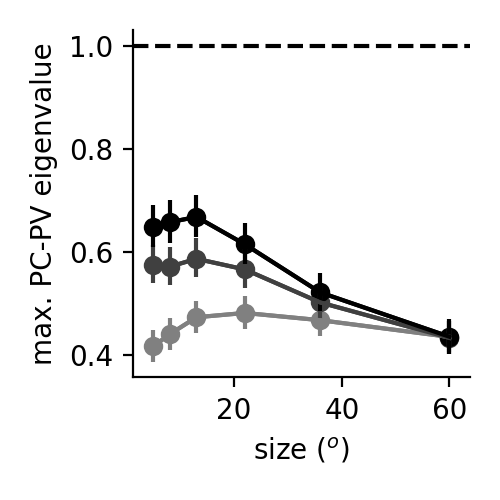

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.6263295673540664


In [51]:
plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,max_eig[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_l23)
plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel('max. PC-PV eigenvalue')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
# plt.savefig('figures/pc_pv_stability_size_by_3_contrasts.eps')

<IPython.core.display.Javascript object>


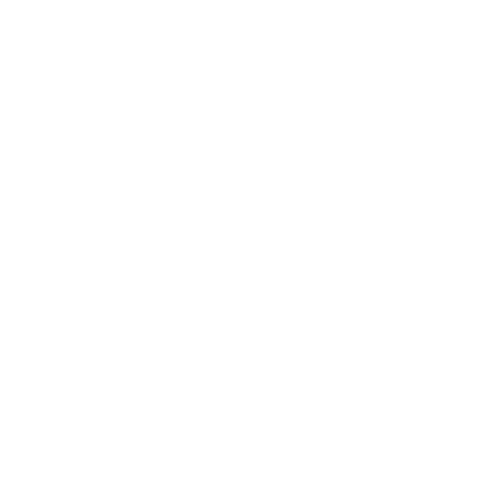

NameError: name 'phis' is not defined

In [52]:
plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,(phis[:,:,:,0]/phis[:,:,:,3])[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_l23)
plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel('$\phi_{PC}/\phi_{PV}$')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
# plt.savefig('figures/pc_pv_phi_ratio_size_by_3_contrasts.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


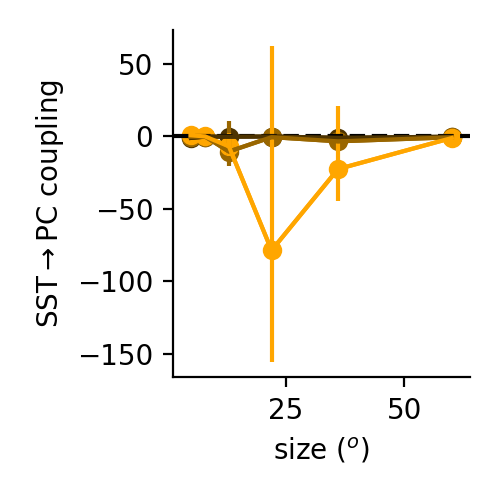

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.33400515087152555


In [769]:
plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_sst = np.array(((0.3,0.2,0),(0.6,0.4,0),(1,0.65,0)))
# ut.plot_bootstrapped_errorbars_hillel(usize,couplings_pcpv[:,:,[1,3,5],1,0].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
ut.plot_bootstrapped_errorbars_hillel(usize,couplings[:,:,[1,3,5],1,0].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# ut.plot_bootstrapped_errorbars_hillel(usize,couplings_pcpv[:,:,[1,3,5],1,0].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
plt.axhline(0,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'SST$\rightarrow$PC coupling')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
# plt.savefig('figures/sst_pc_coupling_size_by_3_contrasts.eps')

<IPython.core.display.Javascript object>


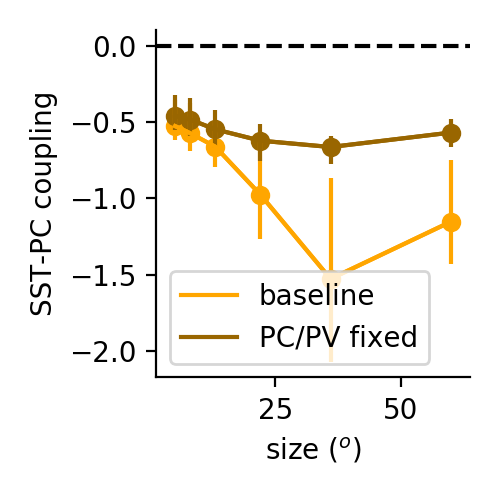

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.6975856340982863
-0.5944354315755127


In [195]:
plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_sst = np.array(((0.3,0.2,0),(0.6,0.4,0),(1,0.65,0)))
# ut.plot_bootstrapped_errorbars_hillel(usize,couplings_pcpv[:,:,[1,3,5],1,0].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# ut.plot_bootstrapped_errorbars_hillel(usize,couplings[:,:,[1,3,5],1,0].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
ut.plot_bootstrapped_errorbars_hillel(usize,couplings[:,:,5:6,1,0].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst[-1:])
ut.plot_bootstrapped_errorbars_hillel(usize,couplings_pcpv[:,:,5:6,1,0].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst[-2:-1])
plt.axhline(0,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel('SST-PC coupling')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.legend(['baseline','PC/PV fixed'])
plt.tight_layout()
# plt.savefig('figures/sst_pc_coupling_size_pc_pv_equalized.eps')

<IPython.core.display.Javascript object>


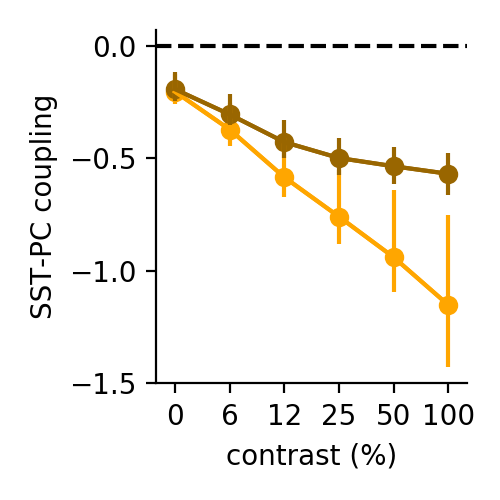

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.2801591855061695
-0.2699075940000322


In [196]:
plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
isize = 5
x = np.arange(6)
c_sst = np.array(((0.3,0.2,0),(0.6,0.4,0),(1,0.65,0)))
# ut.plot_bootstrapped_errorbars_hillel(usize,couplings_pcpv[:,:,[1,3,5],1,0].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
ut.plot_bootstrapped_errorbars_hillel(x,couplings[:,isize:isize+1,:,1,0].transpose((0,1,2)),pct=(2.5,97.5),colors=c_sst[-1:])
ut.plot_bootstrapped_errorbars_hillel(x,couplings_pcpv[:,isize:isize+1,:,1,0].transpose((0,1,2)),pct=(2.5,97.5),colors=c_sst[-2:-1])
plt.xticks(x,ucontrast)
plt.axhline(0,linestyle='dashed',c='k')
plt.xlabel('contrast (%)')
plt.ylabel('SST-PC coupling')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
# plt.savefig('figures/sst_pc_coupling_size_by_3_contrasts.eps')

<IPython.core.display.Javascript object>


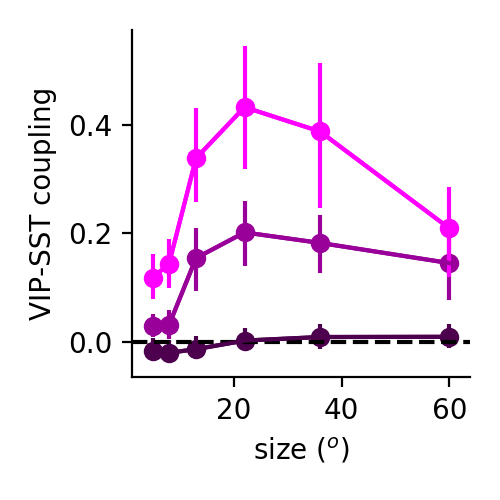

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.31955004781297913


In [437]:
plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_vip = np.array(((0.3,0,0.3),(0.6,0,0.6),(1,0,1)))
ut.plot_bootstrapped_errorbars_hillel(usize,couplings[:,:,[1,3,5],2,1].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
plt.axhline(0,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel('VIP-SST coupling')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
# plt.savefig('figures/vip_sst_coupling_size_by_3_contrasts.eps')

<IPython.core.display.Javascript object>


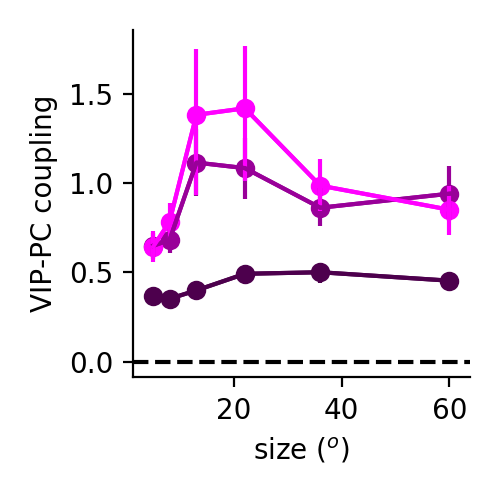

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.0677499585906811


In [438]:
plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_vip = np.array(((0.3,0,0.3),(0.6,0,0.6),(1,0,1)))
ut.plot_bootstrapped_errorbars_hillel(usize,couplings[:,:,[1,3,5],2,0].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
plt.axhline(0,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel('VIP-PC coupling')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
# plt.savefig('figures/vip_pc_coupling_size_by_3_contrasts.eps')

<IPython.core.display.Javascript object>


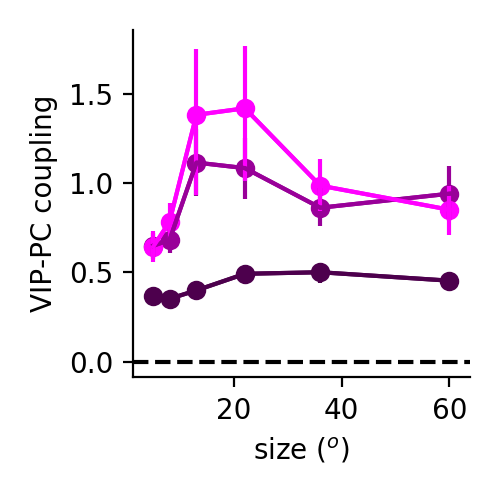

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.0677499585906811


In [439]:
plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_vip = np.array(((0.3,0,0.3),(0.6,0,0.6),(1,0,1)))
ut.plot_bootstrapped_errorbars_hillel(usize,couplings[:,:,[1,3,5],2,0].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
plt.axhline(0,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel('VIP-PC coupling')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
# plt.savefig('figures/vip_pc_coupling_size_by_3_contrasts.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


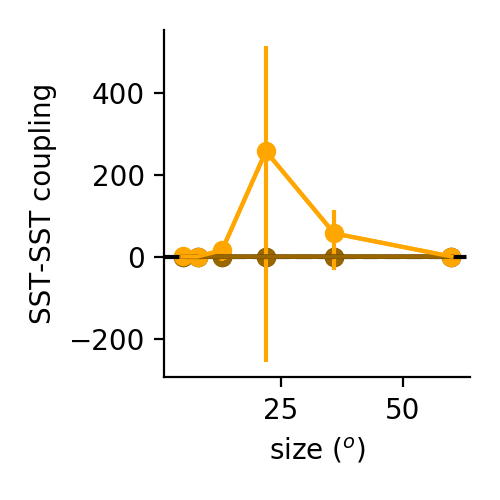

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.4200859406383173


In [756]:
plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_vip = np.array(((0.3,0,0.3),(0.6,0,0.6),(1,0,1)))
ut.plot_bootstrapped_errorbars_hillel(usize,couplings[:,:,[1,3,5],1,1].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
plt.axhline(0,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel('SST-SST coupling')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
# plt.savefig('figures/sst_sst_coupling_size_by_3_contrasts.eps')

<IPython.core.display.Javascript object>


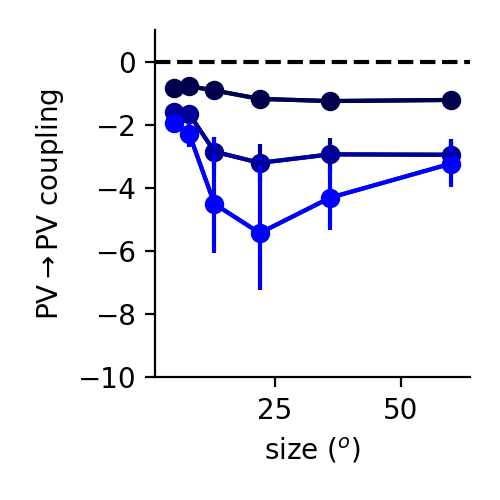

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.8866364175550354


In [441]:
reload(ut)
plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_pv = np.array(((0,0,0.3),(0,0,0.6),(0,0,1)))
ut.plot_bootstrapped_errorbars_hillel(usize,couplings[:,:,[1,3,5],3,3].transpose((0,2,1)),pct=(2.5,97.5),colors=c_pv)
plt.axhline(0,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'PV$\rightarrow$PV coupling')
# plt.legend(['6%','25%','100%'])
ut.erase_top_right()
plt.ylim((-10,1))
plt.tight_layout()
# plt.savefig('figures/pv_pv_coupling_size_by_3_contrasts.eps')

<IPython.core.display.Javascript object>


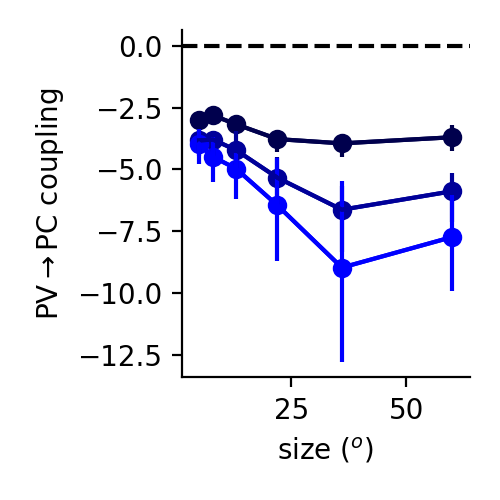

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-3.1064618889260043


In [205]:
plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_pv = np.array(((0,0,0.3),(0,0,0.6),(0,0,1)))
ut.plot_bootstrapped_errorbars_hillel(usize,couplings[:,:,[1,3,5],3,0].transpose((0,2,1)),pct=(2.5,97.5),colors=c_pv)
plt.axhline(0,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'PV$\rightarrow$PC coupling')
# plt.legend(['6%','25%','100%'])
erase_top_right()
plt.tight_layout()
# plt.savefig('figures/pv_pc_coupling_size_by_3_contrasts.eps')

<IPython.core.display.Javascript object>


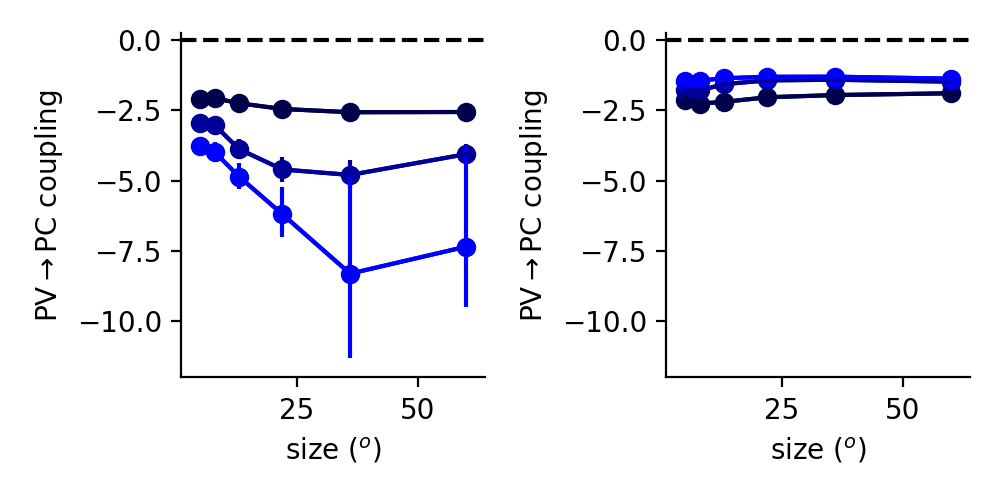

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

-2.215402917344878
-1.331929316130771


In [625]:
ylim = (-12,0.25)
plt.figure(figsize=(5,2.5))
usize = [5,8,13,22,36,60]
c_pv = np.array(((0,0,0.3),(0,0,0.6),(0,0,1)))
plt.subplot(1,2,1)
ut.plot_bootstrapped_errorbars_hillel(usize,couplings[:,:,[1,3,5],3,0].transpose((0,2,1)),pct=(2.5,97.5),colors=c_pv)
plt.axhline(0,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'PV$\rightarrow$PC coupling')
plt.ylim(ylim)
# plt.legend(['6%','25%','100%'])
erase_top_right()

plt.subplot(1,2,2)
ut.plot_bootstrapped_errorbars_hillel(usize,couplings_fixed[:,:,[1,3,5],3,0,0].transpose((0,2,1)),pct=(2.5,97.5),colors=c_pv)
plt.axhline(0,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'PV$\rightarrow$PC coupling')
plt.ylim(ylim)
# plt.legend(['6%','25%','100%'])
erase_top_right()
plt.tight_layout()
# plt.savefig('figures/pv_pc_coupling_size_by_3_contrasts.eps')

<IPython.core.display.Javascript object>


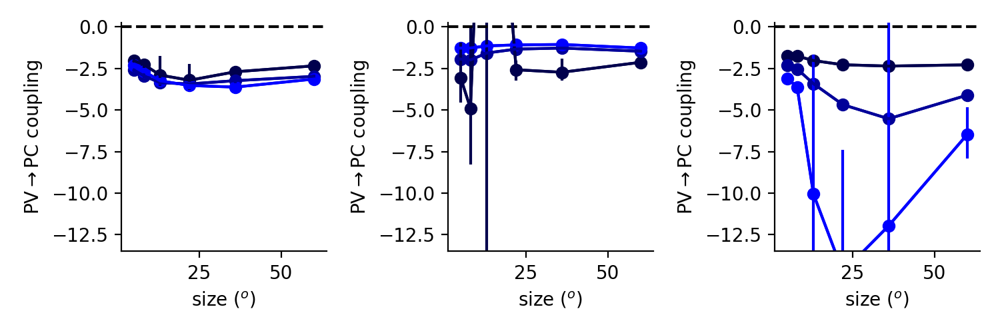

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

-2.161082556359041
-1.088678285828254


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

-1.8420984961156146


In [1181]:
ylim = (-13.5,0.25)
plt.figure(figsize=(7.5,2.5))
usize = [5,8,13,22,36,60]
c_pv = np.array(((0,0,0.3),(0,0,0.6),(0,0,1)))

plt.subplot(1,3,1)
ut.plot_bootstrapped_errorbars_hillel(usize,couplings[:,:,[1,3,5],3,0].transpose((0,2,1)),pct=(2.5,97.5),colors=c_pv)
plt.axhline(0,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'PV$\rightarrow$PC coupling')
plt.ylim(ylim)
# plt.legend(['6%','25%','100%'])
erase_top_right()

plt.subplot(1,3,2)
ut.plot_bootstrapped_errorbars_hillel(usize,couplings_fixed[:,:,[1,3,5],3,0,0].transpose((0,2,1)),pct=(2.5,97.5),colors=c_pv)
plt.axhline(0,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'PV$\rightarrow$PC coupling')
plt.ylim(ylim)
# plt.legend(['6%','25%','100%'])
erase_top_right()

plt.subplot(1,3,3)
ut.plot_bootstrapped_errorbars_hillel(usize,couplings_fixed[:,:,[1,3,5],3,0,1].transpose((0,2,1)),pct=(2.5,97.5),colors=c_pv)
plt.axhline(0,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'PV$\rightarrow$PC coupling')
plt.ylim(ylim)
# plt.legend(['6%','25%','100%'])
erase_top_right()

plt.tight_layout()
# plt.savefig('figures/pv_pc_coupling_size_by_3_contrasts.eps')

<IPython.core.display.Javascript object>


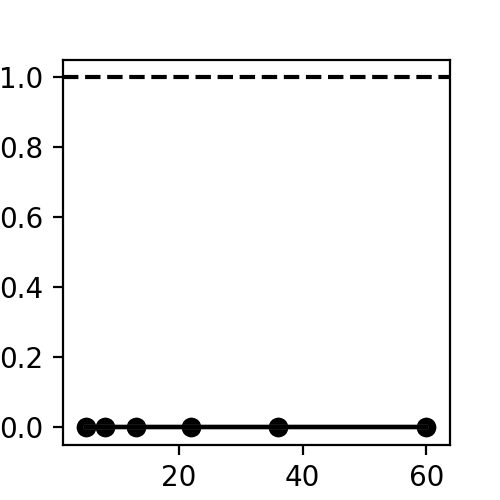

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.0


NameError: name 'erase_top_right' is not defined

In [53]:
plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,Wpcpc[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_l23)
plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'eff. PC$\rightarrow$PC weight')
# plt.legend(['6%','25%','100%'])
erase_top_right()
plt.ylim((0.5,3.5))
plt.tight_layout()
# plt.savefig('figures/pc_stability_size_by_3_contrasts.eps')

In [54]:
pc_sst_coupling = np.zeros((nN,))
pc_pv_coupling = np.zeros((nN,))
for istim in range(nN):
    Phi = np.diag(calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+tiled_s02))
    pc_sst_coupling[istim] = (Wmy[1,0]*Phi[0,0]*Wmy[0,1]*Phi[1,1])
    pc_pv_coupling[istim] = (Wmy[3,0]*Phi[0,0]*Wmy[0,3]*Phi[3,3])

<IPython.core.display.Javascript object>


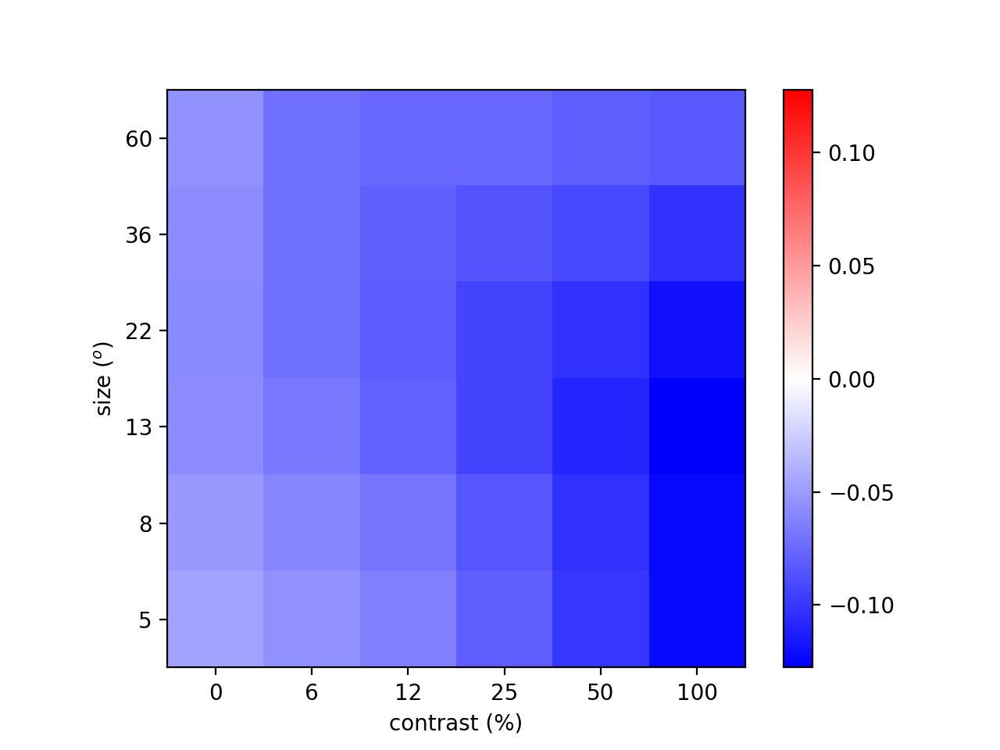

In [55]:
plt.figure()
mx = np.abs(pc_sst_coupling).max()
sca.show_size_contrast(pc_sst_coupling.reshape((6,6)),flipud=True,cmap='bwr',vmin=-mx,vmax=mx)
plt.colorbar()

In [1008]:
Wpcpc.shape

(6, 6, 6)

<IPython.core.display.Javascript object>


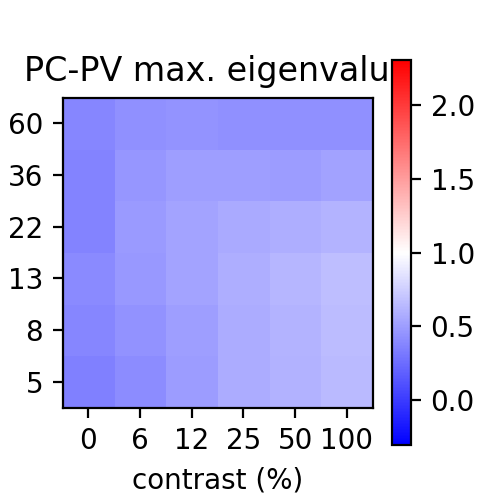

<IPython.core.display.Javascript object>


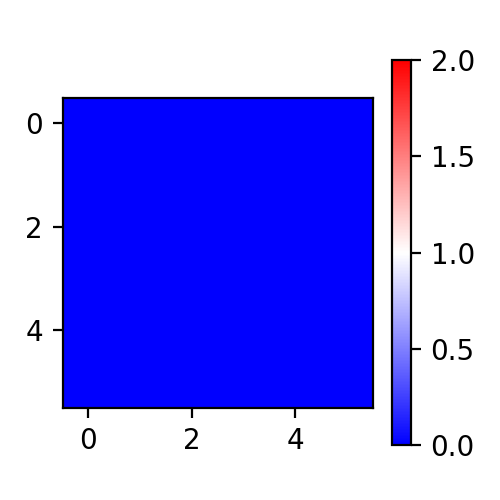

In [56]:
reload(sca)
plt.figure(figsize=(2.5,2.5))
rg = np.max(np.abs(max_eig-1))
sca.show_size_contrast(np.mean(max_eig,0),cmap='bwr',vmin=1-rg,vmax=1+rg,flipud=True)
plt.colorbar()
plt.title('PC-PV max. eigenvalue')
# plt.savefig('figures/pc_pv_stability.eps')

plt.figure(figsize=(2.5,2.5))
rg = np.max(np.abs(Wpcpc-1))
plt.imshow(np.mean(Wpcpc,0),cmap='bwr',vmin=1-rg,vmax=1+rg)
plt.colorbar()

In [300]:
# dh Phi + dY W Phi = dY
# dh + dY W = dY inv(Phi)
# dY W = dY inv(Phi) - dh
# W = pinv(dY) (dY inv(Phi) - dh)

In [830]:
# weights_base = '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_'
# good_fits = ['200714c/005','200714c/008','200714d/021','200715a/022','200715a/024',\
#             '200716a/034','200716a/035','200716a/048','200716b/006','200716b/042','200716b/061','200716b/087','200716b/091',\
#             '200717a/010','200717a/031','200717a/066','200717a/073','200717a/075','200717a/087','200717a/096',\
#             '200717b/028','200717b/052','200717b/059','200717b/060','200717b/068','200717b/079','200717b/084']
# weights_files = [weights_base+fit+'.npy' for fit in good_fits]

In [81]:
weights_files = []

# fits using only halo

# weights_base = '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_200721e/'
# good_fits = ['006','010','012','014','018','019','020','021','023','025','030',\
#              '035','042','045','049','058','060','064','066','076','078','083']
# weights_files = [weights_base+fit+'.npy' for fit in good_fits]

# weights_base = '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_200722a/'
# good_fits = ['003','012','014','025','028','029','031','048','059','060',\
#              '066','072','079','081','088','089','090','094']
# weights_files = weights_files + [weights_base+fit+'.npy' for fit in good_fits]

# weights_base = '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_200723a/'
# good_fits = ['000','001','002','004','011','025','026','027','029','032',\
#              '043','045','064','065','069','070','072','076','080','086',\
#             '087','089','093','096']
# weights_files = weights_files + [weights_base+fit+'.npy' for fit in good_fits]


# weights_base = '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_200724a/'
# good_fits = ['000','003','004','017','018','028','029','034','037','044',\
#              '046','050','054','058','060','062','066','069','072','079',\
#             '086','087','091','092','097']
# weights_files = weights_files + [weights_base+fit+'.npy' for fit in good_fits]


# weights_base = '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_200725a/'
# good_fits = ['002','003','005','010','015','034','042','070','072','073',\
#              '074','076','079','080','085','087','089','092','094','102',\
#             '103','105','118','120','123','132','134','137','138','141',\
#             '143','145','147','161','164','166','171','174','180','182',\
#             '185','192','193','199']
# weights_files = weights_files + [weights_base+fit+'.npy' for fit in good_fits]

# fits using halo and chrimson

# weights_base = '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_200820b/'
# good_fits = ['021','045','059','063','073','087','088','090','092']

# weights_files = weights_files + [weights_base+fit+'.npy' for fit in good_fits]

# fits using halo and chrimson, initialized from halo good fits

weights_base = '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_200821a/'
good_fits = ['%03d'%i for i in range(133)]

weights_files = weights_files + [weights_base+fit+'.npy' for fit in good_fits]

In [692]:
weights_file = '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_200820a/000.npy'
npyfile = np.load(weights_file,allow_pickle=True)[()]

In [693]:
npyfile['Wmy']

array([[ 4.30288556,  1.1677927 ,  0.61461367,  3.53217309],
       [-0.28278042,  0.        , -0.87968018, -0.25773783],
       [ 0.        , -0.91002233, -0.07578183,  0.        ],
       [-3.34941514, -0.12832602, -0.41438752, -2.45614189]])

In [694]:
# basefold = '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/'
# subfold = 'weights_200720a/'
# plots_fold = basefold + 'fit_graphics/' + subfold
# ut.mkdir(plots_fold)
# weights_fold = basefold + 'weights/' + subfold
# weights_files = glob.glob(weights_fold+'*.npy')
# weights_files.sort()
# # weights_filenames = [s.split('/')[-1][:-4] for s in weights_files]


In [34]:
basefold = '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/'
def get_weights_files(fit_lbl):
    subfold = 'weights_%s/'%fit_lbl
    plots_fold = basefold + 'fit_graphics/' + subfold
    weights_fold = basefold + 'weights/' + subfold
    weights_files = glob.glob(weights_fold+'*.npy')
    weights_files.sort()
    weights_filenames = [weights_file.split('/')[-1][:-4] for weights_file in weights_files]
    return weights_files,weights_filenames

In [35]:
fit_lbl = '201130b'
weights_files,weights_filenames = get_weights_files(fit_lbl)

print(len(weights_files))

# weights_filenames = [s.split('/')[-1][:-4] for s in weights_files]

1000


In [266]:
wt_dicts = [{},{}]

In [1155]:
[key for key in wt_dicts[0] if not np.all(wt_dicts[0][key]==wt_dicts[1][key])]

['celltypesOpto', 'dirOpto']

In [77]:
weights_files

['/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_201208b/000.npy',
 '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_201208b/001.npy',
 '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_201208b/002.npy',
 '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_201208b/003.npy',
 '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_201208b/004.npy',
 '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_201208b/005.npy',
 '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_201208b/006.npy',
 '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_201208b/007.npy',
 '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_201208b/008.npy',
 '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weight

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


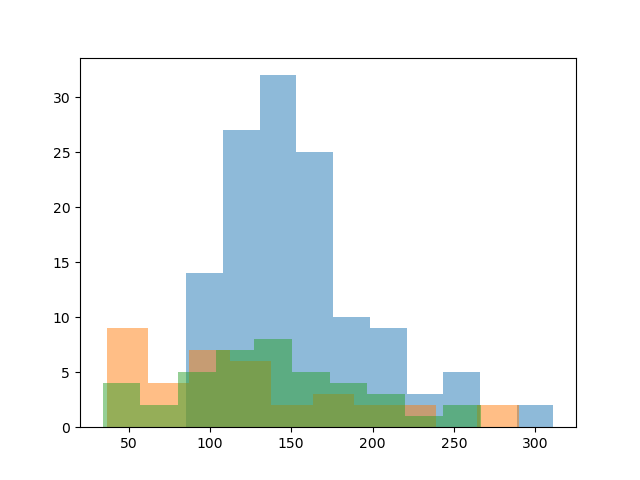

129.10139961736863
73.9449081792206
110.65775138255863


In [214]:
plt.figure()
for ifit in range(3):
    plt.hist(losses[ifit],alpha=0.5)
    print(np.nanpercentile(losses[ifit],30))

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


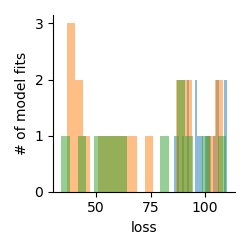

In [217]:
plt.figure(figsize=(2.5,2.5))

fit_lbls = ['201216d','201216e','201216f']
wt_dicts = [{} for lbl in fit_lbls]

nfits = len(fit_lbls)

Ks,Wmys,Wmxs,s02s,bls,YYs,XXs,Etas,h1s,h2s,losses,couplings,couplings_pcpv,Xcouplings,phis,mono_couplings,mdls,YYs_no_res = [[None for ifit in range(nfits)] for ivar in range(18)]

lcutoff = 110
simulate_no_res = False #True

for ifit,fit_lbl in enumerate(fit_lbls):
    
    weights_files,weights_filenames = get_weights_files(fit_lbl)

    nfiles = len(weights_files)
    # Ts = np.zeros((nfiles,nQ))
    Ks[ifit] = np.zeros((nfiles,nQ))
    Wmys[ifit] = np.zeros((nfiles,nQ,nQ))
    Wmxs[ifit] = np.zeros((nfiles,nP,nQ))
    s02s[ifit] = np.zeros((nfiles,nQ))
    bls[ifit] = np.zeros((nfiles,nQ))
    YYs[ifit] = np.zeros((nfiles,6,6,nQ*nS*nT))
    YYs_no_res[ifit] = np.nan*np.ones((nfiles,6,6,nQ*nS*nT))
    XXs[ifit] = np.zeros((nfiles,6,6,nP*nS*nT))
    Etas[ifit] = np.zeros((nfiles,6,6,nQ*nS*nT))
    # Eta1s = np.zeros((nfiles,6,6,nQ*nS*nT))
    # Eta2s = np.zeros((nfiles,6,6,nQ*nS*nT))
    h1s[ifit] = np.zeros((nfiles,))
    h2s[ifit] = np.zeros((nfiles,))
    losses[ifit] = np.zeros((nfiles,))
    couplings[ifit] = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
    mono_couplings[ifit] = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
    # couplings with phiPV = phiPC fixed
    couplings_pcpv[ifit] = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
    Xcouplings[ifit] = np.zeros((nfiles,6,6,nP*nS*nT,nQ*nS*nT))
    phis[ifit] = np.zeros((nfiles,6,6,nQ*nS*nT))
    mdls[ifit] = [None for iwt in range(nfiles)]
    for iwt,weights_file in enumerate(weights_files):
        Wstar_dict = np.load(weights_file,allow_pickle=True)[()]
    #     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h = Wstar_dict['as_list']
        wt_dicts[ifit] = Wstar_dict['wt_dict']
        mdls[ifit][iwt] = cc.ModelOri(Wstar_dict,nT=1)
        try:
            Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl = Wstar_dict['as_list']
            amp = np.ones((nQ*nS*nT,))
        except:
            Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl,amp = Wstar_dict['as_list']
        losses[ifit][iwt] = Wstar_dict['loss']
    #     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,h3,Eta1,Eta2,Eta3 = Wstar_dict['as_list']
        WWmy = calnet.utils.gen_Weight_k_kappa_t(Wmy,K,kappa,T,nS=nS,nT=nT)
        WWmx = calnet.utils.gen_Weight_k_kappa_t(Wmx,K,kappa,T,nS=nS,nT=nT)
        tiled_s02 = np.tile(s02,nS*nT)
    #     Ts[iwt] = T
        Ks[ifit][iwt] = K
        Wmys[ifit][iwt] = Wmy
        Wmxs[ifit][iwt] = Wmx
        s02s[ifit][iwt] = s02
        bls[ifit][iwt] = bl
        YYs[ifit][iwt] = sim_utils.f_miller_troyer(Eta,Xi**2+tiled_s02).reshape((6,6,nQ*nS*nT)) + np.tile(bl,nS*nT)[np.newaxis]
        if simulate_no_res:
            if losses[ifit][iwt]<lcutoff:
                print((ifit,iwt))
                yynr = dyn.compute_steady_state_Model(mdls[ifit][iwt],residuals_on=False,Niter=int(1e3))
                YYs_no_res[ifit][iwt] = np.nanmean(yynr[:,-500:],1).reshape((6,6,nQ*nS*nT)) + np.tile(bl,nS*nT)[np.newaxis]
        XXs[ifit][iwt] = XX.reshape((6,6,nP*nS*nT))
        Etas[ifit][iwt] = Eta.reshape((6,6,nQ*nS*nT))
        h1s[ifit][iwt] = h1
        h2s[ifit][iwt] = h2
    #     Eta1s[iwt] = Eta1.reshape((6,6,nQ*nS*nT))
    #     Eta2s[iwt] = Eta2.reshape((6,6,nQ*nS*nT))
        for istim in range(nN):
            iistim,jjstim = np.unravel_index(istim,(6,6))
            phis[ifit][iwt,iistim,jjstim] = calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+tiled_s02)
            phipcpv = phis[ifit][iwt,iistim,jjstim].copy()
            phipcpv[3::4] = phipcpv[0::4]
            Phi = np.diag(phis[ifit][iwt,iistim,jjstim])
            Phipcpv = np.diag(phipcpv)
            couplings[ifit][iwt,iistim,jjstim] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
            mono_couplings[ifit][iwt,iistim,jjstim] = (WWmy @ Phi)
            Xcouplings[ifit][iwt,iistim,jjstim] = WWmx @ Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
            couplings_pcpv[ifit][iwt,iistim,jjstim] = Phipcpv @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phipcpv)
    # couplings = np.reshape(couplings,(couplings.shape[0],6,6,couplings.shape[2],couplings.shape[3]))
    # Xcouplings = np.reshape(Xcouplings,(Xcouplings.shape[0],6,6,Xcouplings.shape[2],Xcouplings.shape[3]))

    # plt.figure(figsize=(2.5,2.5))
    plt.hist(losses[ifit][losses[ifit]<lcutoff],bins=20,alpha=0.5)
    ut.erase_top_right()
    plt.xlabel('loss')
    plt.ylabel('# of model fits')
    plt.tight_layout()
# plt.savefig('figures/model_fits_random_inits_simulate2_true.eps')

    
#     weights_files,weights_filenames = get_weights_files(fit_lbl)

#     nfiles = len(weights_files)
#     # Ts = np.zeros((nfiles,nQ))
#     Ks = np.zeros((nfiles,nQ))
#     Wmys = np.zeros((nfiles,nQ,nQ))
#     Wmxs = np.zeros((nfiles,nP,nQ))
#     s02s = np.zeros((nfiles,nQ))
#     YYs = np.zeros((nfiles,6,6,nQ*nS*nT))
#     XXs = np.zeros((nfiles,6,6,nP*nS*nT))
#     Etas = np.zeros((nfiles,6,6,nQ*nS*nT))
#     # Eta1s = np.zeros((nfiles,6,6,nQ*nS*nT))
#     # Eta2s = np.zeros((nfiles,6,6,nQ*nS*nT))
#     h1s = np.zeros((nfiles,))
#     h2s = np.zeros((nfiles,))
#     losses = np.zeros((nfiles,))
#     couplings = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
#     # couplings with phiPV = phiPC fixed
#     couplings_pcpv = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
#     Xcouplings = np.zeros((nfiles,6,6,nP*nS*nT,nQ*nS*nT))
#     phis = np.zeros((nfiles,6,6,nQ*nS*nT))
#     for iwt,weights_file in enumerate(weights_files):
#         Wstar_dict = np.load(weights_file,allow_pickle=True)[()]
#     #     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h = Wstar_dict['as_list']
#         wt_dicts[ifit] = Wstar_dict['wt_dict']
#         try:
#             Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl = Wstar_dict['as_list']
#             amp = np.ones((nQ*nS*nT,))
#         except:
#             Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl,amp = Wstar_dict['as_list']
#         losses[iwt] = Wstar_dict['loss']
#     #     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,h3,Eta1,Eta2,Eta3 = Wstar_dict['as_list']
#         WWmy = calnet.utils.gen_Weight_k_kappa_t(Wmy,K,kappa,T,nS=nS,nT=nT)
#         WWmx = calnet.utils.gen_Weight_k_kappa_t(Wmx,K,kappa,T,nS=nS,nT=nT)
#         tiled_s02 = np.tile(s02,nS*nT)
#     #     Ts[iwt] = T
#         Ks[iwt] = K
#         Wmys[iwt] = Wmy
#         Wmxs[iwt] = Wmx
#         s02s[iwt] = s02
#         YYs[iwt] = sim_utils.f_miller_troyer(Eta,Xi**2+tiled_s02).reshape((6,6,nQ*nS*nT)) + np.tile(bl,nS*nT)[np.newaxis]
#         XXs[iwt] = XX.reshape((6,6,nP*nS*nT))
#         Etas[iwt] = Eta.reshape((6,6,nQ*nS*nT))
#         h1s[iwt] = h1
#         h2s[iwt] = h2
#     #     Eta1s[iwt] = Eta1.reshape((6,6,nQ*nS*nT))
#     #     Eta2s[iwt] = Eta2.reshape((6,6,nQ*nS*nT))
#         for istim in range(nN):
#             iistim,jjstim = np.unravel_index(istim,(6,6))
#             phis[iwt,iistim,jjstim] = calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+tiled_s02)
#             phipcpv = phis[iwt,iistim,jjstim].copy()
#             phipcpv[3::4] = phipcpv[0::4]
#             Phi = np.diag(phis[iwt,iistim,jjstim])
#             Phipcpv = np.diag(phipcpv)
#             couplings[iwt,iistim,jjstim] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
#             Xcouplings[iwt,iistim,jjstim] = WWmx @ Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
#             couplings_pcpv[iwt,iistim,jjstim] = Phipcpv @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phipcpv)
#     # couplings = np.reshape(couplings,(couplings.shape[0],6,6,couplings.shape[2],couplings.shape[3]))
#     # Xcouplings = np.reshape(Xcouplings,(Xcouplings.shape[0],6,6,Xcouplings.shape[2],Xcouplings.shape[3]))

#     # plt.figure(figsize=(2.5,2.5))
#     plt.hist(losses[losses<15],bins=20,alpha=0.5)
#     ut.erase_top_right()
#     plt.xlabel('loss')
#     plt.ylabel('# of model fits')
#     plt.tight_layout()
#     print((losses.min(),losses.max()))
# plt.savefig('figures/model_fits_random_inits_simulate2_true.eps')


In [224]:
np.nanmean(Wmys[2],0)

array([[ 4.02842419,  1.471775  ,  1.45728511,  3.80206184],
       [-0.60977693,  0.        ,  0.        , -0.14706121],
       [ 0.        , -1.06252841, -0.0266025 , -0.08987595],
       [-2.96167582, -0.54468286, -1.22091937, -2.41861769]])

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


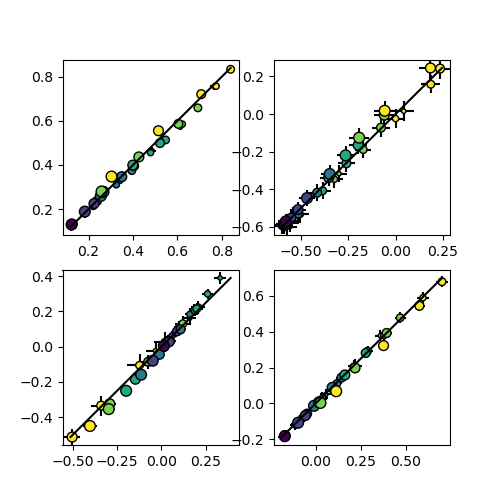

<IPython.core.display.Javascript object>


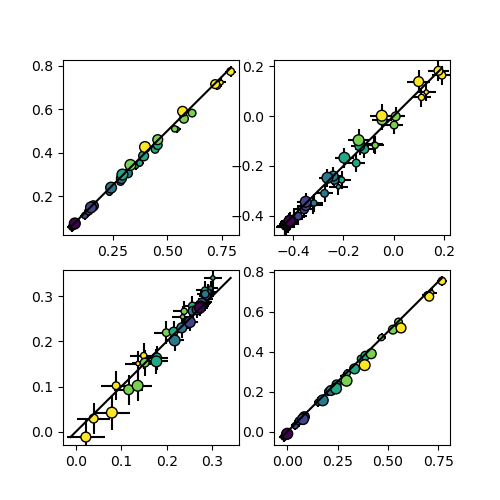

<IPython.core.display.Javascript object>


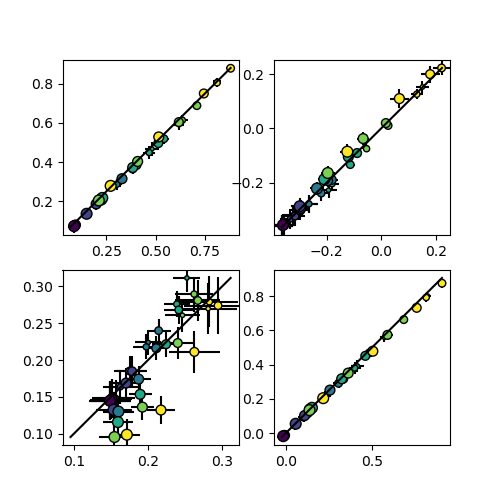

In [221]:
for ifit in range(3):
    plt.figure(figsize=(5,5))
    for itype in range(4):
        lkat = losses[ifit]<lcutoff
        good_mdls = [mdl for mdl,ll in zip(mdls[ifit],lkat) if ll]
        resEta = np.concatenate([good_mdls[iwt].resEta[:,itype:itype+1].T for iwt in range(len(good_mdls))],axis=0).reshape((-1,6,6))
        ydata = Etas[ifit][lkat][:,:,:,itype]
        xdata = ydata - resEta
        plt.subplot(2,2,itype+1)
        sca.scatter_size_contrast_errorbar(xdata,ydata)

In [1266]:
# for ifit in range(nfits):
#     for iwt in range(bls[ifit].shape[0]):
#         bl = bls[ifit][iwt]
#         YYs_no_res[ifit][iwt] = YYs_no_res[ifit][iwt] + np.tile(bl,nS*nT)[np.newaxis]

In [220]:
wt_dicts[0]

{'X': 3,
 'Y': 3,
 'Eta': 300,
 'Xi': 0.1,
 'stims': array([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]]),
 'barrier': 0.0,
 'opto': 0,
 'isn': 0.1,
 'tv': 0.1,
 'stimsOpto': array([[3. ],
        [0.6],
        [0.6],
        [0.6],
        [0.6],
        [0.6],
        [3. ],
        [0.6],
        [0.6],
        [0.6],
        [0.6],
        [0.6],
        [3. ],
        [0.6],
        [0.6],
        [0.6],
        [0.6],
        [0.6],
        [3. ],
        [0.6],
        [0.6],
        [0.6],
        [0.6],
        [0.6],
        [3. ],


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


<IPython.core.display.Javascript object>


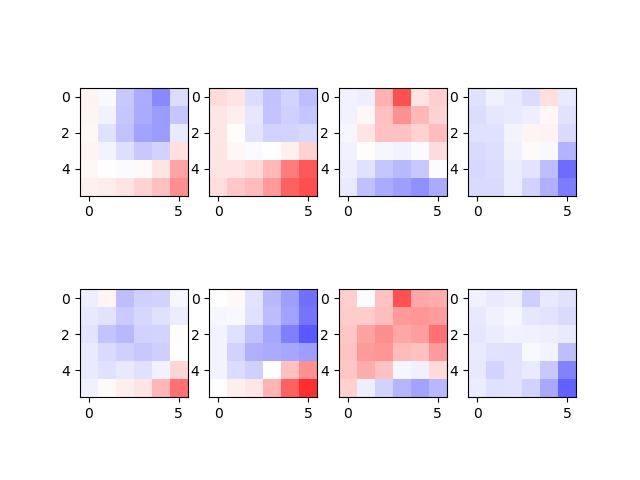

<IPython.core.display.Javascript object>


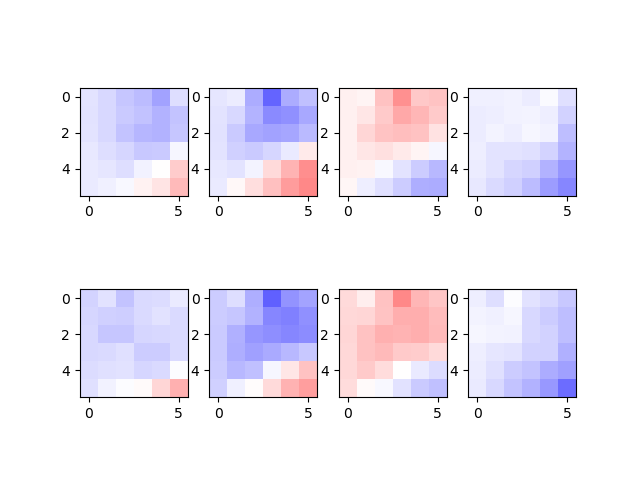

<IPython.core.display.Javascript object>


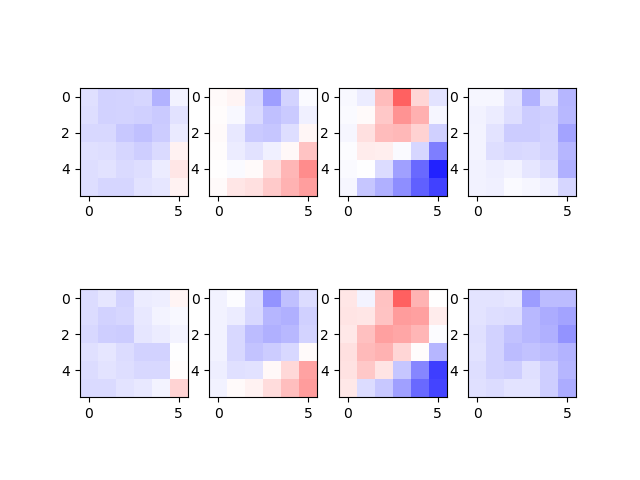

In [211]:
lcutoff = np.nanpercentile(losses[0],10)

for ifit in range(0,nfits):
    plt.figure()
    for itype in range(8):
        good_mdls = [mdl for mdl,ll in zip(mdls[ifit],losses[ifit]<lcutoff) if ll]
        resEta = np.concatenate([good_mdls[iwt].resEta[:,itype:itype+1] for iwt in range(len(good_mdls))],axis=1)
        plt.subplot(2,4,itype+1)
        ut.imshow_hot_cold(np.nanmean(resEta,1).reshape((6,6)),mx=0.1)
#         plt.colorbar()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


<IPython.core.display.Javascript object>


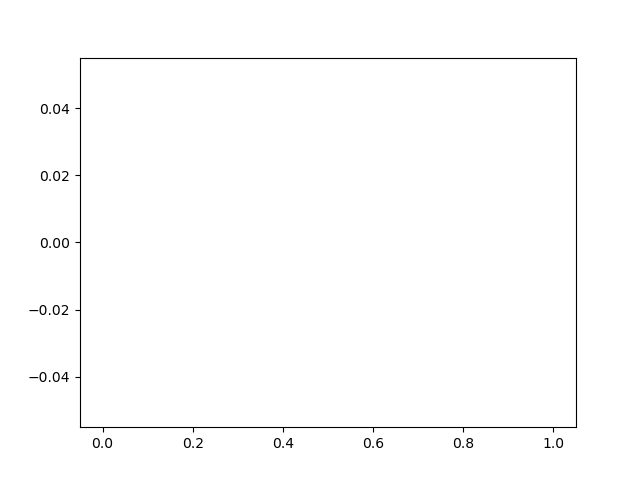

<IPython.core.display.Javascript object>


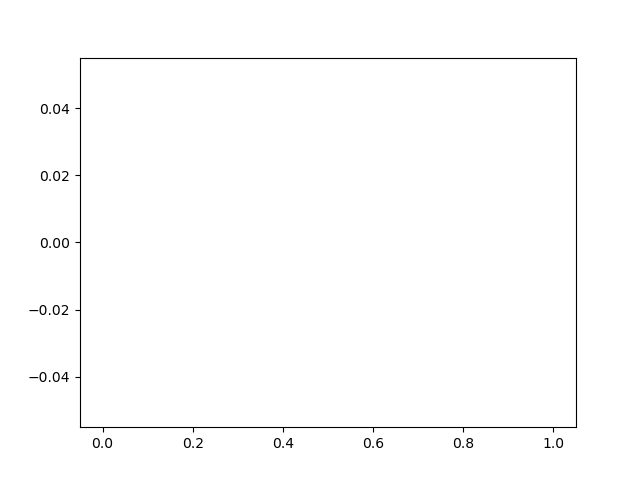

In [176]:
lcutoff = 12
itype = 1
for var in [s02s,bls]:
    plt.figure()
    for ifit in [0,1]:
        plt.hist(var[ifit][losses[ifit]<lcutoff,itype],alpha=0.5)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


<IPython.core.display.Javascript object>


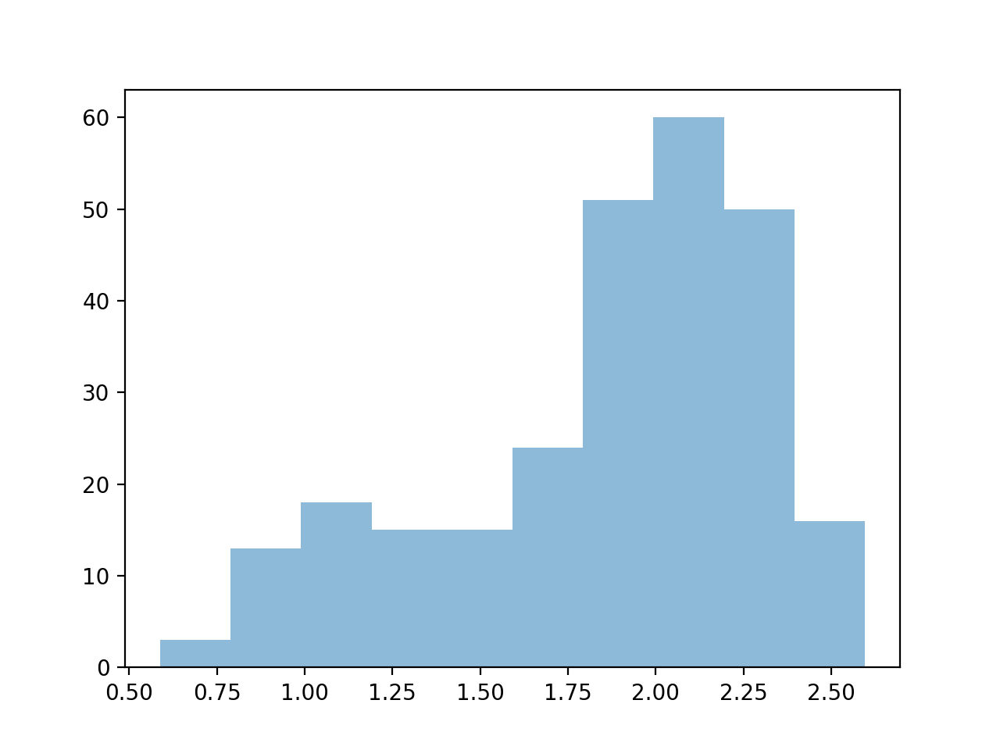

<IPython.core.display.Javascript object>


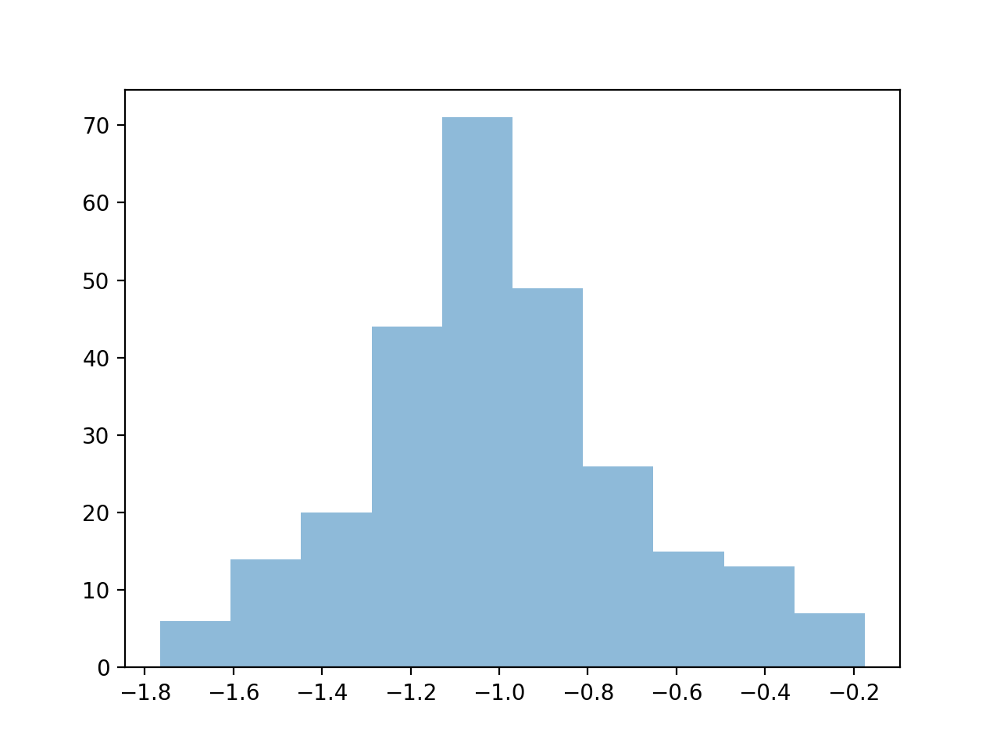

<IPython.core.display.Javascript object>


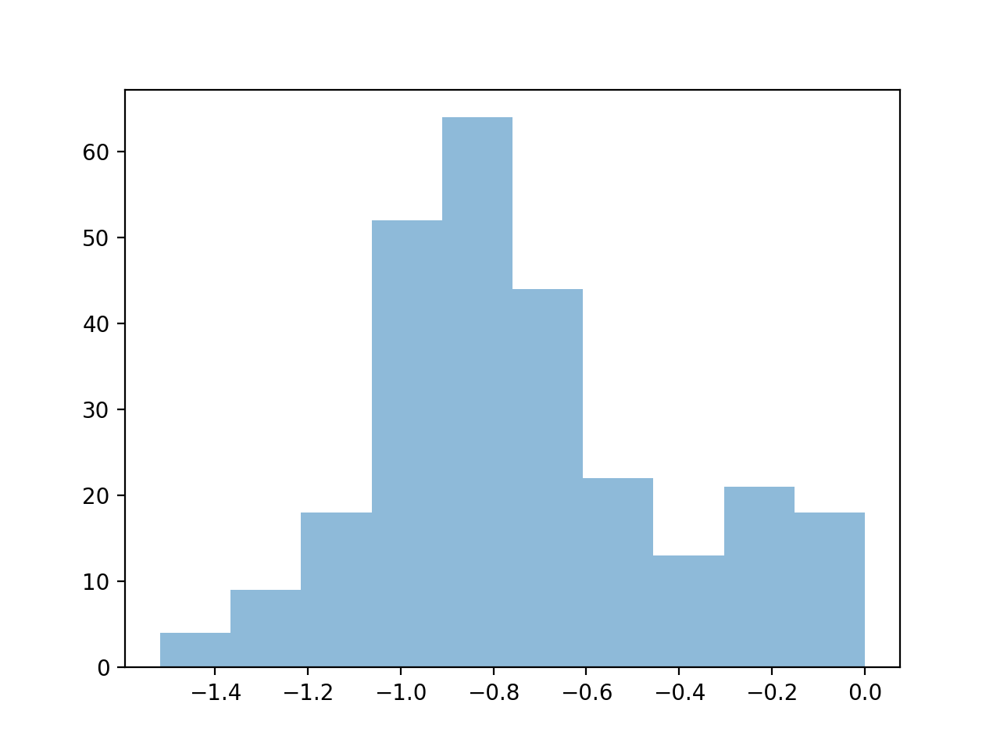

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


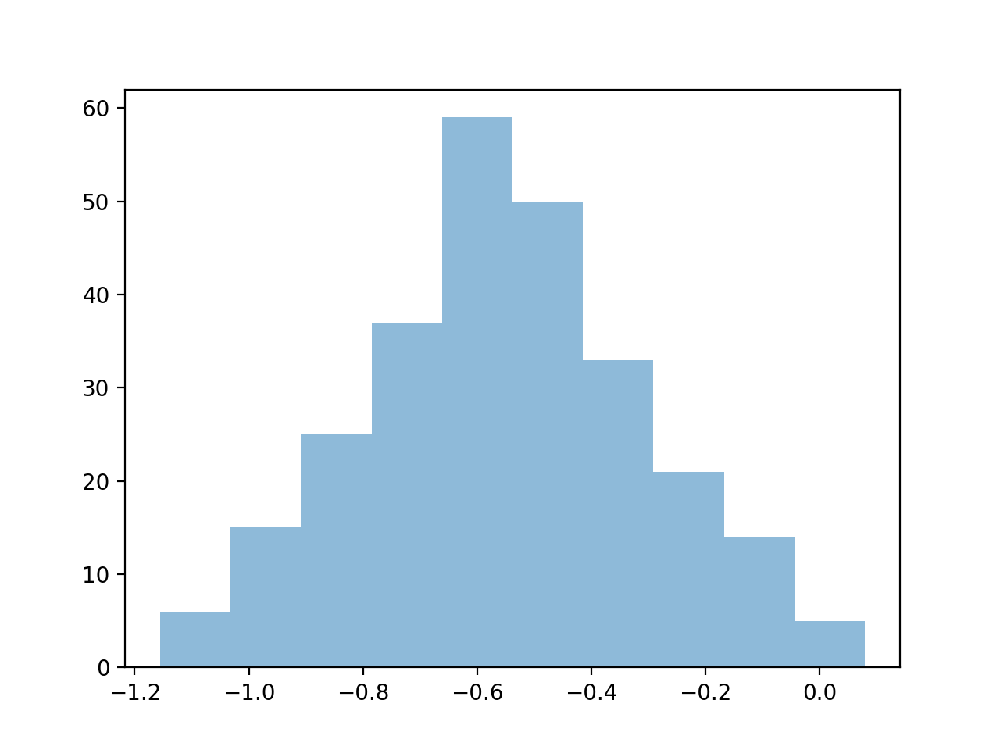

In [197]:
lcutoff = 20
itype2 = 1
for itype1 in [0,2,3]:
    plt.figure()
    for ifit in range(nfits):
        plt.hist(Wmys[ifit][losses[ifit]<lcutoff,itype1,itype2],alpha=0.5)

plt.figure()
for ifit in range(nfits):
    plt.hist(Wmxs[ifit][losses[ifit]<lcutoff,1,1],alpha=0.5)

In [198]:
# lcutoff = 25
itype1,itype2 = 0,1
for ifit in range(1,nfits):
    plt.figure(figsize=(2.5,2.5))
    sca.scatter_size_contrast_errorbar(YYs[ifit][losses[ifit]<lcutoff][:,:,:,itype1],YYs[ifit][losses[ifit]<lcutoff][:,:,:,itype2])
    

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


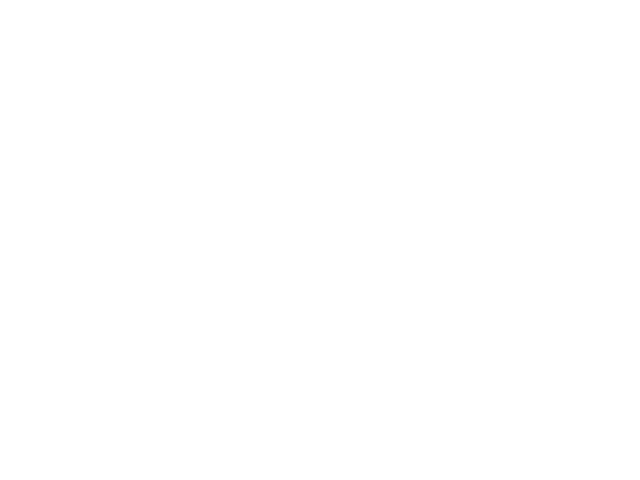

NameError: name 'YYhat' is not defined

In [179]:
itype1,itype2 = 0,1
plt.figure()
xdata,ydata = [YYhat[:,itype].reshape((6,6)) for itype in [itype1,itype2]]
sca.scatter_size_contrast(xdata,ydata)
plt.title(np.corrcoef(xdata.flatten(),ydata.flatten())[0,1])

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


<IPython.core.display.Javascript object>


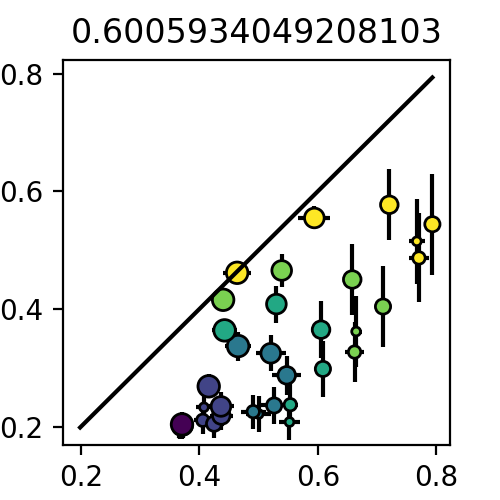

In [87]:
# lcutoff = 35
itype1,itype2 = 0,1
for ifit in range(nfits):
    plt.figure(figsize=(2.5,2.5))
    xdata,ydata = [YYs_no_res[ifit][losses[ifit]<lcutoff][:,:,:,itype] for itype in [itype1,itype2]]
    sca.scatter_size_contrast_errorbar(xdata,ydata)
    plt.title(np.corrcoef(xdata.flatten(),ydata.flatten())[0,1])

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


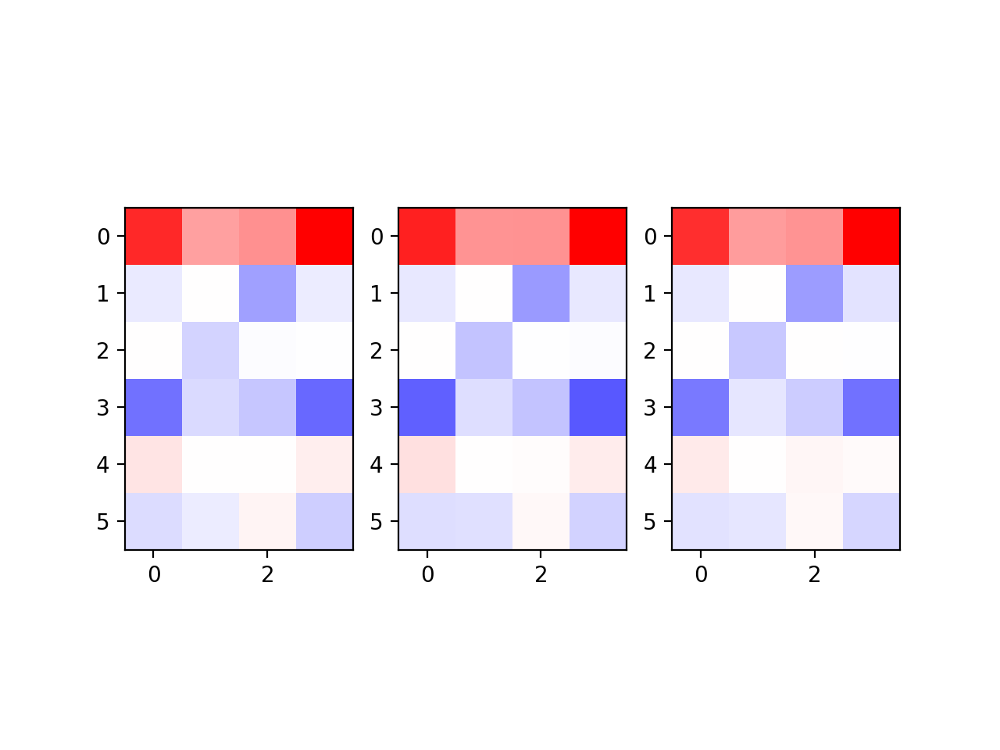

In [1193]:
plt.figure()
for ifit in range(nfits):
    plt.subplot(1,nfits,ifit+1)
    ut.imshow_hot_cold(np.concatenate((np.nanmean(Wmys[ifit][losses[ifit]<12],0),np.nanmean(Wmxs[ifit][losses[ifit]<12],0)),axis=0))
    

<IPython.core.display.Javascript object>


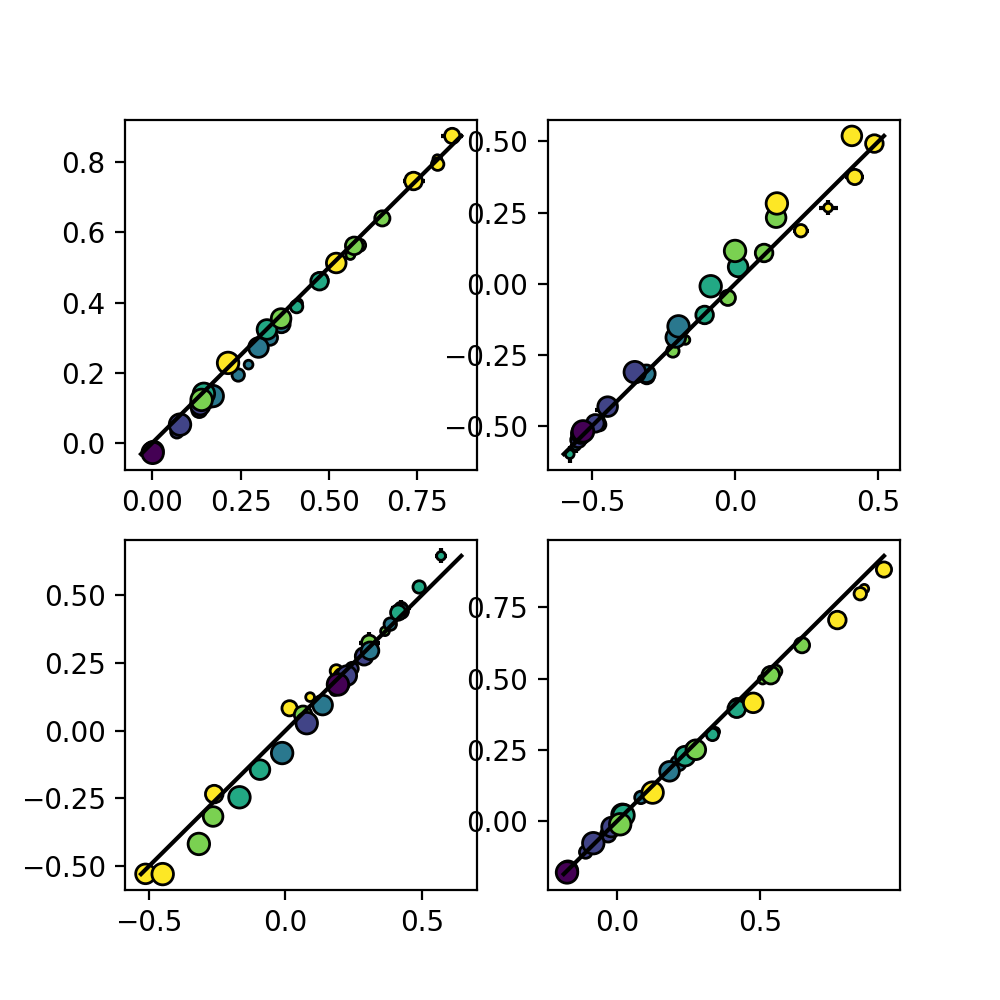

In [1220]:
plt.figure(figsize=(5,5))
for itype in range(4):
    lkat = losses[ifit]<12
    ifit = 2
    good_mdls = [mdl for mdl,ll in zip(mdls[ifit],lkat) if ll]
    resEta = np.concatenate([good_mdls[iwt].resEta[:,itype:itype+1].T for iwt in range(len(good_mdls))],axis=0).reshape((-1,6,6))
    ydata = Etas[ifit][lkat][:,:,:,itype]
    xdata = ydata - resEta
    plt.subplot(2,2,itype+1)
    sca.scatter_size_contrast_errorbar(xdata,ydata)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


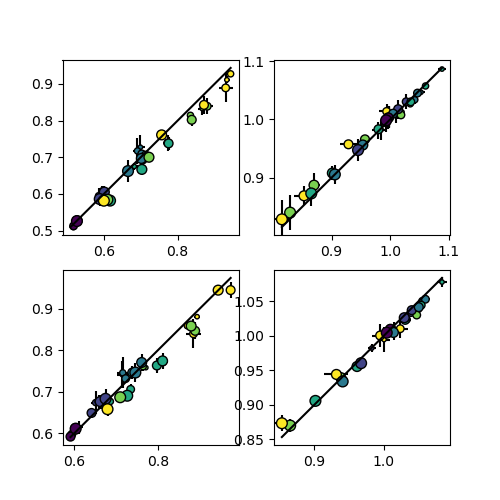

In [1185]:
plt.figure(figsize=(5,5))
for itype in range(4):
    ifit = 1
    xdata = XXs[ifit][losses[ifit]<12,:,:,itype]
    ifit = 2
    ydata = XXs[ifit][losses[ifit]<12,:,:,itype]
    plt.subplot(2,2,itype+1)
    sca.scatter_size_contrast_errorbar(xdata,ydata)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


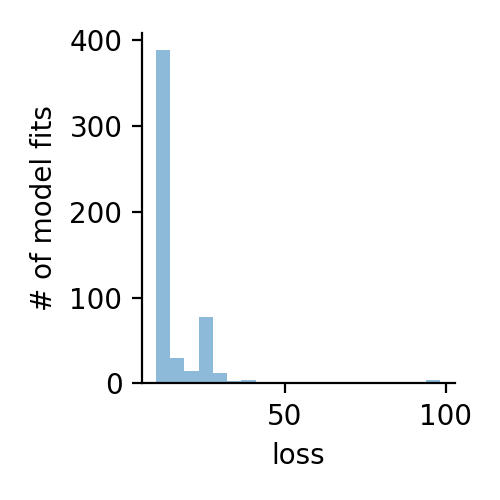

In [1148]:
plt.figure(figsize=(2.5,2.5))

fit_lbls = ['201206a']#['201128a','201130a','201130b']#['201125d','201126a','201127a','201127c']#['201125b','201125c','201125d','201125e']

weights_files,weights_filenames = [],[]

for ifit,fit_lbl in enumerate(fit_lbls):
    
    these_weights_files,these_weights_filenames = get_weights_files(fit_lbl)

    weights_files = weights_files + these_weights_files
    weights_filenames = weights_filenames + these_weights_filenames
    
nfits = 1

wt_dicts = [{} for ifit in range(nfits)]

Ks,Wmys,Wmxs,s02s,bls,YYs,XXs,Etas,h1s,h2s,losses,couplings,couplings_pcpv,Xcouplings,phis,mono_couplings = [[None for ifit in range(nfits)] for ivar in range(16)]
    
for ifit in range(nfits):#,fit_lbl in enumerate(fit_lbls):

    nfiles = len(weights_files)
    # Ts = np.zeros((nfiles,nQ))
    Ks[ifit] = np.zeros((nfiles,nQ))
    Wmys[ifit] = np.zeros((nfiles,nQ,nQ))
    Wmxs[ifit] = np.zeros((nfiles,nP,nQ))
    s02s[ifit] = np.zeros((nfiles,nQ))
    bls[ifit] = np.zeros((nfiles,nQ))
    YYs[ifit] = np.zeros((nfiles,6,6,nQ*nS*nT))
    XXs[ifit] = np.zeros((nfiles,6,6,nP*nS*nT))
    Etas[ifit] = np.zeros((nfiles,6,6,nQ*nS*nT))
    # Eta1s = np.zeros((nfiles,6,6,nQ*nS*nT))
    # Eta2s = np.zeros((nfiles,6,6,nQ*nS*nT))
    h1s[ifit] = np.zeros((nfiles,))
    h2s[ifit] = np.zeros((nfiles,))
    losses[ifit] = np.zeros((nfiles,))
    couplings[ifit] = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
    mono_couplings[ifit] = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
    # couplings with phiPV = phiPC fixed
    couplings_pcpv[ifit] = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
    Xcouplings[ifit] = np.zeros((nfiles,6,6,nP*nS*nT,nQ*nS*nT))
    phis[ifit] = np.zeros((nfiles,6,6,nQ*nS*nT))
    for iwt,weights_file in enumerate(weights_files):
        Wstar_dict = np.load(weights_file,allow_pickle=True)[()]
    #     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h = Wstar_dict['as_list']
        wt_dicts[ifit] = Wstar_dict['wt_dict']
        try:
            Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl = Wstar_dict['as_list']
            amp = np.ones((nQ*nS*nT,))
        except:
            Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl,amp = Wstar_dict['as_list']
        losses[ifit][iwt] = Wstar_dict['loss']
    #     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,h3,Eta1,Eta2,Eta3 = Wstar_dict['as_list']
        WWmy = calnet.utils.gen_Weight_k_kappa_t(Wmy,K,kappa,T,nS=nS,nT=nT)
        WWmx = calnet.utils.gen_Weight_k_kappa_t(Wmx,K,kappa,T,nS=nS,nT=nT)
        tiled_s02 = np.tile(s02,nS*nT)
    #     Ts[iwt] = T
        Ks[ifit][iwt] = K
        Wmys[ifit][iwt] = Wmy
        Wmxs[ifit][iwt] = Wmx
        s02s[ifit][iwt] = s02
        bls[ifit][iwt] = bl
        YYs[ifit][iwt] = sim_utils.f_miller_troyer(Eta,Xi**2+tiled_s02).reshape((6,6,nQ*nS*nT)) + np.tile(bl,nS*nT)[np.newaxis]
        XXs[ifit][iwt] = XX.reshape((6,6,nP*nS*nT))
        Etas[ifit][iwt] = Eta.reshape((6,6,nQ*nS*nT))
        h1s[ifit][iwt] = h1
        h2s[ifit][iwt] = h2
    #     Eta1s[iwt] = Eta1.reshape((6,6,nQ*nS*nT))
    #     Eta2s[iwt] = Eta2.reshape((6,6,nQ*nS*nT))
        for istim in range(nN):
            iistim,jjstim = np.unravel_index(istim,(6,6))
            phis[ifit][iwt,iistim,jjstim] = calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+tiled_s02)
            phipcpv = phis[ifit][iwt,iistim,jjstim].copy()
            phipcpv[3::4] = phipcpv[0::4]
            Phi = np.diag(phis[ifit][iwt,iistim,jjstim])
            Phipcpv = np.diag(phipcpv)
            couplings[ifit][iwt,iistim,jjstim] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
            mono_couplings[ifit][iwt,iistim,jjstim] = (WWmy @ Phi)
            Xcouplings[ifit][iwt,iistim,jjstim] = WWmx @ Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
            couplings_pcpv[ifit][iwt,iistim,jjstim] = Phipcpv @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phipcpv)
    # couplings = np.reshape(couplings,(couplings.shape[0],6,6,couplings.shape[2],couplings.shape[3]))
    # Xcouplings = np.reshape(Xcouplings,(Xcouplings.shape[0],6,6,Xcouplings.shape[2],Xcouplings.shape[3]))

    # plt.figure(figsize=(2.5,2.5))
    plt.hist(losses[ifit][losses[ifit]<1e2],bins=20,alpha=0.5)
    ut.erase_top_right()
    plt.xlabel('loss')
    plt.ylabel('# of model fits')
    plt.tight_layout()
# plt.savefig('figures/model_fits_random_inits_simulate2_true.eps')


In [187]:
nfiles = len(weights_files)
# couplings with one of the phi's fixed, phiI = mean(phiI)
couplings_fixed = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT,nQ))
Xcouplings_fixed = np.zeros((nfiles,6,6,nP*nS*nT,nQ*nS*nT,nQ))
# couplings with phiPC = mean(phiPC) and phiPV = mean(phiPV) fixed
couplings_pc_rec_fixed = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
couplings_pcpv_fixed = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
couplings_pcpv_rec_fixed = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
couplings_pcpv_fixed_plus_fixed = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT,nQ))
couplings_pcpv_rec_fixed_plus_fixed = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT,nQ))
mult_mean = 0 # 0 or 1
for iwt,weights_file in enumerate(weights_files):
    Wstar_dict = np.load(weights_file,allow_pickle=True)[()]
    Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl,amp = read_list(Wstar_dict)#['as_list']
#     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2 = Wstar_dict['as_list']
    WWmy = calnet.utils.gen_Weight_k_kappa_t(Wmy,K,kappa,T,nS=nS,nT=nT)
    WWmx = calnet.utils.gen_Weight_k_kappa_t(Wmx,K,kappa,T,nS=nS,nT=nT)
    tiled_s02 = np.tile(s02,nS*nT)
    all_phis = calnet.utils.fprime_miller_troyer(Eta,Xi**2+tiled_s02)
    for icelltype in range(nQ):
        mean_phi = np.mean(all_phis[:,icelltype::nQ])*mult_mean
        for istim in range(nN):
            iistim,jjstim = np.unravel_index(istim,(6,6))        
            these_phis = all_phis[istim].copy()#calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+tiled_s02)
            these_phis[icelltype::nQ] = mean_phi
            Phi = np.diag(these_phis)
            couplings_fixed[iwt,iistim,jjstim,:,:,icelltype] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
            Xcouplings_fixed[iwt,iistim,jjstim,:,:,icelltype] = WWmx @ Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
    mean_phi_pc = np.mean(all_phis[:,0::nQ])*mult_mean
    mean_phi_pv = np.mean(all_phis[:,3::nQ])*mult_mean
    for istim in range(nN):
        iistim,jjstim = np.unravel_index(istim,(6,6))        
        these_phis = all_phis[istim].copy()#calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+tiled_s02)
        
        Phipcrec = np.tile(these_phis[np.newaxis],(nQ*nS*nT,1))
        Phipcrec[0::nQ][:,0::nQ] = mean_phi_pc
        Phi = np.diag(these_phis)
        couplings_pc_rec_fixed[iwt,iistim,jjstim,:,:] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy*Phipcrec)
        
        Phirec = np.tile(these_phis[np.newaxis],(nQ*nS*nT,1))
        Phirec[0::nQ][:,0::nQ] = mean_phi_pc
        Phirec[3::nQ][:,0::nQ] = mean_phi_pc
        Phirec[0::nQ][:,3::nQ] = mean_phi_pv
        Phirec[3::nQ][:,3::nQ] = mean_phi_pv
        Phi = np.diag(these_phis)
        couplings_pcpv_rec_fixed[iwt,iistim,jjstim,:,:] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy*Phirec)
        
        these_phis[0::nQ] = mean_phi_pc
        these_phis[3::nQ] = mean_phi_pv
        Phi = np.diag(these_phis)
        couplings_pcpv_fixed[iwt,iistim,jjstim,:,:] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
        
    for icelltype in range(nQ):
        for istim in range(nN):
            mean_phi = np.mean(all_phis[:,icelltype::nQ])*mult_mean
            iistim,jjstim = np.unravel_index(istim,(6,6))        
            these_phis = all_phis[istim].copy()#calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+tiled_s02)
            these_phis[0::nQ] = mean_phi_pc
            these_phis[3::nQ] = mean_phi_pv
            these_phis[icelltype::nQ] = mean_phi
            Phi = np.diag(these_phis)
            couplings_pcpv_fixed_plus_fixed[iwt,iistim,jjstim,:,:,icelltype] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
            
            these_phis = all_phis[istim].copy()
            these_phis[icelltype::nQ] = mean_phi
            Phi = np.diag(these_phis)
            Phirec = np.tile(these_phis[np.newaxis],(nQ*nS*nT,1))
            Phirec[0::nQ][:,0::nQ] = mean_phi_pc
            Phirec[3::nQ][:,0::nQ] = mean_phi_pc
            Phirec[0::nQ][:,3::nQ] = mean_phi_pv
            Phirec[3::nQ][:,3::nQ] = mean_phi_pv
            couplings_pcpv_rec_fixed_plus_fixed[iwt,iistim,jjstim,:,:,icelltype] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy*Phirec)
            # couplings = np.reshape(couplings,(couplings.shape[0],6,6,couplings.shape[2],couplings.shape[3]))
# Xcouplings = np.reshape(Xcouplings,(Xcouplings.shape[0],6,6,Xcouplings.shape[2],Xcouplings.shape[3]))

In [1083]:
Etas[ifit].shape

(372, 6, 6, 8)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


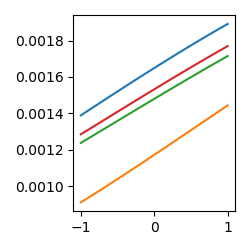

In [1118]:
npix = 100
x = np.linspace(-1,1,npix)
plt.figure(figsize=(2.5,2.5))
ydata = np.zeros((Wmxs[ifit].shape[0],4)+x.shape)
nsd = 1
for iwt in range(1):#Wmxs[ifit].shape[0]):
    for itype in range(4):
        mn = Etas[ifit][iwt,:,:,itype].mean()
        sd = Etas[ifit][iwt,:,:,itype].std()
        ydata[iwt,itype] = calnet.utils.fprime_miller_troyer(np.linspace(mn-nsd*sd,mn+nsd*sd,npix),s02s[ifit][iwt,itype])
# for iwt in range(25):
#     plt.subplot(5,5,iwt+1)
for itype in range(4):
    plt.plot(x,np.nanmean(ydata[:,itype],0))
plt.tight_layout()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


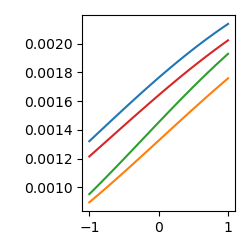

In [1119]:
npix = 100
x = np.linspace(-1,1,npix)
plt.figure(figsize=(2.5,2.5))
ydata = np.zeros((Wmxs[ifit].shape[0],4)+x.shape)
nsd = 1
for iwt in range(1):#Wmxs[ifit].shape[0]):
    for itype in range(4):
        mn = Etas[ifit][iwt,:,:,itype].min()
        mx = Etas[ifit][iwt,:,:,itype].max()
        ydata[iwt,itype] = calnet.utils.fprime_miller_troyer(np.linspace(mn,mx,npix),s02s[ifit][iwt,itype])
# for iwt in range(25):
#     plt.subplot(5,5,iwt+1)
for itype in range(4):
    plt.plot(x,np.nanmean(ydata[:,itype],0))
plt.tight_layout()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


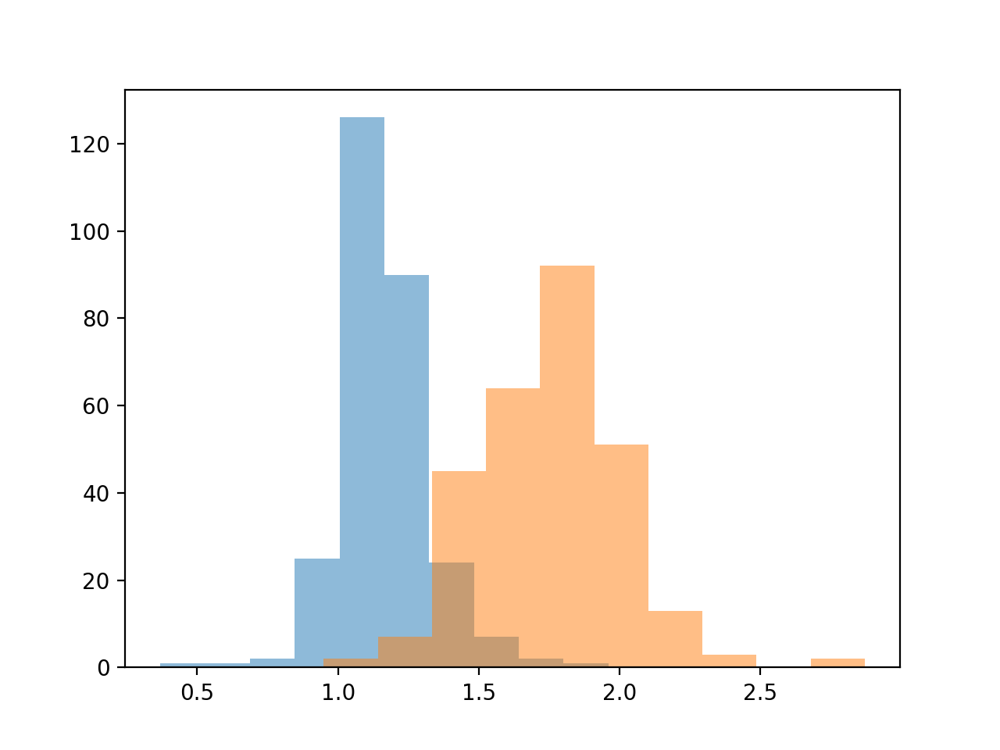

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


<IPython.core.display.Javascript object>


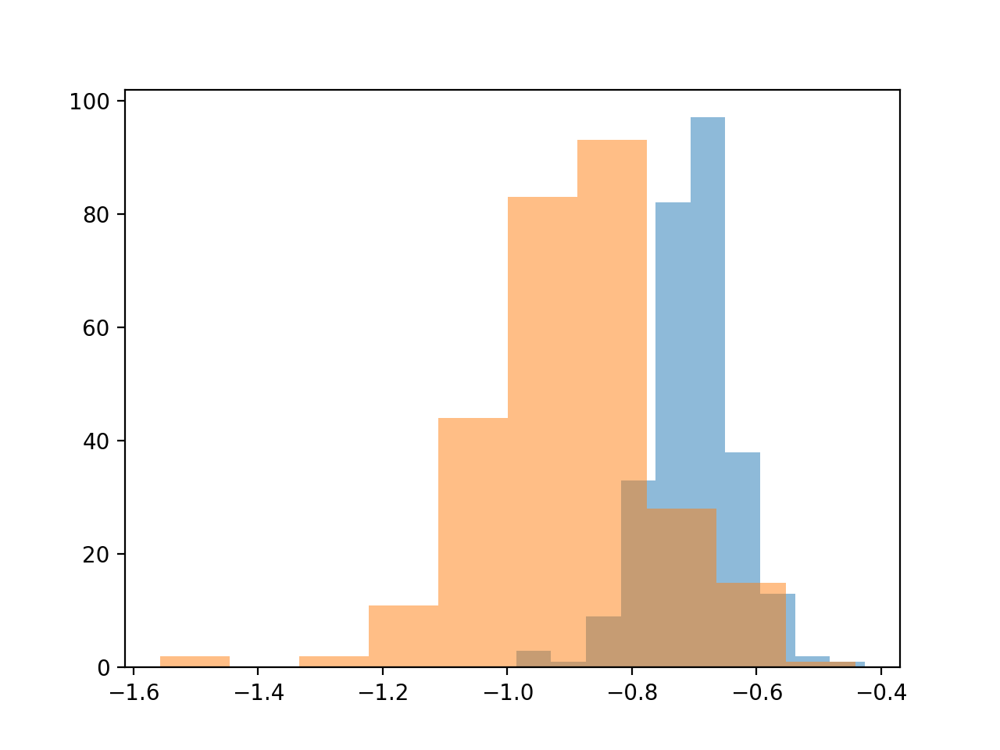

In [1034]:
plt.figure()
for itype in [0,3]:
    plt.hist(s02s[ifit][:,itype],alpha=0.5)
plt.figure()
for itype in [0,3]:
    plt.hist(Wmxs[ifit][:,1,itype],alpha=0.5)

In [1141]:
losses[ifit]


array([12.68590788, 14.354525  , 13.13657839, 13.42319556, 13.36726354,
       11.49873089, 13.06214835, 12.52885524, 10.07452096, 12.57960735,
       12.74712389, 12.83542033, 13.22014821, 14.14075917, 11.64193505,
       11.04062218, 12.64476932, 11.89767177, 12.38599283, 13.79902162,
       13.03980893, 13.08294165, 10.08828253, 13.62139015, 12.49869233,
       12.18296364, 12.50553624, 12.15731516, 12.56397779, 11.77912701,
       13.08647769, 12.63557376, 13.08474166, 12.53200208, 12.36877229,
       12.62556736, 13.48303605, 12.70279561, 12.45666542, 13.51351804,
       12.07722997, 12.17697707, 11.55062254, 12.85666718, 12.74737567,
       13.34587681, 13.0233595 , 12.91386805, 12.98030838, 11.30394159,
       13.18511317, 12.36534762, 13.2116514 , 12.8583433 , 11.76591745,
       11.95196225, 11.54796083, 13.04887977, 13.84772476, 12.8247756 ,
       12.64142871, 13.25893396, 12.11931949, 12.90319902, 12.35144944,
       11.44636014, 12.25284954, 12.66354963, 13.30001863, 13.00

In [1144]:
fit_lbls = ['201203g']#['201128a','201130a','201130b']#['201125d','201126a','201127a','201127c']#['201125b','201125c','201125d','201125e']

weights_files,weights_filenames = [],[]

for ifit,fit_lbl in enumerate(fit_lbls):
    
    these_weights_files,these_weights_filenames = get_weights_files(fit_lbl)

    weights_files = weights_files + these_weights_files
    weights_filenames = weights_filenames + these_weights_filenames
    
ifit = 0

low_loss_weights_files = [wf for wf,loss in zip(weights_files,losses[ifit]<np.nanpercentile(losses[ifit],10)) if loss]
np.save('low_loss_no_opto_weights_files_macbook_%s.npy'%'_'.join(fit_lbls),low_loss_weights_files)
low_loss_weights_files = [s.replace('/Users/dan/Documents/notebooks/mossing-PC/shared_data/','/home/dan/') for s in low_loss_weights_files]


In [1143]:
np.save('low_loss_no_opto_weights_files_%s.npy'%'_'.join(fit_lbls),low_loss_weights_files)


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


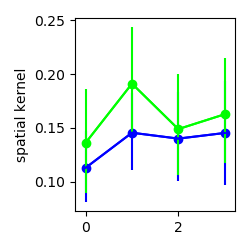

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.11117578551771423
0.1441068899367982


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


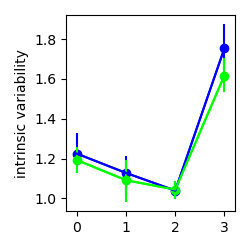

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.6445888671470692
1.5333260364148809


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:20: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


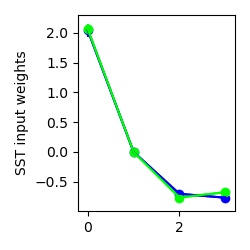

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.9294217447070567
1.9758276661305596


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:26: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


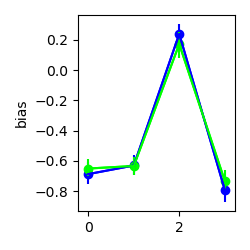

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.15332765418691616
0.07950981726977811


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:32: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


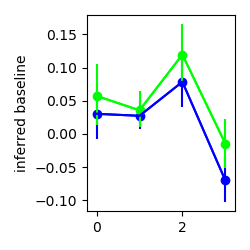

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.04074283855420436
0.07456881800042177


In [184]:
cs = [np.array((0,0,1))[np.newaxis],np.array((0,1,0))[np.newaxis],np.array((0,0,0.5))[np.newaxis],np.array((0,0.5,0))[np.newaxis]]

nfits = len(losses)
low_loss = [None for ifit in range(nfits)]
for ifit in range(nfits):
    low_loss[ifit] = (losses[ifit] < 35)#(losses[ifit] < np.nanpercentile(losses[ifit],1)) #,1

plt.figure(figsize=(2.5,2.5))
for ifit in range(nfits):
    ut.plot_bootstrapped_errorbars_hillel(np.arange(4),Ks[ifit][low_loss[ifit]][:,np.newaxis,:],colors=cs[ifit])
    plt.ylabel('spatial kernel')
    plt.tight_layout()
    
plt.figure(figsize=(2.5,2.5))
for ifit in range(nfits):
    ut.plot_bootstrapped_errorbars_hillel(np.arange(4),s02s[ifit][low_loss[ifit]][:,np.newaxis,:],colors=cs[ifit])
    plt.ylabel('intrinsic variability')
    plt.tight_layout()
    
plt.figure(figsize=(2.5,2.5))
for ifit in range(nfits):
    ut.plot_bootstrapped_errorbars_hillel(np.arange(4),Wmys[ifit][low_loss[ifit]][:,:,1:2].transpose((0,2,1)),colors=cs[ifit])
    plt.ylabel('SST input weights')
    plt.tight_layout()
    
plt.figure(figsize=(2.5,2.5))
for ifit in range(nfits):
    ut.plot_bootstrapped_errorbars_hillel(np.arange(4),Wmxs[ifit][low_loss[ifit]][:,1:2,:],colors=cs[ifit])
    plt.ylabel('bias')
    plt.tight_layout()
    
plt.figure(figsize=(2.5,2.5))
for ifit in range(nfits):
    ut.plot_bootstrapped_errorbars_hillel(np.arange(4),bls[ifit][low_loss[ifit]][:,np.newaxis,:],colors=cs[ifit])
    plt.ylabel('inferred baseline')
    plt.tight_layout()

<IPython.core.display.Javascript object>


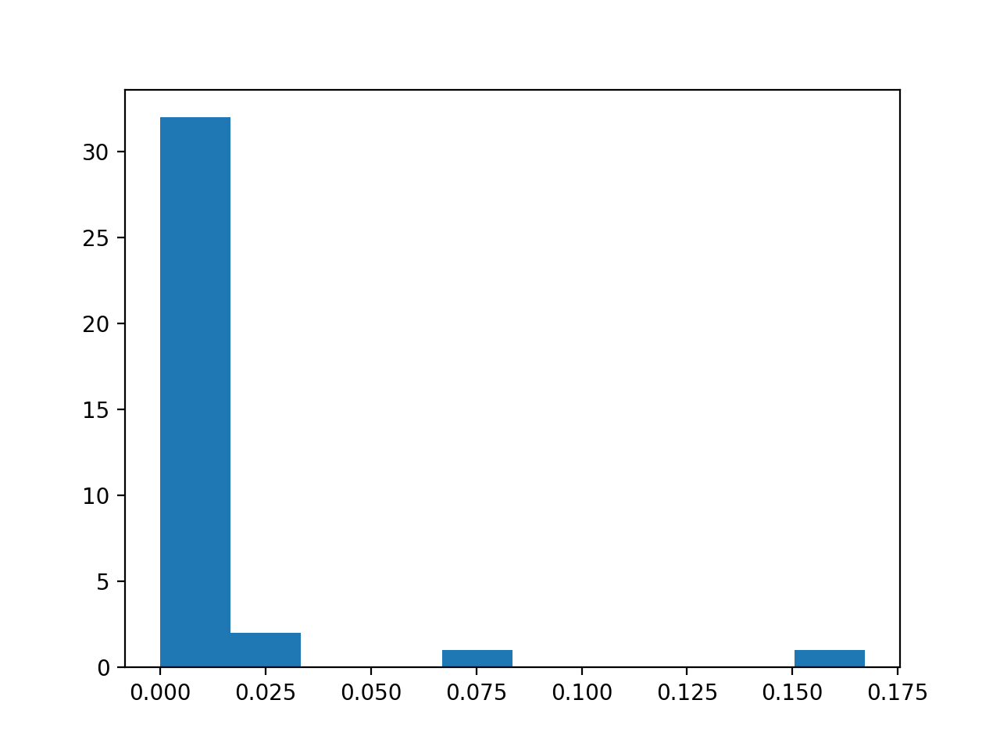

(array([32.,  2.,  0.,  0.,  1.,  0.,  0.,  0.,  0.,  1.]),
 array([0.        , 0.01671743, 0.03343486, 0.05015229, 0.06686972,
        0.08358715, 0.10030458, 0.11702201, 0.13373944, 0.15045687,
        0.1671743 ]),
 <a list of 10 Patch objects>)

In [56]:
plt.figure()
plt.hist(Wmxs[ifit][low_loss[ifit]][:,0,2])

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


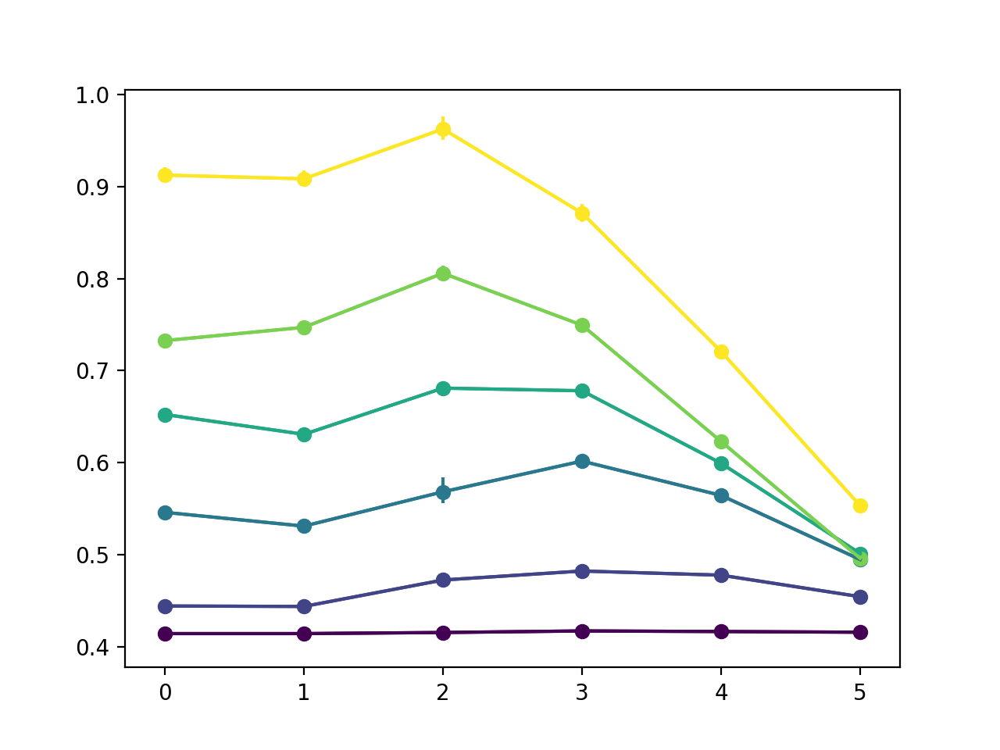

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

0.9489983009055721


In [956]:
ifit = -1
itype = 0
plt.figure()
ut.plot_bootstrapped_errorbars_hillel(np.arange(6),YYs[ifit][low_loss[ifit]][:,:,:,itype].transpose((0,2,1)))


In [516]:
print(fit_lbls)

['201127c']


In [517]:
losses[5][:10]

IndexError: list index out of range

<IPython.core.display.Javascript object>


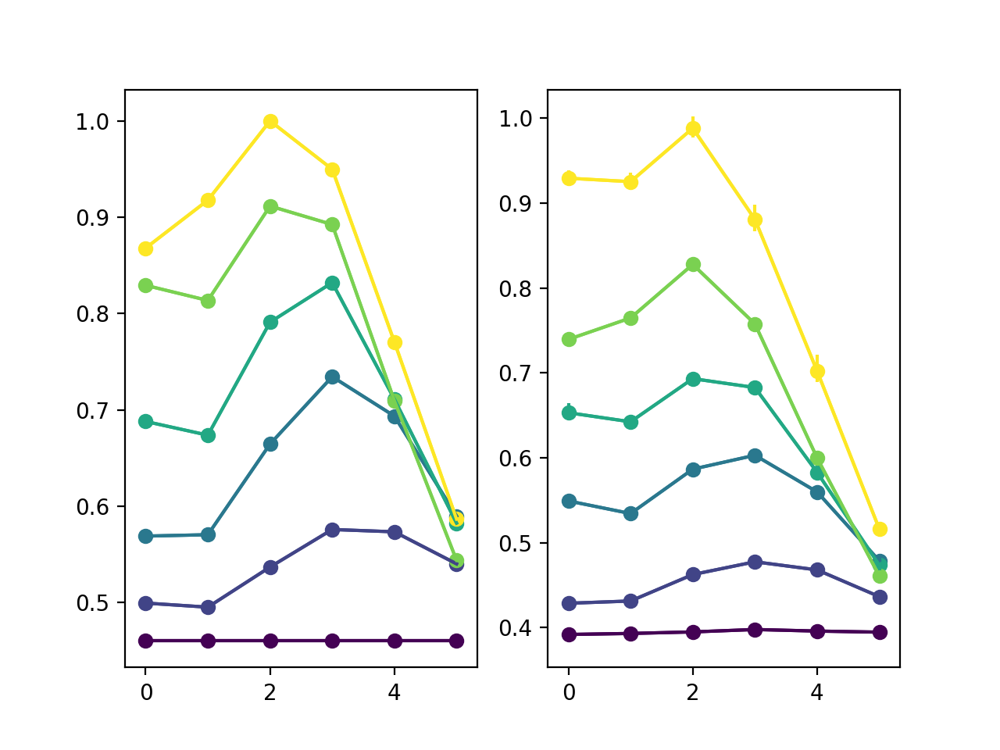

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

1.0000000000000042
0.9740078899505042


In [526]:
ifit = -1
itype = 0
plt.figure()
plt.subplot(1,2,1)
ut.plot_bootstrapped_errorbars_hillel(np.arange(6),YYhat[:,itype].reshape((1,6,6)).transpose((0,2,1)))
plt.subplot(1,2,2)
# ut.plot_bootstrapped_errorbars_hillel(np.arange(6),YYs[ifit][low_loss[ifit]][:,:,:,itype].transpose((0,2,1)))
ut.plot_bootstrapped_errorbars_hillel(np.arange(6),YYs[ifit][low_loss[ifit]][:,:,:,itype].transpose((0,2,1)))

<IPython.core.display.Javascript object>


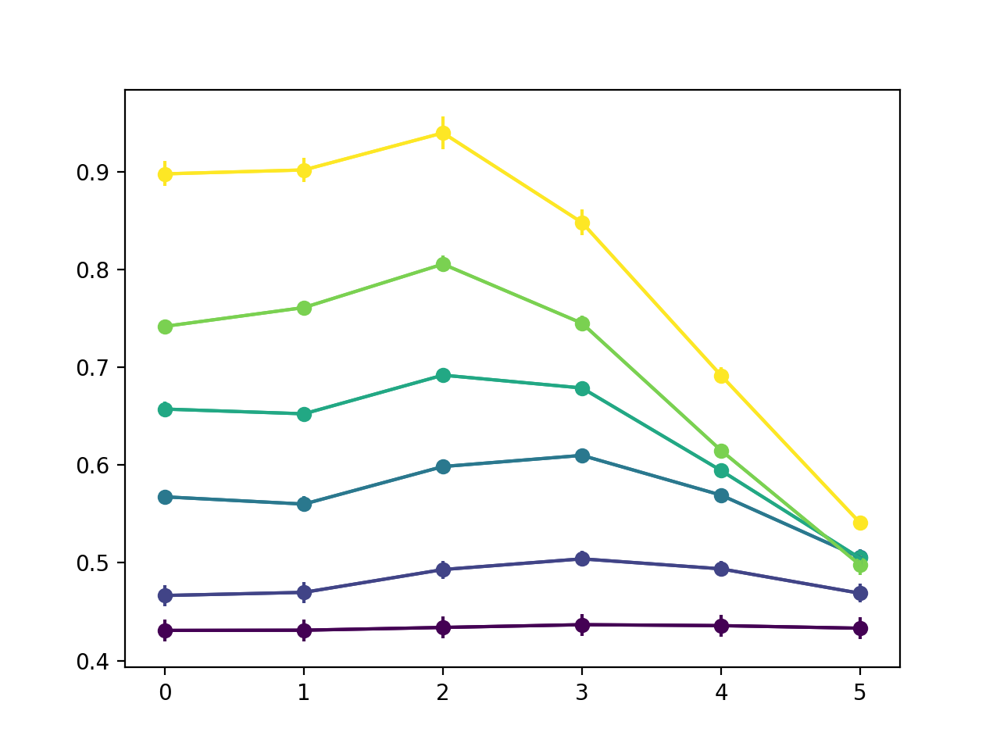

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

0.9226105616764463


In [519]:
ifit = 0
itype = 0
plt.figure()
ut.plot_bootstrapped_errorbars_hillel(np.arange(6),YYs[ifit][low_loss[ifit]][:,:,:,itype].transpose((0,2,1)))

In [536]:
np.nanmean(Wmys[ifit][low_loss[ifit]],0)

array([[ 4.39987792e+00,  1.88545993e+00,  2.16735726e+00,
         5.20765429e+00],
       [-5.15252630e-01,  0.00000000e+00, -1.67080669e+00,
        -5.63009732e-01],
       [ 0.00000000e+00, -7.70035390e-01, -1.05990107e-03,
        -1.81346659e-02],
       [-2.82233711e+00, -6.74422110e-01, -1.14237378e+00,
        -3.09977032e+00]])

<IPython.core.display.Javascript object>


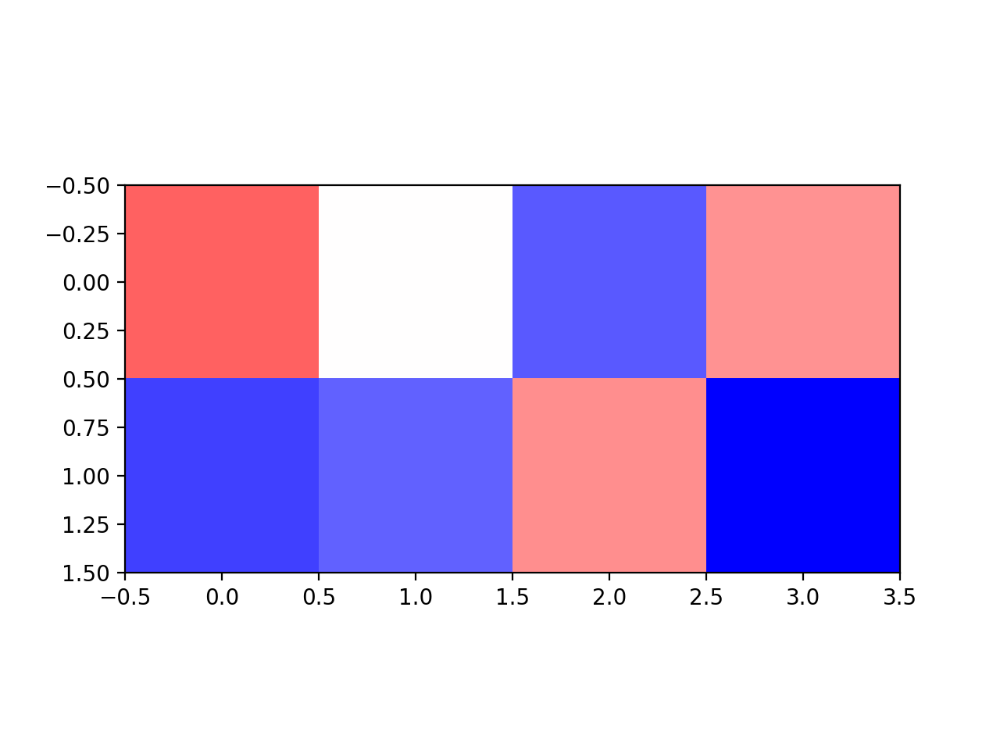

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


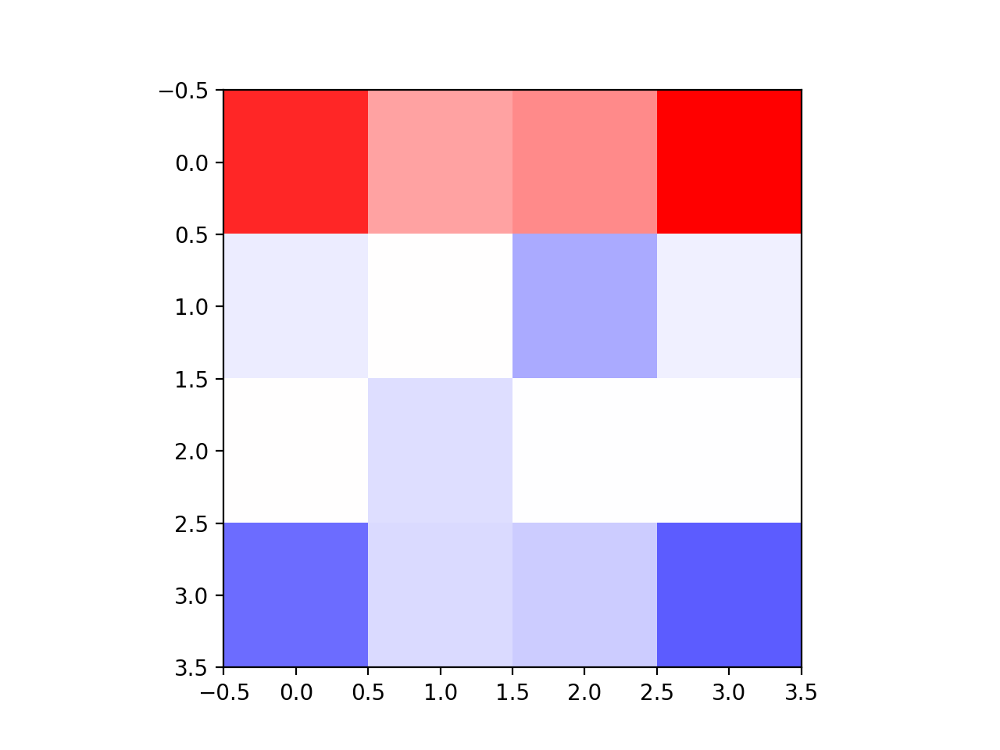

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


<IPython.core.display.Javascript object>


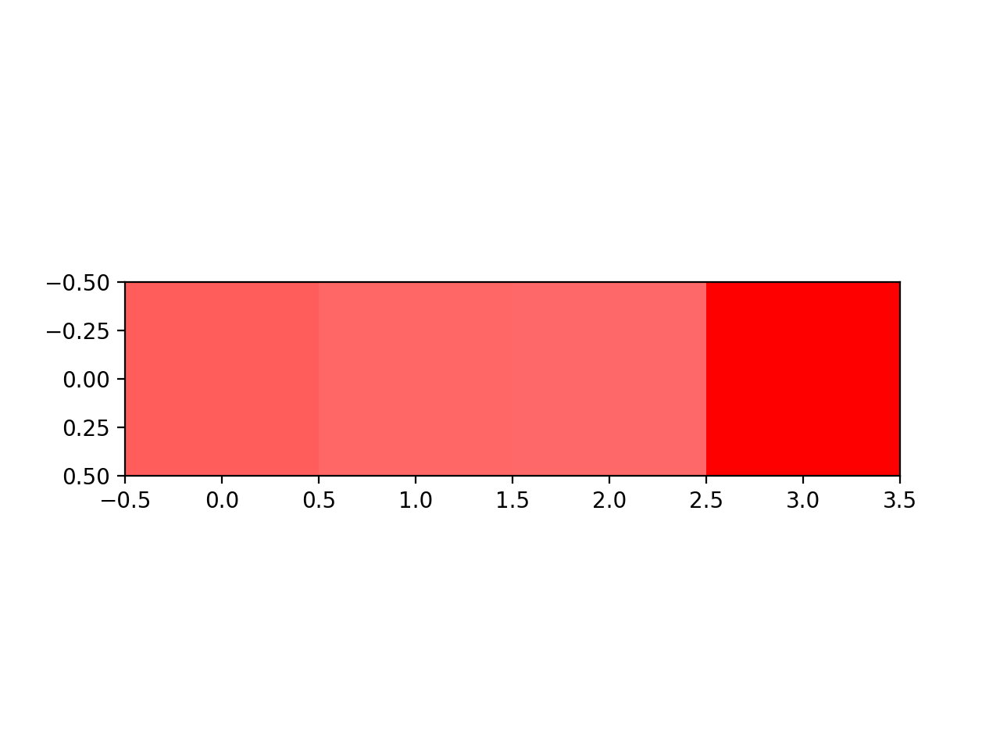

In [579]:
plt.figure()
ut.imshow_hot_cold(np.concatenate([np.nanmean(Wmxs[ifit][low_loss[ifit]],0) for ifit in range(nfits)],axis=0))
plt.figure()
ut.imshow_hot_cold(np.concatenate([np.nanmean(Wmys[ifit][low_loss[ifit]],0) for ifit in range(nfits)],axis=0))
plt.figure()
ut.imshow_hot_cold(np.concatenate([np.nanmean(s02s[ifit][low_loss[ifit]][:,np.newaxis],0) for ifit in range(nfits)],axis=0))

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


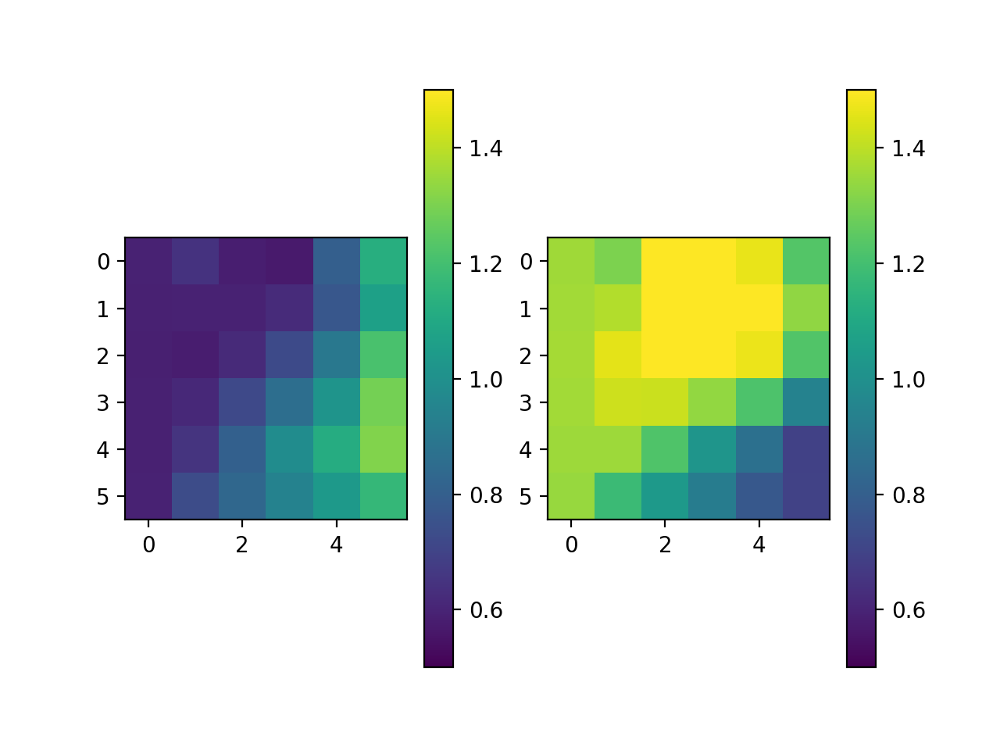

In [737]:
plt.figure()
for itype in range(1,3):
    plt.subplot(1,2,itype-1+1)
    plt.imshow(np.nanmean(mono_couplings[ifit][low_loss[ifit]][:,:,:,0,itype],0),vmin=0.5,vmax=1.5)
    plt.colorbar()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


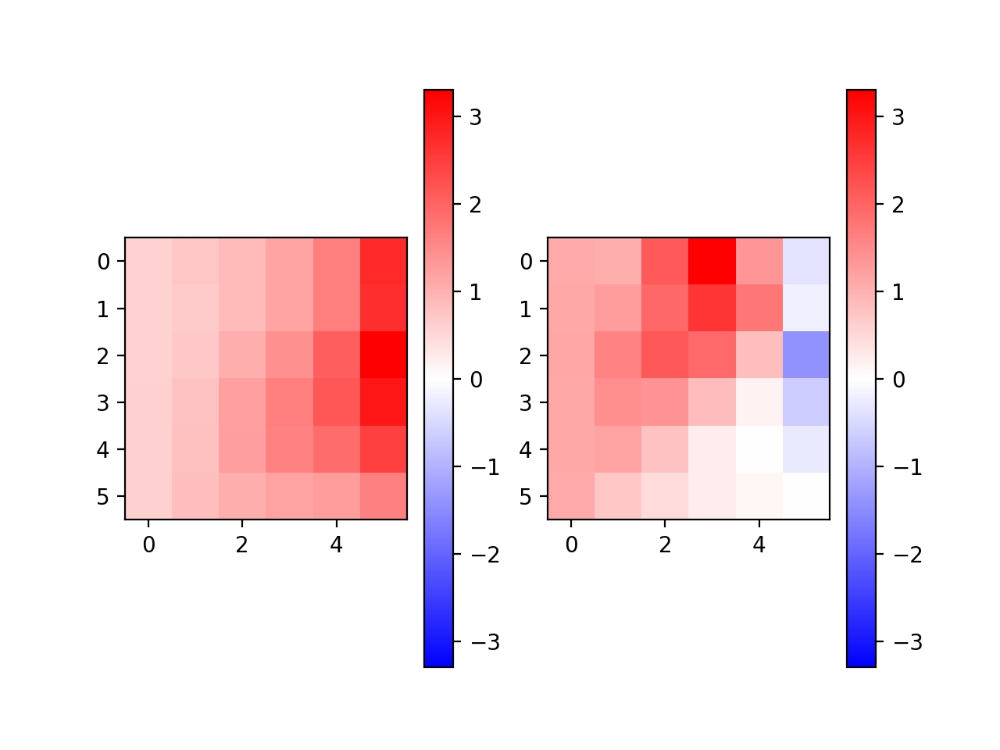

In [580]:
reload(ut)
plt.figure()
for itype in range(1,3):
    plt.subplot(1,2,itype-1+1)
    ut.imshow_hot_cold(np.nanmean(couplings[ifit][low_loss[ifit]][:,:,:,0,itype],0),mx=3.3)#,vmin=0.5,vmax=2.5)
reload(ut)
    plt.colorbar()

In [843]:
print([len(x) for x in [datas,lims,ylbls,colors,fig_lbls]])

[4, 4, 4, 3, 4]


In [802]:
Xcouplings[ifit].shape

(3275, 6, 6, 4, 8)

<IPython.core.display.Javascript object>


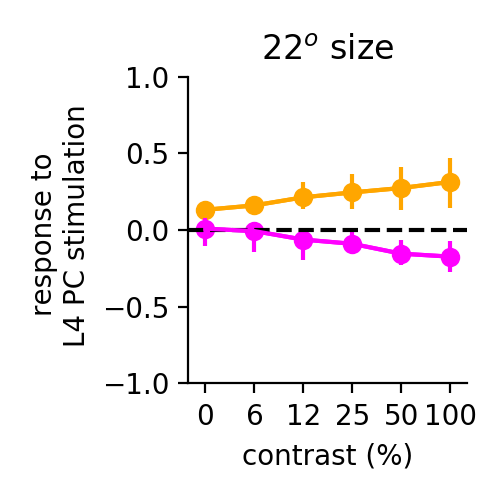

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


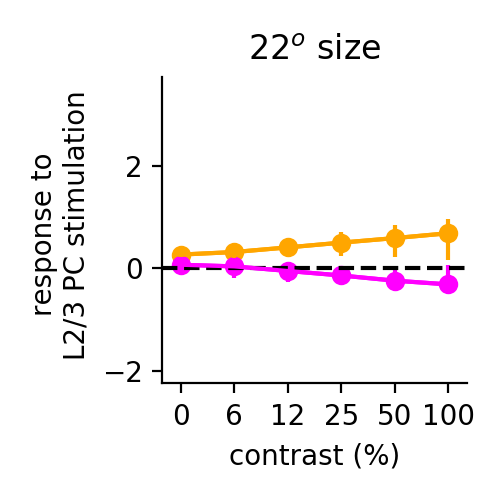

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


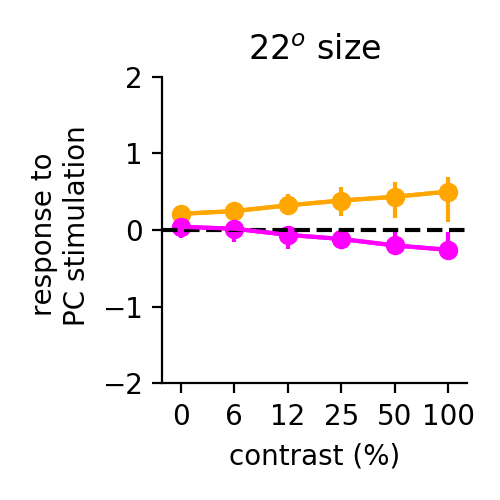

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:32: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


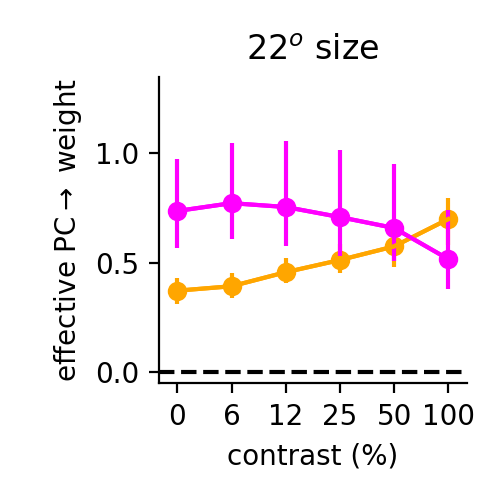

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


In [57]:
couplings_total = couplings.copy()
pc_couplings_total = couplings.copy()
Xcouplings_total = Xcouplings.copy()
mono_couplings_total = mono_couplings.copy()
for ifit in range(nfits):
    couplings_total[ifit] = 0.5*couplings[ifit][:,:,:,:4,:] + 0.5*couplings[ifit][:,:,:,4:,:]
for ifit in range(nfits):
    Xcouplings_total[ifit] = 0.5*Xcouplings[ifit][:,:,:,:2,:] + 0.5*Xcouplings[ifit][:,:,:,2:,:]
for ifit in range(nfits):
    pc_couplings_total[ifit] = 0.5*Xcouplings_total[ifit][:,:,:,0:1,:] + 0.5*couplings_total[ifit][:,:,:,0:1,:]
for ifit in range(nfits):
    mono_couplings_total[ifit] = 0.5*mono_couplings[ifit][:,:,:,:4,:] + 0.5*mono_couplings[ifit][:,:,:,4:,:]

reload(ut)
ucontrast = np.array((0,6,12,25,50,100))
usize = np.array((5,8,13,22,36,60))

cfrac = np.linspace(1,0,3)[:-1]
c_l4 = cfrac[:,np.newaxis]*np.array(((0,1,0)))
c_sst = cfrac[:,np.newaxis]*np.array(((1,0.65,0)))
c_vip = cfrac[:,np.newaxis]*np.array(((1,0,1)))
c_pv = cfrac[:,np.newaxis]*np.array(((0,0,1)))
c_l23 = cfrac[:,np.newaxis]*np.array(((0.5,0.5,0.5)))
colors = [[np.concatenate((c_sst[isize:isize+1],c_vip[isize:isize+1]),axis=0) for isize in range(2)] for iplot in range(4)]

datas = [Xcouplings_total,couplings_total,pc_couplings_total,mono_couplings_total]
lims = [(-1,1),(-2.25,3.75),(-2,2),(-0.05,1.35)]
ylbls = ['response to \n L4 PC stimulation','response to \n L2/3 PC stimulation','response to \n PC stimulation',r'effective PC$\rightarrow$ weight']
fig_lbls = ['pc_sst_vip_xcoupling_no_opto_fit','pc_sst_vip_coupling_no_opto_fit','all_pc_sst_vip_coupling_no_opto_fit','pc_sst_vip_mono_coupling_no_opto_fit']

for cpl,lim,ylbl,cs,fig_lbl in zip(datas,lims,ylbls,colors,fig_lbls):
    plt.figure(figsize=(2.5,2.5))
    for iisize,isize in enumerate([3]):
#         plt.subplot(1,2,iisize+1)
        ut.plot_pct_errorbars_hillel(np.arange(6),cpl[ifit][low_loss[ifit]][:,isize,:,0,1:3].transpose((0,2,1)),pct=(16,84),colors=cs[iisize])
        plt.axhline(0,c='k',linestyle='dashed')
        ut.erase_top_right()
        plt.ylim(lim)
        plt.xticks(np.arange(6),ucontrast)
        plt.title('%d$^o$ size'%usize[isize])
        plt.xlabel('contrast (%)')
#     plt.subplot(1,2,1)
    plt.ylabel(ylbl)
    plt.tight_layout()
#     plt.savefig('figures/%s_22_deg.eps'%fig_lbl)
        

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:32: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


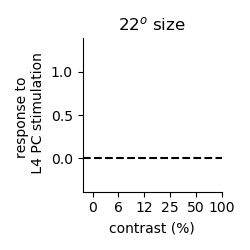

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


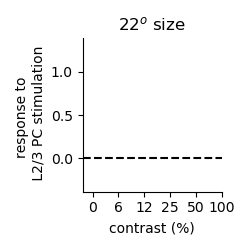

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


In [110]:
couplings_total = couplings.copy()
pc_couplings_total = couplings.copy()
Xcouplings_total = Xcouplings.copy()
mono_couplings_total = mono_couplings.copy()
for ifit in range(nfits):
    couplings_total[ifit] = 0.5*couplings[ifit][:,:,:,:4,:] + 0.5*couplings[ifit][:,:,:,4:,:]
for ifit in range(nfits):
    Xcouplings_total[ifit] = 0.5*Xcouplings[ifit][:,:,:,:2,:] + 0.5*Xcouplings[ifit][:,:,:,2:,:]
for ifit in range(nfits):
    pc_couplings_total[ifit] = 0.5*Xcouplings_total[ifit][:,:,:,0:1,:] + 0.5*couplings_total[ifit][:,:,:,0:1,:]
for ifit in range(nfits):
    mono_couplings_total[ifit] = 0.5*mono_couplings[ifit][:,:,:,:4,:] + 0.5*mono_couplings[ifit][:,:,:,4:,:]

reload(ut)
ucontrast = np.array((0,6,12,25,50,100))
usize = np.array((5,8,13,22,36,60))

cfrac = np.linspace(1,0,3)[:-1]
c_l4 = cfrac[:,np.newaxis]*np.array(((0,1,0)))
c_sst = cfrac[:,np.newaxis]*np.array(((1,0.65,0)))
c_vip = cfrac[:,np.newaxis]*np.array(((1,0,1)))
c_pv = cfrac[:,np.newaxis]*np.array(((0,0,1)))
c_l23 = cfrac[:,np.newaxis]*np.array(((0.5,0.5,0.5)))
colors = [[np.concatenate((c_l23[isize:isize+1],c_pv[isize:isize+1]),axis=0) for isize in range(2)] for iplot in range(4)]

datas = [couplings_total,mono_couplings_total]
lims = [(-1,1),(-2.25,3.75),(-2,2),(-0.05,1.35)]
ylbls = ['response to \n L4 PC stimulation','response to \n L2/3 PC stimulation','response to \n PC stimulation',r'effective PC$\rightarrow$ weight']
fig_lbls = ['pc_sst_vip_xcoupling_no_opto_fit','pc_sst_vip_coupling_no_opto_fit','all_pc_sst_vip_coupling_no_opto_fit','pc_sst_vip_mono_coupling_no_opto_fit']

for cpl,lim,ylbl,cs,fig_lbl in zip(datas,lims,ylbls,colors,fig_lbls):
    plt.figure(figsize=(2.5,2.5))
    for iisize,isize in enumerate([3]):
#         plt.subplot(1,2,iisize+1)
        ut.plot_pct_errorbars_hillel(np.arange(6),cpl[ifit][low_loss[ifit]][:,isize,:,1][:,:,[0,3]].transpose((0,2,1)),pct=(16,84),colors=cs[iisize])
        plt.axhline(0,c='k',linestyle='dashed')
        ut.erase_top_right()
#         plt.ylim(lim)
        plt.xticks(np.arange(6),ucontrast)
        plt.title('%d$^o$ size'%usize[isize])
        plt.xlabel('contrast (%)')
#     plt.subplot(1,2,1)
    plt.ylabel(ylbl)
    plt.tight_layout()
#     plt.savefig('figures/%s_22_deg.eps'%fig_lbl)
        

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  import sys


<IPython.core.display.Javascript object>


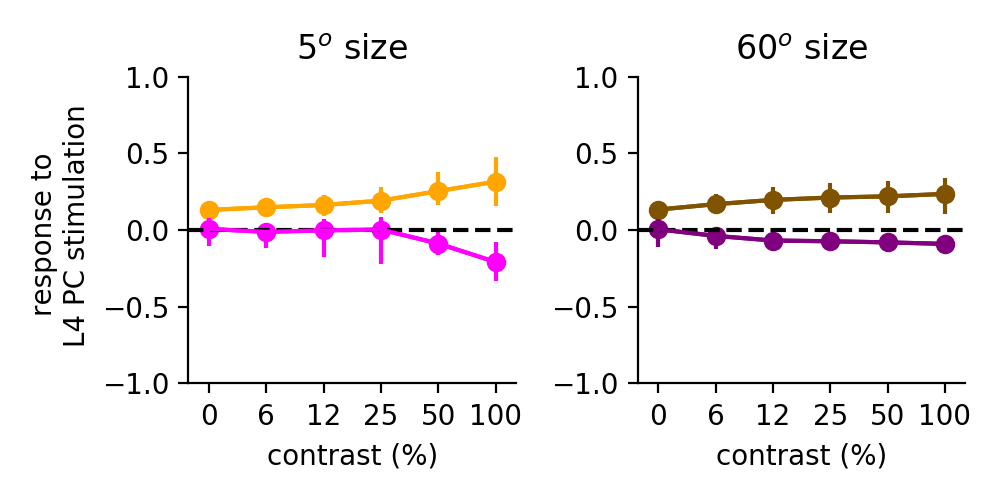

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

<IPython.core.display.Javascript object>


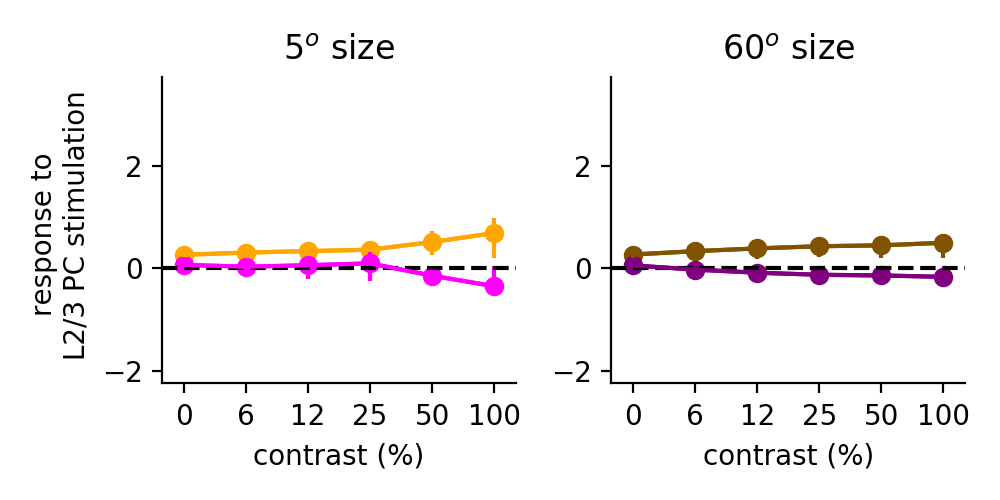

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

<IPython.core.display.Javascript object>


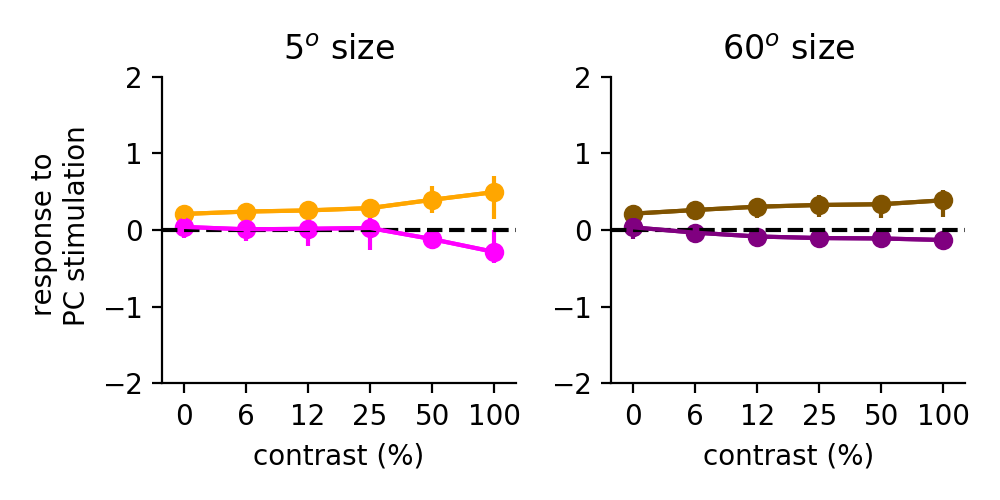

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

<IPython.core.display.Javascript object>


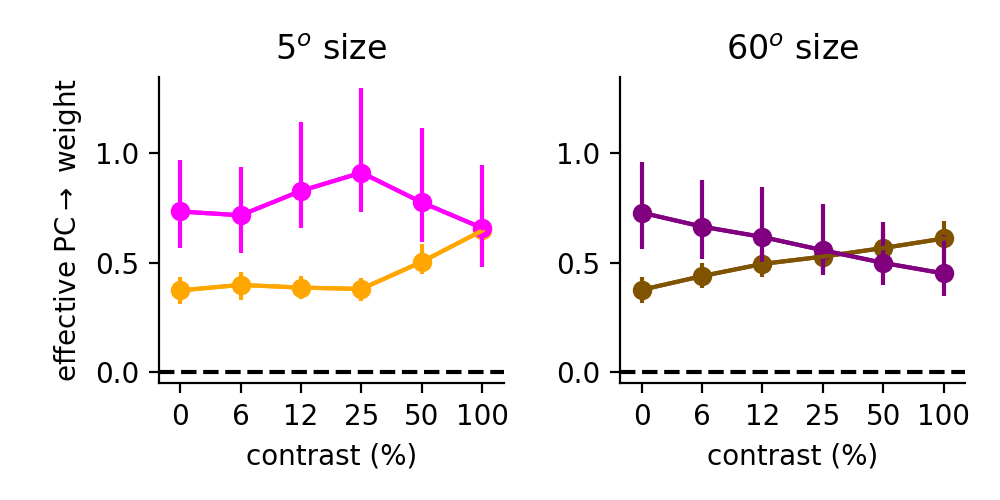

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

In [58]:
datas = [Xcouplings_total,couplings_total,pc_couplings_total,mono_couplings_total]
lims = [(-1,1),(-2.25,3.75),(-2,2),(-0.05,1.35)]
ylbls = ['response to \n L4 PC stimulation','response to \n L2/3 PC stimulation','response to \n PC stimulation',r'effective PC$\rightarrow$ weight']
fig_lbls = ['pc_sst_vip_xcoupling_no_opto_fit','pc_sst_vip_coupling_no_opto_fit','all_pc_sst_vip_coupling_no_opto_fit','pc_sst_vip_mono_coupling_no_opto_fit']

for cpl,lim,ylbl,cs,fig_lbl in zip(datas,lims,ylbls,colors,fig_lbls):
    plt.figure(figsize=(5,2.5))
    for iisize,isize in enumerate([0,5]):
        plt.subplot(1,2,iisize+1)
        ut.plot_pct_errorbars_hillel(np.arange(6),cpl[ifit][low_loss[ifit]][:,isize,:,0,1:3].transpose((0,2,1)),pct=(16,84),colors=cs[iisize])
        plt.axhline(0,c='k',linestyle='dashed')
        ut.erase_top_right()
        plt.ylim(lim)
        plt.xticks(np.arange(6),ucontrast)
        plt.title('%d$^o$ size'%usize[isize])
        plt.xlabel('contrast (%)')
    plt.subplot(1,2,1)
    plt.ylabel(ylbl)
    plt.tight_layout()
#     plt.savefig('figures/%s.eps'%fig_lbl)

In [59]:
# couplings_sst_fixed = couplings.copy()
# for ifit in range(nfits):
#     couplings_sst_fixed[ifit] = couplings_fixed[ifit][:,:,:,:,:,1]

reload(ut)
ucontrast = np.array((0,6,12,25,50,100))
usize = np.array((5,8,13,22,36,60))

cfrac = np.linspace(1,0,3)[:-1]
c_l4 = cfrac[:,np.newaxis]*np.array(((0,1,0)))
c_sst = cfrac[:,np.newaxis]*np.array(((1,0.65,0)))
c_vip = cfrac[:,np.newaxis]*np.array(((1,0,1)))
c_pv = cfrac[:,np.newaxis]*np.array(((0,0,1)))
c_l23 = cfrac[:,np.newaxis]*np.array(((0.5,0.5,0.5)))
colors = [[c_l23[isize:isize+1] for isize in range(2)] for iplot in range(2)]

datas = [couplings,[couplings_fixed[:,:,:,:,1]]]#,couplings_sst_fixed]
lims = [(-1,1),(-1,3.75),(-0.05,1.35)]
ylbls = ['response to \n L4 PC stimulation','response to \n L2/3 PC stimulation',r'effective PC$\rightarrow$ weight']
fig_lbls = ['pc_sst_vip_xcoupling_no_opto_fit','pc_sst_vip_coupling_no_opto_fit','pc_sst_vip_mono_coupling_no_opto_fit']

for cpl,lim,ylbl,cs,fig_lbl in zip(datas,lims,ylbls,colors,fig_lbls):
    plt.figure(figsize=(2.5,2.5))
    for iisize,isize in enumerate([0,5]):
#         plt.subplot(1,2,iisize+1)
        ut.plot_pct_errorbars_hillel(np.arange(6),cpl[ifit][low_loss[ifit]][:,isize,:,4,0][:,np.newaxis],pct=(16,84),colors=cs[iisize])
        plt.axhline(0,c='k',linestyle='dashed')
        ut.erase_top_right()
#         plt.ylim(lim)
        plt.xticks(np.arange(6),ucontrast)
#         plt.title('%d$^o$ size'%usize[isize])
        plt.xlabel('contrast (%)')
#     plt.subplot(1,2,1)
    plt.ylabel(ylbl)
    plt.tight_layout()
#     plt.savefig('figures/%s.eps'%fig_lbl)

NameError: name 'couplings_fixed' is not defined

In [723]:
couplings[0].shape

(956, 6, 6, 8, 8)

In [708]:
cpl[ifit][low_loss[ifit]][:,isize,:,4,0].shape


(24, 6)

In [651]:
phis[ifit].shape

(826, 6, 6, 8)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


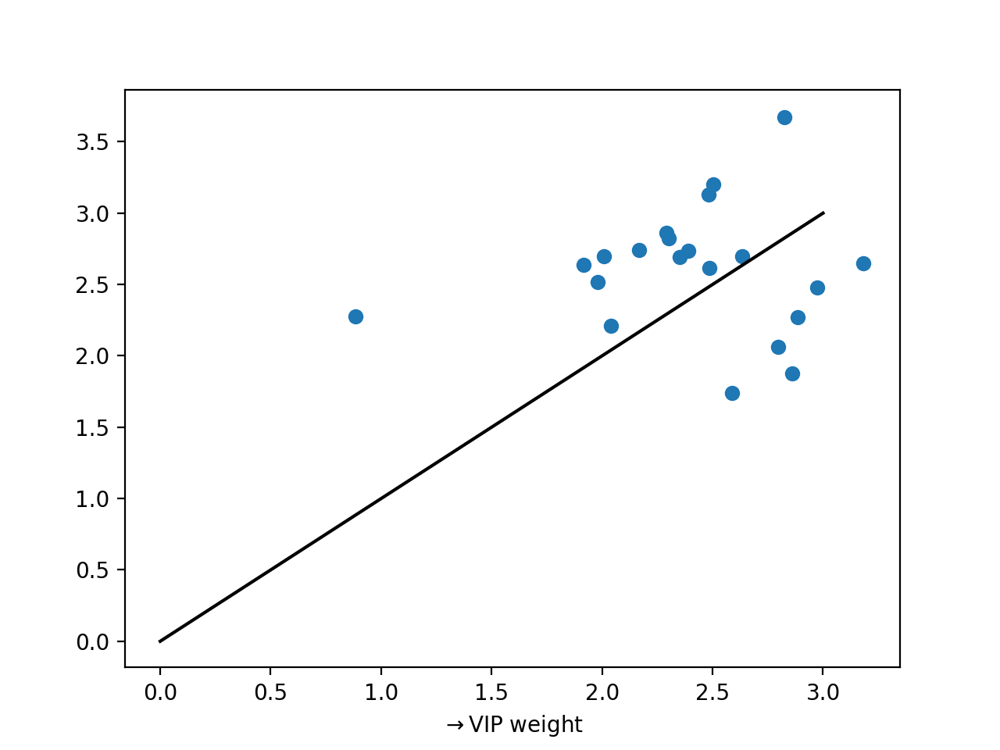

Text(0.5, 0, '$\\rightarrow$VIP weight')

In [658]:
plt.figure()
ifrom = 0
itype1,itype2 = 1,2
xdata = Wmys[ifit][low_loss[ifit]][:,ifrom,itype1]*(1+Ks[ifit][low_loss[ifit]][:,itype1])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype1],1),1)
ydata = Wmys[ifit][low_loss[ifit]][:,ifrom,itype2]*(1+Ks[ifit][low_loss[ifit]][:,itype2])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype2],1),1)
# plt.scatter(Wmys[ifit][low_loss[ifit]][:,0,itype1],Wmys[ifit][low_loss[ifit]][:,0,itype2])
plt.scatter(xdata,ydata)
plt.plot((0,3),(0,3),c='k')
plt.xlabel(r'$\rightarrow$SST weight')
plt.xlabel(r'$\rightarrow$VIP weight')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


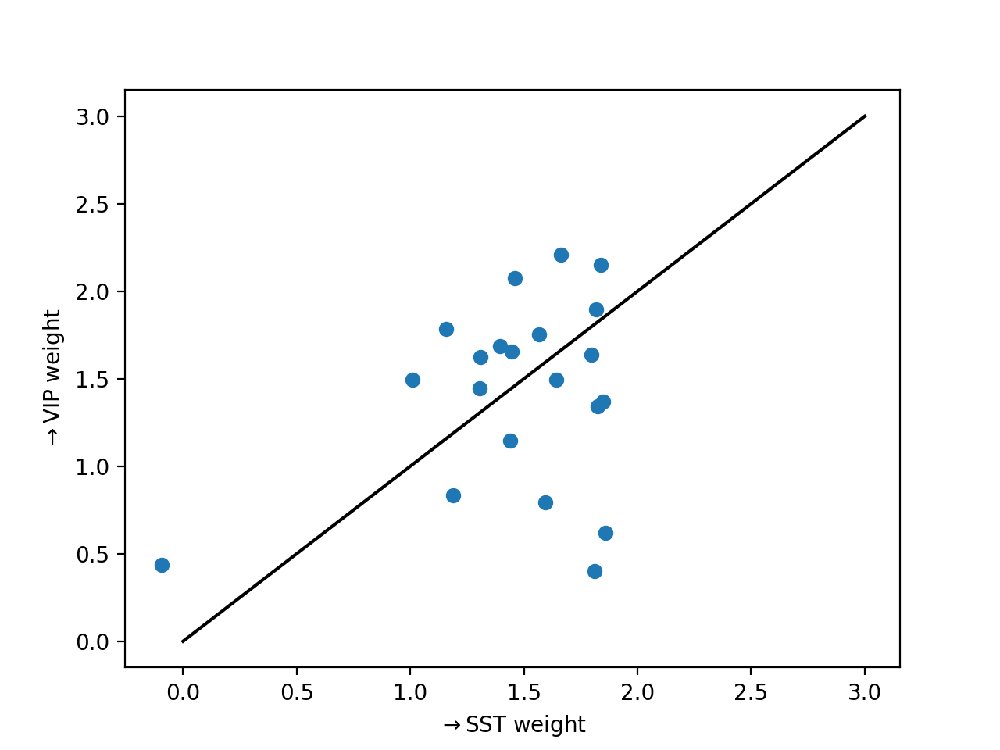

Text(0, 0.5, '$\\rightarrow$VIP weight')

In [661]:
plt.figure()
ifrom1,ifrom2 = 0,3
itype1,itype2 = 1,2
xdata = (Wmys[ifit][low_loss[ifit]][:,ifrom1,itype1]+Wmys[ifit][low_loss[ifit]][:,ifrom2,itype1])*(1+Ks[ifit][low_loss[ifit]][:,itype1])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype1],1),1)
ydata = (Wmys[ifit][low_loss[ifit]][:,ifrom1,itype2]+Wmys[ifit][low_loss[ifit]][:,ifrom2,itype2])*(1+Ks[ifit][low_loss[ifit]][:,itype2])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype2],1),1)
# plt.scatter(Wmys[ifit][low_loss[ifit]][:,0,itype1],Wmys[ifit][low_loss[ifit]][:,0,itype2])
plt.scatter(xdata,ydata)
plt.plot((0,3),(0,3),c='k')
plt.xlabel(r'$\rightarrow$SST weight')
plt.ylabel(r'$\rightarrow$VIP weight')

<IPython.core.display.Javascript object>


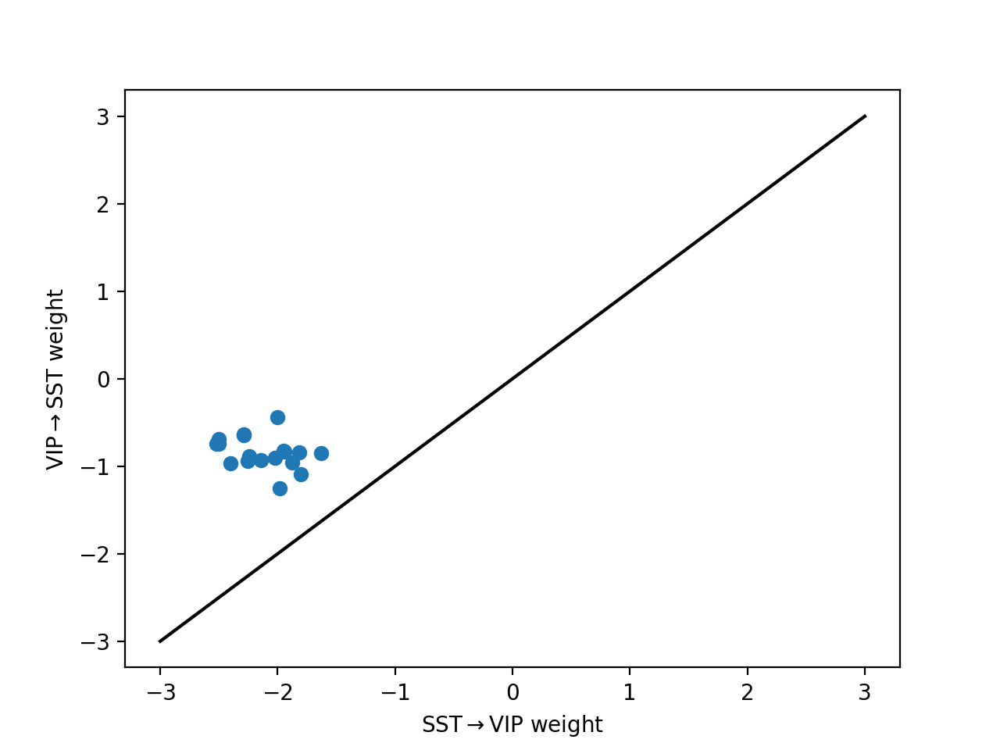

Text(0, 0.5, 'VIP$\\rightarrow$SST weight')

In [925]:
plt.figure()
xdata = Wmys[ifit][low_loss[ifit]][:,1,2]#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype1],1),1)
ydata = Wmys[ifit][low_loss[ifit]][:,2,1]#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype2],1),1)
# plt.scatter(Wmys[ifit][low_loss[ifit]][:,0,itype1],Wmys[ifit][low_loss[ifit]][:,0,itype2])
plt.scatter(xdata,ydata)
plt.plot((-3,3),(-3,3),c='k')
plt.xlabel(r'SST$\rightarrow$VIP weight')
plt.ylabel(r'VIP$\rightarrow$SST weight')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


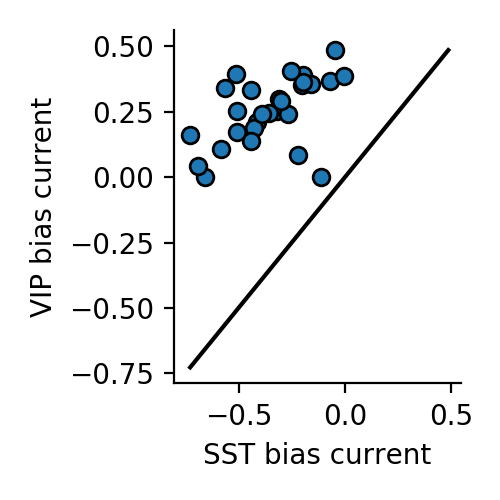

In [1007]:
plt.figure(figsize=(2.5,2.5))
xdata = Wmxs[ifit][low_loss[ifit]][:,1,1]#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype1],1),1)
ydata = Wmxs[ifit][low_loss[ifit]][:,1,2]#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype2],1),1)
# plt.scatter(Wmys[ifit][low_loss[ifit]][:,0,itype1],Wmys[ifit][low_loss[ifit]][:,0,itype2])
plt.scatter(xdata,ydata,edgecolors='k',linewidths=1)
mn = np.minimum(xdata.min(),ydata.min())#-0.1
mx = np.maximum(xdata.max(),ydata.max())#+0.1
plt.plot((mn,mx),(mn,mx),c='k')
plt.xlabel('SST bias current')
plt.ylabel('VIP bias current')
ut.erase_top_right()
plt.tight_layout()
plt.savefig('figures/sst_vip_bias_scatter.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


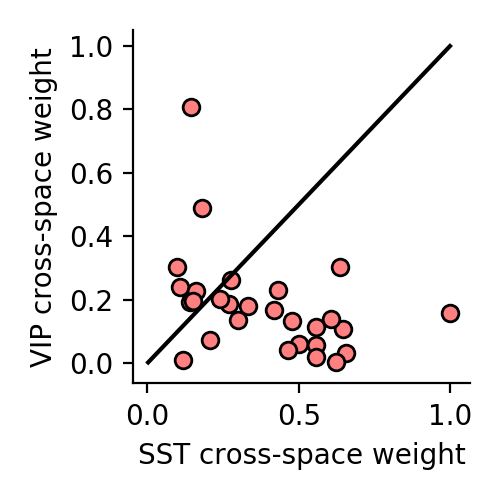

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


In [1008]:
plt.figure(figsize=(2.5,2.5))
xdata = Ks[ifit][low_loss[ifit]][:,1]#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype1],1),1)
ydata = Ks[ifit][low_loss[ifit]][:,2]#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype2],1),1)
# plt.scatter(Wmys[ifit][low_loss[ifit]][:,0,itype1],Wmys[ifit][low_loss[ifit]][:,0,itype2])
plt.scatter(xdata,ydata,c=[1,0.5,0.5],edgecolors='k',linewidths=1)
mn = np.minimum(xdata.min(),ydata.min())#-0.1
mx = np.maximum(xdata.max(),ydata.max())#+0.1
plt.plot((mn,mx),(mn,mx),c='k')
plt.xlabel('SST cross-space weight')
plt.ylabel('VIP cross-space weight')
ut.erase_top_right()
plt.tight_layout()
plt.savefig('figures/sst_vip_cross_space_scatter.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


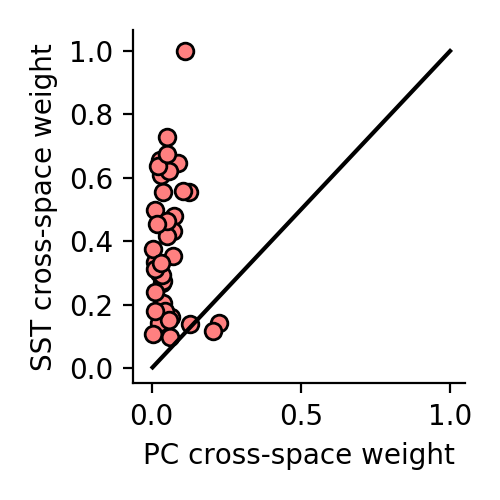

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


In [1081]:
plt.figure(figsize=(2.5,2.5))
xdata = Ks[ifit][low_loss[ifit]][:,0]#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype1],1),1)
ydata = Ks[ifit][low_loss[ifit]][:,1]#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype2],1),1)
# plt.scatter(Wmys[ifit][low_loss[ifit]][:,0,itype1],Wmys[ifit][low_loss[ifit]][:,0,itype2])
plt.scatter(xdata,ydata,c=[1,0.5,0.5],edgecolors='k',linewidths=1)
mn = np.minimum(xdata.min(),ydata.min())#-0.1
mx = np.maximum(xdata.max(),ydata.max())#+0.1
plt.plot((mn,mx),(mn,mx),c='k')
plt.xlabel('PC cross-space weight')
plt.ylabel('SST cross-space weight')
ut.erase_top_right()
plt.tight_layout()
plt.savefig('figures/pc_sst_cross_space_scatter.eps')


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


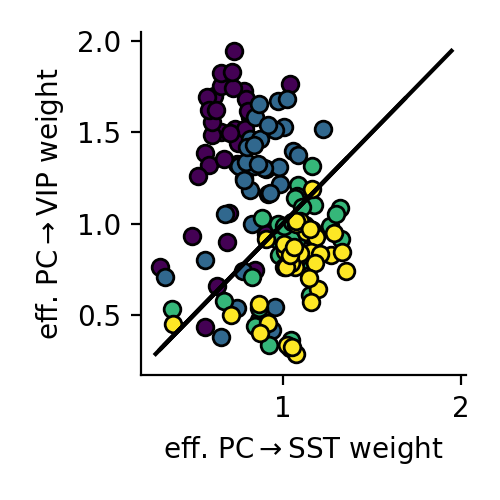

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

In [60]:
plt.figure(figsize=(2.5,2.5))
isizes = [2,3,4,5]
icontrasts = [2,3,4,5]
nconds = len(isizes)
for isize,icontrast,c in zip(isizes,icontrasts,plt.cm.viridis(np.linspace(0,1,nconds))):
    xdata = mono_couplings[ifit][low_loss[ifit]][:,isize,icontrast,0,1]
    ydata = mono_couplings[ifit][low_loss[ifit]][:,isize,icontrast,0,2]
    plt.scatter(xdata,ydata,c=c,edgecolors='k',linewidths=1)
    mn = np.minimum(xdata.min(),ydata.min())#-0.1
    mx = np.maximum(xdata.max(),ydata.max())#+0.1
    plt.plot((mn,mx),(mn,mx),c='k')
    plt.xlabel(r'eff. PC$\rightarrow$SST weight')
    plt.ylabel(r'eff. PC$\rightarrow$VIP weight')
    ut.erase_top_right()
    plt.tight_layout()
# plt.savefig('figures/pc_sst_vip_eff_wt_scatter.eps')


In [681]:
mono_couplings[ifit].shape

(956, 6, 6, 8, 8)

In [664]:
phis[ifit][low_loss[ifit]][:,:,:,0].mean(),phis[ifit][low_loss[ifit]][:,:,:,3].mean()

(0.611219670499231, 0.566810770874022)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


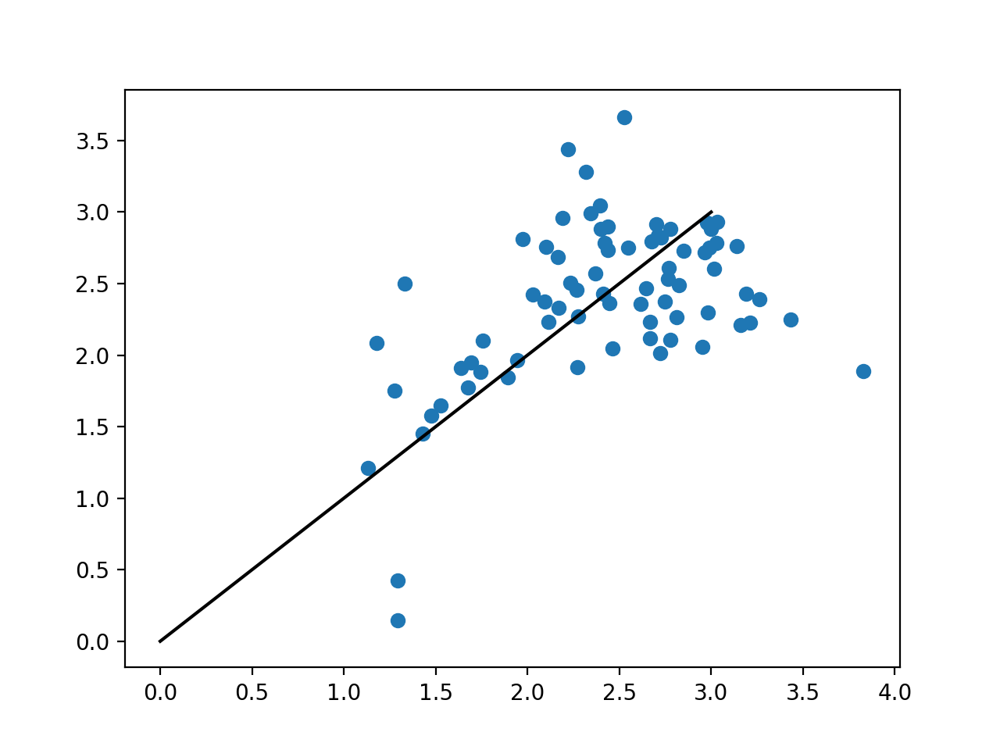

In [983]:
plt.figure()
itype1,itype2 = 1,2
xdata = Wmys[ifit][low_loss[ifit]][:,0,itype1]*(1+Ks[ifit][low_loss[ifit]][:,itype1])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype1],1),1)
ydata = Wmys[ifit][low_loss[ifit]][:,0,itype2]*(1+Ks[ifit][low_loss[ifit]][:,itype2])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype2],1),1)
# plt.scatter(Wmys[ifit][low_loss[ifit]][:,0,itype1],Wmys[ifit][low_loss[ifit]][:,0,itype2])
plt.scatter(xdata,ydata)
plt.plot((0,3),(0,3),c='k')

In [564]:
low_loss[ifit].sum()

5

In [544]:
phis[ifit].shape

(189, 6, 6, 8)

In [277]:
[np.all(a==b) for a,b in zip(wt_dicts[0].values(),wt_dicts[1].values())]

[True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True]

In [61]:
Wpcpc = np.zeros((len(weights_files),nsize,ncontrast))
YYs = np.zeros((len(weights_files),nsize,ncontrast,nQ*nS*nT))
YY1s = np.zeros((len(weights_files),nsize,ncontrast,nQ*nS*nT))
YY2s = np.zeros((len(weights_files),nsize,ncontrast,nQ*nS*nT))
h1s = np.zeros((len(weights_files),))
h2s = np.zeros((len(weights_files),))
bls = np.zeros((len(weights_files),nQ))
amps = np.zeros((len(weights_files),nQ*nS*nT))
for iwt in range(len(weights_files)):
    Wstar_dict = np.load(weights_files[iwt],allow_pickle=True)[()]
    try:
        Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl = Wstar_dict['as_list']
        amp = np.ones((nQ*nS*nT,))
    except:
        Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl,amp = Wstar_dict['as_list']    
    YYs[iwt] = amp*compute_f_(Eta,Xi,s02).reshape((nsize,ncontrast,-1)) + np.tile(bl,nS*nT)[np.newaxis]
    
    YY12,_ = calnet.utils.compute_f_fprime_t_avg(Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1=h1,h2=h2,perturbation=0,opto=True)
    YY1s[iwt] = amp*YY12[:nN].reshape((nsize,ncontrast,nQ*nS*nT)) + np.tile(bl,nS*nT)[np.newaxis]
    YY2s[iwt] = amp*YY12[nN:].reshape((nsize,ncontrast,nQ*nS*nT)) + np.tile(bl,nS*nT)[np.newaxis]
    
    h1s[iwt] = h1
    h2s[iwt] = h2
    bls[iwt] = bl
    amps[iwt] = amp

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


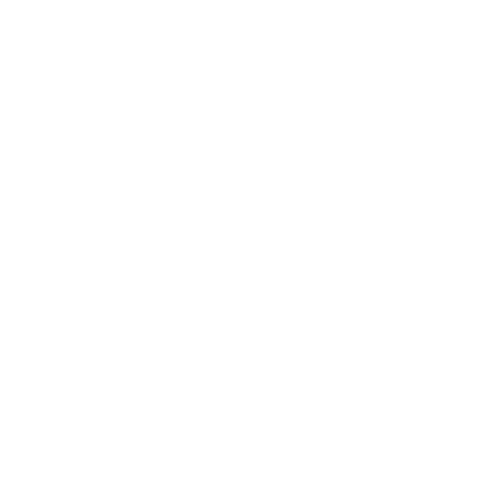

TypeError: '<' not supported between instances of 'list' and 'float'

In [62]:
plt.figure(figsize=(2.5,2.5))
plt.hist(losses[losses<1e2],bins=20)
ut.erase_top_right()
plt.xlabel('loss')
plt.ylabel('# of model fits')
plt.tight_layout()
# plt.savefig('figures/model_fits_random_inits_simulate2_true.eps')

In [1129]:
lkat = losses < np.nanpercentile(losses,10)
#(losses < np.percentile(losses,20))#(losses < 100) #& (np.max(np.abs(couplings.reshape((couplings.shape[0],-1))),axis=1) < 10)


<IPython.core.display.Javascript object>


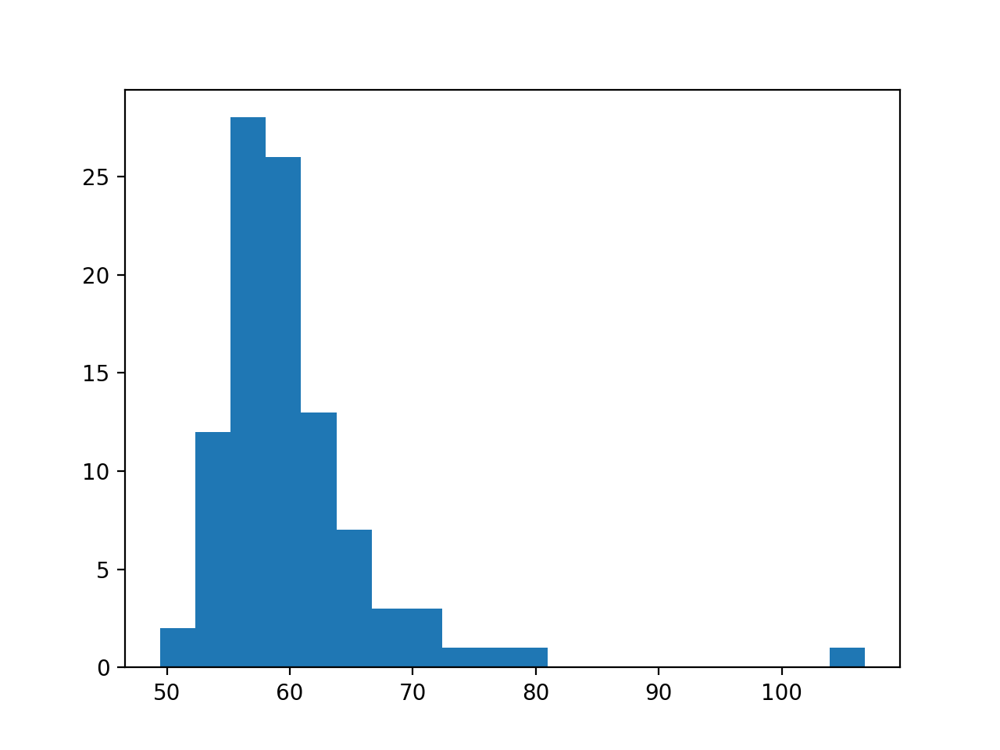

(array([ 2., 12., 28., 26., 13.,  7.,  3.,  3.,  1.,  1.,  1.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  1.]),
 array([ 49.46475863,  52.32919395,  55.19362927,  58.05806459,
         60.92249991,  63.78693523,  66.65137055,  69.51580587,
         72.38024119,  75.24467651,  78.10911183,  80.97354715,
         83.83798247,  86.70241779,  89.56685311,  92.43128843,
         95.29572375,  98.16015907, 101.02459439, 103.88902971,
        106.75346503]),
 <a list of 20 Patch objects>)

In [254]:
plt.figure()
plt.hist(losses[lkat],bins=20)

<IPython.core.display.Javascript object>


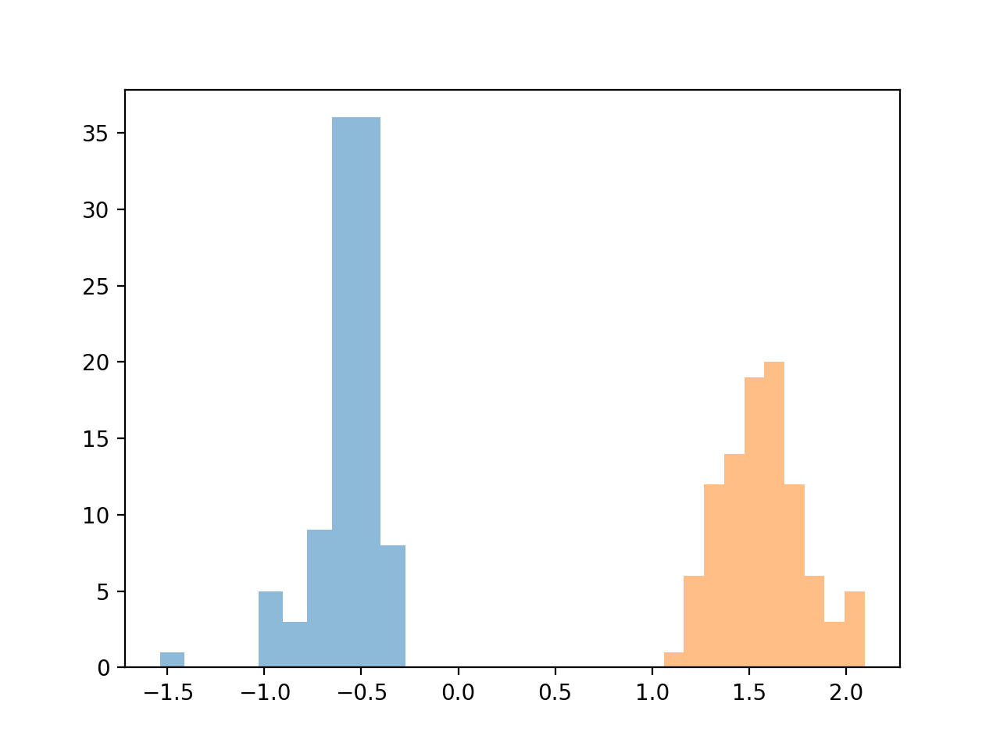

(array([ 1.,  6., 12., 14., 19., 20., 12.,  6.,  3.,  5.]),
 array([1.06037018, 1.16407632, 1.26778246, 1.37148861, 1.47519475,
        1.57890089, 1.68260703, 1.78631317, 1.89001932, 1.99372546,
        2.0974316 ]),
 <a list of 10 Patch objects>)

In [223]:
plt.figure()
plt.hist(h1s[lkat],alpha=0.5)
plt.hist(h2s[lkat],alpha=0.5)

<IPython.core.display.Javascript object>


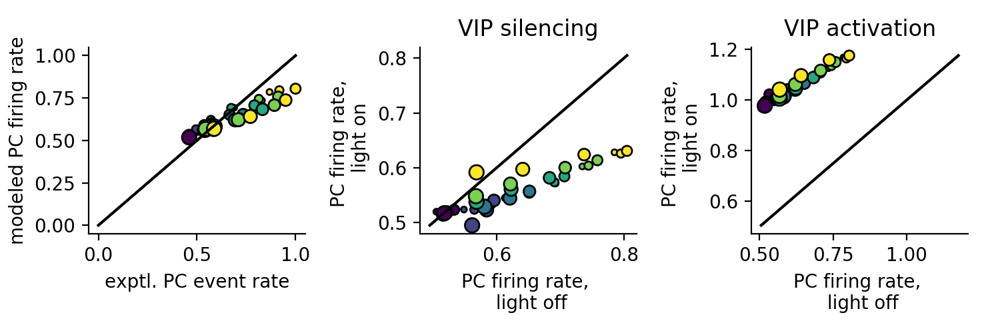

<IPython.core.display.Javascript object>


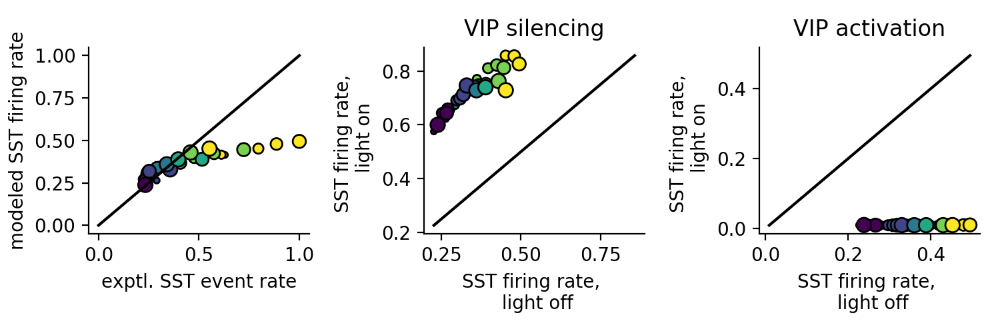

<IPython.core.display.Javascript object>


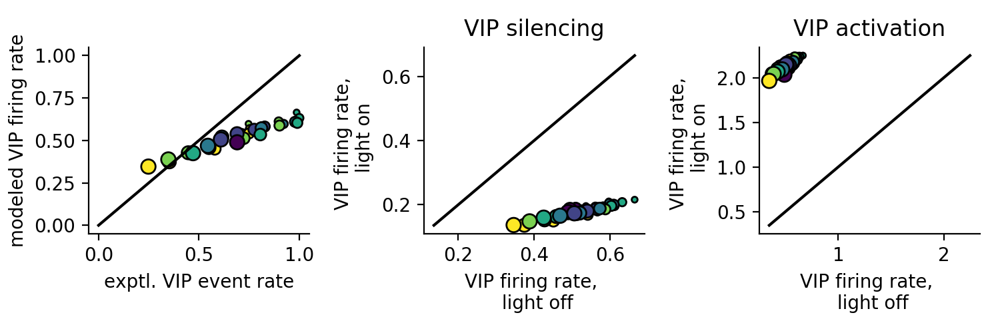

<IPython.core.display.Javascript object>


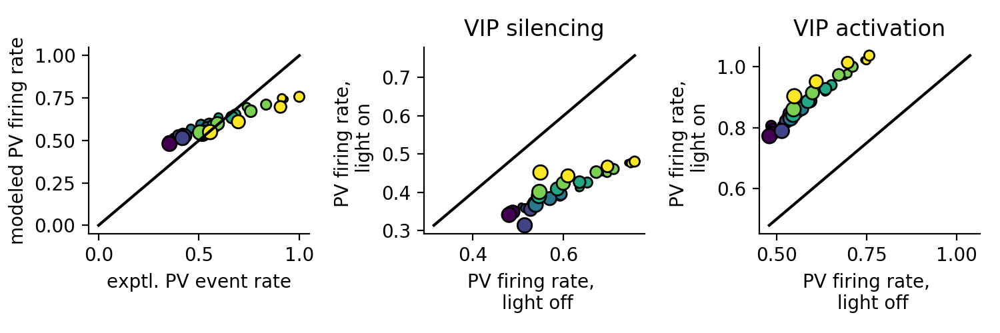

In [255]:
# lbls = ['PC','SST','VIP','PV']
# for itype in np.arange(4):
#     plt.figure(figsize=(5,2.5))
#     titles = ['VIP silencing','VIP activation']
#     for iyy,yy in enumerate([YY1s,YY2s]):
#         plt.subplot(1,2,iyy+1)
#         sca.scatter_size_contrast_errorbar(YYs[lkat,:,:,itype],yy[lkat,:,:,itype])#,mn=0)
#         plt.title(titles[iyy])
#         plt.xlabel('%s event rate, \n light off'%lbls[itype])
#         plt.ylabel('%s event rate, \n light on'%lbls[itype])
#         ut.erase_top_right()
#     plt.tight_layout()
#     plt.savefig('figures/bidi_nonlinear_%s_scatter_size_contrast.eps'%lbls[itype])
mxs = [1,1.5,2,1]
lbls = ['PC','SST','VIP','PV']
for itype in np.arange(4):
    plt.figure(figsize=(7.5,2.5))
    titles = ['VIP silencing','VIP activation']
    plt.subplot(1,3,1)
    sca.scatter_size_contrast_errorbar(YYhat.reshape((nsize,ncontrast,-1))[np.newaxis,:,:,itype],YYs[lkat,:,:,itype],mn=0)
#     plt.title(titles[iyy])
    plt.xlabel('exptl. %s event rate'%lbls[itype])
    plt.ylabel('modeled %s firing rate'%lbls[itype])
    ut.erase_top_right()
    for iyy,yy in enumerate([YY1s,YY2s]):
        plt.subplot(1,3,iyy+2)
        sca.scatter_size_contrast_errorbar(YYs[lkat,:,:,itype],yy[lkat,:,:,itype])#,mn=0,mx=mxs[itype])
        plt.title(titles[iyy])
        plt.xlabel('%s firing rate, \n light off'%lbls[itype])
        plt.ylabel('%s firing rate, \n light on'%lbls[itype])
        ut.erase_top_right()
    plt.tight_layout()
#     plt.savefig('figures/bidi_nonlinear_%s_scatter_size_contrast.eps'%lbls[itype])


<IPython.core.display.Javascript object>


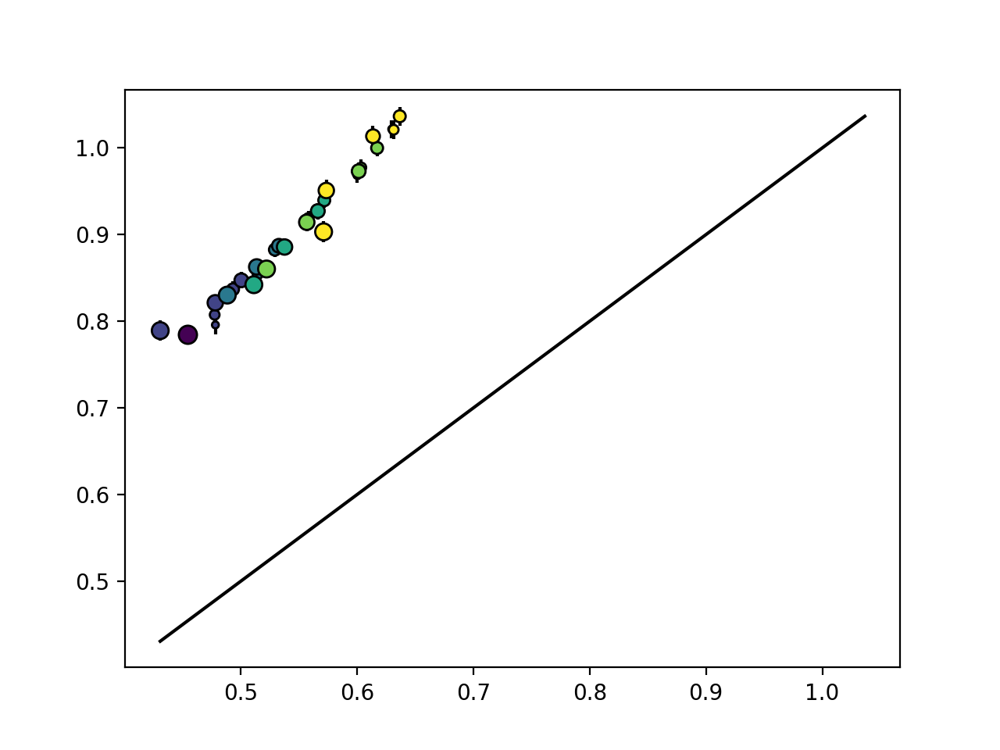

In [251]:
plt.figure()
sca.scatter_size_contrast_errorbar(YYs[lkat,:,:,itype],YY2s[lkat,:,:,itype],equate_0=True)

<IPython.core.display.Javascript object>


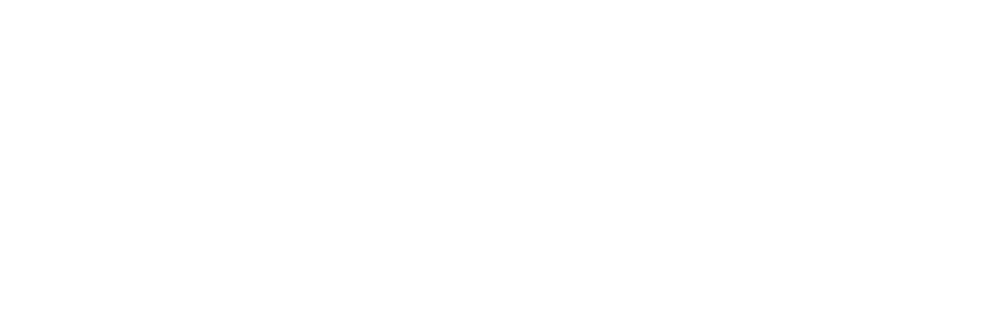

<IPython.core.display.Javascript object>


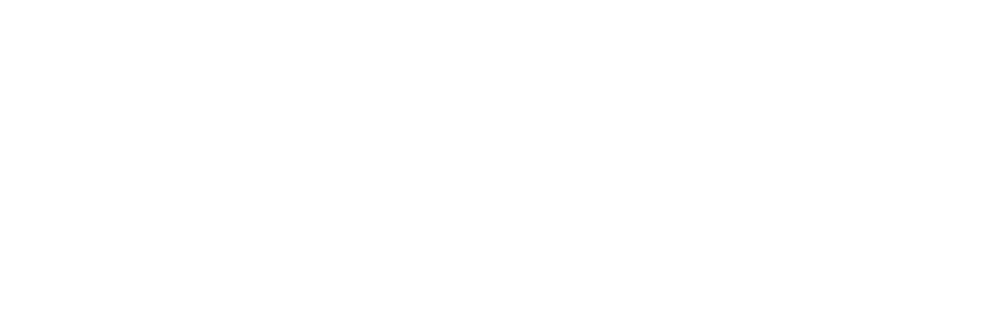

<IPython.core.display.Javascript object>


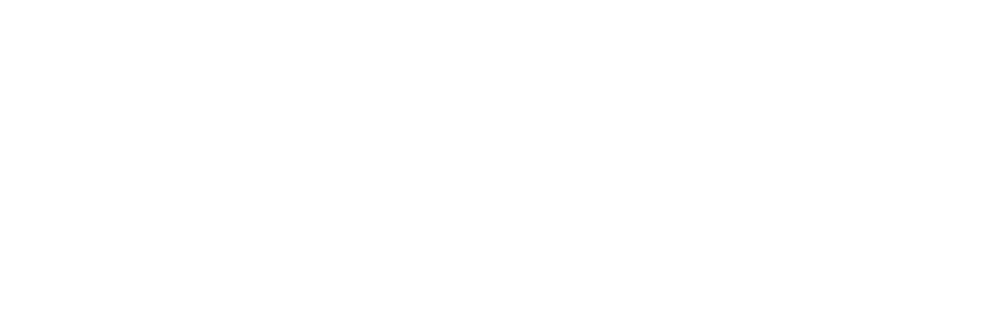

<IPython.core.display.Javascript object>


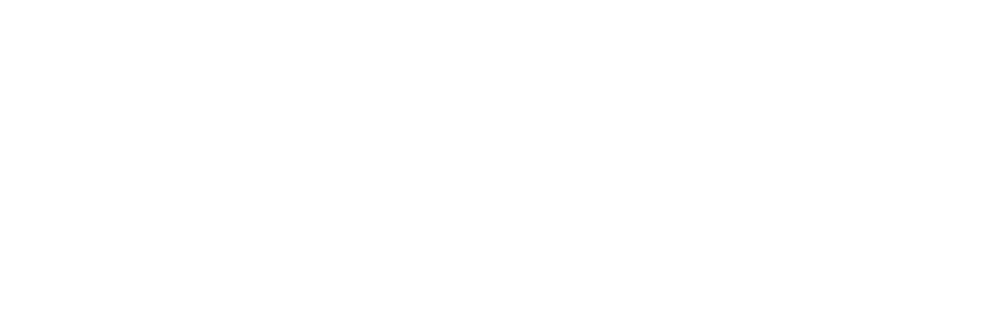

<IPython.core.display.Javascript object>


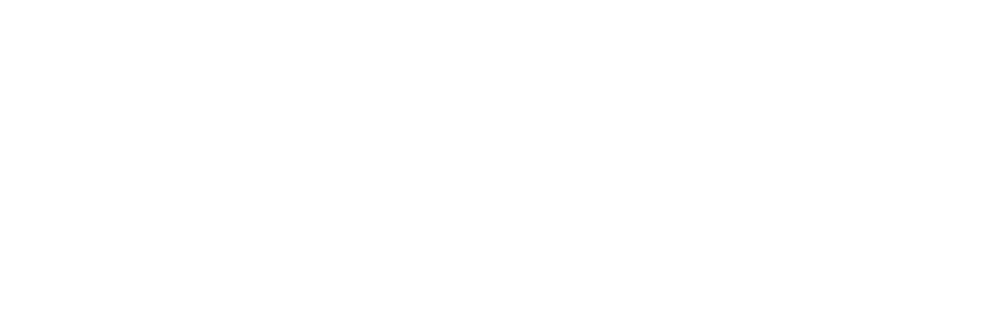

<IPython.core.display.Javascript object>


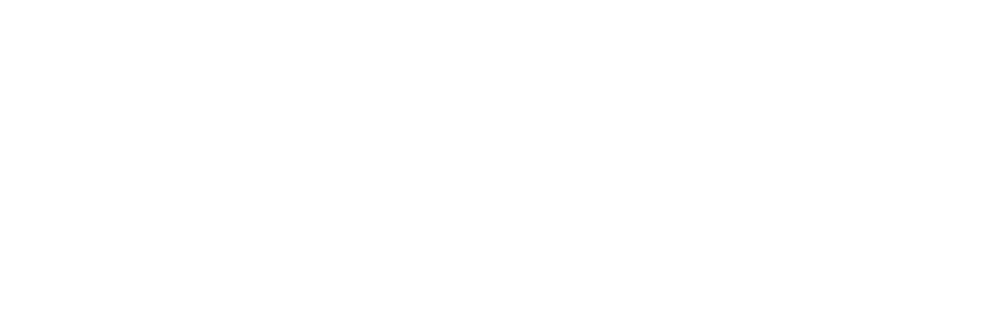

<IPython.core.display.Javascript object>


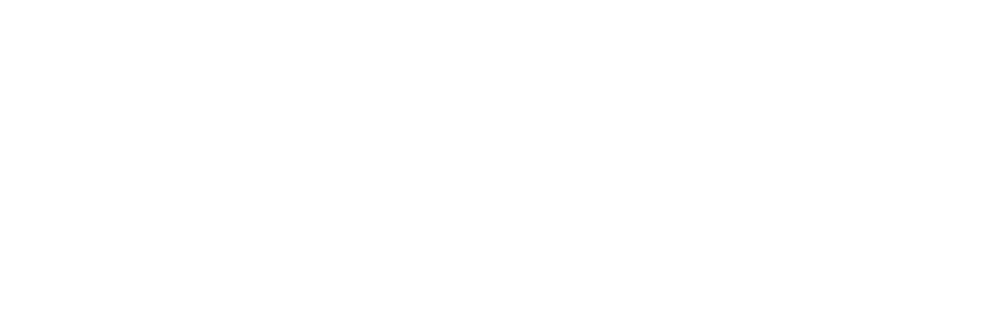

<IPython.core.display.Javascript object>


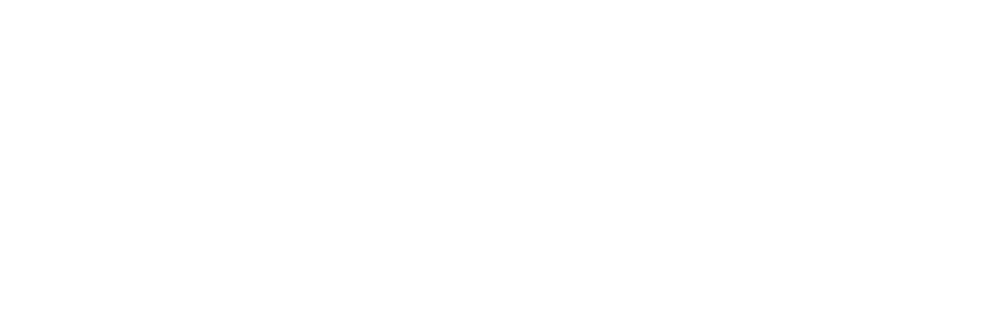

<IPython.core.display.Javascript object>


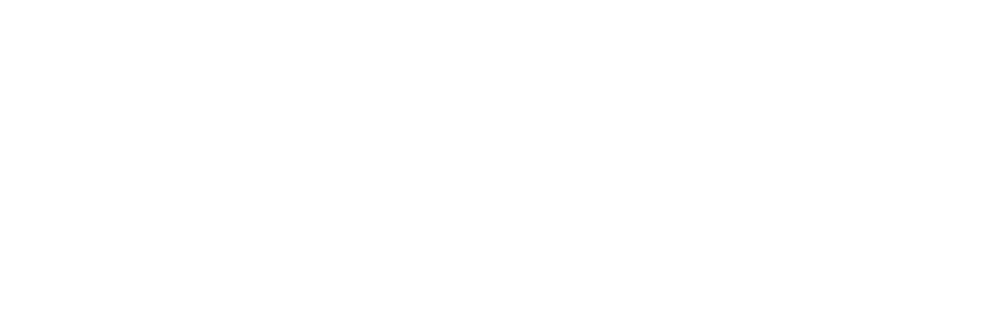

<IPython.core.display.Javascript object>


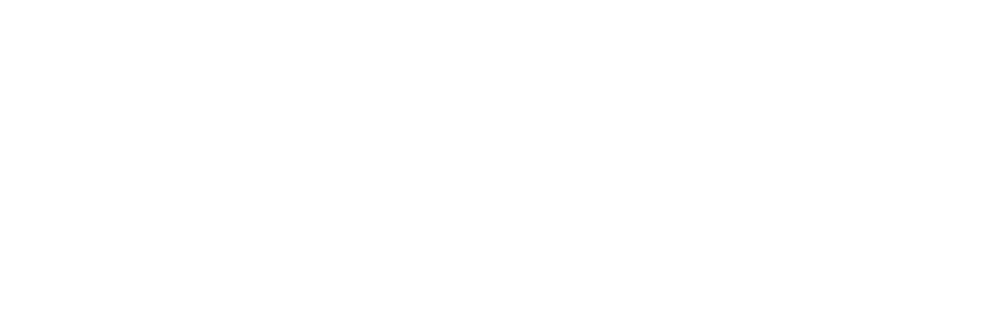

KeyboardInterrupt: 

In [239]:
mxs = [1,1.5,2,1]
lbls = ['PC','SST','VIP','PV']
ut.mkdir('figures/%s/'%fit_lbl)
for itype in np.arange(4):
    for iiwt in range(lkat.sum()):
        iwt = np.argsort(losses[lkat])[iiwt]
        plt.figure(figsize=(7.5,2.5))
        titles = ['VIP silencing','VIP activation']
        plt.subplot(1,3,1)
        sca.scatter_size_contrast_errorbar(YYhat.reshape((nsize,ncontrast,-1))[np.newaxis,:,:,itype],YYs[lkat][iwt:iwt+1,:,:,itype],mn=0)
    #     plt.title(titles[iyy])
        plt.xlabel('exptl. %s event rate'%lbls[itype])
        plt.ylabel('modeled %s firing rate'%lbls[itype])
        plt.title('%s, loss = %.2f'%(np.array(weights_filenames)[lkat][iwt],losses[lkat][iwt]))
        ut.erase_top_right()
        for iyy,yy in enumerate([YY1s,YY2s]):
            plt.subplot(1,3,iyy+2)
            sca.scatter_size_contrast_errorbar(YYs[lkat][iwt:iwt+1,:,:,itype],yy[lkat][iwt:iwt+1,:,:,itype],equate_0=True)#,mn=0,mx=2)#,mn=0,mx=mxs[itype])
            plt.title(titles[iyy])
            plt.xlabel('%s firing rate, \n light off'%lbls[itype])
            plt.ylabel('%s firing rate, \n light on'%lbls[itype])
            ut.erase_top_right()
        plt.tight_layout()
        plt.savefig('figures/%s/%s_scatter_size_contrast_%d.eps'%(fit_lbl,lbls[itype],iiwt))
        plt.close('all')

In [240]:
dYY = np.load('/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/dYY.npy')

<IPython.core.display.Javascript object>


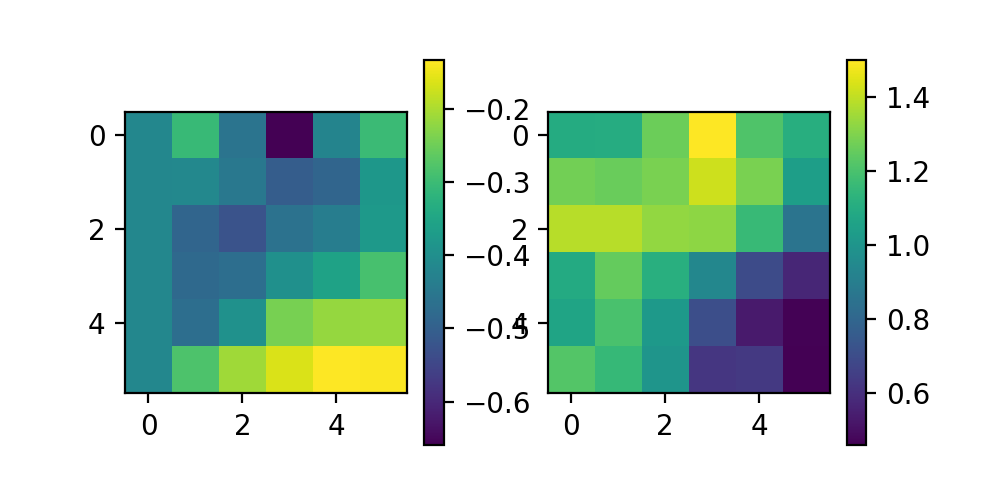

In [256]:
itype = 2
plt.figure(figsize=(5,2.5))
plt.subplot(1,2,1)
plt.imshow(dYY[:36,itype].reshape((6,6)))
plt.colorbar()
plt.subplot(1,2,2)
plt.imshow(dYY[36:72,itype].reshape((6,6)))
plt.colorbar()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


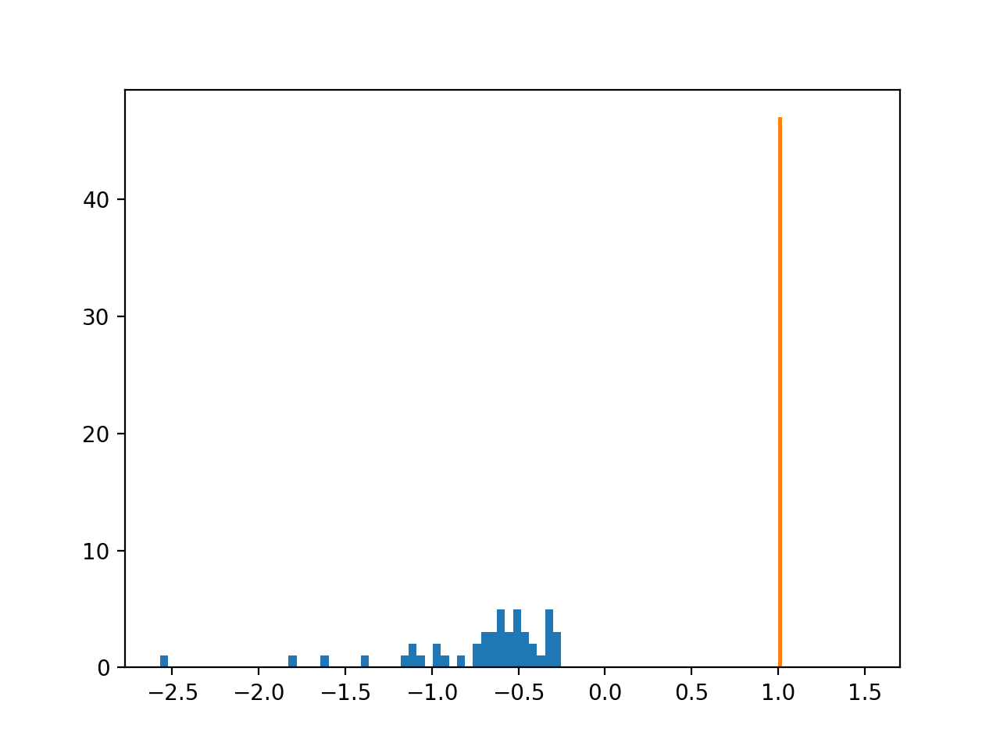

(array([ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0., 47.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]),
 array([0.5 , 0.52, 0.54, 0.56, 0.58, 0.6 , 0.62, 0.64, 0.66, 0.68, 0.7 ,
        0.72, 0.74, 0.76, 0.78, 0.8 , 0.82, 0.84, 0.86, 0.88, 0.9 , 0.92,
        0.94, 0.96, 0.98, 1.  , 1.02, 1.04, 1.06, 1.08, 1.1 , 1.12, 1.14,
        1.16, 1.18, 1.2 , 1.22, 1.24, 1.26, 1.28, 1.3 , 1.32, 1.34, 1.36,
        1.38, 1.4 , 1.42, 1.44, 1.46, 1.48, 1.5 ]),
 <a list of 50 Patch objects>)

In [265]:
plt.figure()
plt.hist(h1s,bins=50)
plt.hist(h2s,bins=50)

<IPython.core.display.Javascript object>


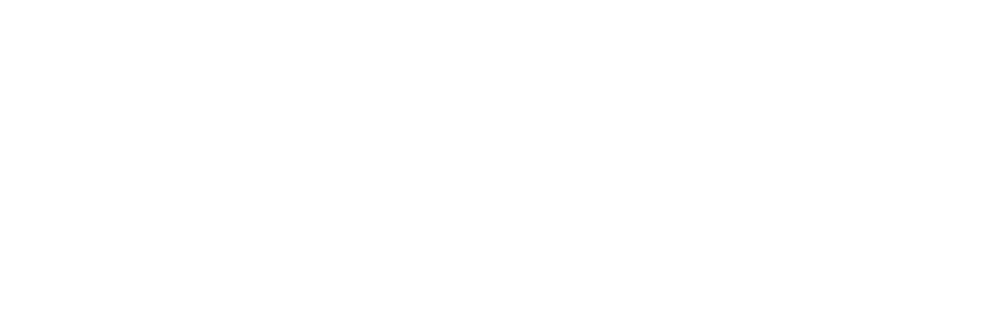

In [260]:
h = -1
sizes = [0,2,3,5]
xlim = None#(-0.2,0.2)
ylim = None#(-1.2,0.05)

plt.figure(figsize=(7.5,2.5))
plt.subplot(1,3,1)
plt.title('baseline')
# sca.scatter_size_contrast(h*np.nanmean(couplings[:,:,:,2,1],0),h*np.nanmean(couplings[:,:,:,2,0],0))
xdata = h*couplings[lkat,:,:,2,1]
ydata = h*couplings[lkat,:,:,2,0]
sca.scatter_size_contrast_errorbar(xdata[:,sizes],ydata[:,sizes],equality_line=False,square=False)
plt.axhline(0,c=(0.5,0.5,0.5))
plt.axvline(0,c=(0.5,0.5,0.5))
plt.xlabel(r'$\Delta$ SST firing rate')
plt.ylabel(r'$\Delta$ PC firing rate')
plt.xlim(xlim)
plt.ylim(ylim)
plt.tight_layout()
# plt.savefig('figures/sim_drsst_drpc_recurrent.eps')

plt.subplot(1,3,2)
plt.title(r'$\varphi_{PC}$,$\varphi_{PV}$ fixed')
# sca.scatter_size_contrast(h*np.nanmean(couplings[:,:,:,2,1],0),h*np.nanmean(couplings[:,:,:,2,0],0))
xdata = h*couplings_pcpv_fixed[lkat,:,:,2,1]
ydata = h*couplings_pcpv_fixed[lkat,:,:,2,0]
sca.scatter_size_contrast_errorbar(xdata[:,sizes],ydata[:,sizes],equality_line=False,square=False)
plt.axhline(0,c=(0.5,0.5,0.5))
plt.axvline(0,c=(0.5,0.5,0.5))
plt.xlabel(r'$\Delta$ SST firing rate')
plt.ylabel(r'$\Delta$ PC firing rate')
# plt.ylim(-3,1)
# plt.xlim(-1,3)
plt.xlim(xlim)
plt.ylim(ylim)
plt.tight_layout()
# plt.savefig('figures/sim_drsst_drpc_recurrent.eps')

plt.subplot(1,3,3)
# sca.scatter_size_contrast(h*np.nanmean(couplings[:,:,:,2,1],0),h*np.nanmean(couplings[:,:,:,2,0],0))
xdata = h*couplings_fixed[lkat,:,:,2,1,1]
ydata = h*couplings_fixed[lkat,:,:,2,0,1]
sca.scatter_size_contrast_errorbar(xdata[:,sizes],ydata[:,sizes],equality_line=False,square=False)
plt.axhline(0,c=(0.5,0.5,0.5))
plt.axvline(0,c=(0.5,0.5,0.5))
plt.xlabel(r'$\Delta$ SST firing rate')
plt.ylabel(r'$\Delta$ PC firing rate')
# plt.ylim(-3,1)
# plt.xlim(-1,3)
plt.title(r'$\varphi_{SST}$ fixed')
plt.xlim(xlim)
plt.ylim(ylim)
plt.tight_layout()


In [261]:
# h = -1
# sizes = [0,2,3,5]
# xlim = None#(-0.2,0.2)
# ylim = None#(-1.2,0.05)

# for ifit in range(lkat.sum()):
#     plt.figure(figsize=(7.5,2.5))
#     plt.subplot(1,3,1)
#     plt.title('losses = %.1f \n baseline'%losses[lkat][ifit])
#     # sca.scatter_size_contrast(h*np.nanmean(couplings[:,:,:,2,1],0),h*np.nanmean(couplings[:,:,:,2,0],0))
#     xdata = h*couplings[lkat,:,:,2,1][ifit:ifit+1]
#     ydata = h*couplings[lkat,:,:,2,0][ifit:ifit+1]
#     sca.scatter_size_contrast_errorbar(xdata[:,sizes],ydata[:,sizes],equality_line=False,square=False)
#     plt.axhline(0,c=(0.5,0.5,0.5))
#     plt.axvline(0,c=(0.5,0.5,0.5))
#     plt.xlabel(r'$\Delta$ SST firing rate')
#     plt.ylabel(r'$\Delta$ PC firing rate')
#     plt.xlim(xlim)
#     plt.ylim(ylim)
#     plt.tight_layout()
#     # plt.savefig('figures/sim_drsst_drpc_recurrent.eps')

#     plt.subplot(1,3,2)
#     plt.title(r'$\varphi_{PC}$,$\varphi_{PV}$ fixed')
#     # sca.scatter_size_contrast(h*np.nanmean(couplings[:,:,:,2,1],0),h*np.nanmean(couplings[:,:,:,2,0],0))
#     xdata = h*couplings_pcpv_fixed[lkat,:,:,2,1][ifit:ifit+1]
#     ydata = h*couplings_pcpv_fixed[lkat,:,:,2,0][ifit:ifit+1]
#     sca.scatter_size_contrast_errorbar(xdata[:,sizes],ydata[:,sizes],equality_line=False,square=False)
#     plt.axhline(0,c=(0.5,0.5,0.5))
#     plt.axvline(0,c=(0.5,0.5,0.5))
#     plt.xlabel(r'$\Delta$ SST firing rate')
#     plt.ylabel(r'$\Delta$ PC firing rate')
#     # plt.ylim(-3,1)
#     # plt.xlim(-1,3)
#     plt.xlim(xlim)
#     plt.ylim(ylim)
#     plt.tight_layout()
#     # plt.savefig('figures/sim_drsst_drpc_recurrent.eps')

#     plt.subplot(1,3,3)
#     # sca.scatter_size_contrast(h*np.nanmean(couplings[:,:,:,2,1],0),h*np.nanmean(couplings[:,:,:,2,0],0))
#     xdata = h*couplings_fixed[lkat,:,:,2,1,1][ifit:ifit+1]
#     ydata = h*couplings_fixed[lkat,:,:,2,0,1][ifit:ifit+1]
#     sca.scatter_size_contrast_errorbar(xdata[:,sizes],ydata[:,sizes],equality_line=False,square=False)
#     plt.axhline(0,c=(0.5,0.5,0.5))
#     plt.axvline(0,c=(0.5,0.5,0.5))
#     plt.xlabel(r'$\Delta$ SST firing rate')
#     plt.ylabel(r'$\Delta$ PC firing rate')
#     # plt.ylim(-3,1)
#     # plt.xlim(-1,3)
#     plt.title(r'$\varphi_{SST}$ fixed')
#     plt.xlim(xlim)
#     plt.ylim(ylim)
#     plt.tight_layout()


In [262]:
plt.close('all')


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # This is added back by InteractiveShellApp.init_path()


<IPython.core.display.Javascript object>


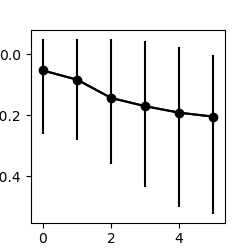

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


IndexError: boolean index did not match indexed array along dimension 0; dimension is 283 but corresponding boolean dimension is 443

In [183]:
isize = 3
ifit = -1

# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings_fixed[:,isize,:,8,0,1].max()
# lkat = np.ones_like(lkat)
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings[:,isize,:,8,0].max()
# lkat = slice(None)

plot_fn = ut.plot_pct_errorbars_hillel

plt.figure(figsize=(2.5,2.5))
# plt.plot(ucontrast,couplings[lkat,3,:,8,0].T,c='k',alpha=0.1)
plot_fn(np.arange(6),couplings[ifit][low_loss[ifit],isize,np.newaxis,:,4,0],pct=(16,84),colors=np.array((0,0,0))[np.newaxis])
# plt.plot(ucontrast,couplings_fixed[lkat,isize,:,8,0,1].T,c=np.array((1,0.65,0)),alpha=0.1)
plot_fn(np.arange(6)+0.1,couplings_fixed[low_loss[ifit],isize,np.newaxis,:,4,0,1],pct=(16,84),colors=np.array((1,0.825,0.5))[np.newaxis]) #np.array((0.7,0.7,0.7))
ut.plot_bootstrapped_errorbars_hillel(np.arange(6),couplings_pcpv_rec_fixed[low_loss[ifit],isize,np.newaxis,:,4,0],pct=(16,84),colors=np.array((0,0,1))[np.newaxis])
# ut.plot_bootstrapped_errorbars_hillel(np.arange(6),couplings_pcpv_fixed[lkat,isize,np.newaxis,:,8,0,1],pct=(16,84),colors=np.array((0.5,0.5,0.5))[np.newaxis])

plt.axhline(0,c='k',linestyle='dashed')
plt.xticks(np.arange(6),[0,6,12,25,50,100])
plt.title('%d$^o$ size'%usize[isize])
plt.xlabel('contrast (%)')
plt.ylabel('center PC response to \n surround PC stimulation')
ut.erase_top_right()
# plt.legend(['baseline','SST fixed'])
plt.tight_layout()
# plt.savefig('figures/far_pc_coupling_sst_fixed_no_opto.eps')

In [144]:
couplings_pc_rec_fixed.shape

(283, 6, 6, 8, 8)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


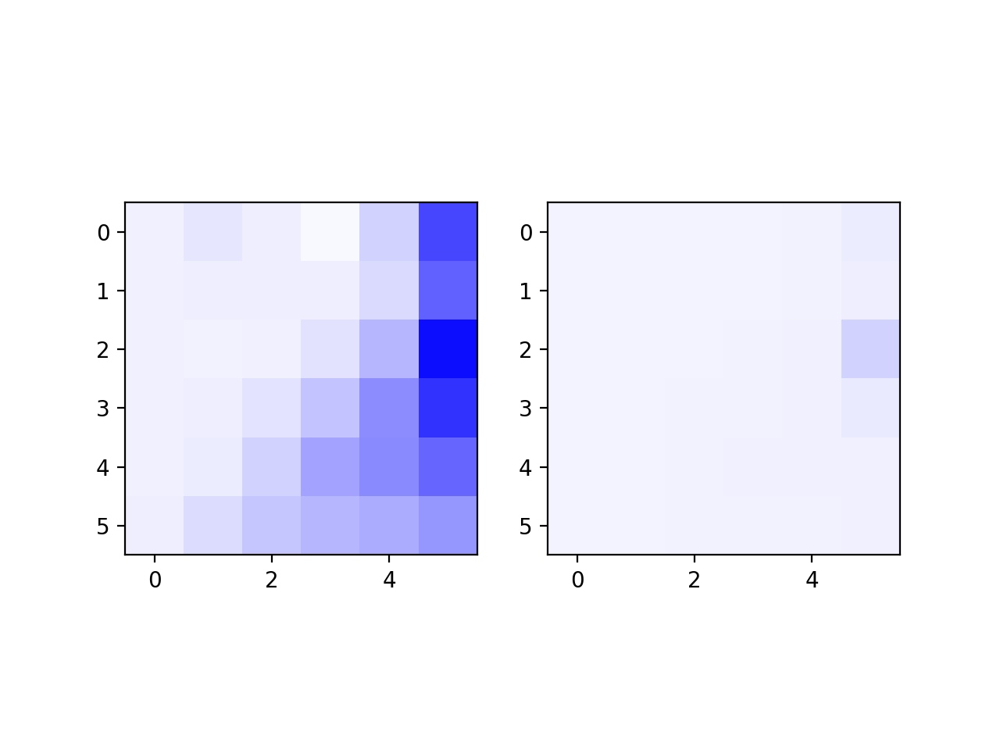

In [1115]:
plt.figure()
plt.subplot(1,2,1)
ut.imshow_hot_cold(np.nanmean(couplings_pcpv_rec_fixed[low_loss[ifit],:,:,4,0],0),mx=0.25)
plt.subplot(1,2,2)
ut.imshow_hot_cold(np.nanmean(couplings_pc_rec_fixed[low_loss[ifit],:,:,4,0],0),mx=0.25)
# plt.colorbar()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # Remove the CWD from sys.path while we load stuff.


<IPython.core.display.Javascript object>


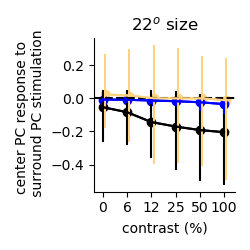

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


In [188]:
isize = 3

# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings_fixed[:,isize,:,8,0,1].max()
# lkat = np.ones_like(lkat)
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings[:,isize,:,8,0].max()
# lkat = slice(None)

plot_fn = ut.plot_pct_errorbars_hillel

plt.figure(figsize=(2.5,2.5))
# plt.plot(ucontrast,couplings[lkat,3,:,8,0].T,c='k',alpha=0.1)
# plt.plot(np.arange(6),couplings[ifit][low_loss[ifit],isize,:,4,0].T)
plot_fn(np.arange(6),couplings[ifit][low_loss[ifit],isize,np.newaxis,:,4,0],pct=(16,84),colors=np.array((0,0,0))[np.newaxis])
# plt.plot(ucontrast,couplings_fixed[lkat,isize,:,8,0,1].T,c=np.array((1,0.65,0)),alpha=0.1)
plot_fn(np.arange(6)+0.1,couplings_fixed[low_loss[ifit],isize,np.newaxis,:,4,0,1],pct=(16,84),colors=np.array((1,0.825,0.5))[np.newaxis]) #np.array((0.7,0.7,0.7))
plot_fn(np.arange(6),couplings_pcpv_rec_fixed[low_loss[ifit],isize,np.newaxis,:,4,0],pct=(16,84),colors=np.array((0,0,1))[np.newaxis])
# ut.plot_bootstrapped_errorbars_hillel(np.arange(6),couplings_pcpv_fixed[lkat,isize,np.newaxis,:,8,0,1],pct=(16,84),colors=np.array((0.5,0.5,0.5))[np.newaxis])

plt.axhline(0,c='k',linestyle='dashed')
plt.xticks(np.arange(6),[0,6,12,25,50,100])
plt.title('%d$^o$ size'%usize[isize])
plt.xlabel('contrast (%)')
plt.ylabel('center PC response to \n surround PC stimulation')
ut.erase_top_right()
# plt.legend(['baseline','SST fixed'])
plt.tight_layout()
# plt.savefig('figures/far_pc_coupling_sst_fixed_no_opto_no_wpcpv.eps')

In [165]:
np.nanpercentile(couplings[ifit][low_loss[ifit],isize,:,4,0],16,axis=0)

array([-0.21288159, -0.2718621 , -0.38150905, -0.41463456, -0.45238817,
       -0.48467975])

In [156]:
data1

array([-0.06999815, -0.00172024, -0.08497773, -0.24038796, -0.3645628 ,
       -0.16646559, -1.02564302])

In [157]:
data2

array([-0.02832851, -0.00180726, -0.00365547, -0.56238119, -0.13752006,
       -0.11172899, -1.14261378])

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


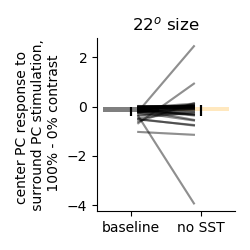

In [190]:
plt.figure(figsize=(2.5,2.5))
isize = 3
icontrast1,icontrast2 = 0,5
arr1 = couplings[ifit][low_loss[ifit],isize,:,4,0]
arr2 = couplings_fixed[low_loss[ifit],isize,:,4,0,1]
data1,data2 = [arr[:,icontrast2] - arr[:,icontrast1] for arr in [arr1,arr2]]
ut.plot_bars_with_lines(np.concatenate((data1[:,np.newaxis],data2[:,np.newaxis]),axis=1),colors=['k',np.array((1,0.825,0.5))],xticklabels=['baseline','no SST'],errorstyle='pct',alpha=0.25)
plt.ylabel('center PC response to \n surround PC stimulation, \n 100% - 0% contrast')
plt.title('%d$^o$ size'%usize[isize])
ut.erase_top_right()
plt.tight_layout()
# plt.savefig('figures/far_pc_coupling_sst_fixed_no_opto_dynamic_range_bars.jpg',dpi=300)


In [1067]:
_,p = sst.wilcoxon(data1,data2)
print(p)

8.38735519312415e-08


In [150]:
couplings[ifit][low_loss[ifit],isize,np.newaxis,:,4,0].shape

(7, 1, 6)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # Remove the CWD from sys.path while we load stuff.


<IPython.core.display.Javascript object>


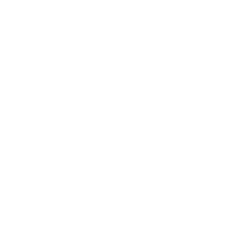

NameError: name 'lkat' is not defined

In [133]:
isize = 3

# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings_fixed[:,isize,:,8,0,1].max()
# lkat = np.ones_like(lkat)
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings[:,isize,:,8,0].max()
# lkat = slice(None)
plot_fn = ut.plot_bootstrapped_errorbars_hillel
i,j = 4,0

plt.figure(figsize=(2.5,2.5))
# plt.plot(ucontrast,couplings[lkat,3,:,8,0].T,c='k',alpha=0.1)
plot_fn(np.arange(6),couplings[lkat,isize,np.newaxis,:,i,j],pct=(16,84),colors=np.array((0,0,0))[np.newaxis])
# plt.plot(ucontrast,couplings_fixed[lkat,isize,:,8,0,1].T,c=np.array((1,0.65,0)),alpha=0.1)
plot_fn(np.arange(6),couplings_fixed[lkat,isize,np.newaxis,:,i,j,1],pct=(16,84),colors=np.array((1,0.65,0))[np.newaxis])
# ut.plot_bootstrapped_errorbars_hillel(np.arange(6),couplings_pcpv[lkat,isize,np.newaxis,:,8,0],pct=(16,84),colors=np.array((0,0,1))[np.newaxis])
plot_fn(np.arange(6),couplings_pcpv_rec_fixed[lkat,isize,np.newaxis,:,i,j],pct=(16,84),colors=np.array((0.7,0.7,0.7))[np.newaxis])
plot_fn(np.arange(6),couplings_pcpv_rec_fixed_plus_fixed[lkat,isize,np.newaxis,:,i,j,1],pct=(16,84),colors=np.array((0,1,0))[np.newaxis])

plt.xticks(np.arange(6),[0,6,12,25,50,100])
plt.xlabel('contrast (%)')
plt.ylabel(r'far PC$\rightarrow$PC coupling')
ut.erase_top_right()
# plt.legend(['baseline','SST fixed','PC/PV fixed','both fixed','PC & PV fixed'])
plt.tight_layout()
# plt.savefig('figures/far_pc_coupling_sst_fixed.eps')

<IPython.core.display.Javascript object>


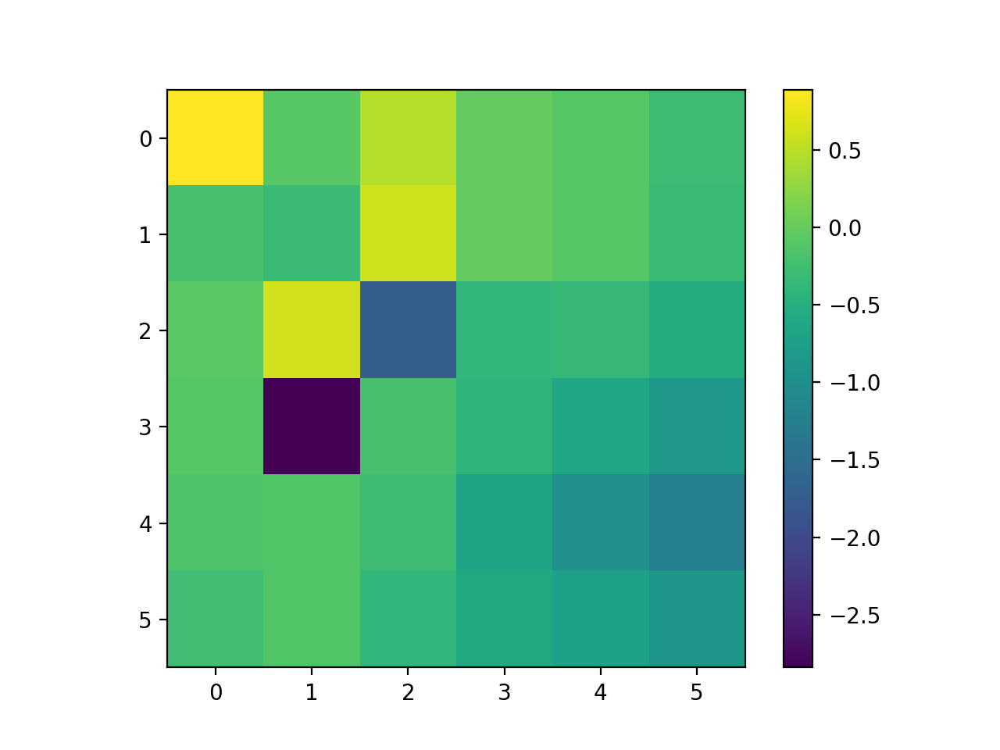

<IPython.core.display.Javascript object>


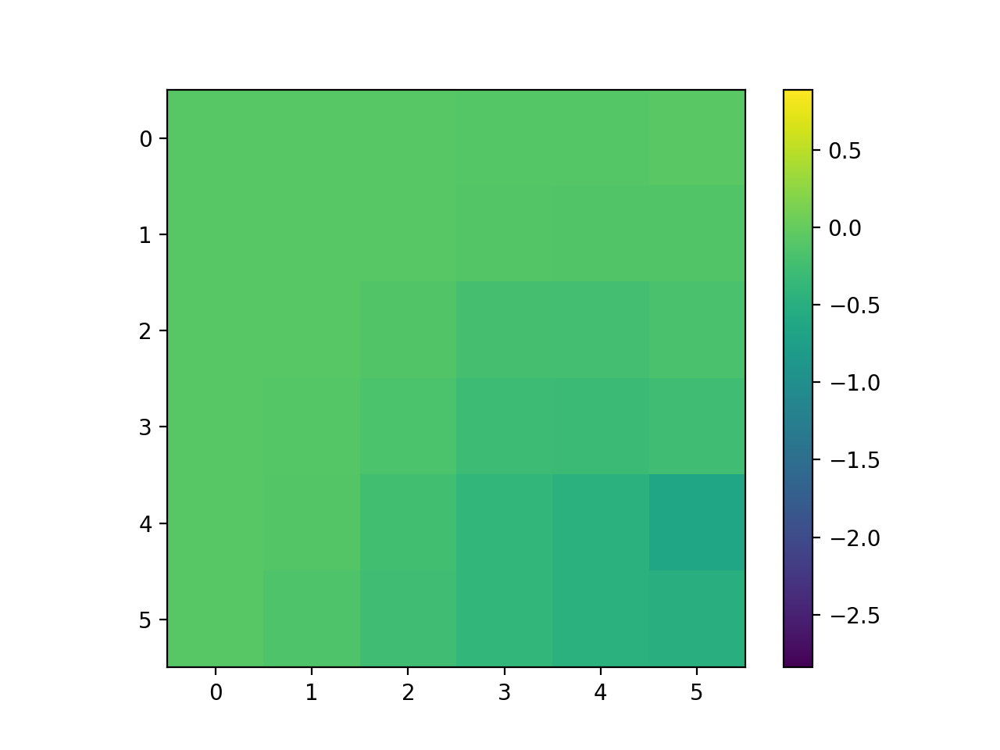

In [970]:
iwt = 1
data = np.mean(couplings[:,:,:,8,0],0)
plt.figure()
plt.imshow(data,vmin=data.min(),vmax=data.max())
plt.colorbar()
plt.figure()
plt.imshow(np.median(couplings_fixed[:,:,:,8,0,1],0),vmin=data.min(),vmax=data.max())
plt.colorbar()

In [265]:
plt.close('all')

<IPython.core.display.Javascript object>


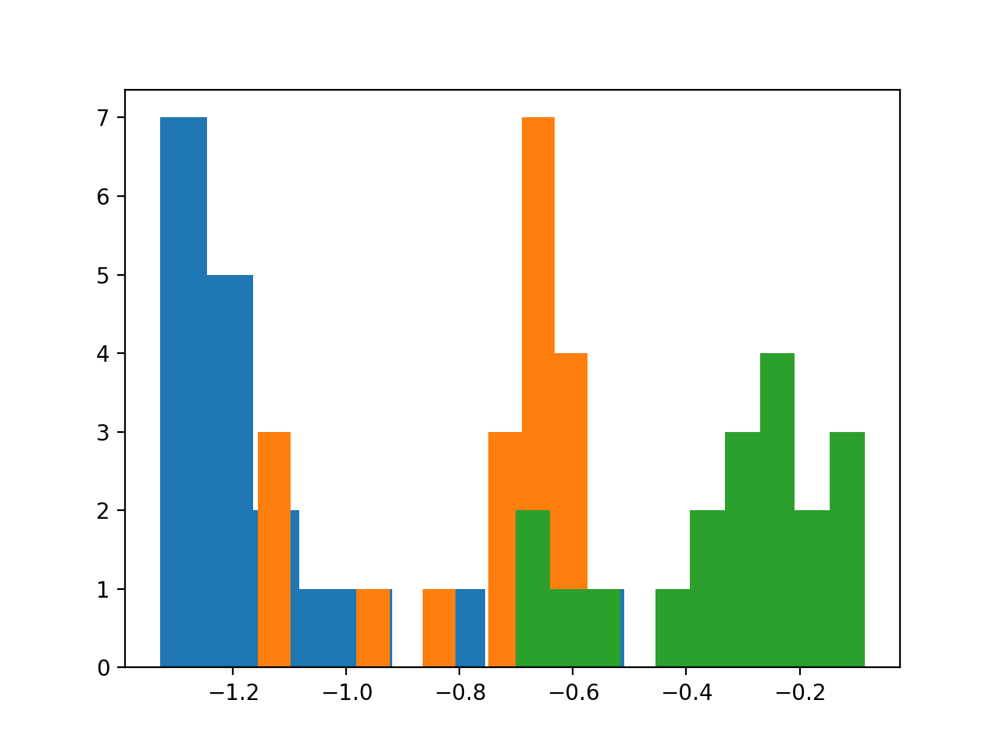

(array([2., 1., 1., 0., 1., 2., 3., 4., 2., 3.]),
 array([-0.70187236, -0.64018542, -0.57849849, -0.51681156, -0.45512463,
        -0.3934377 , -0.33175077, -0.27006384, -0.20837691, -0.14668998,
        -0.08500304]),
 <a list of 10 Patch objects>)

In [266]:
plt.figure()
plt.hist(Wmys[:,2,1])
plt.hist(Wmys[:,1,2])
plt.hist(Wmys[:,1,0])

<IPython.core.display.Javascript object>


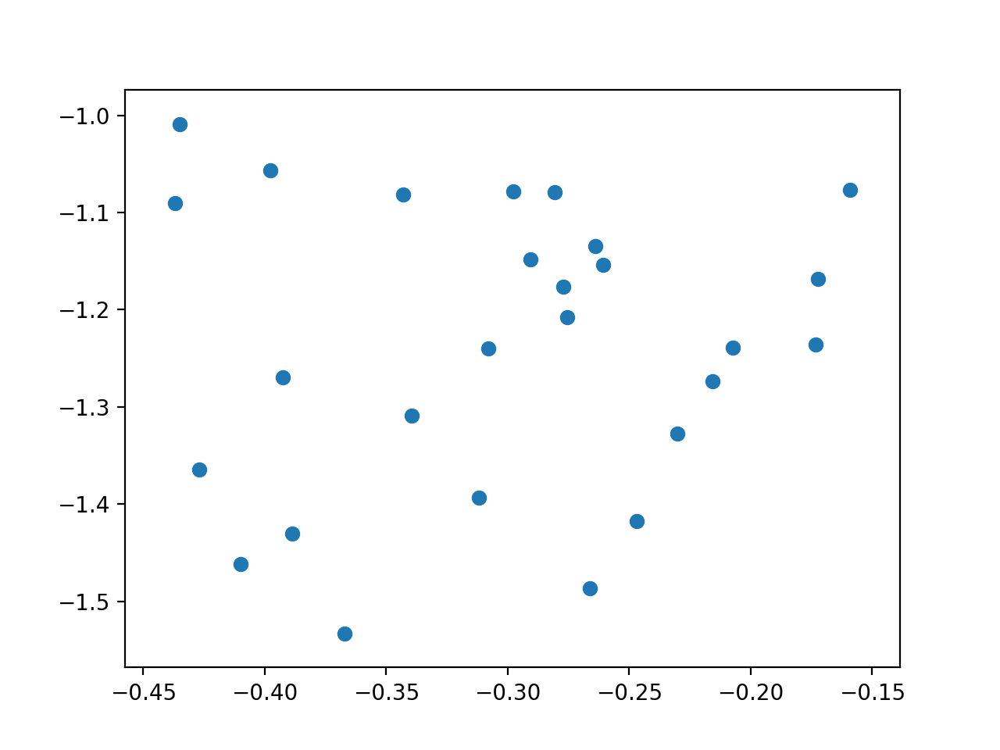

In [27]:
plt.figure()
plt.scatter(Wmys[:,2,1],Wmys[:,1,2])

In [1108]:
def var_explained(x,y):
    return 1-np.mean((x-y)**2)/np.var(x)

In [1070]:
this_ncontrast = 3
cfrac = np.linspace(1,0,this_ncontrast+1)[:-1]
c_l4 = cfrac[:,np.newaxis]*np.array(((0,1,0)))
c_sst = cfrac[:,np.newaxis]*np.array(((1,0.65,0)))
c_vip = cfrac[:,np.newaxis]*np.array(((1,0,1)))
c_pv = cfrac[:,np.newaxis]*np.array(((0,0,1)))
c_l23 = cfrac[:,np.newaxis]*np.array(((0.5,0.5,0.5)))
colors = [c_l4,c_l23,c_sst,c_vip,c_pv]

In [626]:
usize = np.array([5,8,13,22,36,60])
ucontrast = np.array([0,6,12,25,50,100])

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


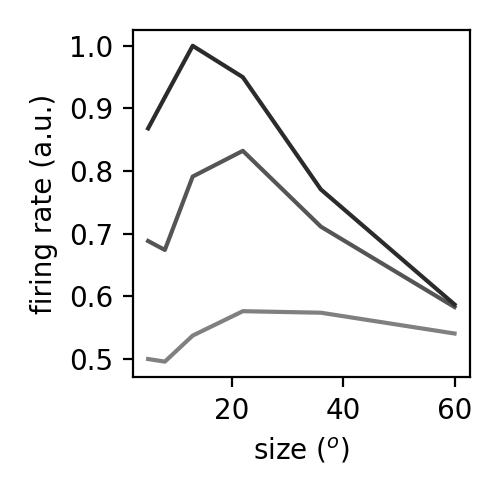

<IPython.core.display.Javascript object>


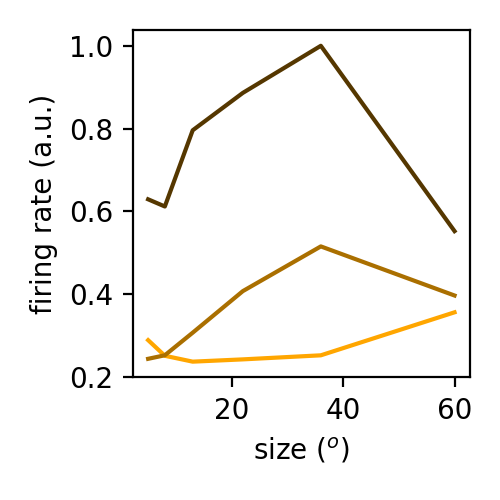

<IPython.core.display.Javascript object>


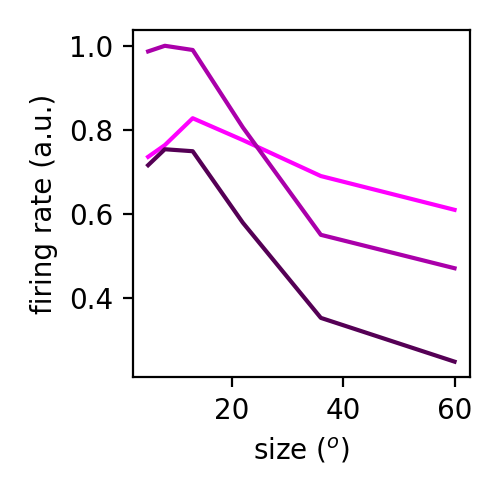

<IPython.core.display.Javascript object>


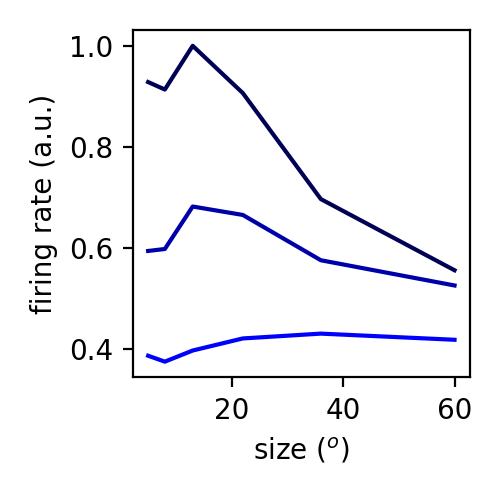

In [627]:
data = YYhat.reshape(nsize,ncontrast,nQ*nS*nT)
for itype in range(4):
    plt.figure(figsize=(2.5,2.5))
    for iicontrast,icontrast in enumerate([1,3,5]):
        plt.plot(usize,data[:,icontrast,itype],c=colors[itype+1][iicontrast])#,c=colors[itype+1])
    plt.xlabel('size ($^o$)')
    plt.ylabel('firing rate (a.u.)')
    plt.tight_layout()
#     plt.savefig('figures/modeled_%s_size_tuning.eps'%lbls[itype])

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


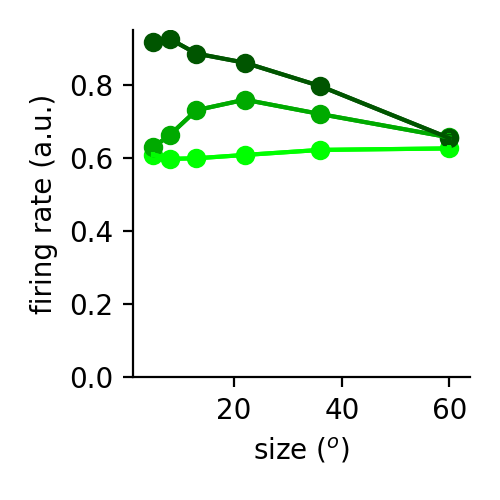

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.9182933256559322


In [1091]:
for itype in range(1):
    plt.figure(figsize=(2.5,2.5))
    ut.plot_bootstrapped_errorbars_hillel(usize,XXs[ifit][low_loss[ifit]][:,:,[1,3,5],itype].transpose((0,2,1)),colors=colors[0])
    plt.xlabel('size ($^o$)')
    plt.ylabel('firing rate (a.u.)')
    plt.tight_layout()
    ut.erase_top_right()
    ut.zero_origin()
    plt.savefig('figures/pre_opto_modeled_L4_size_tuning.eps')


<IPython.core.display.Javascript object>


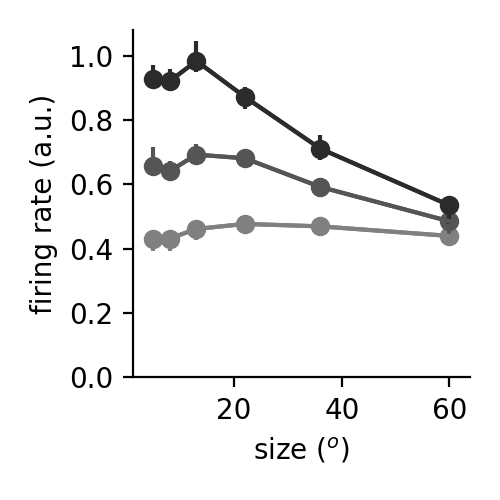

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


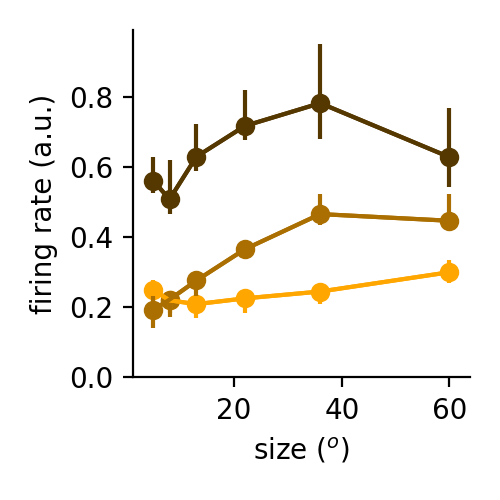

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


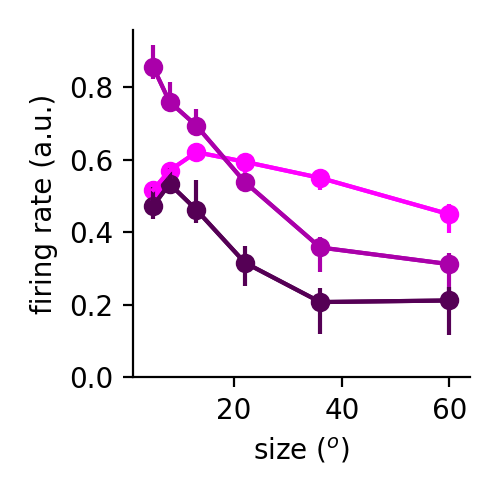

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


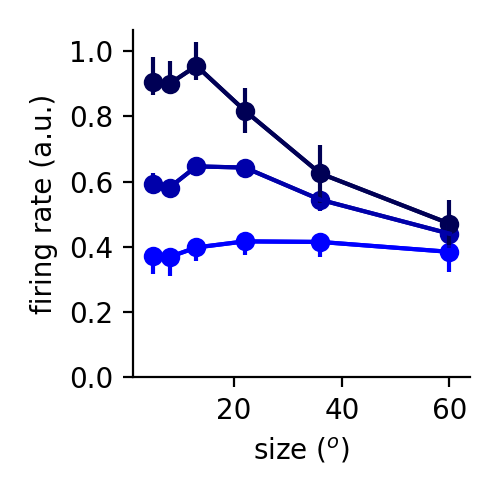

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


In [1072]:
for itype in range(4):
    plt.figure(figsize=(2.5,2.5))
    ut.plot_pct_errorbars_hillel(usize,YYs[ifit][low_loss[ifit]][:,:,[1,3,5],itype].transpose((0,2,1)),colors=colors[itype+1])
    plt.xlabel('size ($^o$)')
    plt.ylabel('firing rate (a.u.)')
    ut.erase_top_right()
    ut.zero_origin()
    plt.tight_layout()
    plt.savefig('figures/pre_opto_modeled_%s_size_tuning.eps'%lbls[itype])
    

In [100]:
YYs[lkat,:,[1,3,5],itype].shape#.transpose((0,2,1))


IndexError: shape mismatch: indexing arrays could not be broadcast together with shapes (119,) (3,) 

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


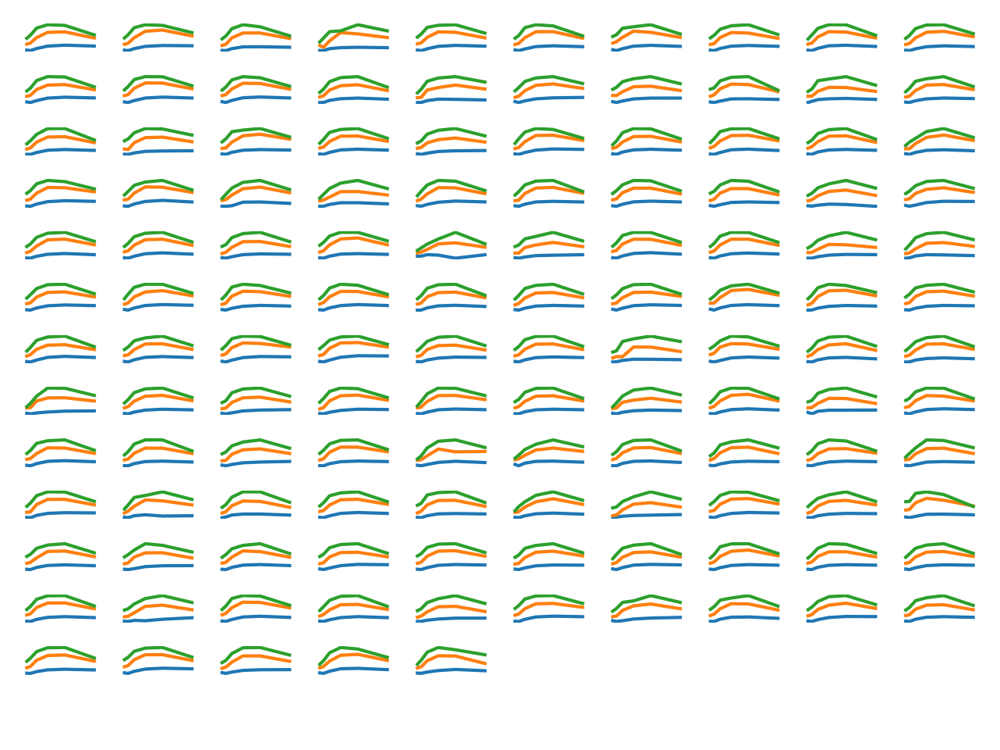

In [1115]:
plt.figure()#figsize=(2.5,2.5))
for iwt in range(nfiles):
    for itype in range(1):
        plt.subplot(14,10,iwt+1)
        plt.plot(usize,YYs[iwt,:,[1,3,5],itype].T)#,colors=colors[itype+1])
        plt.xlabel('size ($^o$)')
        plt.ylabel('firing rate (a.u.)')
    plt.axis('off')
    plt.tight_layout()
#     plt.savefig('figures/modeled_%s_size_tuning.eps'%lbls[itype])

In [286]:
# plt.figure(figsize=(5,2.5))
types = [0,1]
ccs = np.zeros((nfiles,nQ*nS*nT))
for iwt in range(nfiles):
    for itype,thistype in enumerate(np.arange(nQ*nS*nT)):
#         plt.subplot(1,2,itype+1)
        xdata = YYhat[:,thistype].reshape((6,6))
        ydata = YYs[iwt,:,:,thistype]
    #     sca.scatter_size_contrast(xdata,ydata)
        ccs[iwt,itype] = var_explained(xdata,ydata)

In [455]:
import os
os.listdir('/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/')

['vip_chrimson_data_for_sim.npy',
 'fit_graphics',
 'dynamics',
 '.DS_Store',
 'rs_vm_denoise_200605.npy',
 'weights',
 'vip_halo_data_for_sim.npy']

In [475]:
npyfile = np.load('/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/vip_halo_data_for_sim.npy',allow_pickle=True)[()]
Yhat_opto = npyfile['Yhat_opto']


In [1074]:
npyfile = np.load('/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/vip_halo_data_for_sim_vip_full_info.npy',allow_pickle=True)[()]
Yhat_halo = npyfile['Yhat_opto']
npyfile = np.load('/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/vip_chrimson_data_for_sim.npy',allow_pickle=True)[()]
Yhat_chrimson = npyfile['Yhat_opto']


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:17: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


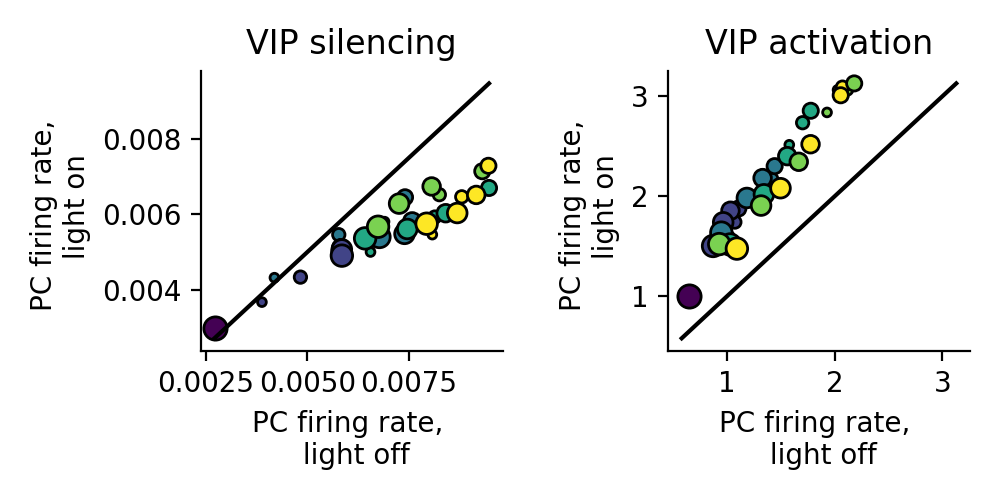

<IPython.core.display.Javascript object>


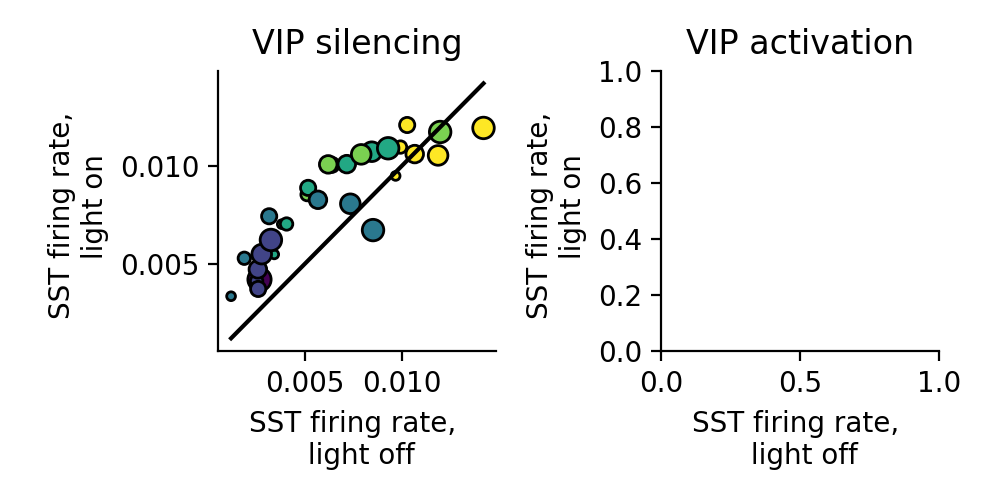

<IPython.core.display.Javascript object>


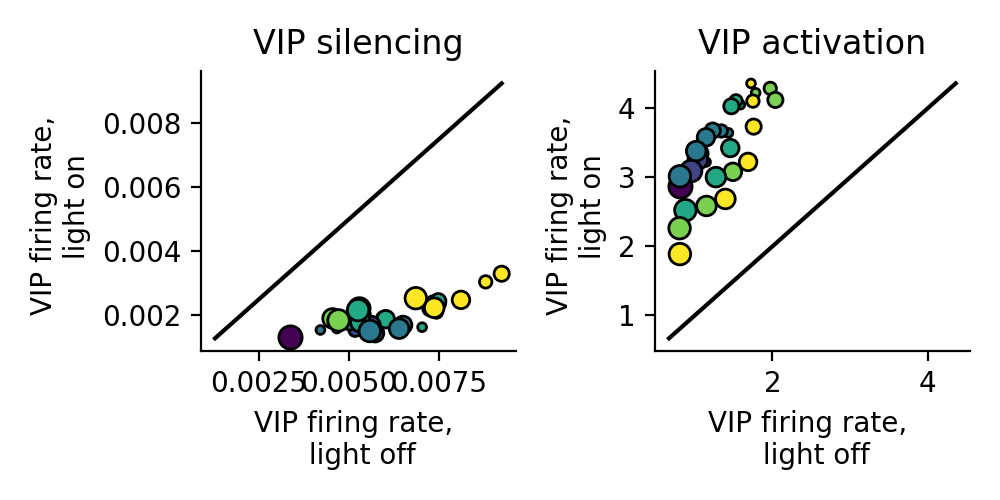

<IPython.core.display.Javascript object>


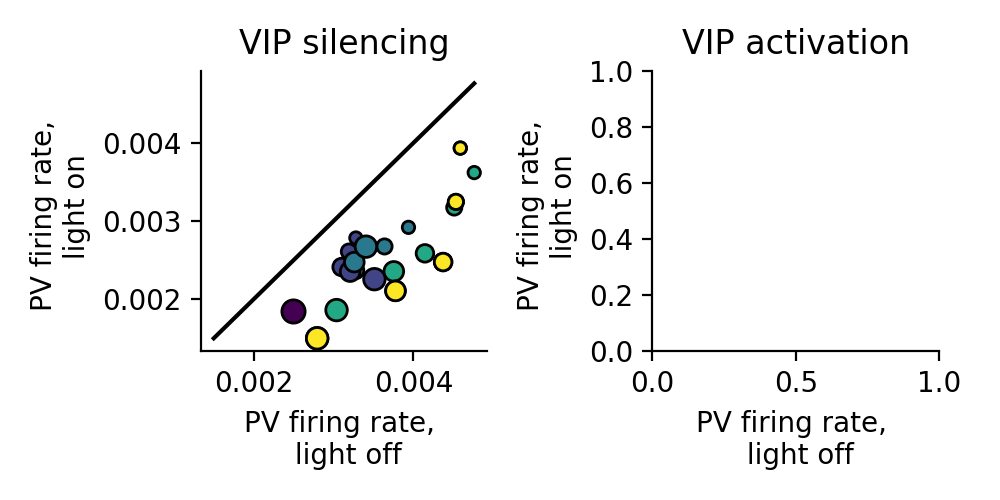

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:30: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


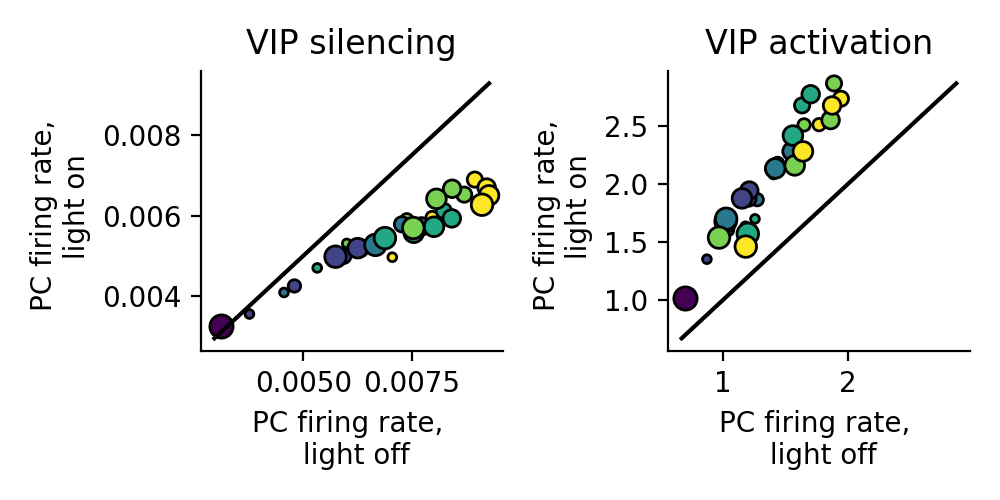

<IPython.core.display.Javascript object>


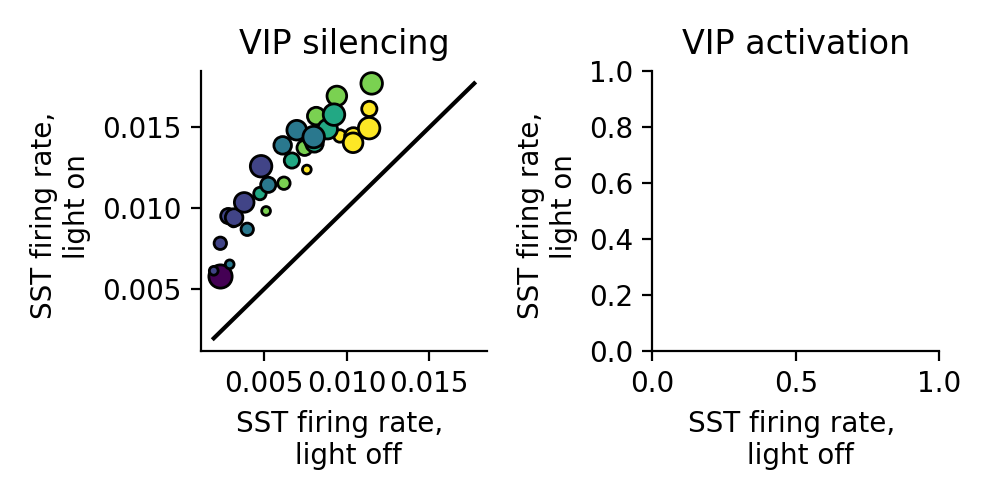

<IPython.core.display.Javascript object>


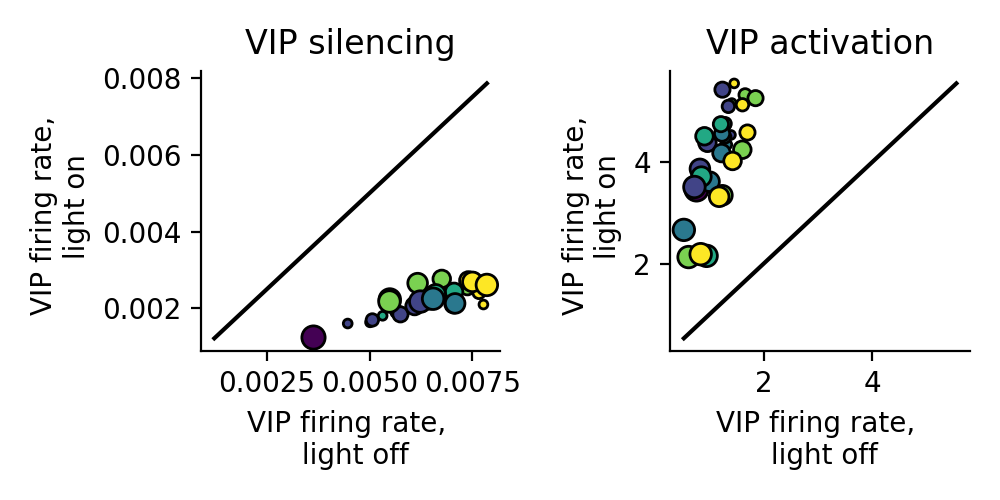

<IPython.core.display.Javascript object>


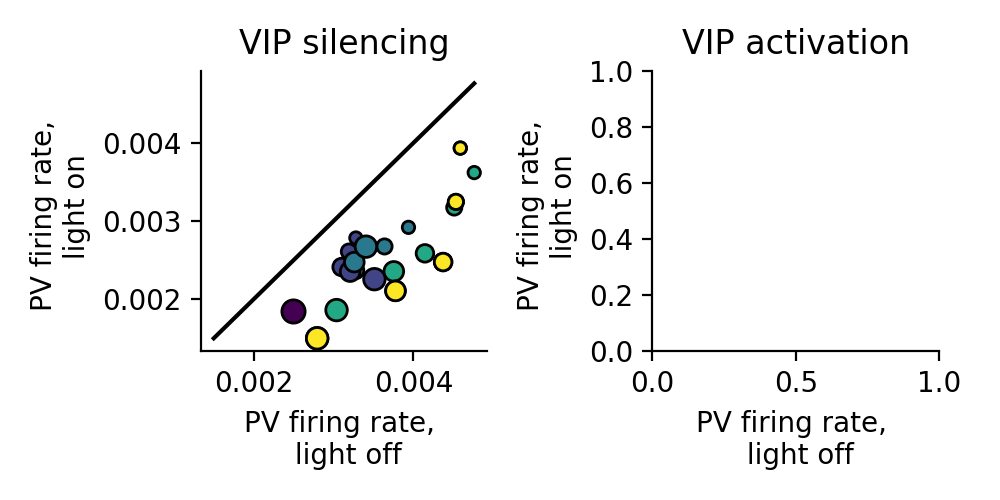

In [1077]:
# lbls = ['PC','SST','VIP','PV']
# for itype in np.arange(4):
#     plt.figure(figsize=(5,2.5))
#     titles = ['VIP silencing','VIP activation']
#     for iyy,yy in enumerate([YY1s,YY2s]):
#         plt.subplot(1,2,iyy+1)
#         sca.scatter_size_contrast_errorbar(YYs[lkat,:,:,itype],yy[lkat,:,:,itype])#,mn=0)
#         plt.title(titles[iyy])
#         plt.xlabel('%s event rate, \n light off'%lbls[itype])
#         plt.ylabel('%s event rate, \n light on'%lbls[itype])
#         ut.erase_top_right()
#     plt.tight_layout()
#     plt.savefig('figures/bidi_nonlinear_%s_scatter_size_contrast.eps'%lbls[itype])
mxs = [1,1.5,2,1]
lbls = ['PC','SST','VIP','PV']
for itype in range(4):#8,12):
    plt.figure(figsize=(5,2.5))
    titles = ['VIP silencing','VIP activation']
    for iyy,yy in enumerate([Yhat_halo,Yhat_chrimson]):
        plt.subplot(1,2,iyy+1)
        if np.sum(~np.isnan(yy[:,itype]))>0:
            sca.scatter_size_contrast(yy[0::2,itype],yy[1::2,itype],nsize=6,ncontrast=6,equate_0=True)#,mn=0,mx=mxs[itype])
        plt.title(titles[iyy])
        plt.xlabel('%s firing rate, \n light off'%lbls[np.remainder(itype,4)])
        plt.ylabel('%s firing rate, \n light on'%lbls[np.remainder(itype,4)])
        ut.erase_top_right()
    plt.tight_layout()
    
for itype in range(4):#8,12):
    plt.figure(figsize=(5,2.5))
    titles = ['VIP silencing','VIP activation']
    for iyy,yy in enumerate([Yhat_halo,Yhat_chrimson]):
        plt.subplot(1,2,iyy+1)
        if np.sum(~np.isnan(yy[:,itype]))>0:
            sca.scatter_size_contrast(yy[0::2,itype+8],yy[1::2,itype+8],nsize=6,ncontrast=6,equate_0=True)#,mn=0,mx=mxs[itype])
        plt.title(titles[iyy])
        plt.xlabel('%s firing rate, \n light off'%lbls[np.remainder(itype,4)])
        plt.ylabel('%s firing rate, \n light on'%lbls[np.remainder(itype,4)])
        ut.erase_top_right()
    plt.tight_layout()
#     plt.savefig('figures/bidi_nonlinear_%s_scatter_size_contrast.eps'%lbls[itype])

<IPython.core.display.Javascript object>


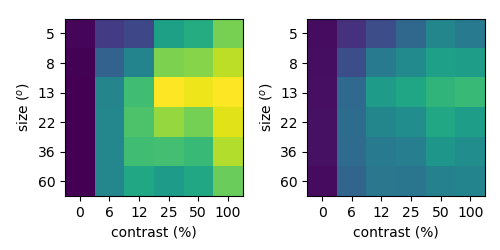

<IPython.core.display.Javascript object>


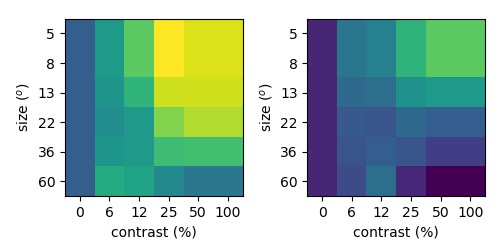

In [373]:
for itype in [0,3]:
    mn = np.nanmin(Yhat_halo[:,itype])
    mx = np.nanmax(Yhat_halo[:,itype])
    plt.figure(figsize=(5,2.5))
    for ilight in range(2):
        plt.subplot(1,2,ilight+1)
        sca.show_size_contrast(Yhat_halo[:,itype].reshape((6,6,2))[:,:,ilight],vmin=mn,vmax=mx)
    plt.tight_layout()


In [460]:
dYY = Yhat_opto[1::2]-Yhat_opto[0::2]

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


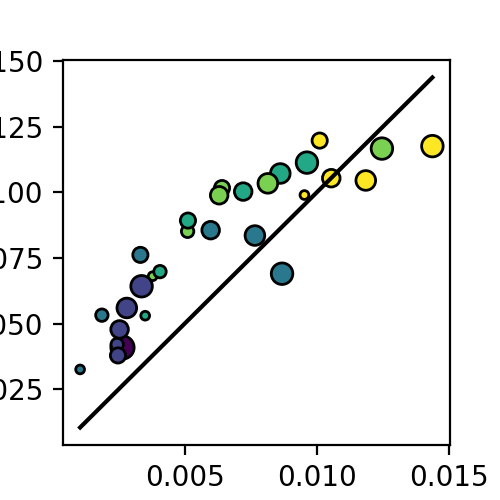

In [1349]:
itype = 1
plt.figure(figsize=(2.5,2.5))
sca.scatter_size_contrast(Yhat_opto[0::2,itype],Yhat_opto[1::2,itype],nsize=6,ncontrast=6,equate_0=True)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


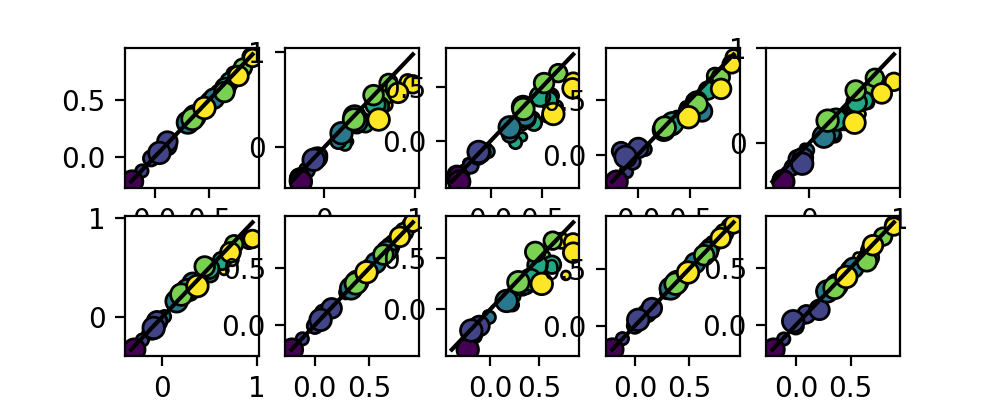

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  import sys


<IPython.core.display.Javascript object>


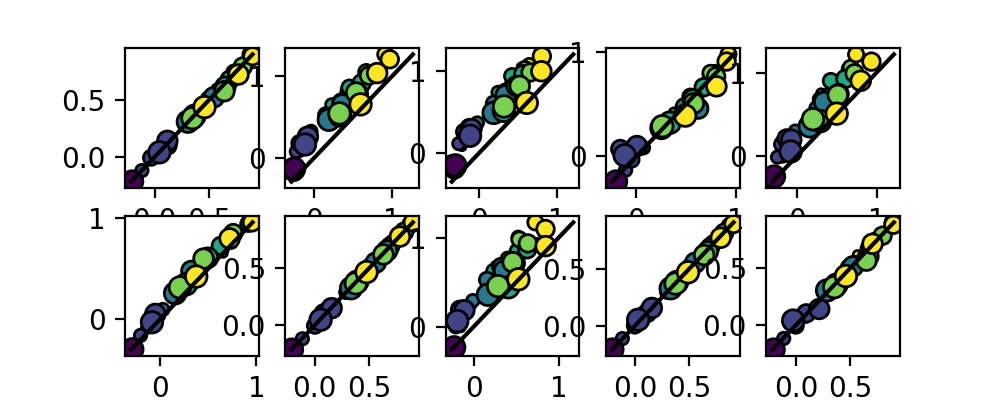

<IPython.core.display.Javascript object>


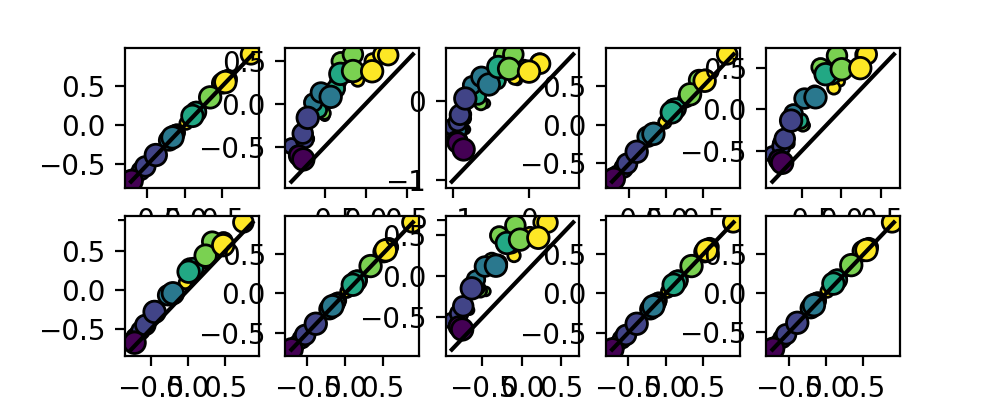

<IPython.core.display.Javascript object>


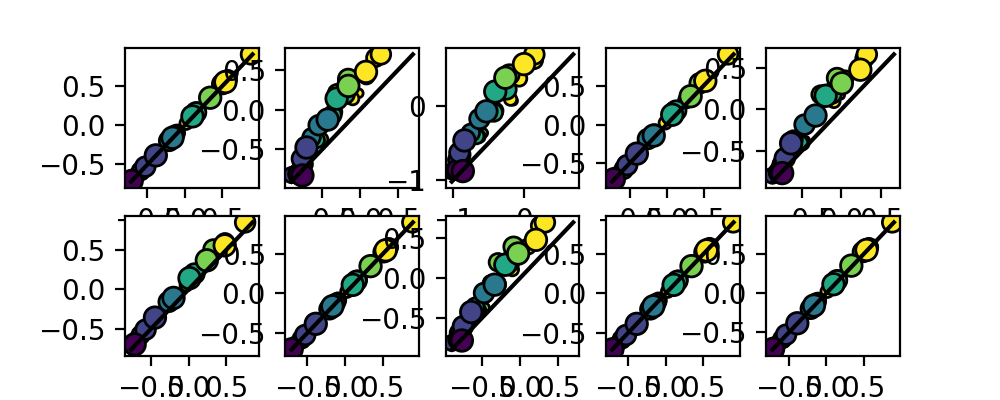

<IPython.core.display.Javascript object>


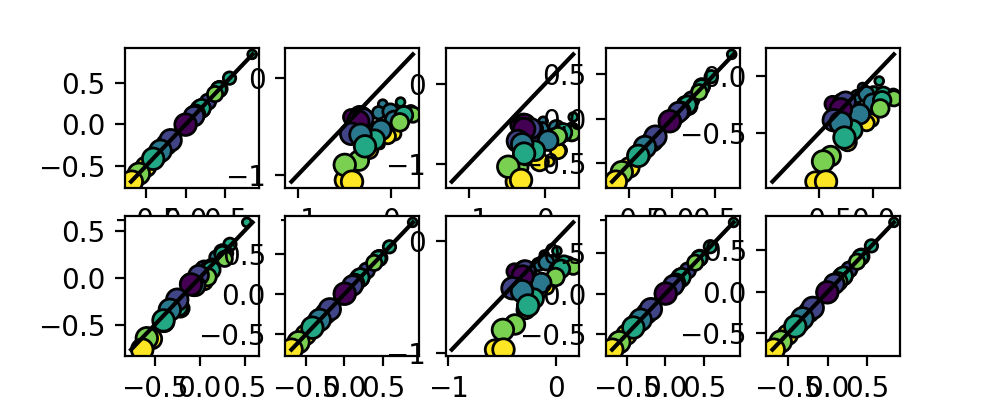

<IPython.core.display.Javascript object>


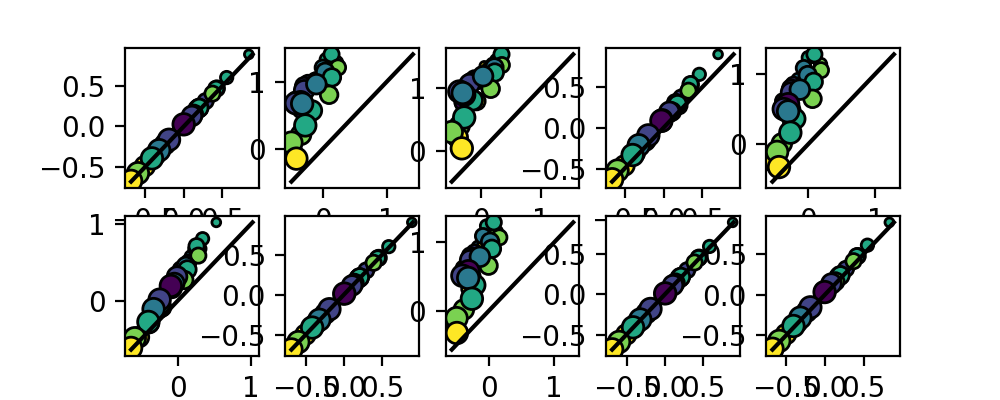

In [1532]:
iwt = 0
for itype in range(3):
    plt.figure(figsize=(5,2))
    for iwt in range(10):
        plt.subplot(2,5,iwt+1)
        sca.scatter_size_contrast(Etas[iwt,:,:,itype],Eta1s[iwt,:,:,itype],nsize=6,ncontrast=6)
    plt.figure(figsize=(5,2))
    for iwt in range(10):
        plt.subplot(2,5,iwt+1)
        sca.scatter_size_contrast(Etas[iwt,:,:,itype],Eta2s[iwt,:,:,itype],nsize=6,ncontrast=6)

<IPython.core.display.Javascript object>


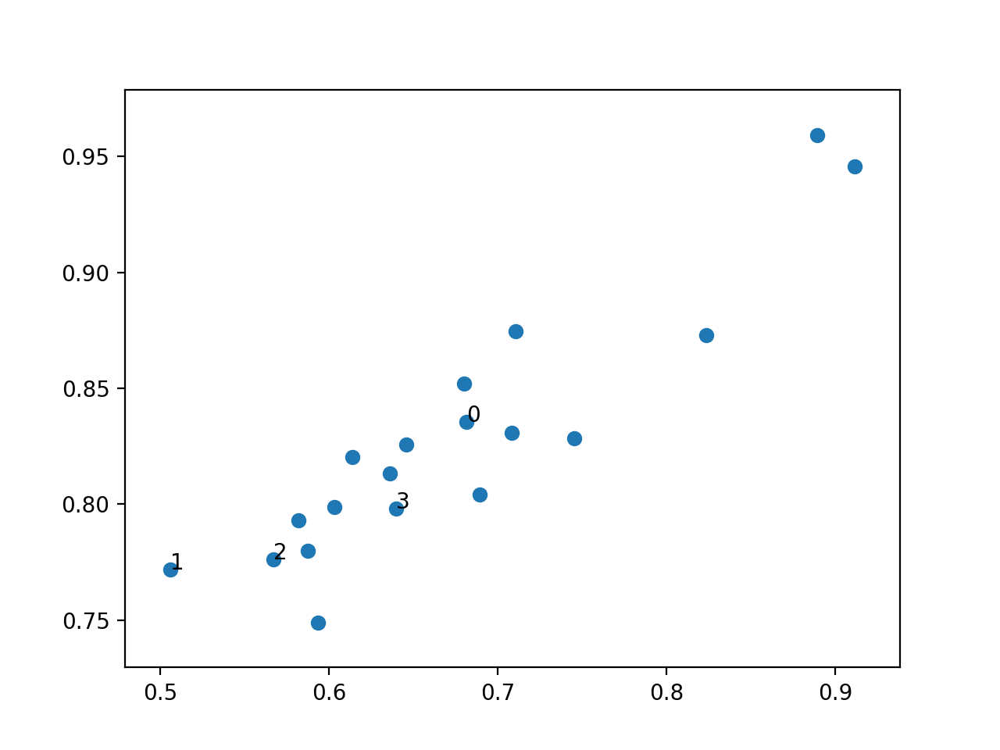

In [410]:
plt.figure()
plt.scatter(ccs[:,0],ccs[:,1])
for iwt in range(nfiles):
    plt.text(ccs[iwt,0],ccs[iwt,1],iwt)
lkat = (ccs[:,0]>0.8) & (ccs[:,1]>0.9)
nlkat = lkat.sum()

In [1121]:
len(weights_files)


372

In [1122]:
weights_files

['/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_201203g/000.npy',
 '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_201203g/001.npy',
 '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_201203g/002.npy',
 '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_201203g/003.npy',
 '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_201203g/004.npy',
 '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_201203g/005.npy',
 '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_201203g/006.npy',
 '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_201203g/007.npy',
 '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_201203g/008.npy',
 '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weight

In [170]:
# these_weights_files = [weights_files[i] for i in np.where(lkat)[0]] # weights_files.copy()# weights_files.copy() #[3,4,5,10,12,23]
these_weights_files = [weights_files[i] for i in np.where(lkat)[0]]#[[3,4,5,10,12,23]]] # weights_files.copy()# weights_files.copy() #
np.save('weights_files_list.npy',these_weights_files,allow_pickle=True)

In [171]:
np.where(lkat)[0].dtype

dtype('int64')

<IPython.core.display.Javascript object>


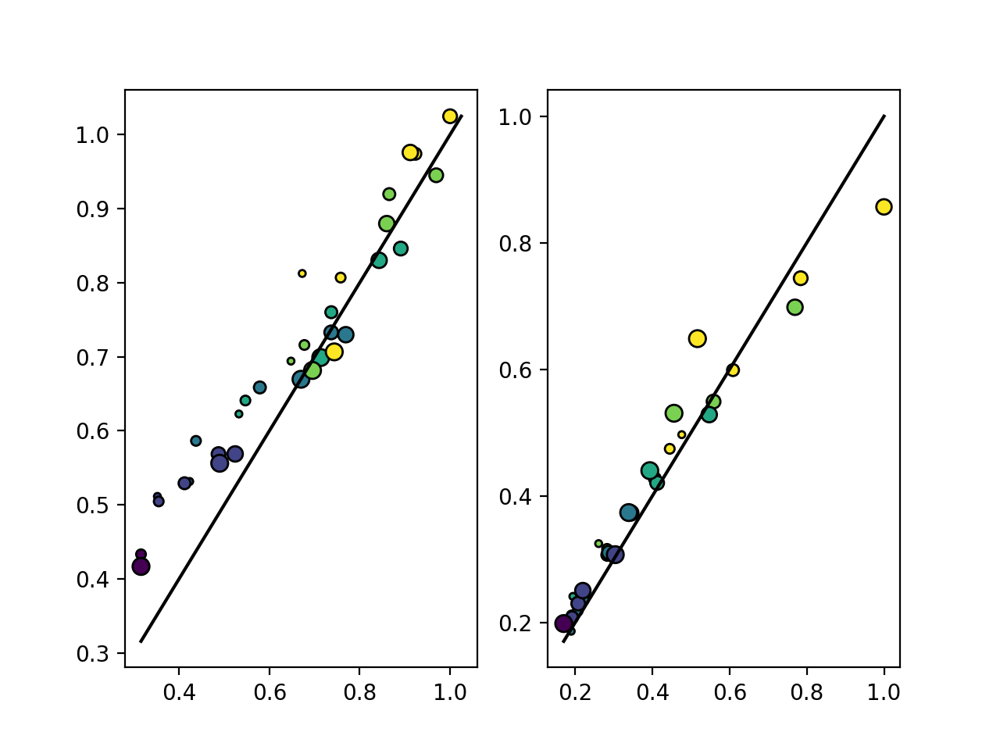

<IPython.core.display.Javascript object>


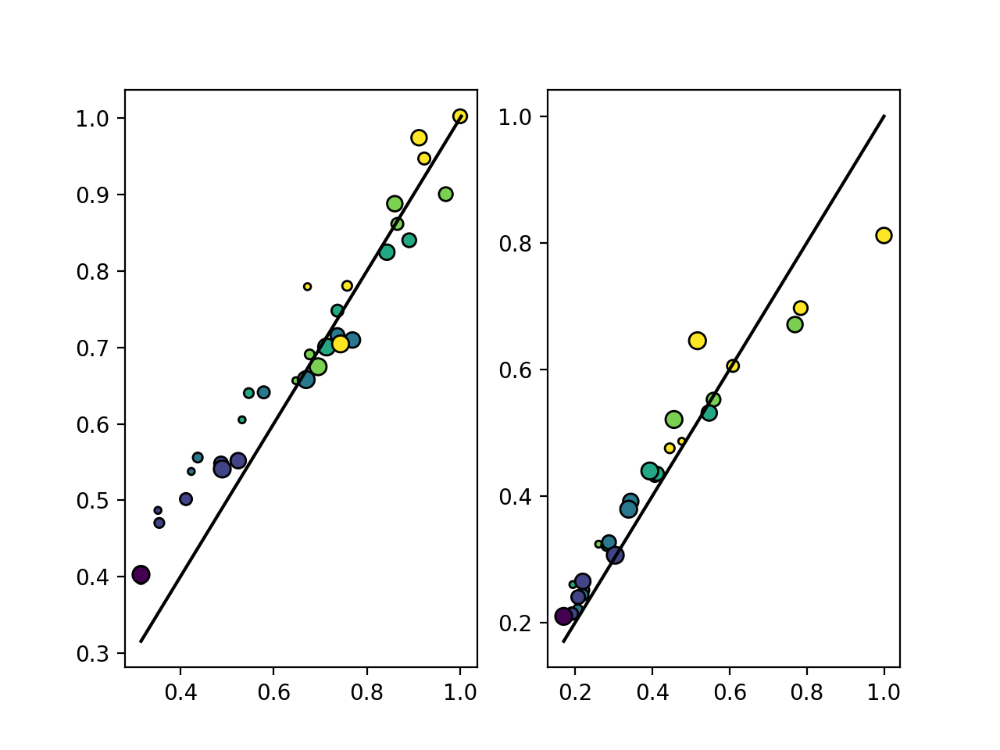

<IPython.core.display.Javascript object>


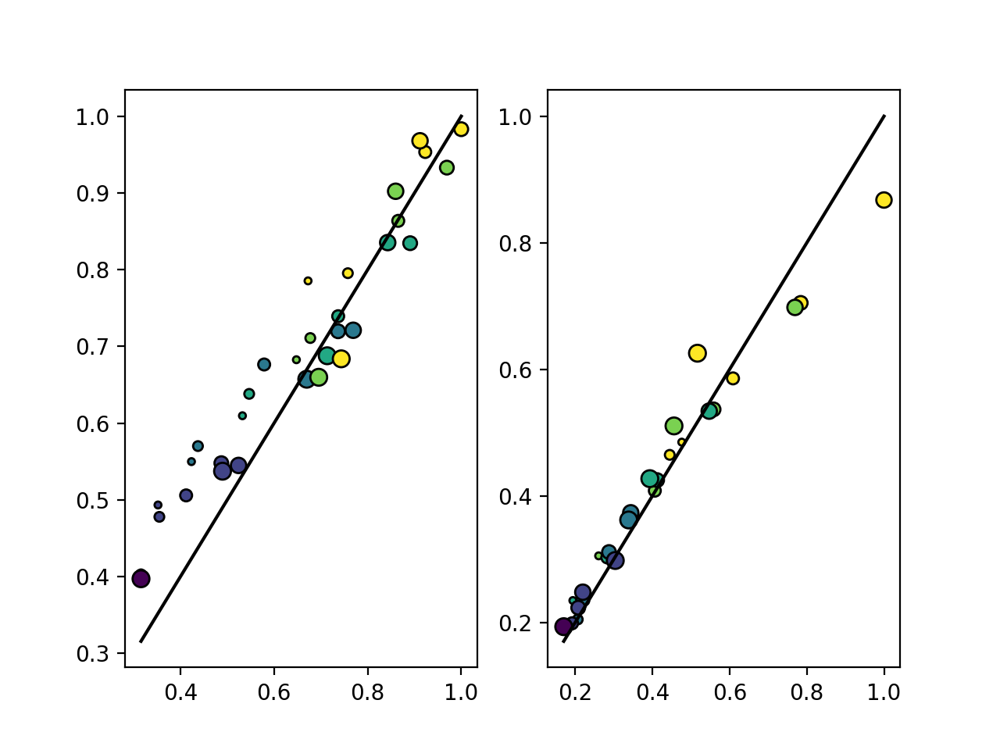

<IPython.core.display.Javascript object>


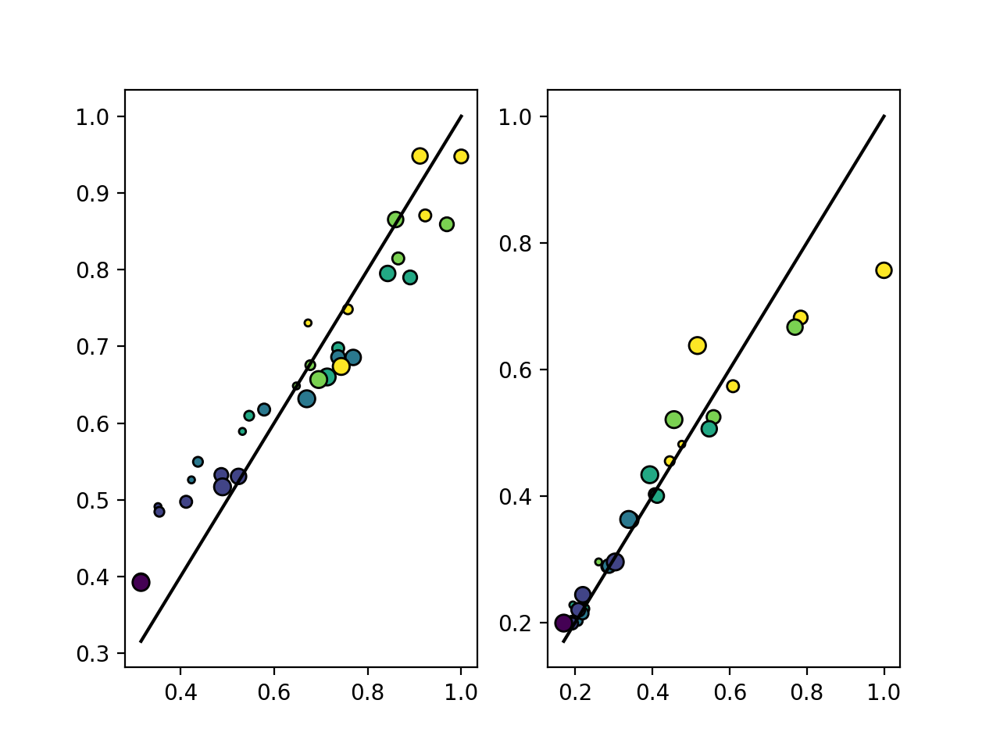

<IPython.core.display.Javascript object>


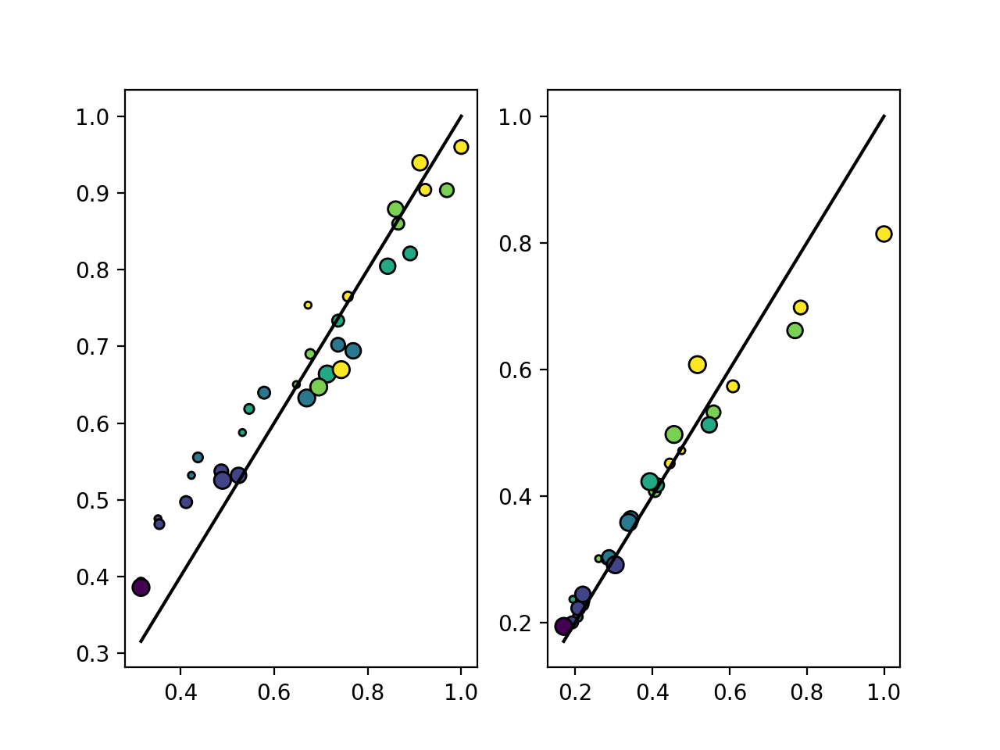

<IPython.core.display.Javascript object>


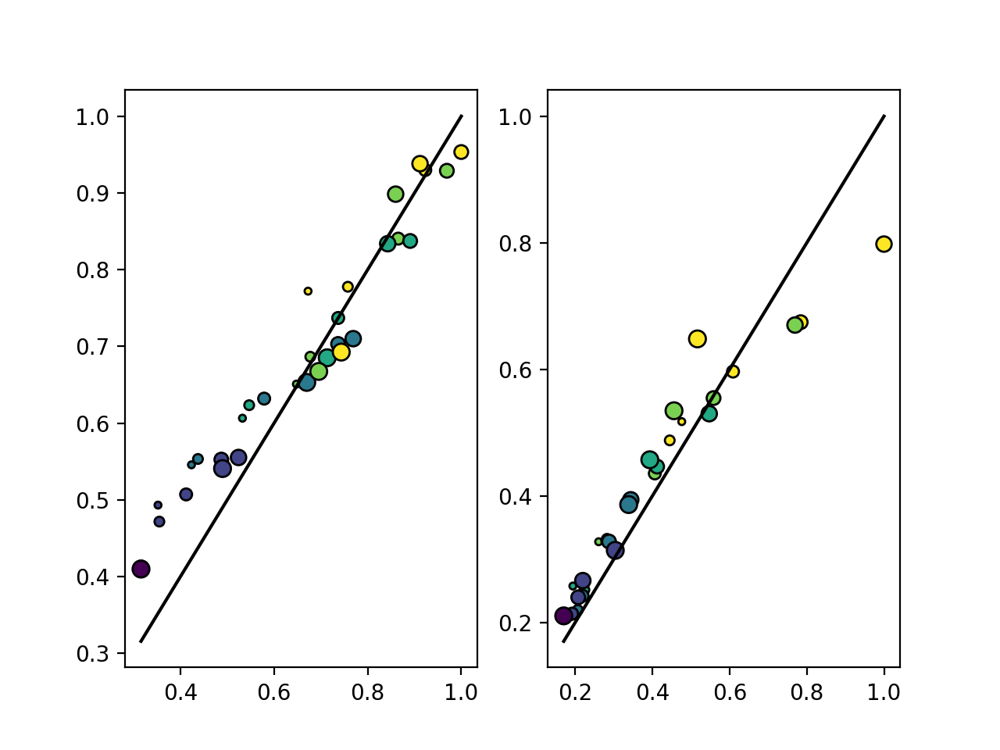

<IPython.core.display.Javascript object>


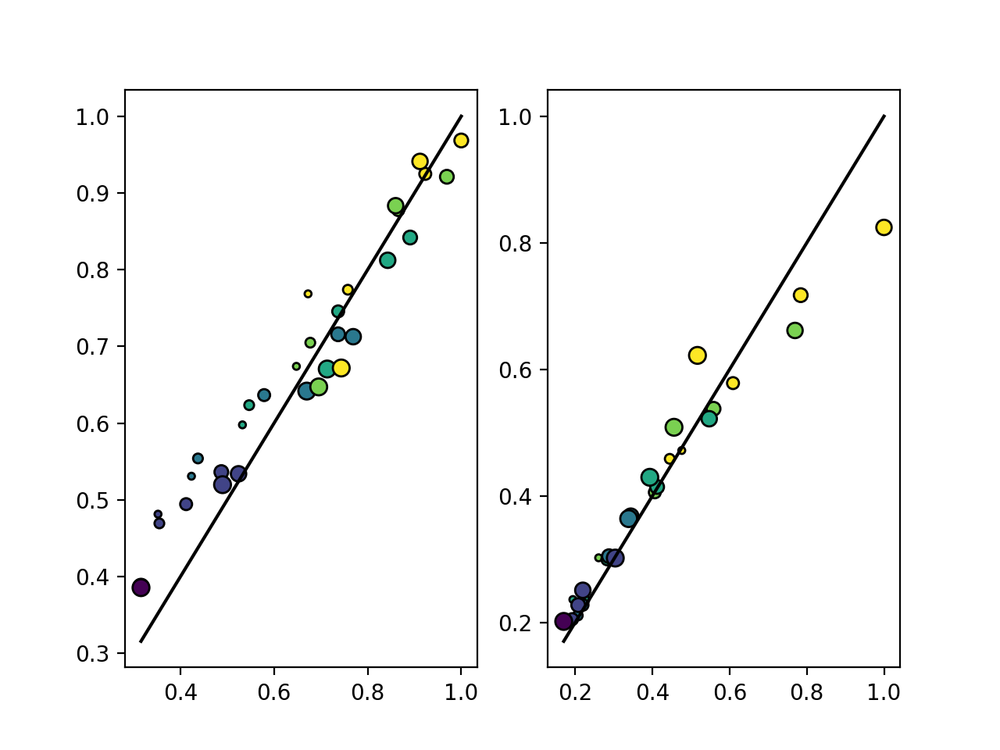

<IPython.core.display.Javascript object>


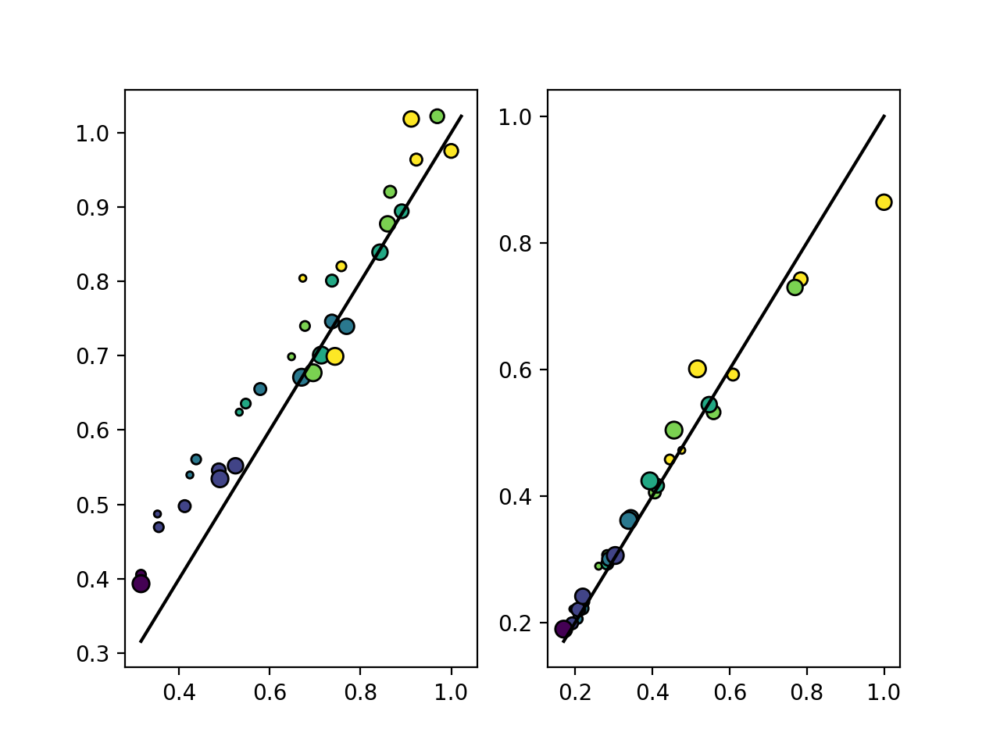

<IPython.core.display.Javascript object>


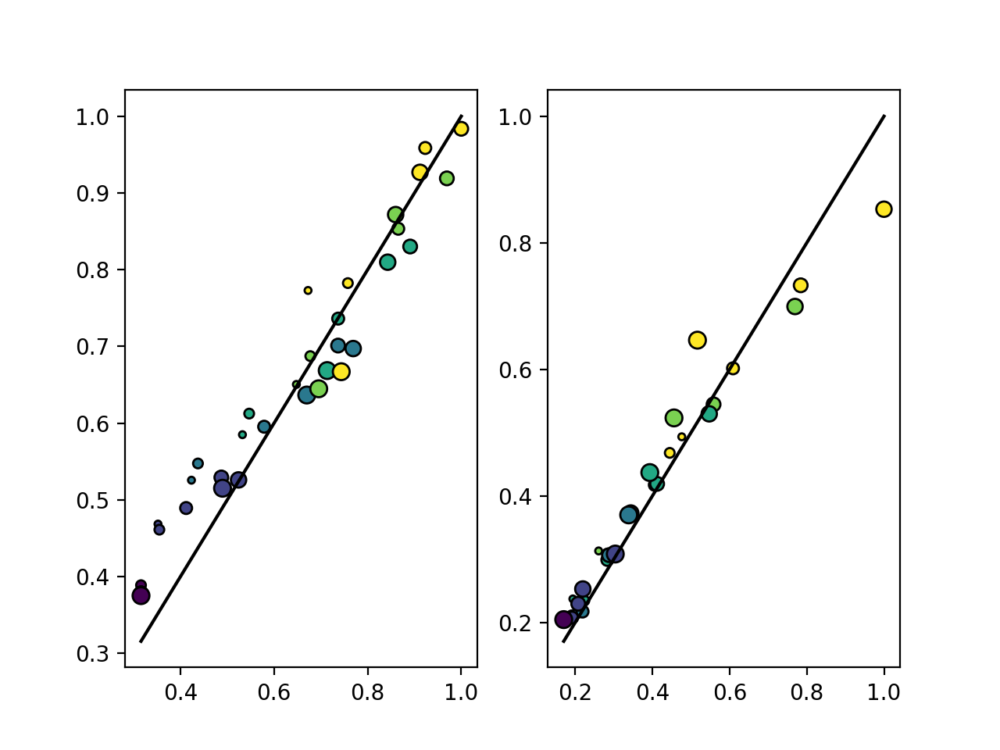

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


<IPython.core.display.Javascript object>


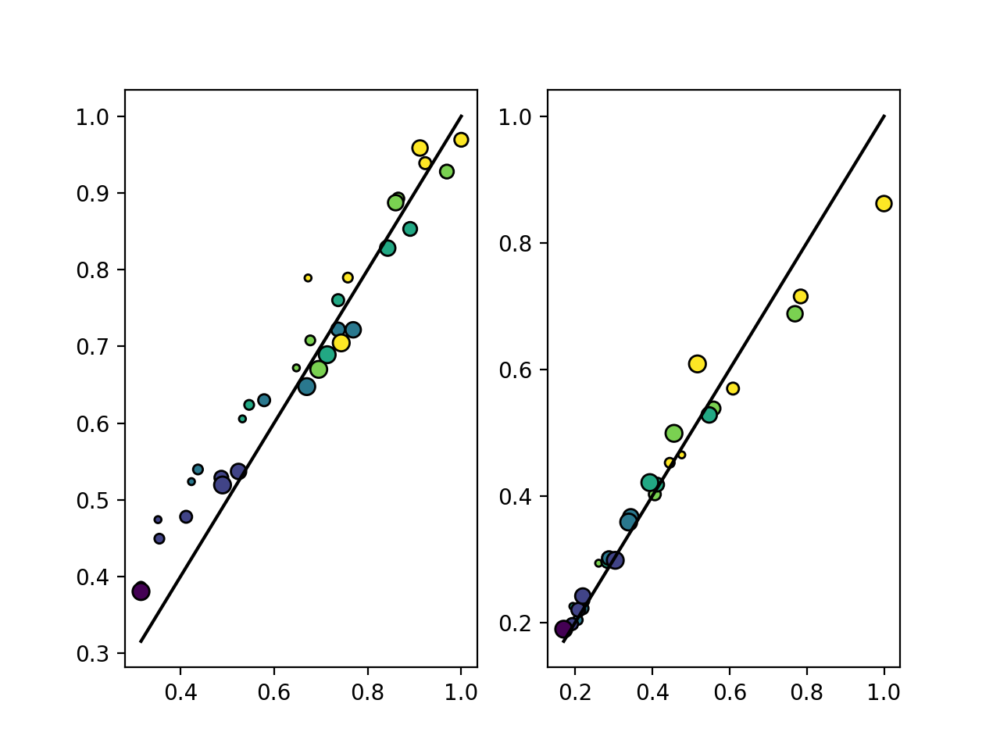

<IPython.core.display.Javascript object>


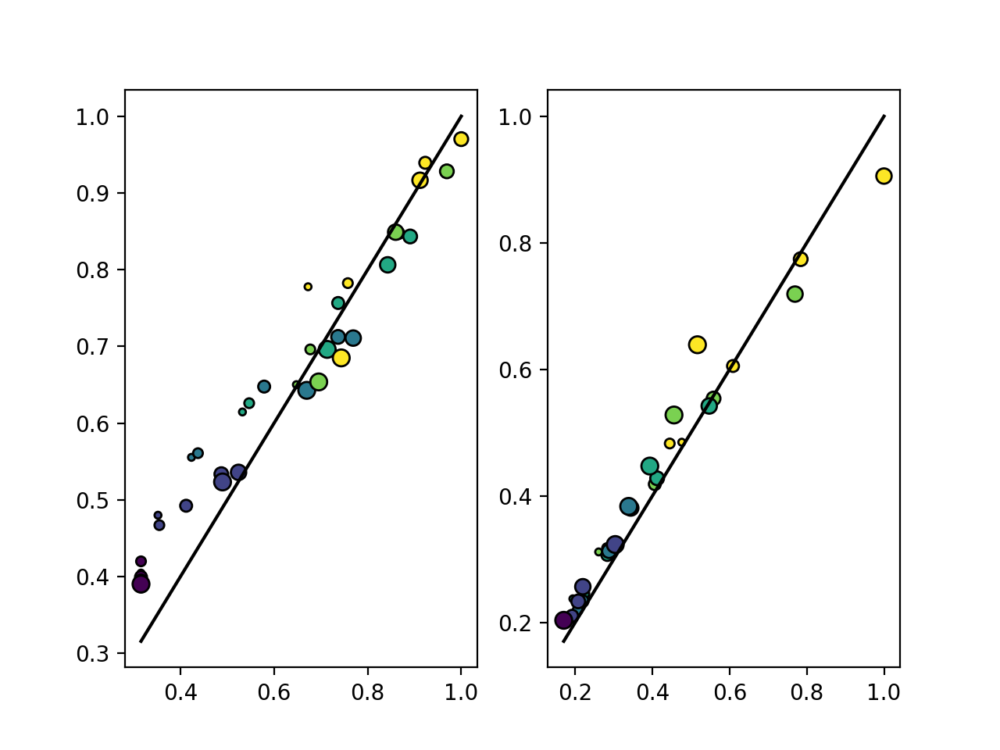

<IPython.core.display.Javascript object>


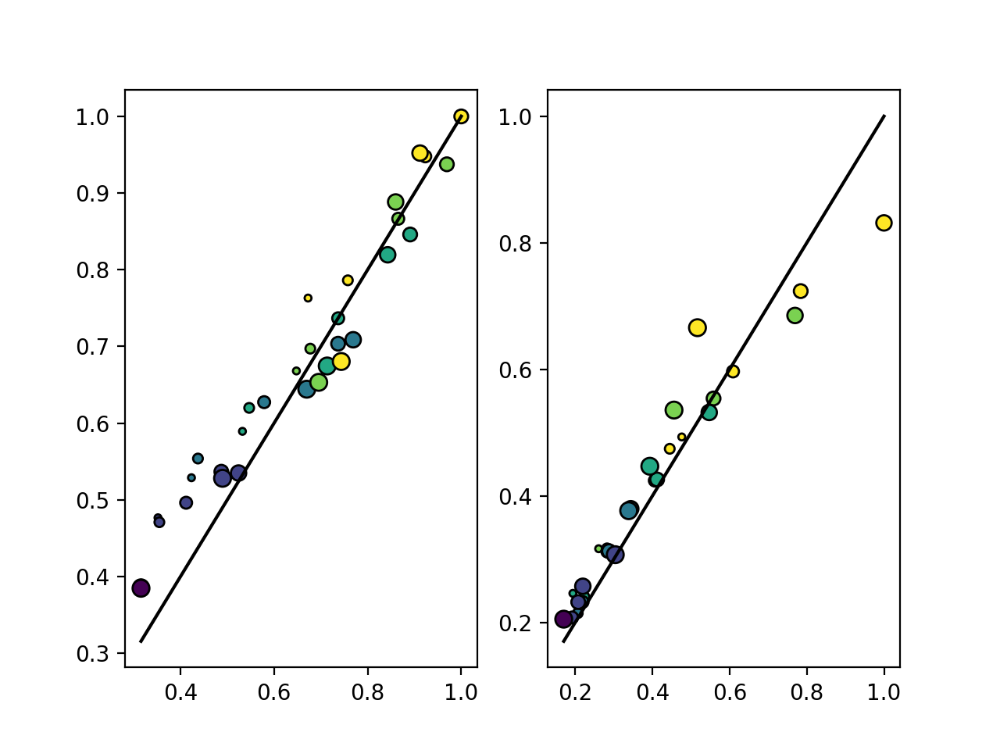

In [48]:
types = [0,1]
ccs = np.zeros((nfiles,nQ*nS*nT))
for iwt in range(nfiles):
    if lkat[iwt]:
        plt.figure()
        for itype,thistype in enumerate(np.arange(2)):#nQ*nS*nT)):
            plt.subplot(1,2,itype+1)
            xdata = YYhat[:,thistype].reshape((6,6))
            ydata = YYs[iwt,:,:,thistype]

            sca.scatter_size_contrast(xdata,ydata)
            ccs[iwt,itype] = var_explained(xdata,ydata)

<IPython.core.display.Javascript object>


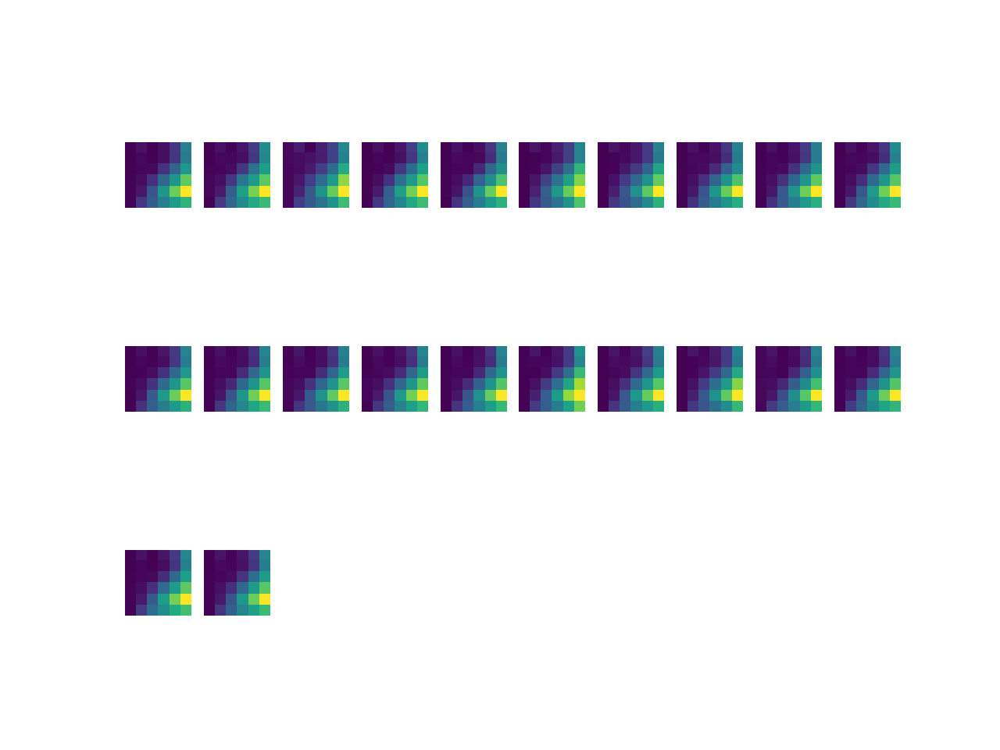

In [60]:
plt.figure()
for iwt in range(nfiles):
    plt.subplot(3,10,iwt+1)
    plt.imshow(YYs[iwt,:,:,1])
    plt.axis('off')

<IPython.core.display.Javascript object>


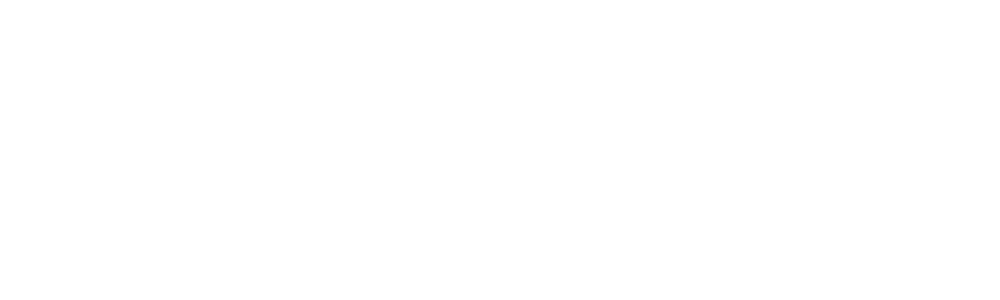

ValueError: num must be 1 <= num <= 30, not 31

In [176]:
plt.figure(figsize=(10,3))
for iwt in range(nfiles):
    plt.subplot(3,10,iwt+1)
    sca.scatter_size_contrast(YYs[iwt,:,:,0],YYs[iwt,:,:,1])
    plt.axis('off')

<IPython.core.display.Javascript object>


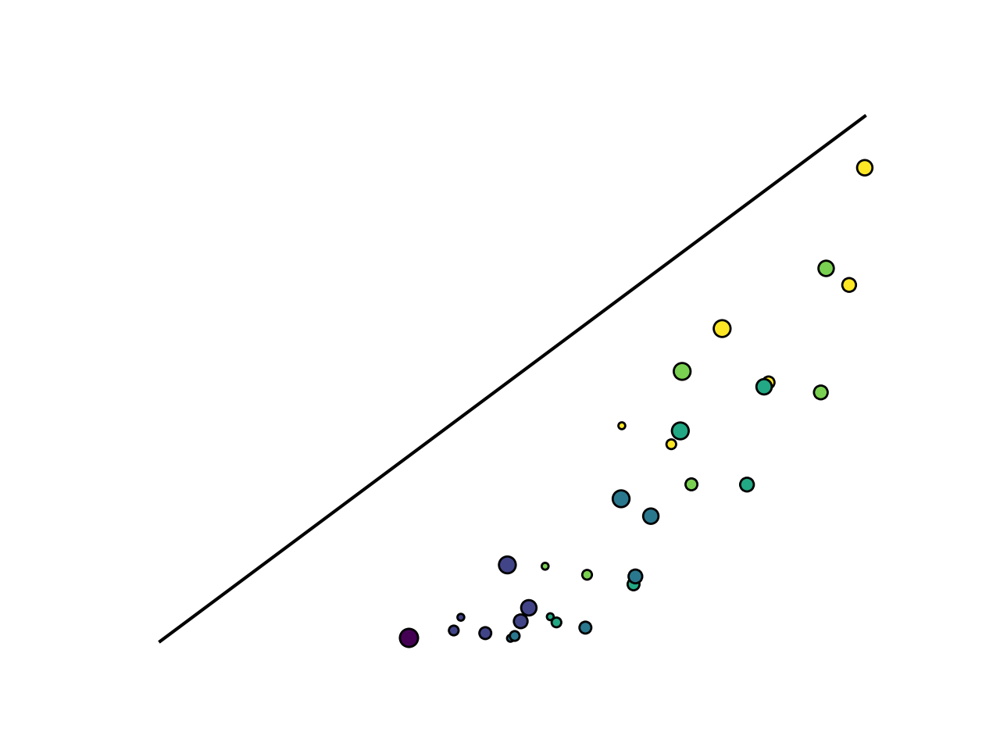

(0.14007571213636724,
 0.7795237759030426,
 0.14007571213636724,
 0.7795237759030426)

In [62]:
iwt = 13
plt.figure()#figsize=(10,3))
sca.scatter_size_contrast(YYs[iwt,:,:,0],YYs[iwt,:,:,1],equate_0=True)
plt.axis('off')

<IPython.core.display.Javascript object>


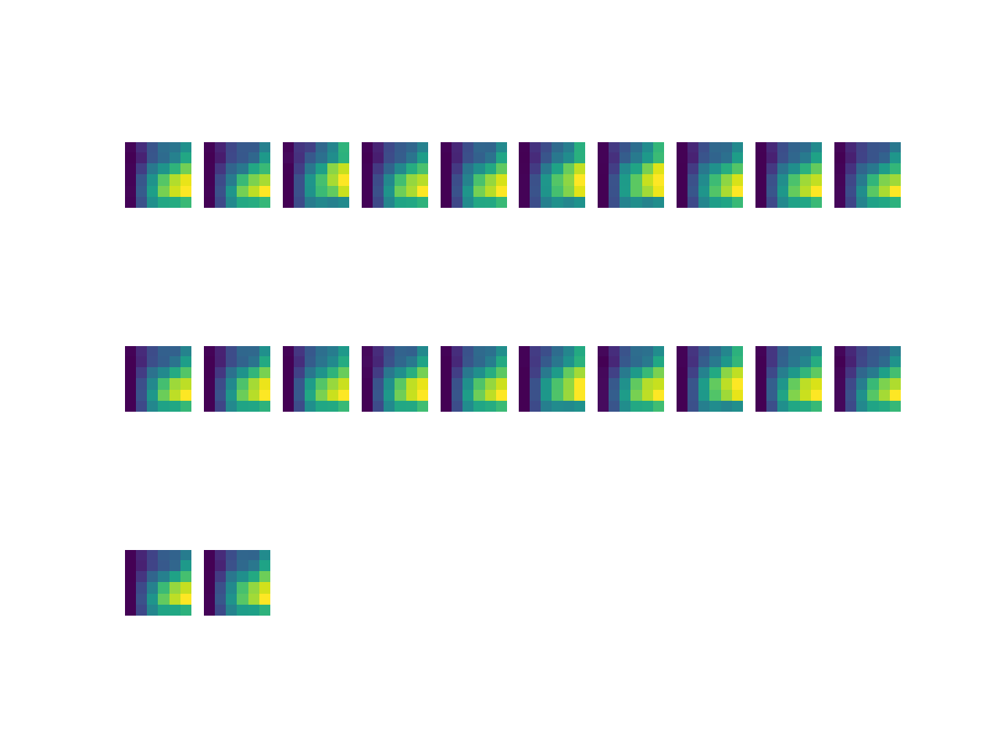

In [63]:
plt.figure()
for iwt in range(nfiles):
    plt.subplot(3,10,iwt+1)
    plt.imshow(YYs[iwt,:,:,0])
    plt.axis('off')

<IPython.core.display.Javascript object>


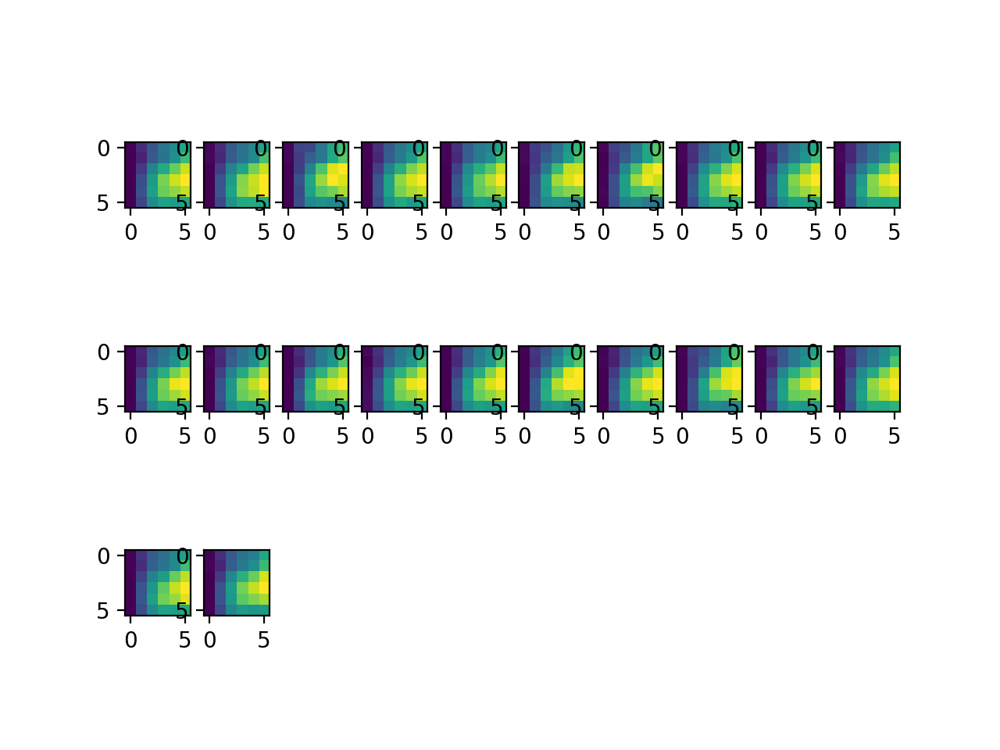

In [64]:
plt.figure()
for iwt in range(nfiles):
    plt.subplot(3,10,iwt+1)
    plt.imshow(YYs[iwt,:,:,3])

In [1567]:
nfiles = len(weights_files)
Ts = np.zeros((nfiles,nQ))
Ks = np.zeros((nfiles,nQ))
Wmys = np.zeros((nfiles,nQ,nQ))
Wmxs = np.zeros((nfiles,nP,nQ))
couplings_appr = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
Xcouplings_appr = np.zeros((nfiles,6,6,nP*nS*nT,nQ*nS*nT))
for iwt,weights_file in enumerate(weights_files):
    Wstar_dict = np.load(weights_file,allow_pickle=True)[()]
    Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h = Wstar_dict['as_list']
    WWmy = calnet.utils.gen_Weight_k_kappa_t(Wmy,K,kappa,T)
    WWmx = calnet.utils.gen_Weight_k_kappa_t(Wmx,K,kappa,T)
    tiled_s02 = np.tile(s02,nS*nT)
    for istim in range(nN):
        iistim,jjstim = np.unravel_index(istim,(6,6))
        Phi = np.diag(calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+tiled_s02))
        Weff = WWmy @ Phi
        powers = [np.linalg.matrix_power(Weff,n) for n in range(3)]
        appr = sum(powers)
        couplings_appr[iwt,iistim,jjstim] = Phi @ appr
        Xcouplings_appr[iwt,iistim,jjstim] = WWmx @ Phi @ appr
# couplings = np.reshape(couplings,(couplings.shape[0],6,6,couplings.shape[2],couplings.shape[3]))
# Xcouplings = np.reshape(Xcouplings,(Xcouplings.shape[0],6,6,Xcouplings.shape[2],Xcouplings.shape[3]))


ValueError: too many values to unpack (expected 13)

<IPython.core.display.Javascript object>


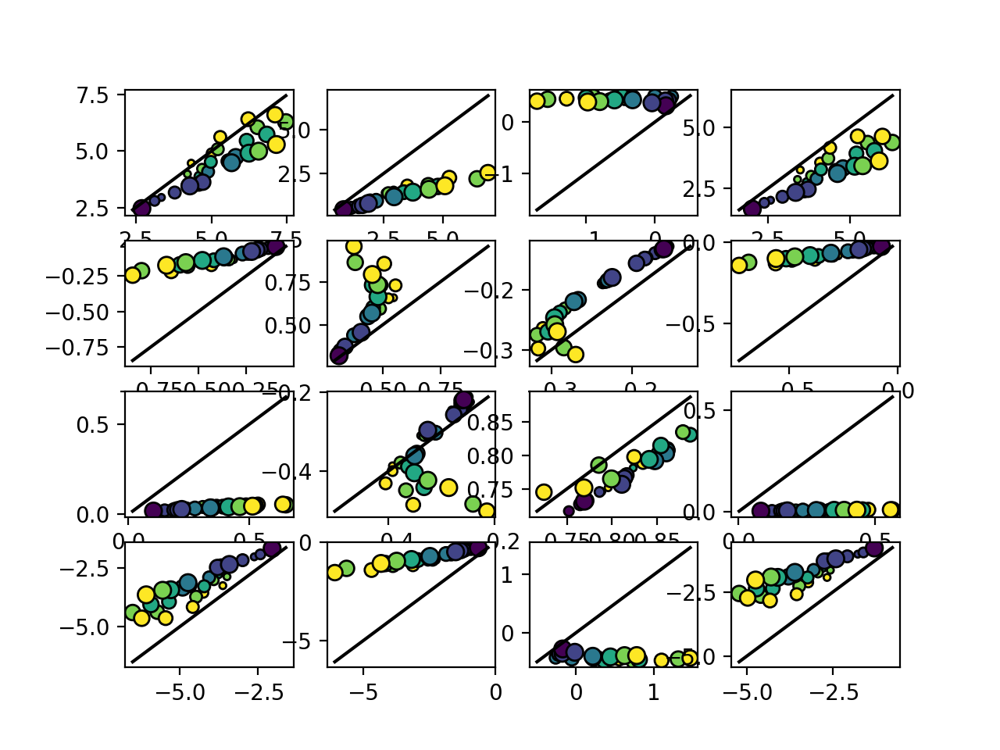

In [66]:
plt.figure()
for i1 in range(nQ):
    for i2 in range(nQ):
        plt.subplot(nQ,nQ,i1*nQ+i2+1)
        sca.scatter_size_contrast(couplings[0,:,:,i1,i2],couplings_appr[0,:,:,i1,i2])

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


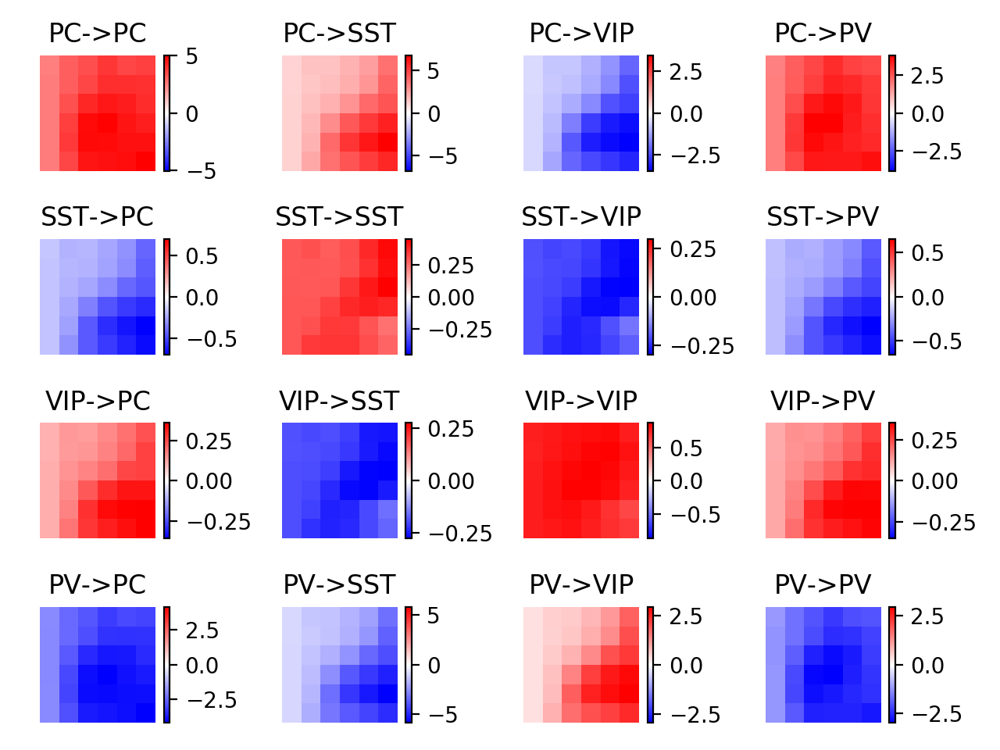

<IPython.core.display.Javascript object>


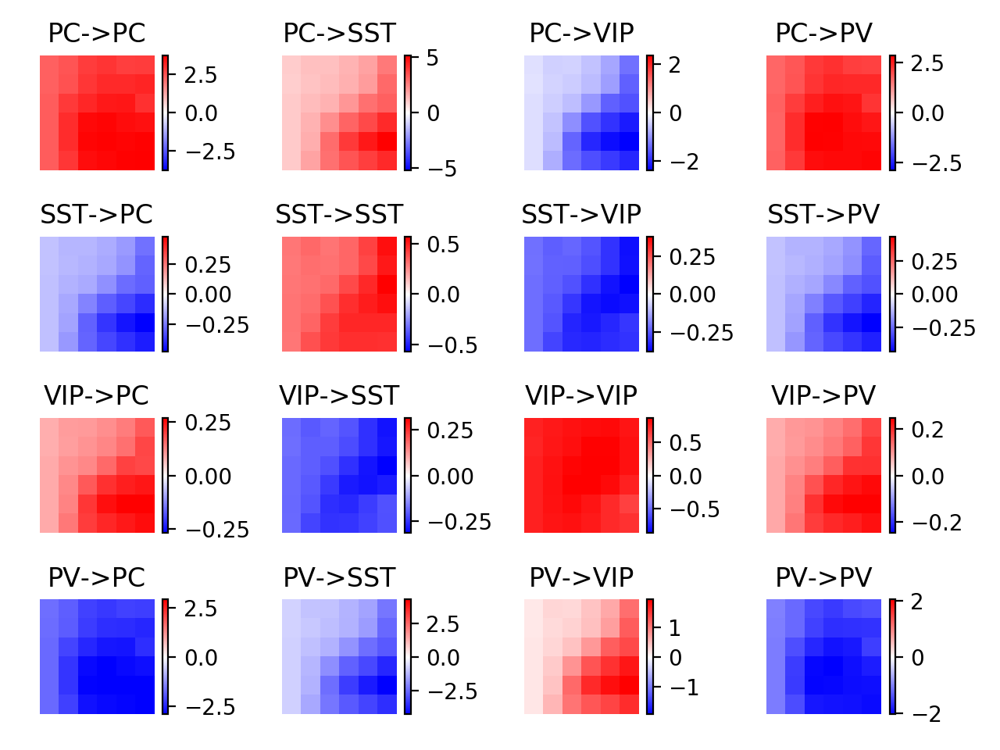

<IPython.core.display.Javascript object>


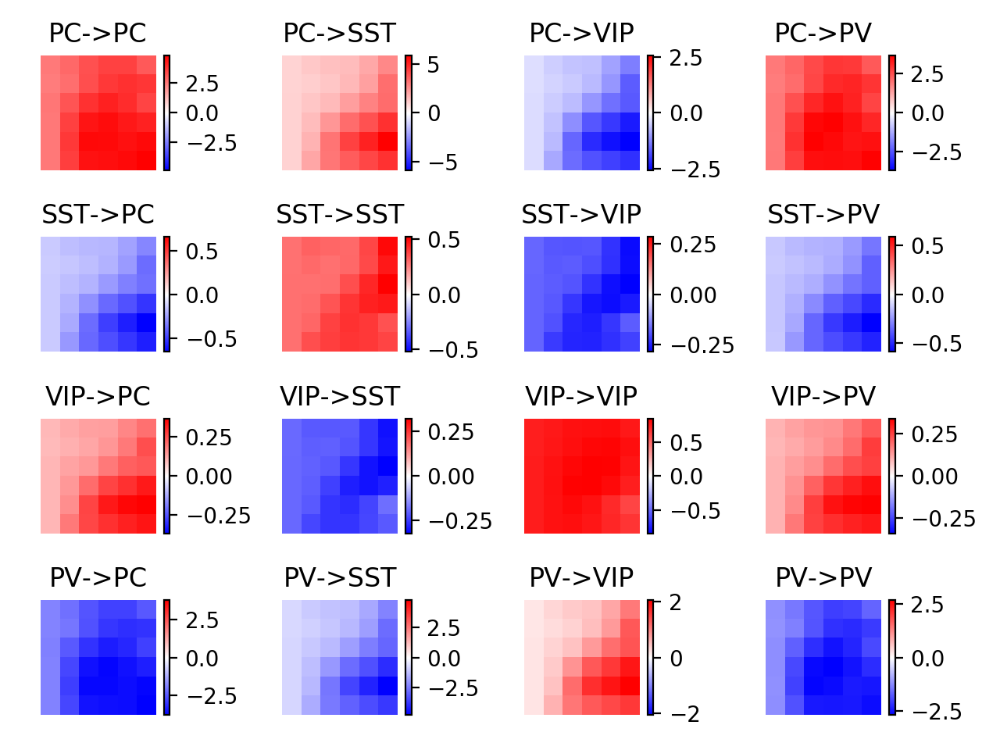

<IPython.core.display.Javascript object>


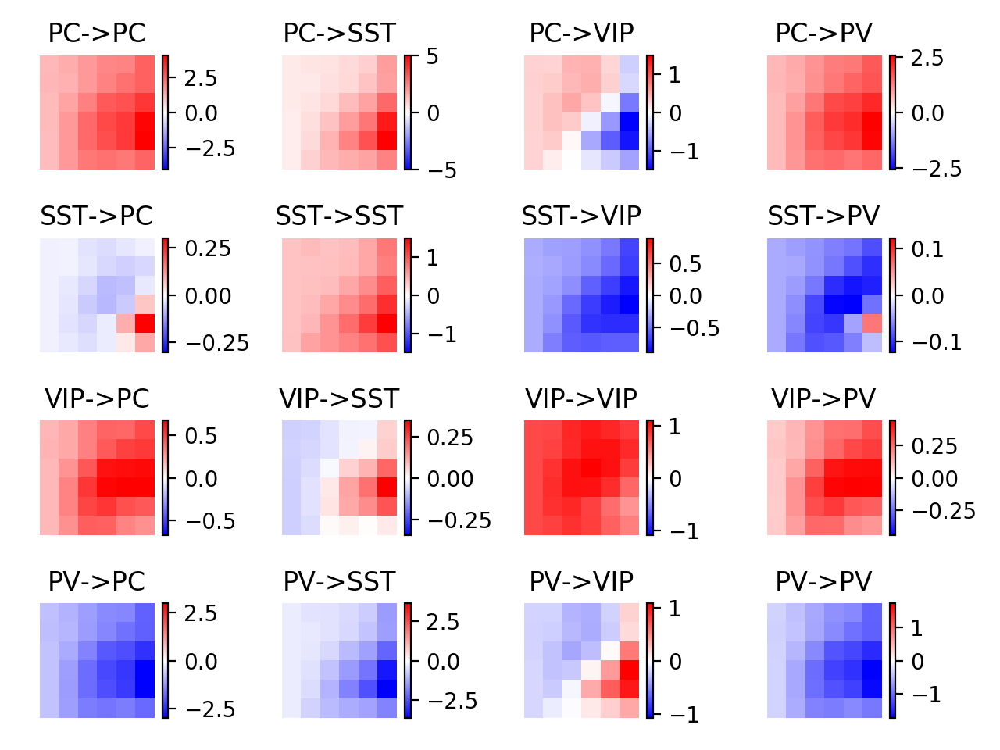

<IPython.core.display.Javascript object>


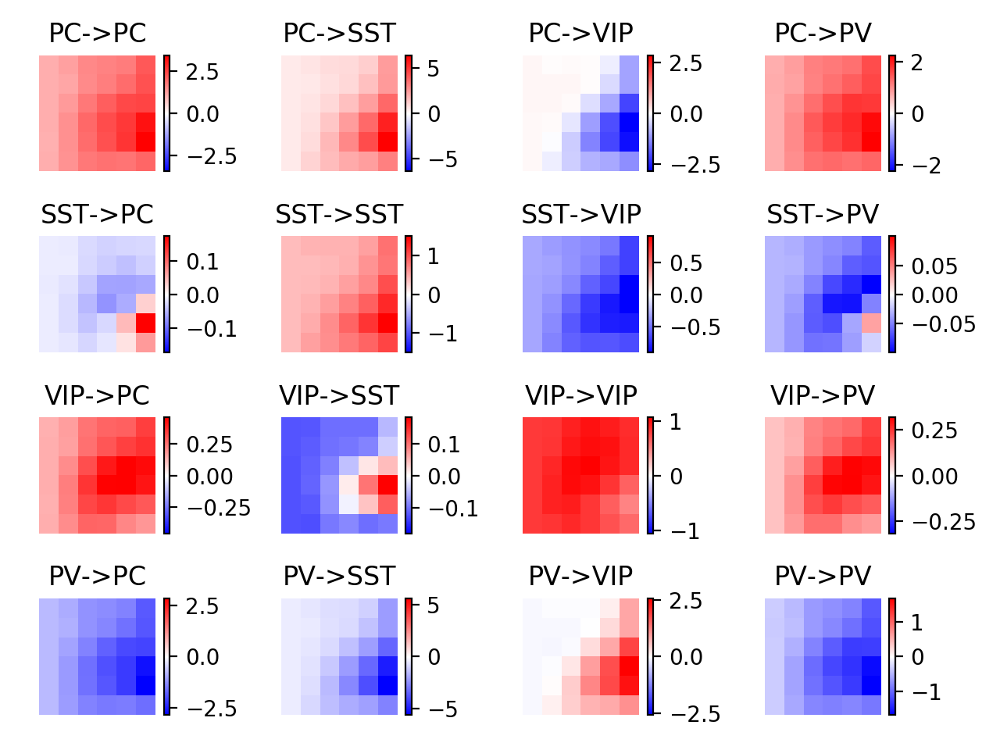

<IPython.core.display.Javascript object>


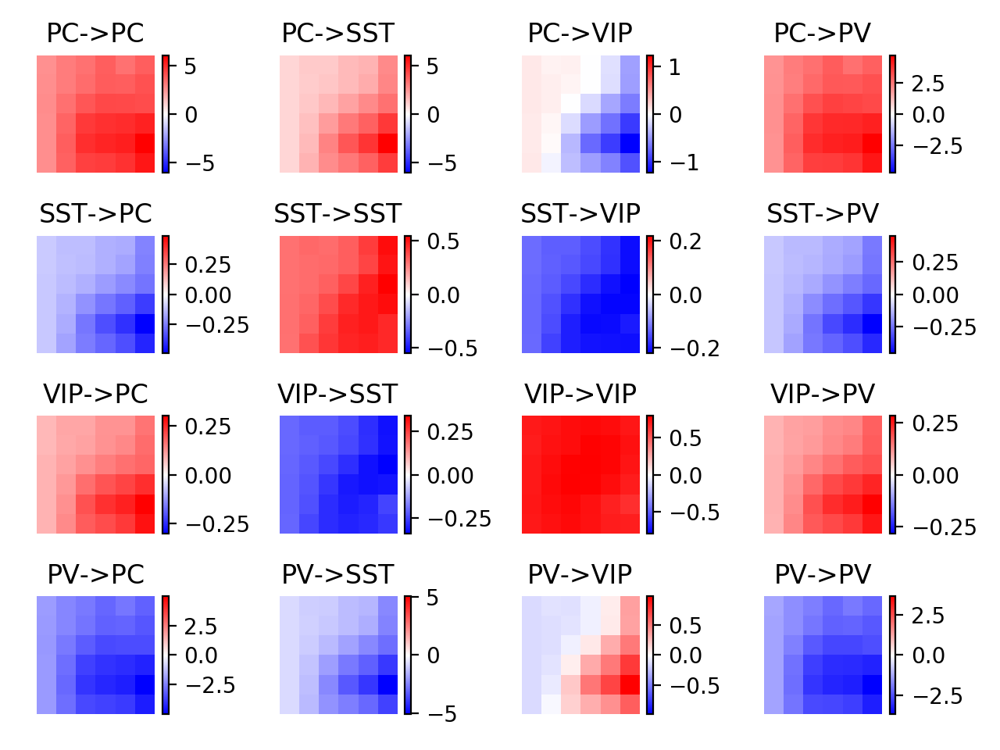

<IPython.core.display.Javascript object>


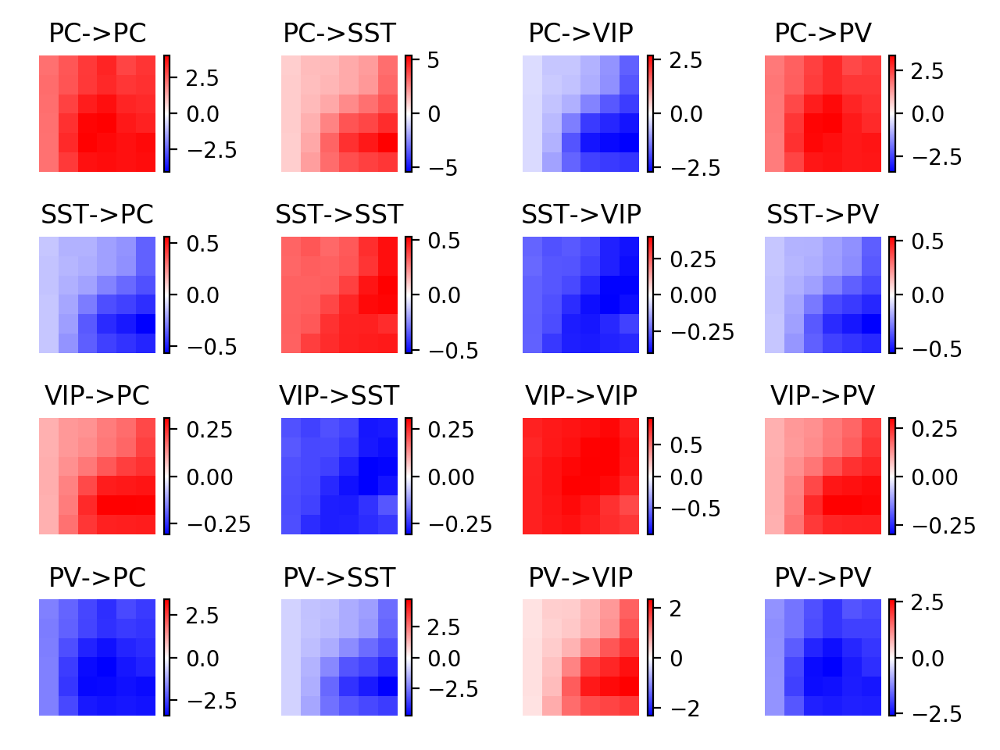

<IPython.core.display.Javascript object>


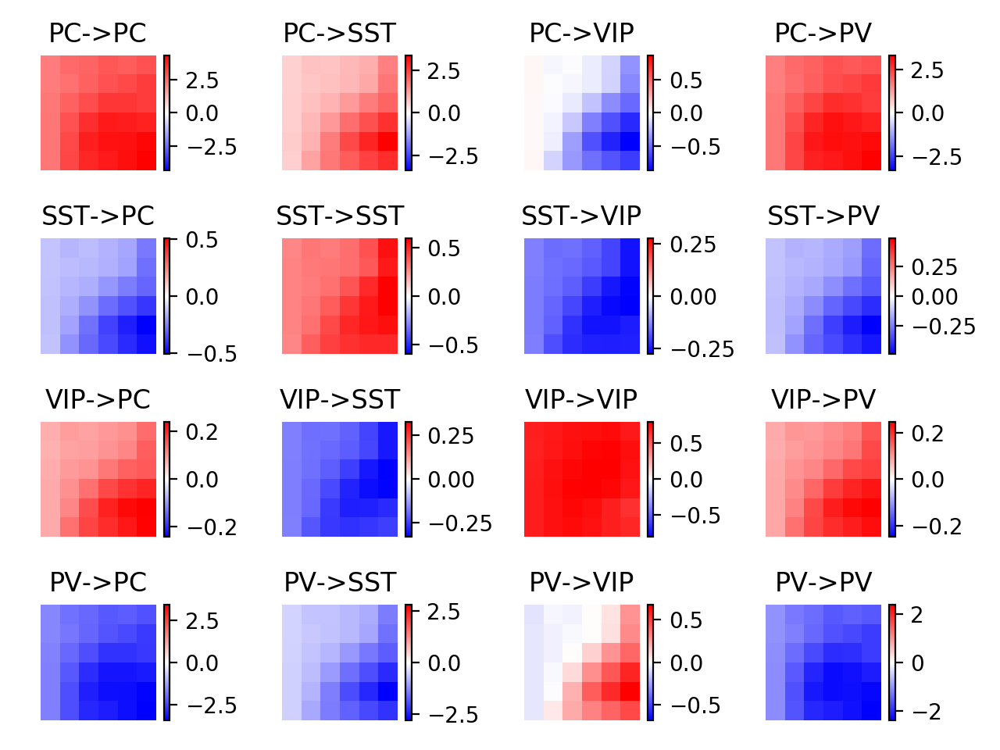

<IPython.core.display.Javascript object>


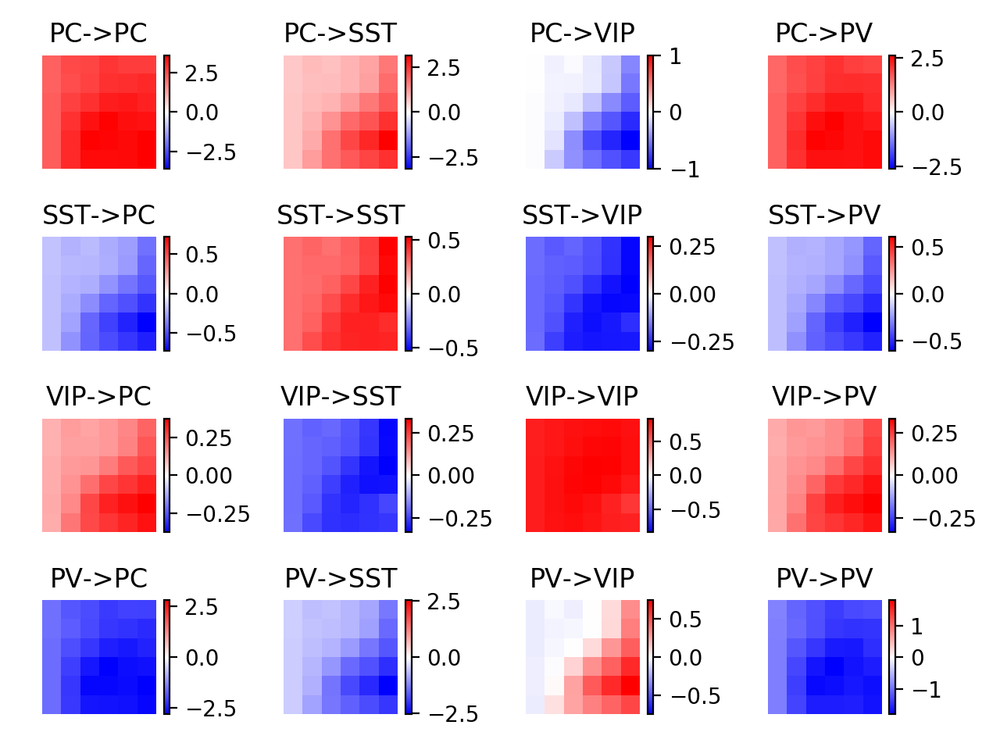

In [46]:
lbls = ['PC','SST','VIP','PV']
for iwt in range(len(weights_files)):
    plt.figure()
    for i1 in range(4):
        for i2 in range(4):
            plt.subplot(4,4,4*i1+i2+1)
            data = couplings[iwt][:,:,i1,i2]
            plt.imshow(data,cmap='bwr',vmin=-np.abs(data).max(),vmax=np.abs(data).max())
            plt.colorbar()
            plt.axis('off')
            plt.title('%s->%s'%(lbls[i1],lbls[i2]))
    plt.tight_layout()

In [47]:
lkat

array([False, False, False, False, False, False, False, False, False])

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


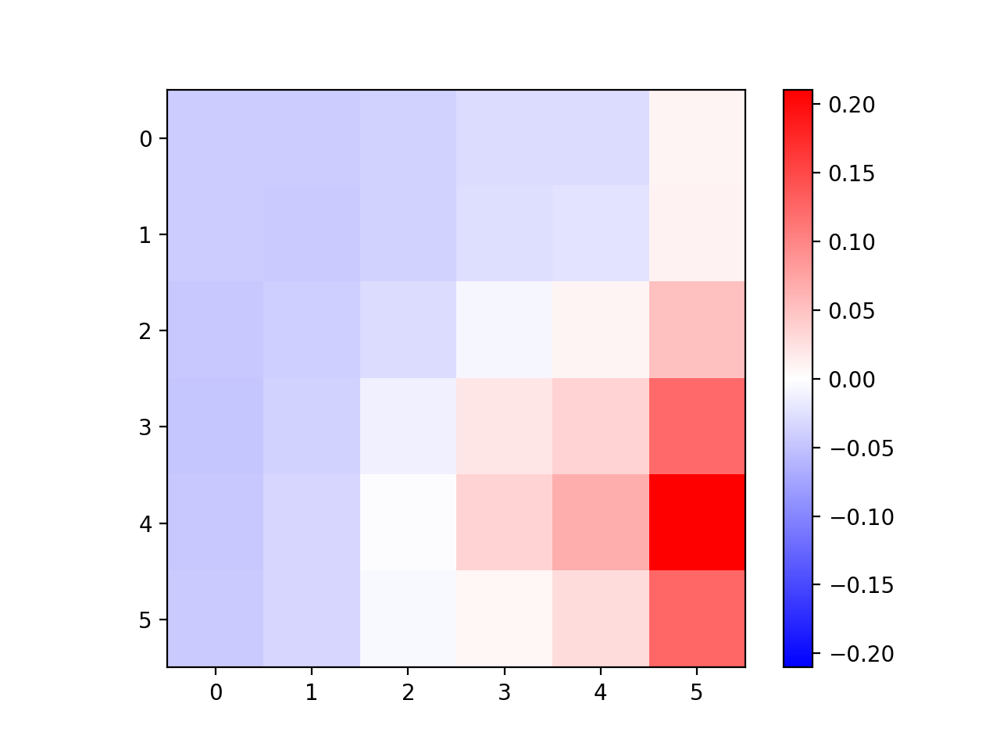

In [640]:
plt.figure()
data = np.nanmean(couplings[:,:,:,2,1],0)
mx = np.max(np.abs(data))
plt.imshow(data,cmap='bwr',vmin=-mx,vmax=mx)
plt.colorbar()

In [1449]:
# lkat = np.all(np.all(couplings[:,:,:,1,0]<0,axis=1),axis=1) #& np.all(np.all(couplings[:,:,:,2,1]<0,axis=1),axis=1)
# lkat = lkat & (np.max(np.abs(couplings.reshape((couplings.shape[0],-1))),axis=1) < 10) & np.all(np.all(couplings[:,:,:,1,0]<0,axis=1),axis=1)
# lkat = losses < 1000

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in less
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


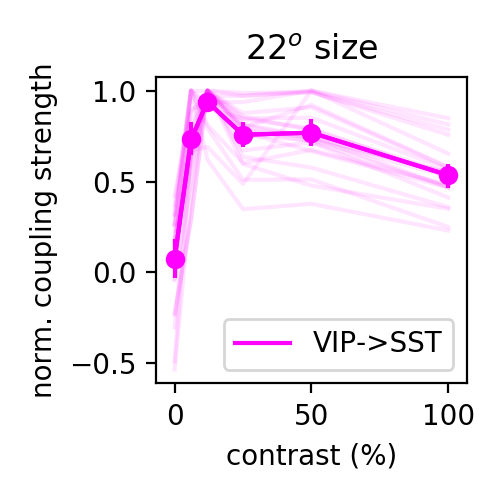

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.8932140705325619


In [1592]:
plt.figure(figsize=(2.5,2.5))
isize = 3
datas = [couplings[lkat,isize,:,2,1]]
colors = [np.array((1,0,1))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(ucontrast,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend(['VIP->SST'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(ucontrast,(data/mx).T,alpha=0.1,c=color) #
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
plt.title('%d$^o$ size'%usize[isize])
plt.tight_layout()
# plt.savefig('figures/vip_sst_coupling_traces.jpg',dpi=300)

<IPython.core.display.Javascript object>


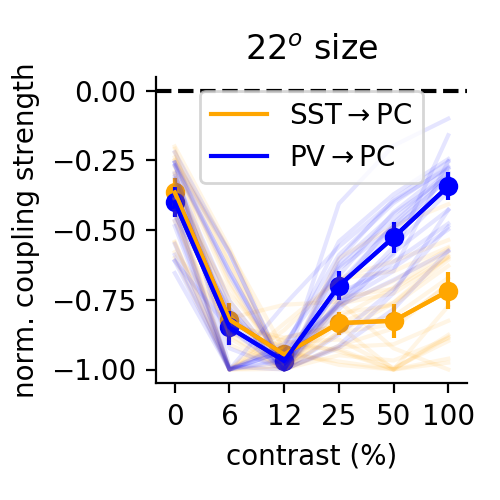

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.4155940982732391
-0.3939546681830697


In [1593]:
plt.figure(figsize=(2.5,2.5))
isize = 3
x = np.arange(6)
datas = [couplings[lkat,isize,:,1,0],couplings[lkat,isize,:,3,0]]
colors = [np.array((1,0.65,0)),np.array((0,0,1))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(x,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend([r'SST$\rightarrow$PC',r'PV$\rightarrow$PC'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(x,(data/mx).T,alpha=0.1,c=color)
plt.xticks(x,ucontrast)
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
plt.title('%d$^o$ size'%usize[isize])
plt.axhline(0,linestyle='dashed',c='k')
ut.erase_top_right()
plt.tight_layout()
# plt.savefig('figures/sst_pc_coupling_traces.jpg',dpi=300)

<IPython.core.display.Javascript object>


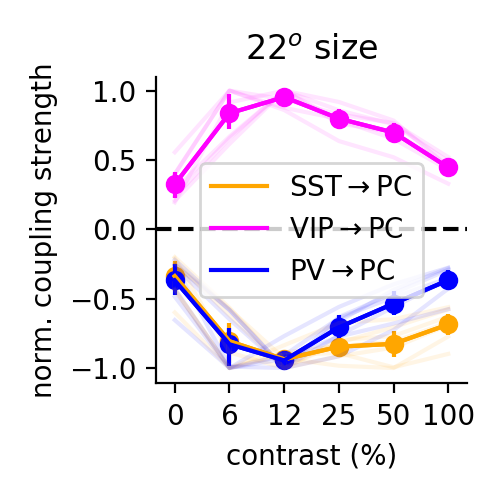

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.45074017952261153
0.907018406339655
-0.43914087960323683


In [1570]:
plt.figure(figsize=(2.5,2.5))
isize = 3
x = np.arange(6)
datas = [couplings[lkat,isize,:,1,0],couplings[lkat,isize,:,2,0],couplings[lkat,isize,:,3,0]]#,phis[:,isize,:,0]]
colors = [np.array((1,0.65,0)),np.array((1,0,1)),np.array((0,0,1))]#,np.array((0,0,0))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(x,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend([r'SST$\rightarrow$PC',r'VIP$\rightarrow$PC',r'PV$\rightarrow$PC'])#,'$\phi_{PC}$'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(x,(data/mx).T,alpha=0.1,c=color)
plt.xticks(x,ucontrast)
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
plt.title('%d$^o$ size'%usize[isize])
plt.axhline(0,linestyle='dashed',c='k')
ut.erase_top_right()
plt.tight_layout()
# plt.savefig('figures/sst_vip_pv_pc_coupling_traces.jpg',dpi=300)

<IPython.core.display.Javascript object>


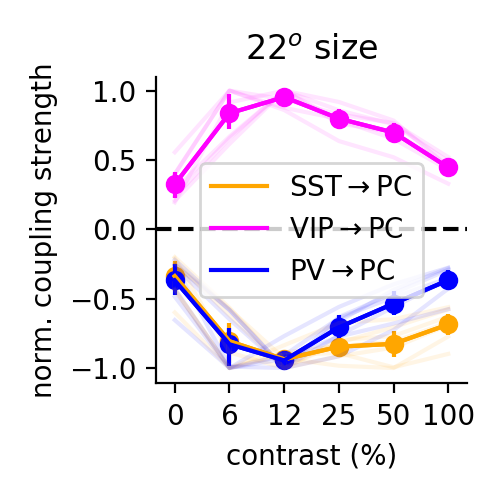

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.45074017952261153
0.907018406339655
-0.43914087960323683


In [1571]:
plt.figure(figsize=(2.5,2.5))
isize = 3
# i,j = 1,0
# polysyn = phis[:,isize,:,i]*Wmys[:,np.newaxis,i,j]*phis[:,isize,:,j]
i,j,k = 2,1,0
x = np.arange(6)
polysyn = phis[:,isize,:,i]*Wmys[:,np.newaxis,i,j]*phis[:,isize,:,j]*Wmys[:,np.newaxis,j,k]*phis[:,isize,:,k]
datas = [couplings[lkat,isize,:,1,0],couplings[lkat,isize,:,2,0],couplings[lkat,isize,:,3,0]]#,phis[:,isize,:,0],polysyn]
colors = [np.array((1,0.65,0)),np.array((1,0,1)),np.array((0,0,1)),np.array((0,0,0)),np.array((0,1,0))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(x,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend([r'SST$\rightarrow$PC',r'VIP$\rightarrow$PC',r'PV$\rightarrow$PC'])#,'$\phi_{PC}$'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(x,(data/mx).T,alpha=0.1,c=color)
plt.xticks(x,ucontrast)
ut.erase_top_right()
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
plt.title('%d$^o$ size'%usize[isize])
plt.axhline(0,linestyle='dashed',c='k')
plt.tight_layout()
# plt.savefig('figures/sst_vip_pv_pc_coupling_traces.jpg',dpi=300)

In [378]:
xdata.shape

(4, 6, 6)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


<IPython.core.display.Javascript object>


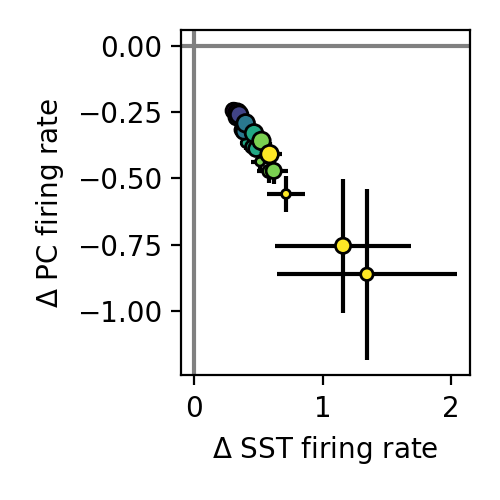

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


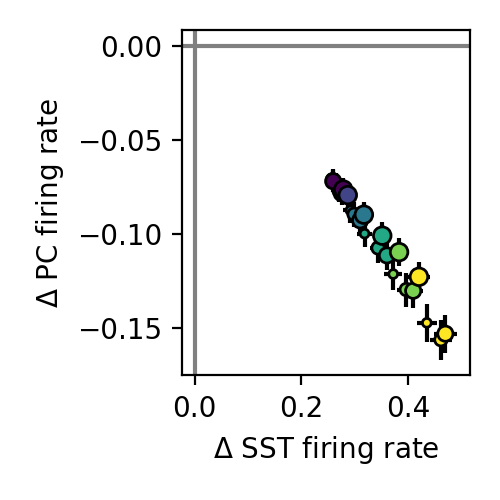

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:28: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


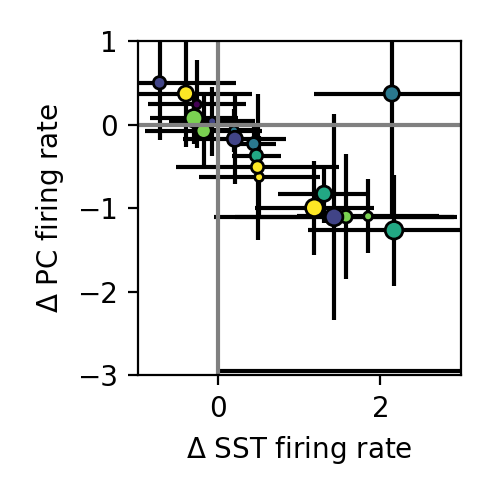

In [755]:
h = -1
sizes = [0,2,3,5]

plt.figure(figsize=(2.5,2.5))
# sca.scatter_size_contrast(h*np.nanmean(couplings[:,:,:,2,1],0),h*np.nanmean(couplings[:,:,:,2,0],0))
xdata = h*couplings[lkat,:,:,2,1]
ydata = h*couplings[lkat,:,:,2,0]
sca.scatter_size_contrast_errorbar(xdata[:,sizes],ydata[:,sizes],equality_line=False,square=False)
plt.axhline(0,c=(0.5,0.5,0.5))
plt.axvline(0,c=(0.5,0.5,0.5))
plt.xlabel(r'$\Delta$ SST firing rate')
plt.ylabel(r'$\Delta$ PC firing rate')
plt.tight_layout()
# plt.savefig('figures/sim_drsst_drpc_recurrent.eps')

polysyn_vip_sst = h*phis[lkat,:,:,2]*phis[lkat,:,:,1]*Wmys[lkat,np.newaxis,np.newaxis,2,1]
polysyn_vip_pc = h*phis[lkat,:,:,2]*phis[lkat,:,:,1]*phis[lkat,:,:,0]*Wmys[lkat,np.newaxis,np.newaxis,2,1]*Wmys[lkat,np.newaxis,np.newaxis,1,0]
plt.figure(figsize=(2.5,2.5))
# sca.scatter_size_contrast(np.nanmean(polysyn_vip_sst,0),np.nanmean(polysyn_vip_pc,0))
sca.scatter_size_contrast_errorbar(polysyn_vip_sst[:,sizes],polysyn_vip_pc[:,sizes],equality_line=False,square=False)
plt.axhline(0,c=(0.5,0.5,0.5))
plt.axvline(0,c=(0.5,0.5,0.5))
plt.xlabel(r'$\Delta$ SST firing rate')
plt.ylabel(r'$\Delta$ PC firing rate')
plt.tight_layout()
# plt.savefig('figures/sim_drsst_drpc_feedforward.eps')

plt.figure(figsize=(2.5,2.5))
# sca.scatter_size_contrast(h*np.nanmean(couplings[:,:,:,2,1],0),h*np.nanmean(couplings[:,:,:,2,0],0))
xdata = h*couplings_no_wpcsst[lkat,:,:,2,1]
ydata = h*couplings_no_wpcsst[lkat,:,:,2,0]
sca.scatter_size_contrast_errorbar(xdata[:,sizes],ydata[:,sizes],equality_line=False,square=False)
plt.axhline(0,c=(0.5,0.5,0.5))
plt.axvline(0,c=(0.5,0.5,0.5))
plt.xlabel(r'$\Delta$ SST firing rate')
plt.ylabel(r'$\Delta$ PC firing rate')
plt.ylim(-3,1)
plt.xlim(-1,3)
plt.tight_layout()
# plt.savefig('figures/sim_drsst_drpc_recurrent.eps')


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


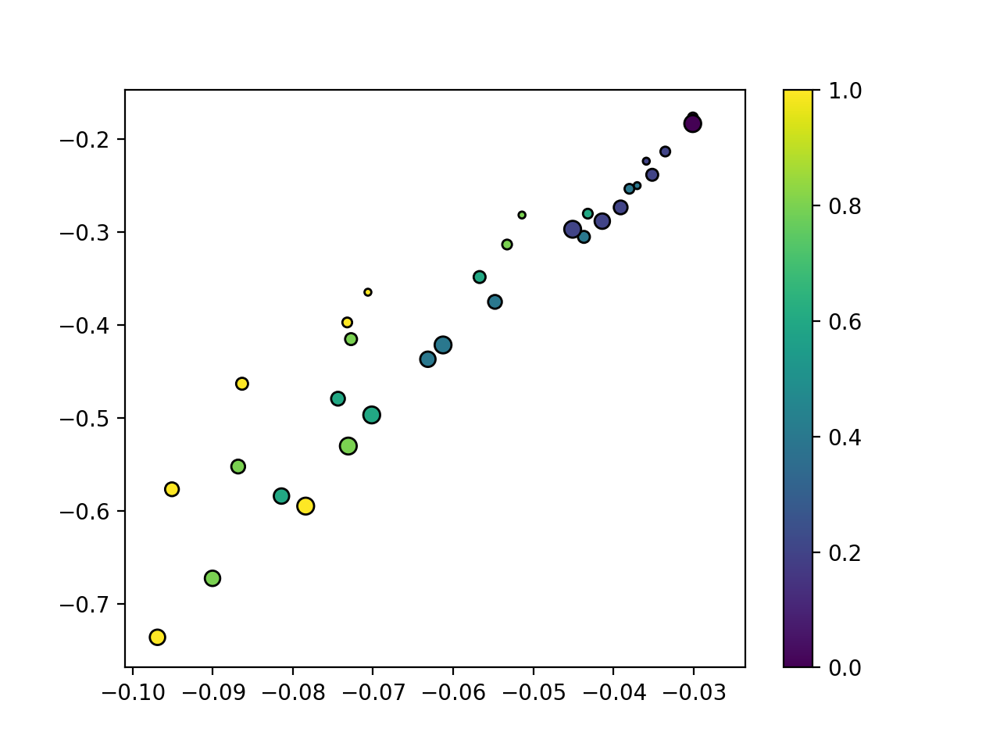

In [294]:
plt.figure()
sca.scatter_size_contrast(np.nanmean(polysyn_vip_pc,0),np.nanmean(h*couplings[:,:,:,2,0],0),square=False,equality_line=False)
plt.colorbar()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


<IPython.core.display.Javascript object>


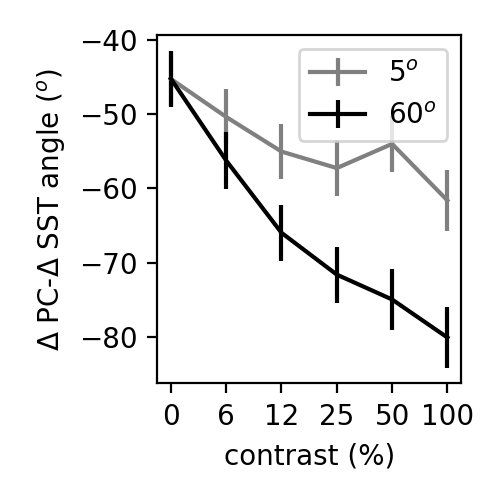

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:30: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


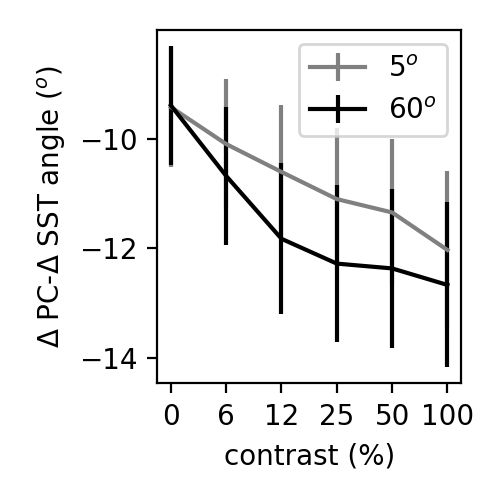

In [295]:
h = -1
# sca.scatter_size_contrast(h*np.nanmean(couplings[:,:,:,2,1],0),h*np.nanmean(couplings[:,:,:,2,0],0))
data = np.arctan2(h*couplings[:,:,:,2,0],h*couplings[:,:,:,2,1])#,equality_line=False,square=False)

plt.figure(figsize=(2.5,2.5))
thisx = np.arange(6)
# colors_blk = [0.5**(i+1)*np.array((1,1,1)) for i in range(4)]
colors_blk = [np.array((0.5,0.5,0.5)),np.array((0.,0.,0.))]
for iisize,isize in enumerate([0,5]):
    this_data = data[:,isize]
    plt.errorbar(thisx,-360+180/np.pi*sst.circmean(this_data,axis=0),180/np.pi*sst.circstd(this_data,axis=0)/np.sqrt(data.shape[0]),c=colors_blk[iisize])
    plt.xlabel('contrast (%)')
plt.xticks(thisx,ucontrast)
# plt.ylim(-80,0)
#     plt.ylim(-90,45)
# plt.subplot(1,4,1)
plt.legend(['5$^o$','60$^o$'])
plt.ylabel('$\Delta$ PC-$\Delta$ SST angle ($^o$)')
plt.tight_layout()
# plt.savefig('figures/sim_drpc_drsst_angle_recurrent.eps')


h = -1

polysyn_vip_sst = h*phis[:,:,:,2]*phis[:,:,:,1]*Wmys[:,np.newaxis,np.newaxis,2,1]
polysyn_vip_pc = h*phis[:,:,:,2]*phis[:,:,:,1]*phis[:,:,:,0]*Wmys[:,np.newaxis,np.newaxis,2,1]*Wmys[:,np.newaxis,np.newaxis,1,0]
# sca.scatter_size_contrast(np.nanmean(polysyn_vip_sst,0),np.nanmean(polysyn_vip_pc,0))
data = np.arctan2(polysyn_vip_pc,polysyn_vip_sst)

plt.figure(figsize=(2.5,2.5))
thisx = np.arange(6)
# colors_blk = [0.5**(i+1)*np.array((1,1,1)) for i in range(4)]
colors_blk = [np.array((0.5,0.5,0.5)),np.array((0.,0.,0.))]
for iisize,isize in enumerate([0,5]):
    this_data = data[:,isize]
    plt.errorbar(thisx,-360+180/np.pi*sst.circmean(this_data,axis=0),180/np.pi*sst.circstd(this_data,axis=0)/np.sqrt(data.shape[0]),c=colors_blk[iisize])
    plt.xlabel('contrast (%)')
plt.xticks(thisx,ucontrast)
# plt.ylim(-80,0)
# plt.subplot(1,4,1)
plt.legend(['5$^o$','60$^o$'])
plt.ylabel('$\Delta$ PC-$\Delta$ SST angle ($^o$)')
plt.tight_layout()
# plt.savefig('figures/sim_drpc_drsst_angle_feedforward.eps')


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


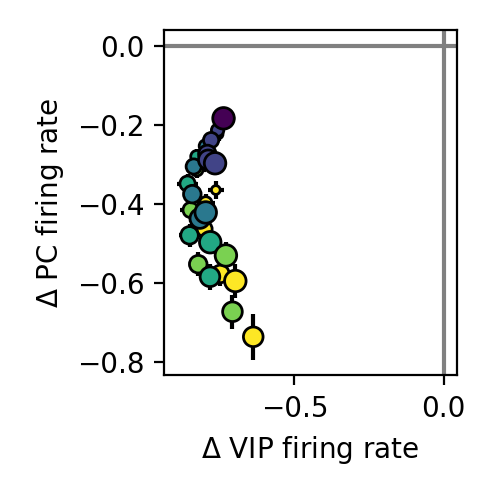

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  from ipykernel import kernelapp as app


<IPython.core.display.Javascript object>


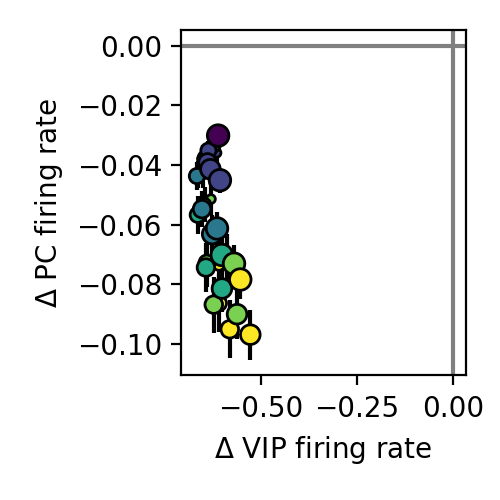

In [296]:
iwt = 0
h = -1
plt.figure(figsize=(2.5,2.5))
# sca.scatter_size_contrast(h*np.nanmean(couplings[:,:,:,2,1],0),h*np.nanmean(couplings[:,:,:,2,0],0))
sca.scatter_size_contrast_errorbar(h*couplings[:,:,:,2,2],h*couplings[:,:,:,2,0],equality_line=False,square=False)
plt.axhline(0,c=(0.5,0.5,0.5))
plt.axvline(0,c=(0.5,0.5,0.5))
plt.xlabel(r'$\Delta$ VIP firing rate')
plt.ylabel(r'$\Delta$ PC firing rate')
plt.tight_layout()
# plt.savefig('figures/sim_drsst_drpc_recurrent.eps')

polysyn_vip = h*phis[:,:,:,2]
polysyn_vip_pc = h*phis[:,:,:,2]*phis[:,:,:,1]*phis[:,:,:,0]*Wmys[:,np.newaxis,np.newaxis,2,1]*Wmys[:,np.newaxis,np.newaxis,1,0]
plt.figure(figsize=(2.5,2.5))
# sca.scatter_size_contrast(np.nanmean(polysyn_vip_sst,0),np.nanmean(polysyn_vip_pc,0))
sca.scatter_size_contrast_errorbar(polysyn_vip,polysyn_vip_pc,equality_line=False,square=False)
plt.axhline(0,c=(0.5,0.5,0.5))
plt.axvline(0,c=(0.5,0.5,0.5))
plt.xlabel(r'$\Delta$ VIP firing rate')
plt.ylabel(r'$\Delta$ PC firing rate')
plt.tight_layout()
# plt.savefig('figures/sim_drsst_drpc_feedforward.eps')


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


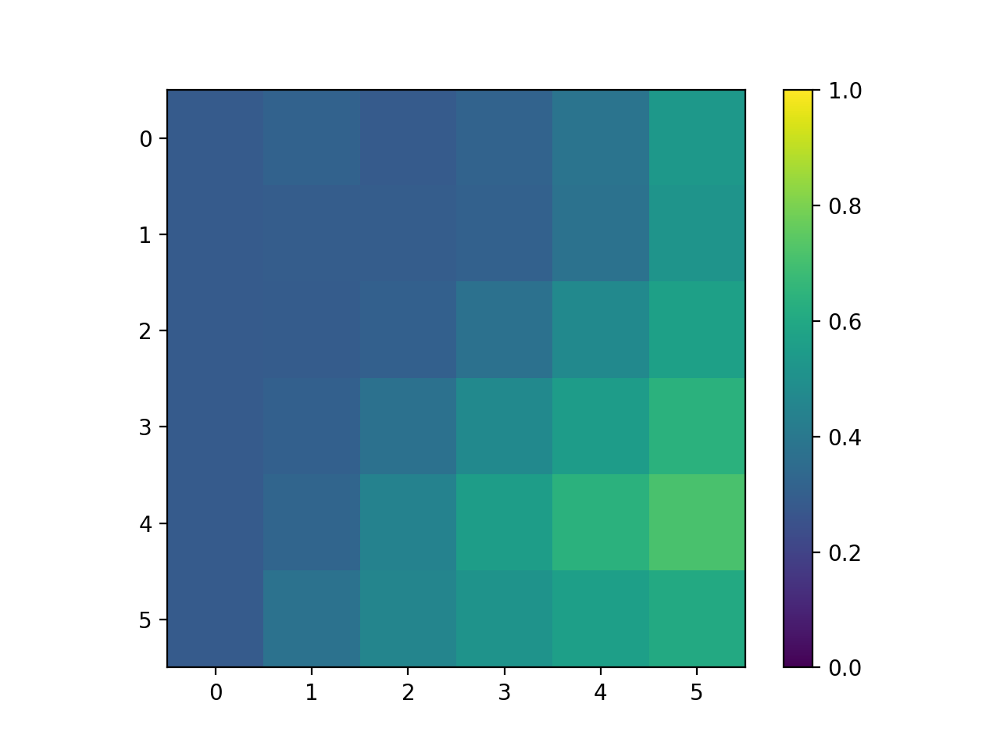

In [297]:
plt.figure()
plt.imshow(np.nanmean(phis[:,:,:,1],0),vmin=0,vmax=1)
plt.colorbar()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


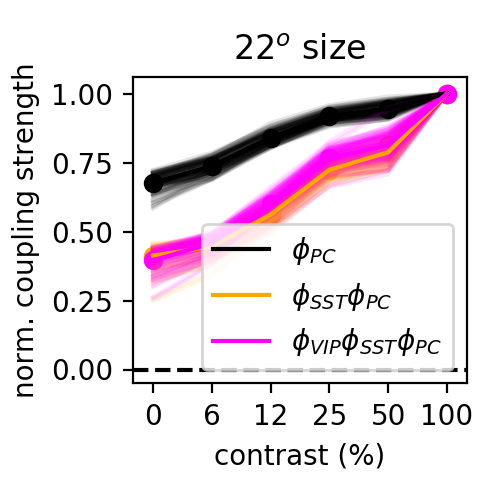

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.0
1.0
1.0


In [721]:
plt.figure(figsize=(2.5,2.5))
x = np.arange(6)
isize = 3
i,j = 1,0
polysyn_sst = phis[:,isize,:,i]*phis[:,isize,:,j]
i,j,k = 2,1,0
polysyn_vip = phis[:,isize,:,i]*phis[:,isize,:,j]*phis[:,isize,:,k]
datas = [phis[:,isize,:,0],polysyn_sst,polysyn_vip] #couplings[:,isize,:,1,0]/ #couplings[:,isize,:,2,0]/
colors = [np.array((0,0,0)),np.array((1,0.65,0)),np.array((1,0,1))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(x,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend(['$\phi_{PC}$','$\phi_{SST}\phi_{PC}$','$\phi_{VIP}\phi_{SST}\phi_{PC}$'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(x,(data/mx).T,alpha=0.1,c=color)
plt.xticks(x,ucontrast)
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
plt.title('%d$^o$ size'%usize[isize])
plt.axhline(0,linestyle='dashed',c='k')
plt.tight_layout()
# plt.savefig('figures/sst_vip_pv_pc_coupling_traces.jpg',dpi=300)

In [739]:
lkat = np.all(np.all(couplings[:,:,:,1,0]<0,axis=1),axis=1) #& np.all(np.all(couplings[:,:,:,2,1]<0,axis=1),axis=1)


In [765]:
np.save('data/lkat.npy',lkat)

<IPython.core.display.Javascript object>


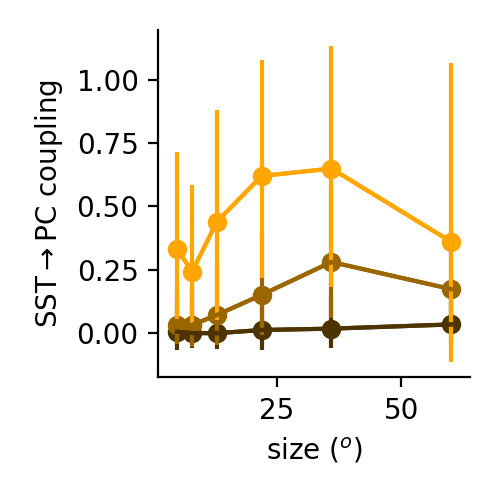

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.16404117143898744


<IPython.core.display.Javascript object>


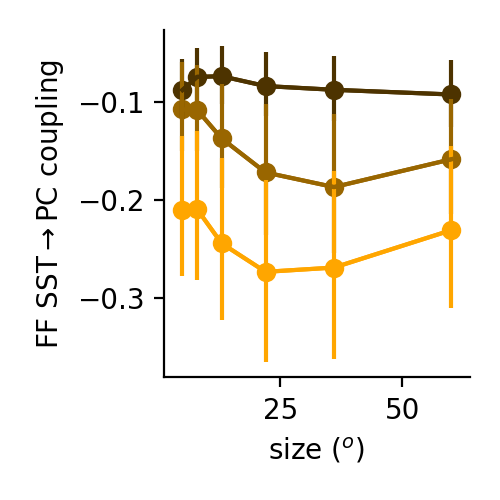

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.10371571375404377


<IPython.core.display.Javascript object>


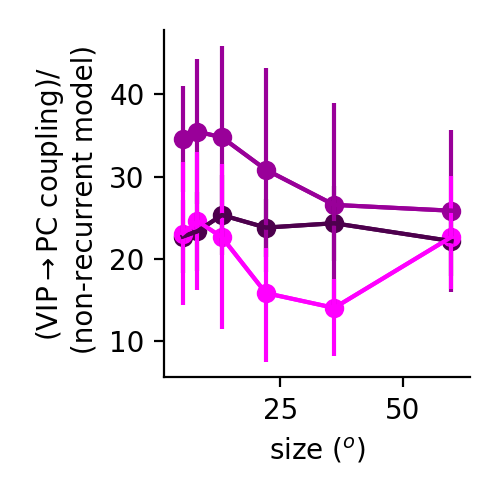

28.166368125145052


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


In [1509]:
rg = lkat#slice(None)#
i,j = 1,0
polysyn_sst = phis[rg,:,:,i]*Wmys[rg,i,j,np.newaxis,np.newaxis]*phis[rg,:,:,j]
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv = np.abs(couplings_pcpv[rg,:,:,i,j])

plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'SST$\rightarrow$PC coupling')
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
# plt.savefig('figures/sst_pc_coupling.eps')

plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,polysyn_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'FF SST$\rightarrow$PC coupling')
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
# plt.savefig('figures/sst_phi_W_phi.eps')
i,j,k = 2,1,0
polysyn_vip = phis[rg,:,:,i]*Wmys[rg,i,j,np.newaxis,np.newaxis]*phis[rg,:,:,j]*Wmys[rg,j,k,np.newaxis,np.newaxis]*phis[rg,:,:,k]
coupling_vip = np.abs(couplings[rg,:,:,i,k])
coupling_vip_pcpv = np.abs(couplings_pcpv[rg,:,:,i,k])

plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,(coupling_vip/polysyn_vip)[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'(VIP$\rightarrow$PC coupling)/'+' \n (non-recurrent model)')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
ylim_vip = (5.5,10.5)
# plt.ylim(ylim_vip)
plt.tight_layout()
# plt.savefig('figures/vip_pc_coupling_over_phi_W_phi.eps')

<IPython.core.display.Javascript object>


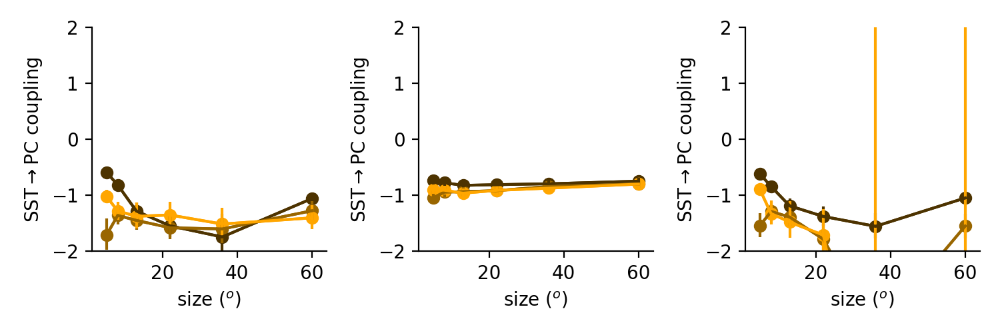

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

-0.6355155574805489
-0.8000454994619041
-0.6614711927601414


In [1594]:
rg = slice(None)
i,j = 1,0
ylim = (-2,2)
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings_fixed[:,isize,:,8,0,1].max()
rg = lkat #slice(None)
# rg = slice(None)
polysyn_sst = phis[rg,:,:,i]*Wmys[rg,i,j,np.newaxis,np.newaxis]*phis[rg,:,:,j]
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv_fixed = couplings_pcpv_fixed[rg,:,:,i,j]
coupling_sst_sst_fixed = couplings_fixed[rg,:,:,i,j,1]

plt.figure(figsize=(7.5,2.5))
usize = [5,8,13,22,36,60]
plt.subplot(1,3,1)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'SST$\rightarrow$PC coupling')
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)

plt.subplot(1,3,2)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_pcpv_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'SST$\rightarrow$PC coupling')
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
# plt.tight_layout()

plt.subplot(1,3,3)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_sst_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'SST$\rightarrow$PC coupling')
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
plt.tight_layout()
# plt.savefig('figures/sst_pc_coupling_pcpv_sst_phi_constant.eps')

<IPython.core.display.Javascript object>


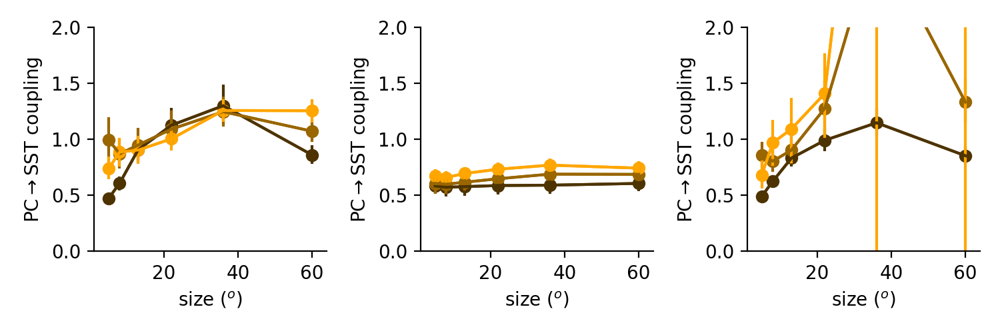

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

1.1555293256745458
0.7094537881081602
2.5579807463717885


In [1595]:
rg = slice(None)
i,j = 0,1
ylim = (0,2)
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings_fixed[:,isize,:,8,0,1].max()
rg = lkat#slice(None)
polysyn_sst = phis[rg,:,:,i]*Wmys[rg,i,j,np.newaxis,np.newaxis]*phis[rg,:,:,j]
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv_fixed = couplings_pcpv_fixed[rg,:,:,i,j]
coupling_sst_sst_fixed = couplings_fixed[rg,:,:,i,j,1]

plt.figure(figsize=(7.5,2.5))
usize = [5,8,13,22,36,60]
plt.subplot(1,3,1)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'PC$\rightarrow$SST coupling')
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)

plt.subplot(1,3,2)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_pcpv_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'PC$\rightarrow$SST coupling')
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
plt.ylim(ylim)

plt.subplot(1,3,3)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_sst_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'PC$\rightarrow$SST coupling')
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
plt.tight_layout()
# plt.savefig('figures/pc_sst_coupling_pcpv_sst_phi_constant.eps')


<IPython.core.display.Javascript object>


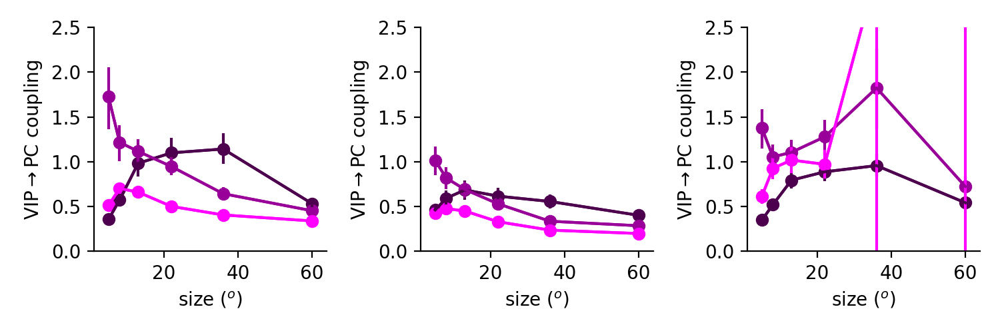

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

1.3966043370099084
0.8572196890852459
1.3822635034393953


In [1604]:
rg = slice(None)
i,j = 2,0
ylim = (0,2.5)
xlabel = 'size ($^o$)'
ylabel = r'VIP$\rightarrow$PC coupling'
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings_fixed[:,isize,:,8,0,1].max()
rg = lkat#slice(None)
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv_fixed = couplings_pcpv_fixed[rg,:,:,i,j]
coupling_sst_sst_fixed = couplings_fixed[rg,:,:,i,j,1]

plt.figure(figsize=(7.5,2.5))
usize = [5,8,13,22,36,60]
plt.subplot(1,3,1)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)

plt.subplot(1,3,2)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_pcpv_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
# plt.tight_layout()

plt.subplot(1,3,3)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_sst_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
plt.tight_layout()
# plt.savefig('figures/vip_pc_coupling_pcpv_sst_phi_constant.eps')

<IPython.core.display.Javascript object>


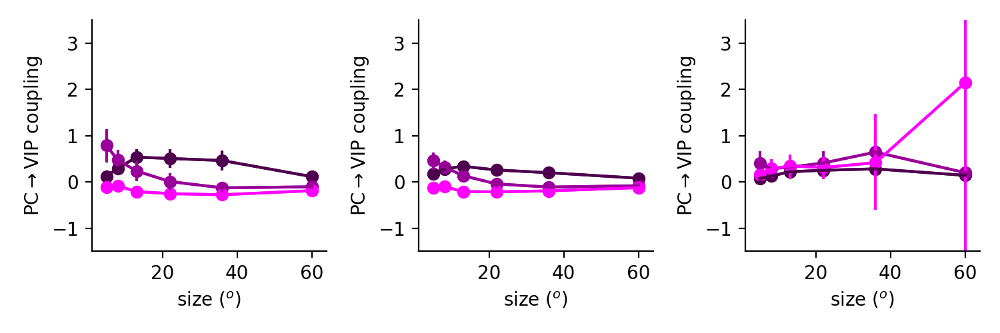

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

0.43853455217045434
0.28242277229980295
0.22961829470530273


In [1605]:
rg = slice(None)
# lkat = np.all(np.all(couplings[:,:,:,1,0]<0,axis=1),axis=1) #& np.all(np.all(couplings[:,:,:,2,1]<0,axis=1),axis=1)
i,j = 0,2
ylim = (-1.5,3.5)
xlabel = 'size ($^o$)'
ylabel = r'PC$\rightarrow$VIP coupling'
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings_fixed[:,isize,:,8,0,1].max()
rg = lkat
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv_fixed = couplings_pcpv_fixed[rg,:,:,i,j]
coupling_sst_sst_fixed = couplings_fixed[rg,:,:,i,j,1]

plt.figure(figsize=(7.5,2.5))
usize = [5,8,13,22,36,60]
plt.subplot(1,3,1)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)

plt.subplot(1,3,2)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_pcpv_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
# plt.tight_layout()

plt.subplot(1,3,3)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_sst_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
plt.tight_layout()
# plt.savefig('figures/pc_vip_coupling_pcpv_sst_phi_constant.eps')

<IPython.core.display.Javascript object>


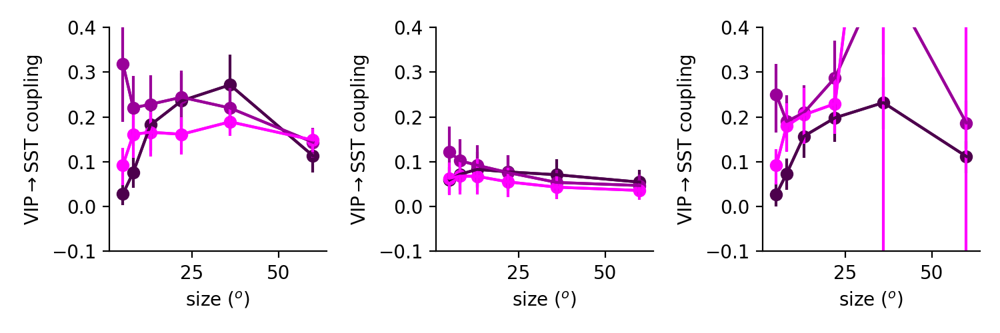

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

0.2145707925379238
0.06403561665871395
0.35730344483297366


In [1607]:
rg = slice(None)
i,j = 2,1
ylim = (-0.1,0.4)
xlabel = 'size ($^o$)'
ylabel = r'VIP$\rightarrow$SST coupling'
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings_fixed[:,isize,:,8,0,1].max()
rg = lkat#slice(None)
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv_fixed = couplings_pcpv_fixed[rg,:,:,i,j]
coupling_sst_sst_fixed = couplings_fixed[rg,:,:,i,j,1]

plt.figure(figsize=(7.5,2.5))
usize = [5,8,13,22,36,60]
plt.subplot(1,3,1)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)

plt.subplot(1,3,2)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_pcpv_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
# plt.tight_layout()

plt.subplot(1,3,3)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_sst_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
plt.tight_layout()
# plt.savefig('figures/vip_sst_coupling_pcpv_sst_phi_constant.eps')

<IPython.core.display.Javascript object>


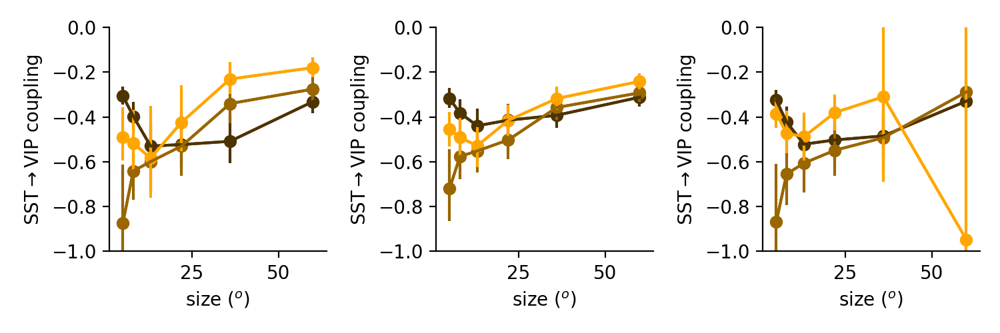

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

-0.22546700257794347
-0.277965705786956
-0.34223030799527765


In [1609]:
rg = slice(None)
i,j = 1,2
ylim = (-1,0)
xlabel = 'size ($^o$)'
ylabel = r'SST$\rightarrow$VIP coupling'
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings_fixed[:,isize,:,8,0,1].max()
rg = lkat#slice(None)
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv_fixed = couplings_pcpv_fixed[rg,:,:,i,j]
coupling_sst_sst_fixed = couplings_fixed[rg,:,:,i,j,1]

plt.figure(figsize=(7.5,2.5))
usize = [5,8,13,22,36,60]
plt.subplot(1,3,1)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)

plt.subplot(1,3,2)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_pcpv_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
# plt.tight_layout()

plt.subplot(1,3,3)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_sst_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
plt.tight_layout()
# plt.savefig('figures/sst_vip_coupling_pcpv_sst_phi_constant.eps')

In [748]:
lkat.mean()

0.990909090909091

<IPython.core.display.Javascript object>


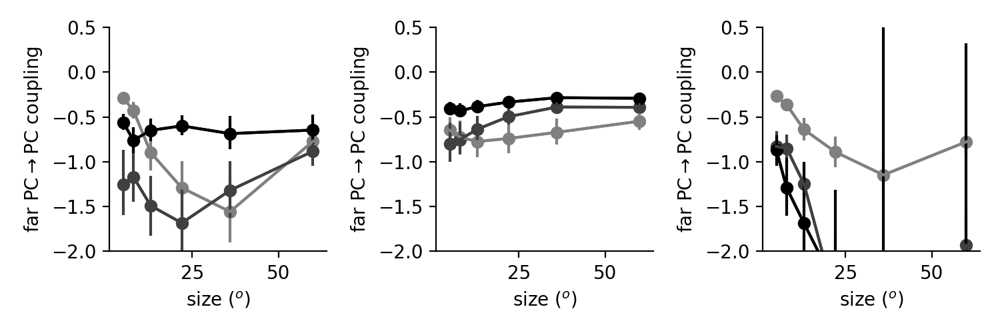

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

-0.3412519021709493
-0.34929918159189355
-0.31578117598311045


In [1610]:
# rg = slice(None)
i,j = 8,0
ylim = (-2,0.5)
xlabel = 'size ($^o$)'
ylabel = r'far PC$\rightarrow$PC coupling'
# lkat = couplings_fixed[:,:,:,8,0,1].max(1).max(1) < np.percentile(couplings_fixed[:,:,:,8,0,1],99.95)
rg = lkat
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv_fixed = couplings_pcpv_fixed[rg,:,:,i,j]
coupling_sst_sst_fixed = couplings_fixed[rg,:,:,i,j,1]
colors = c_l23

plt.figure(figsize=(7.5,2.5))
usize = [5,8,13,22,36,60]
plt.subplot(1,3,1)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=colors)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)

plt.subplot(1,3,2)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_pcpv_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=colors)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
# plt.tight_layout()

plt.subplot(1,3,3)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_sst_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=colors)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
plt.tight_layout()
# plt.savefig('figures/far_pc_pc_coupling_pcpv_sst_phi_constant.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if sys.path[0] == '':


<IPython.core.display.Javascript object>


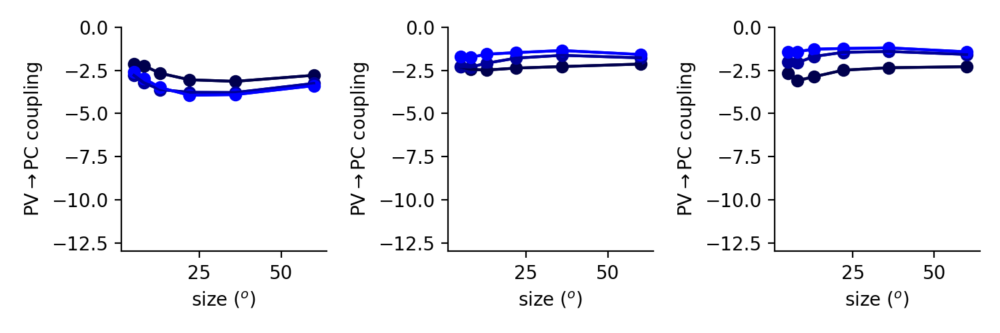

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

-2.12299880569836
-1.3476389331060317
-1.1904005043423975


In [849]:
# rg = slice(None)
rg = lkat
i,j = 3,0
ylim = (-13,0)
polysyn_sst = phis[rg,:,:,i]*Wmys[rg,i,j,np.newaxis,np.newaxis]*phis[rg,:,:,j]
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv_fixed = couplings_pcpv_fixed[rg,:,:,i,j]
coupling_sst_sst_fixed = couplings_fixed[rg,:,:,i,j,0]
colors = c_pv.copy()
ylabel = r'PV$\rightarrow$PC coupling'

plt.figure(figsize=(7.5,2.5))
usize = [5,8,13,22,36,60]
plt.subplot(1,3,1)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=colors)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)

plt.subplot(1,3,2)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_pcpv_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=colors)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
plt.ylim(ylim)

plt.subplot(1,3,3)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_sst_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=colors)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(ylabel)
plt.ylim(ylim)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  import sys


<IPython.core.display.Javascript object>


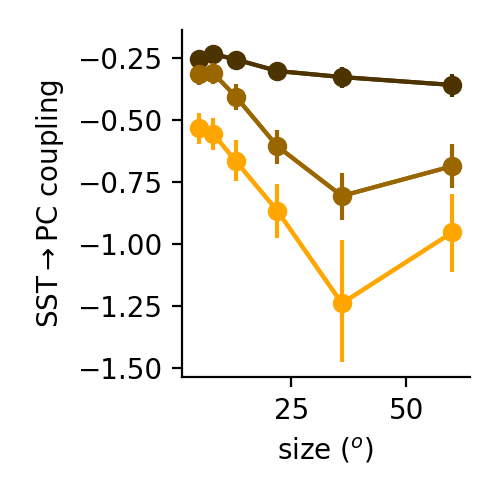

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.26851917984057116


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


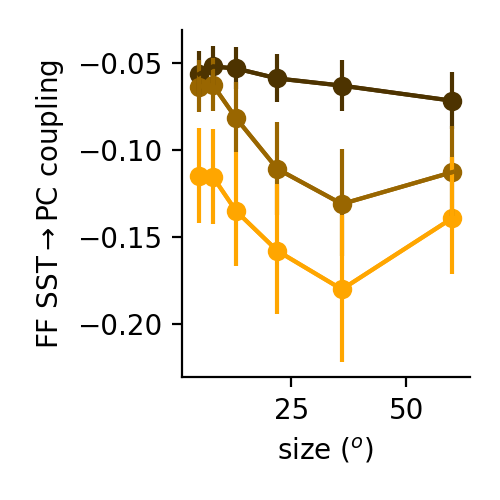

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.06413157277966482


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:41: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


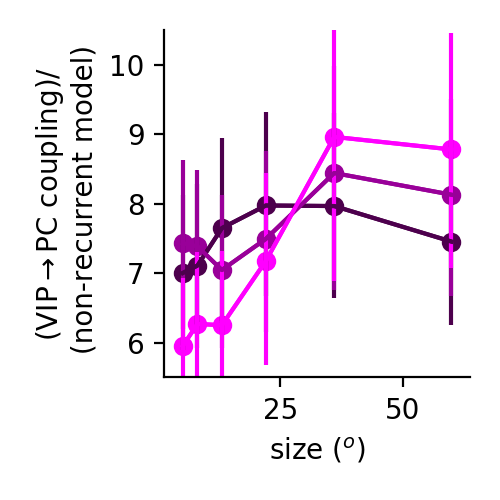

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


7.10741443815119


In [306]:
rg = slice(None)
i,j = 1,0
polysyn_sst = phis[rg,:,:,i]*Wmys[rg,i,j,np.newaxis,np.newaxis]*phis[rg,:,:,j]
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv = np.abs(couplings_pcpv[rg,:,:,i,j])

plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'SST$\rightarrow$PC coupling')
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
plt.savefig('figures/sst_pc_coupling.eps')

plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,polysyn_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'FF SST$\rightarrow$PC coupling')
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
plt.savefig('figures/sst_phi_W_phi.eps')
i,j,k = 2,1,0
polysyn_vip = phis[rg,:,:,i]*Wmys[rg,i,j,np.newaxis,np.newaxis]*phis[rg,:,:,j]*Wmys[rg,j,k,np.newaxis,np.newaxis]*phis[rg,:,:,k]
coupling_vip = np.abs(couplings[rg,:,:,i,k])
coupling_vip_pcpv = np.abs(couplings_pcpv[rg,:,:,i,k])

plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,(coupling_vip/polysyn_vip)[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'(VIP$\rightarrow$PC coupling)/'+' \n (non-recurrent model)')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
ylim_vip = (5.5,10.5)
plt.ylim(ylim_vip)
plt.tight_layout()
# plt.savefig('figures/vip_pc_coupling_over_phi_W_phi.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  import sys


<IPython.core.display.Javascript object>


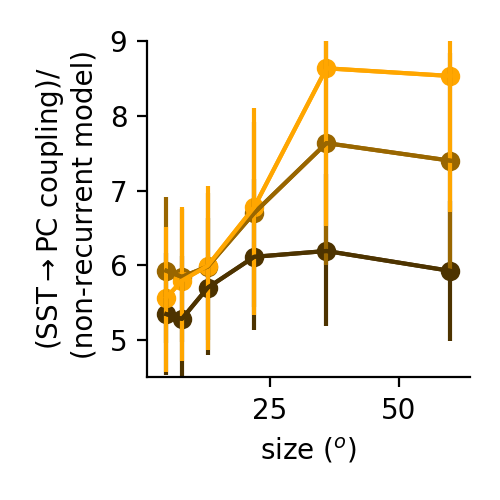

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


6.649769893675679


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


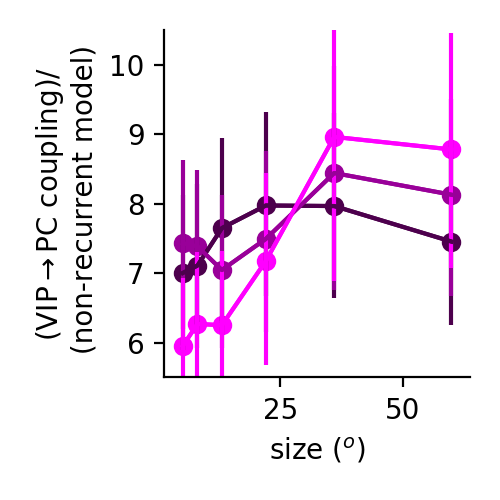

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


7.10741443815119


In [307]:
rg = slice(None)
i,j = 1,0
polysyn_sst = phis[rg,:,:,i]*Wmys[rg,i,j,np.newaxis,np.newaxis]*phis[rg,:,:,j]
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv = np.abs(couplings_pcpv[rg,:,:,i,j])

plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,(coupling_sst/polysyn_sst)[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'(SST$\rightarrow$PC coupling)/'+' \n (non-recurrent model)')
ylim_sst = (4.5,9)
plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
# plt.savefig('figures/sst_pc_coupling_over_phi_W_phi.eps')

i,j,k = 2,1,0
polysyn_vip = phis[rg,:,:,i]*Wmys[rg,i,j,np.newaxis,np.newaxis]*phis[rg,:,:,j]*Wmys[rg,j,k,np.newaxis,np.newaxis]*phis[rg,:,:,k]
coupling_vip = np.abs(couplings[rg,:,:,i,k])
coupling_vip_pcpv = np.abs(couplings_pcpv[rg,:,:,i,k])

plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,(coupling_vip/polysyn_vip)[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'(VIP$\rightarrow$PC coupling)/'+' \n (non-recurrent model)')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
ylim_vip = (5.5,10.5)
plt.ylim(ylim_vip)
plt.tight_layout()
# plt.savefig('figures/vip_pc_coupling_over_phi_W_phi.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  import sys


<IPython.core.display.Javascript object>


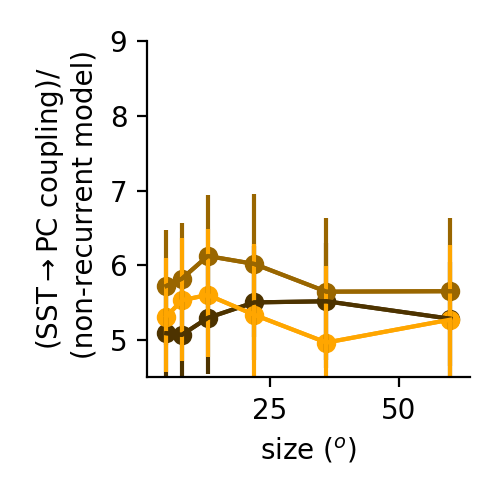

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


5.3022733890123295


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:26: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


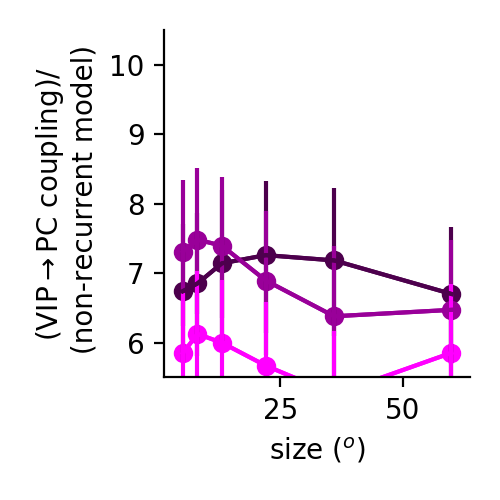

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


6.450332774934487


In [308]:
rg = slice(None)
i,j = 1,0
polysyn_sst = phis[rg,:,:,i]*Wmys[rg,i,j,np.newaxis,np.newaxis]*phis[rg,:,:,j]
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv = couplings_pcpv[rg,:,:,i,j]

plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,(coupling_sst_pcpv/polysyn_sst)[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'(SST$\rightarrow$PC coupling)/'+' \n (non-recurrent model)')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim_sst)
plt.tight_layout()
# plt.savefig('figures/sst_pc_coupling_over_phi_W_phi_pcpv.eps')

i,j,k = 2,1,0
polysyn_vip = phis[rg,:,:,i]*Wmys[rg,i,j,np.newaxis,np.newaxis]*phis[rg,:,:,j]*Wmys[rg,j,k,np.newaxis,np.newaxis]*phis[rg,:,:,k]
coupling_vip = couplings[rg,:,:,i,k]
coupling_vip_pcpv = couplings_pcpv[rg,:,:,i,k]

plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,(coupling_vip_pcpv/polysyn_vip)[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'(VIP$\rightarrow$PC coupling)/'+' \n (non-recurrent model)')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim_vip)
plt.tight_layout()
# plt.savefig('figures/vip_pc_coupling_over_phi_W_phi_pcpv.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


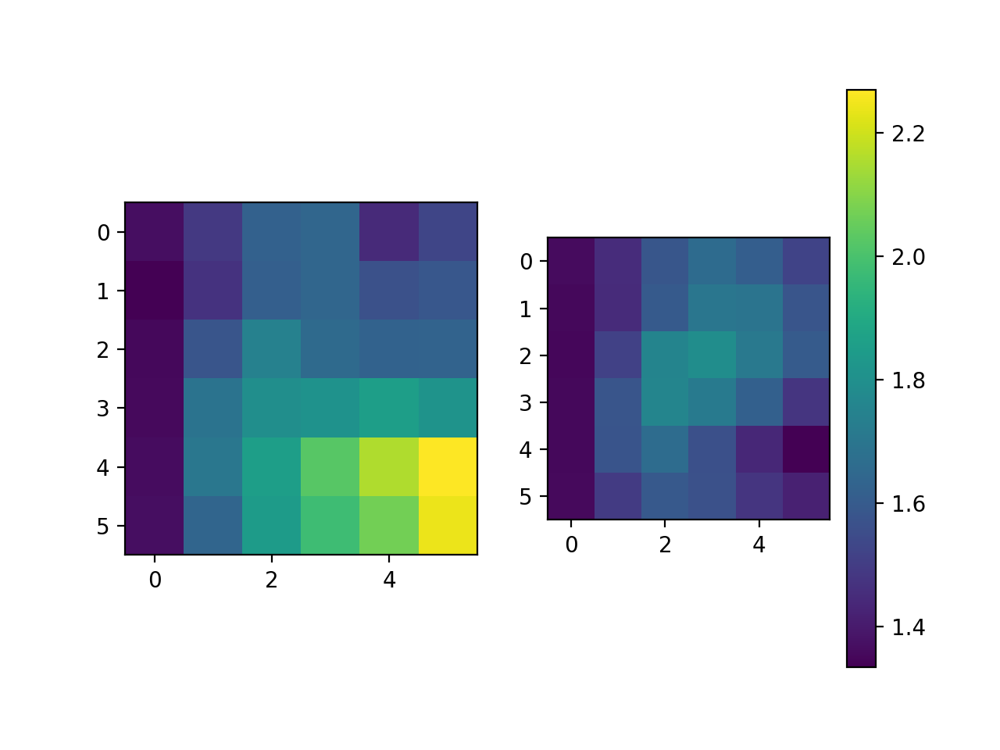

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


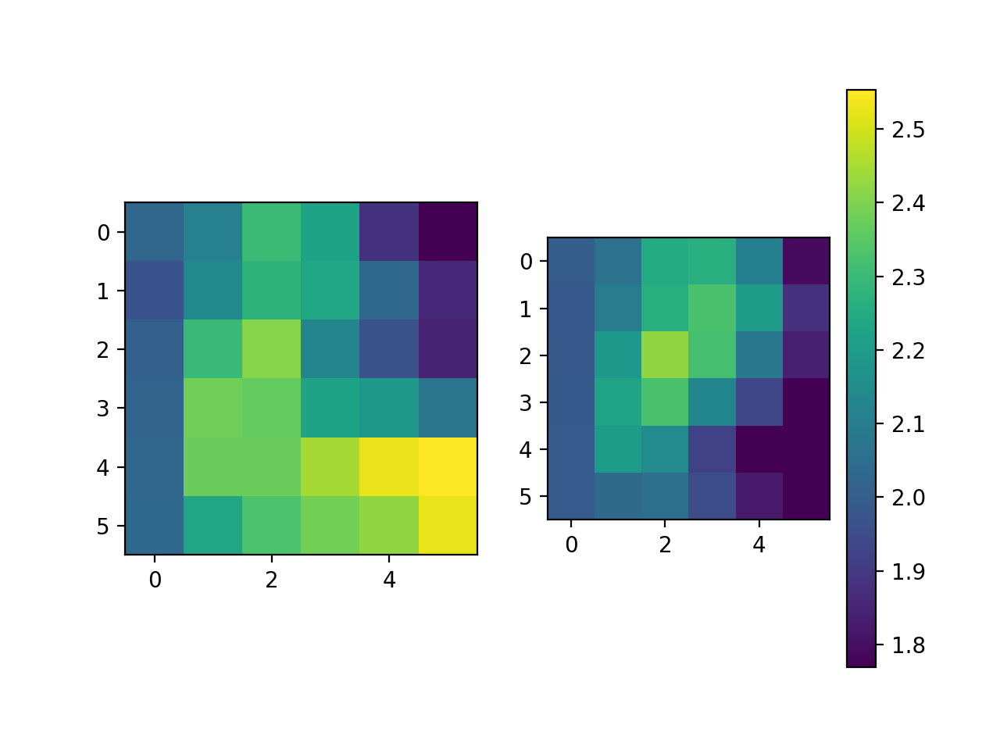

In [309]:
i,j = 1,0
iwt = 3
rg = slice(None)
polysyn_sst = phis[rg,:,:,i]*phis[rg,:,:,j]
coupling_sst = np.abs(couplings[rg,:,:,i,j])
coupling_sst_pcpv = np.abs(couplings_pcpv[rg,:,:,i,j])

plt.figure()
plt.subplot(1,2,1)
data = np.nanmean(coupling_sst/polysyn_sst,axis=0)
mn = np.nanmin(data)
mx = np.nanmax(data)
plt.imshow(data,vmin=mn,vmax=mx)
plt.subplot(1,2,2)
data = np.nanmean(coupling_sst_pcpv/polysyn_sst,axis=0)
# mn = np.nanmin(data)
# mx = np.nanmax(data)
plt.imshow(data,vmin=mn,vmax=mx)
plt.colorbar()

i,j,k = 2,1,0
polysyn_vip = phis[rg,:,:,i]*phis[rg,:,:,j]*phis[rg,:,:,k]
coupling_vip = np.abs(couplings[rg,:,:,i,k])
coupling_vip_pcpv = np.abs(couplings_pcpv[rg,:,:,i,k])
ei = phis[rg,:,:,0]/phis[rg,:,:,3]

plt.figure()
plt.subplot(1,2,1)
data = np.nanmean(coupling_vip/polysyn_vip,axis=0)
mn = np.nanmin(data)
mx = np.nanmax(data)
plt.imshow(data,vmin=mn,vmax=mx)
plt.subplot(1,2,2)
data = np.nanmean(coupling_vip_pcpv/polysyn_vip,axis=0)
# mn = np.nanmin(data)
# mx = np.nanmax(data)
plt.imshow(data,vmin=mn,vmax=mx)
plt.colorbar()



/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


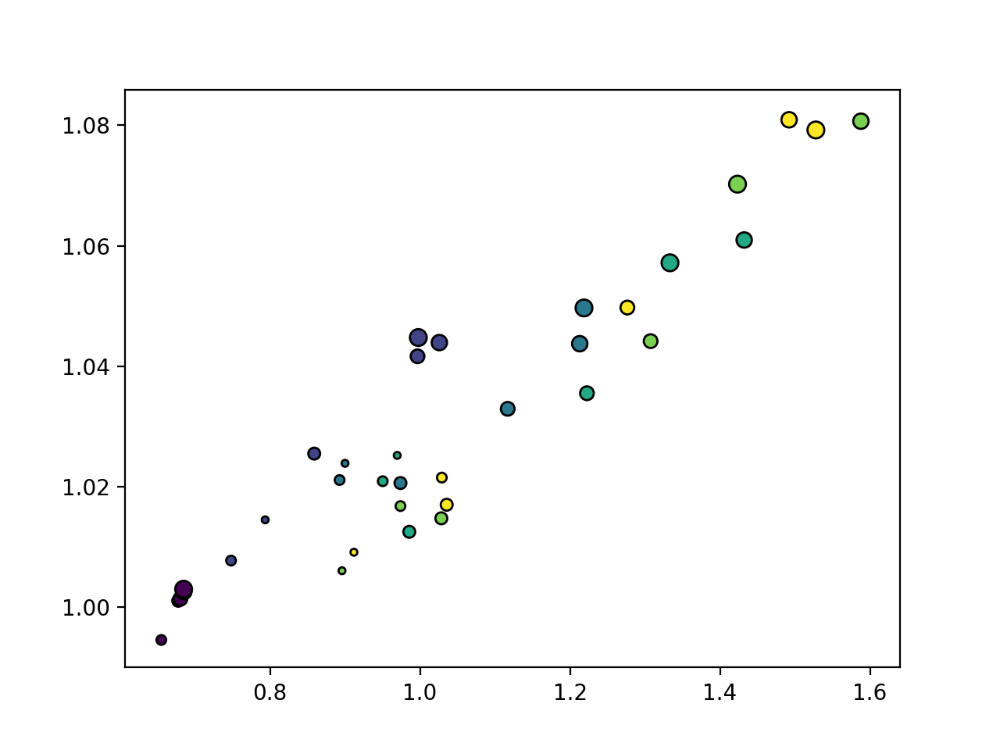

<IPython.core.display.Javascript object>


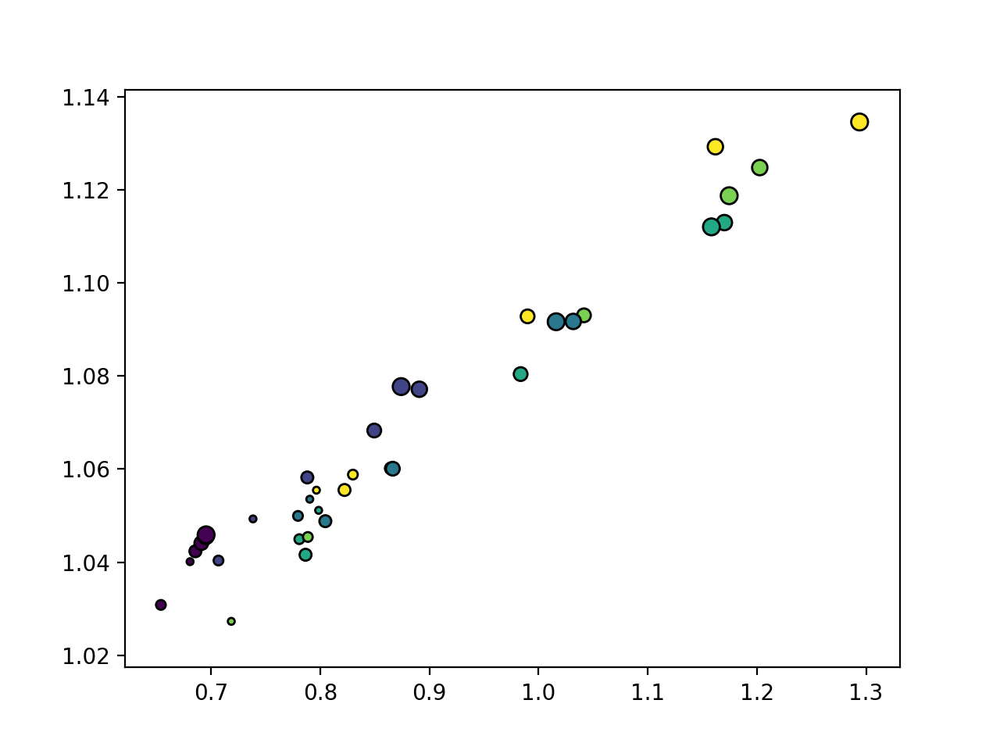

<IPython.core.display.Javascript object>


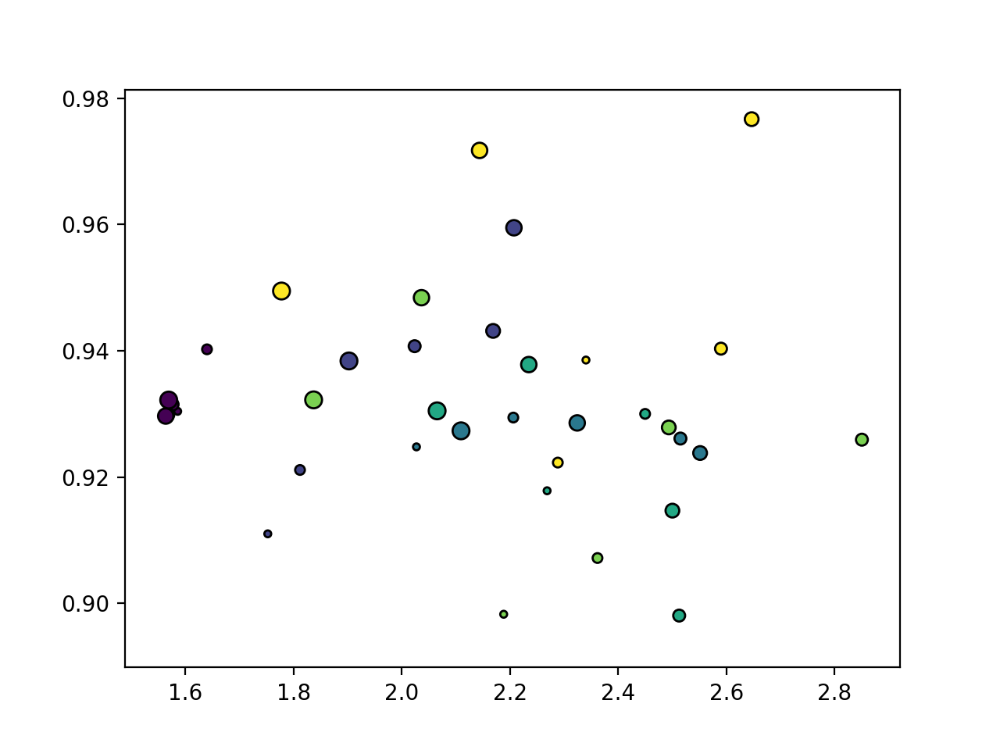

<IPython.core.display.Javascript object>


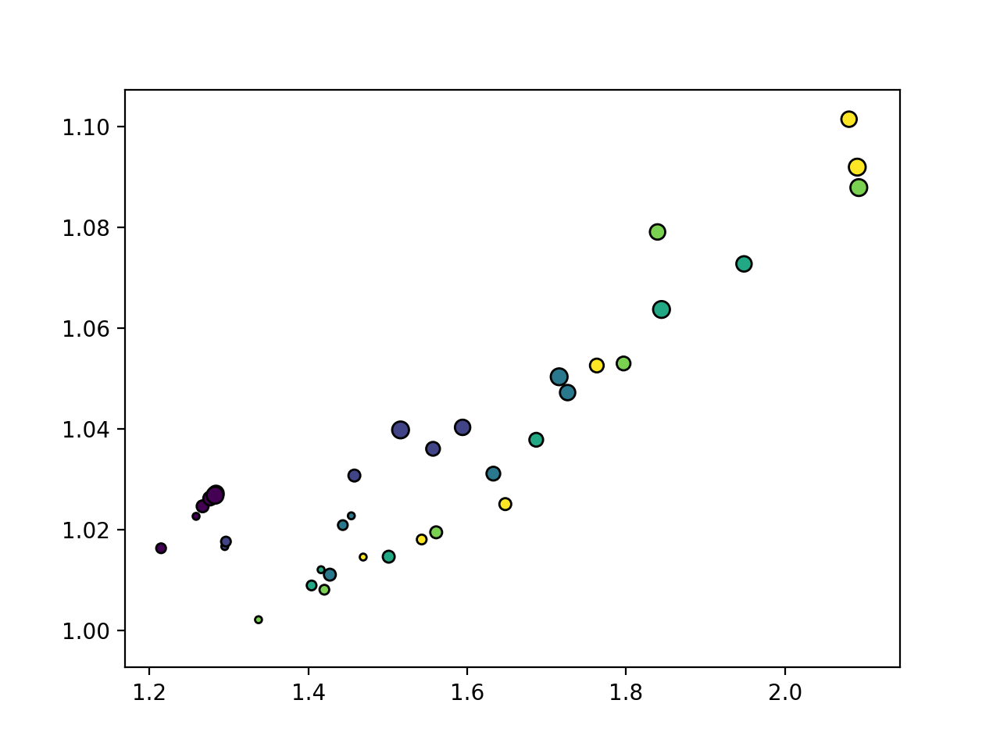

<IPython.core.display.Javascript object>


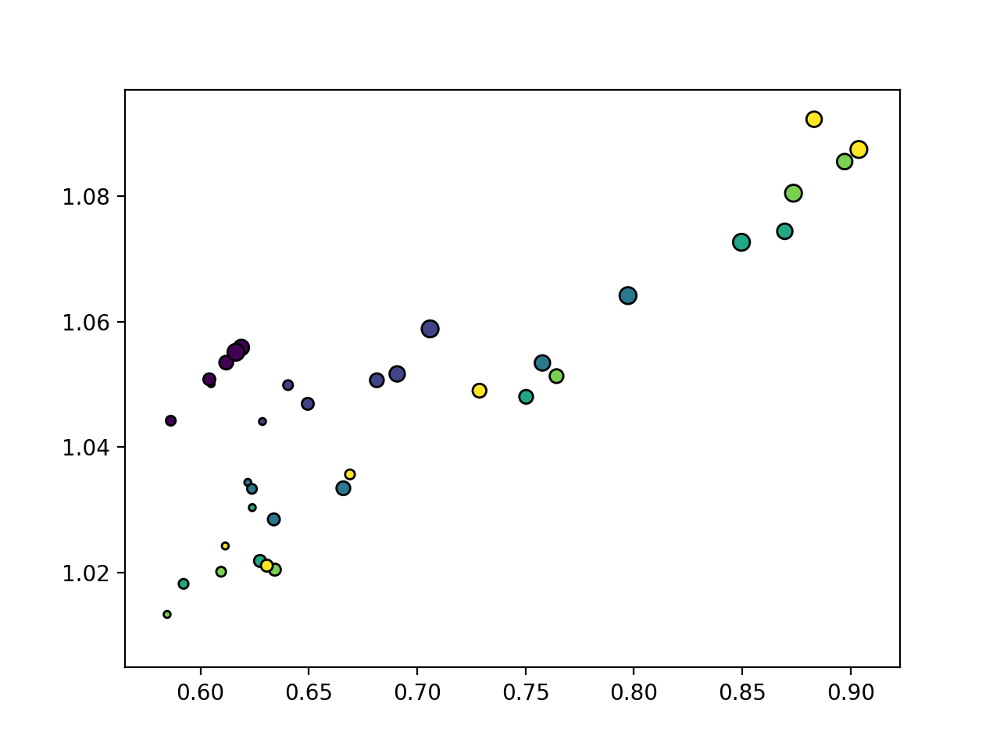

In [71]:
for iwt in range(5):
    plt.figure()
    sca.scatter_size_contrast(coupling_sst[iwt]/polysyn_sst[iwt],ei[iwt],equality_line=False,square=False)

<IPython.core.display.Javascript object>


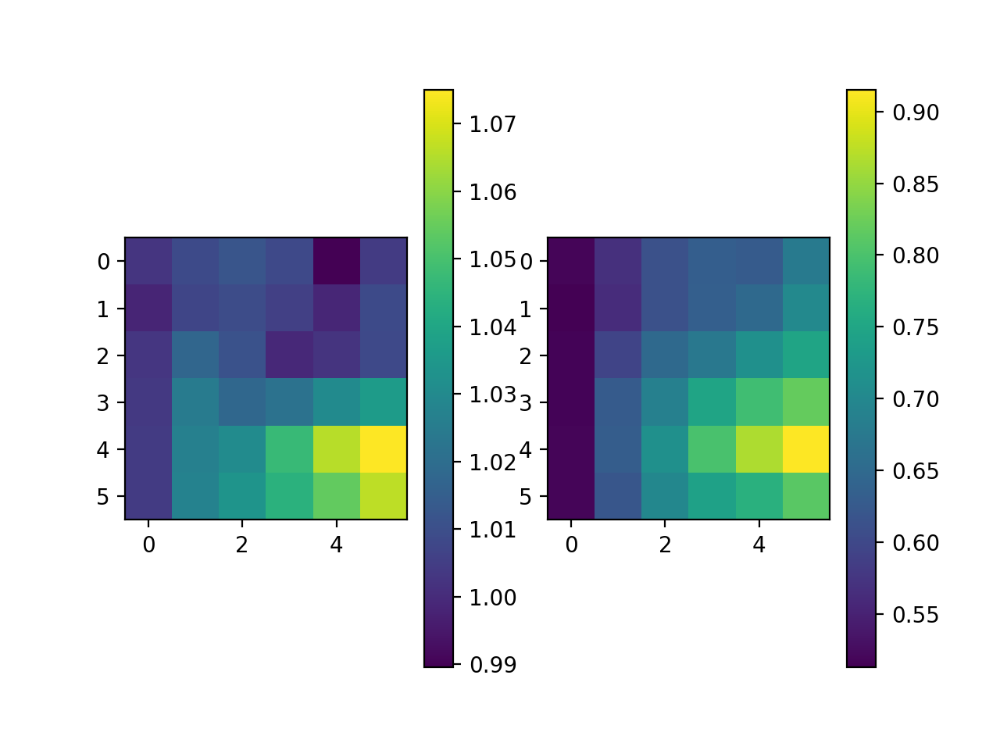

In [194]:
plt.figure()
plt.subplot(1,2,1)
plt.imshow(np.mean(phis[:,:,:,0]/phis[:,:,:,3],0))
plt.colorbar()
plt.subplot(1,2,2)
plt.imshow(np.mean(max_eig,0))
plt.colorbar()

In [417]:
max_eig.shape

(64, 6, 6)

In [402]:
couplings.shape

(84, 6, 6, 16, 16)

In [390]:
iwt,isize,icontrast = 0,0,0
w,v = np.linalg.eig(couplings[iwt,isize,icontrast].T)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


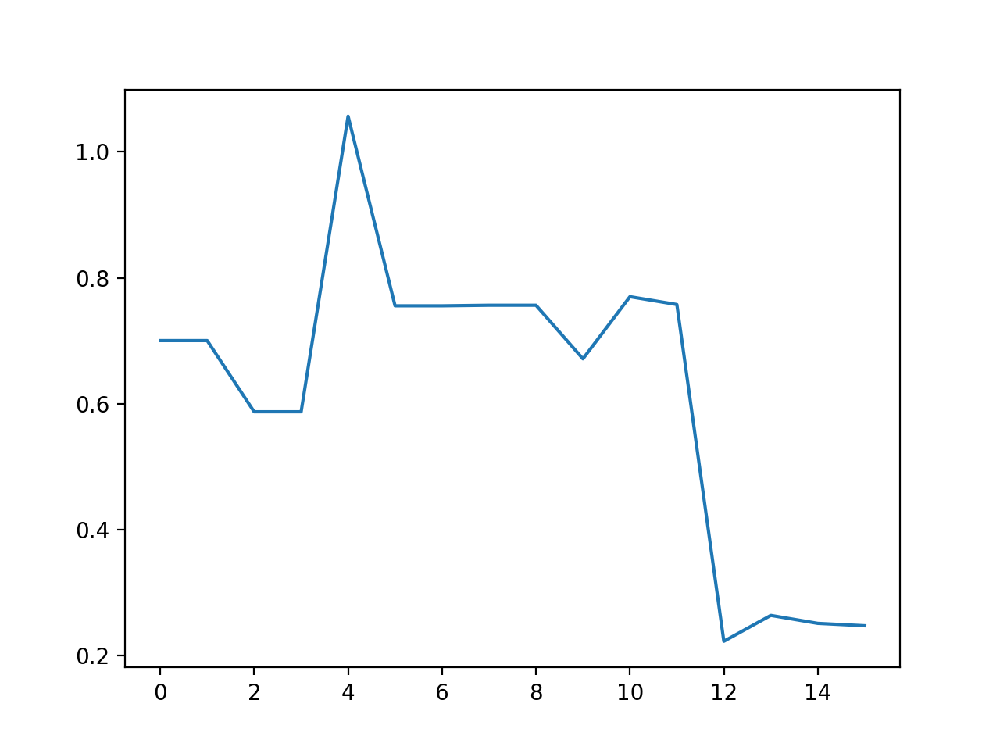

In [391]:
plt.figure()
plt.plot(np.abs(w))

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


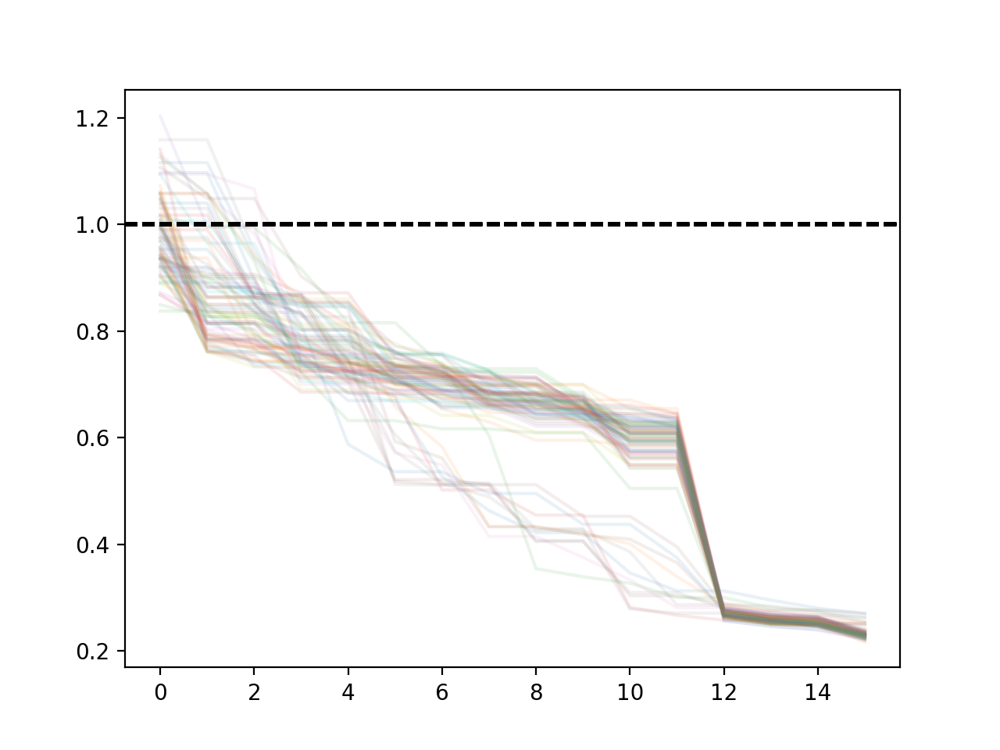

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # This is added back by InteractiveShellApp.init_path()


<IPython.core.display.Javascript object>


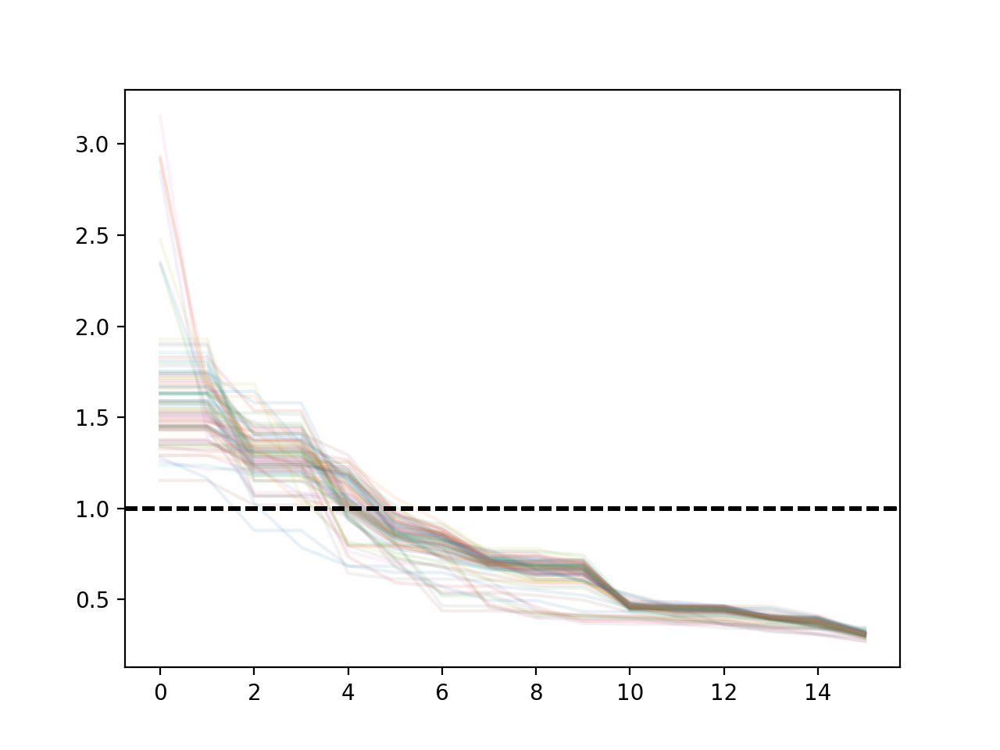

In [400]:
nwt = couplings.shape[0]
plt.figure()
for iwt in range(nwt):
    isize,icontrast = 0,0
    w,v = np.linalg.eig(couplings[iwt,isize,icontrast].T)
#     w,v = np.linalg.eig(Wmys[iwt].T)
    data = v[:,np.argmax(np.abs(w))]
#     plt.plot(data*np.sign(data[0]),alpha=0.1)
    plt.plot(-np.sort(-np.abs(w)),alpha=0.1)
    plt.axhline(1,c='k',linestyle='dashed')
plt.figure()
for iwt in range(nwt):
    isize,icontrast = -1,-1
    w,v = np.linalg.eig(couplings[iwt,isize,icontrast].T)
#     w,v = np.linalg.eig(Wmys[iwt].T)
    data = v[:,np.argmax(np.abs(w))]
#     plt.plot(data*np.sign(data[0]),alpha=0.1)
    plt.plot(-np.sort(-np.abs(w)),alpha=0.1)
    plt.axhline(1,c='k',linestyle='dashed')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


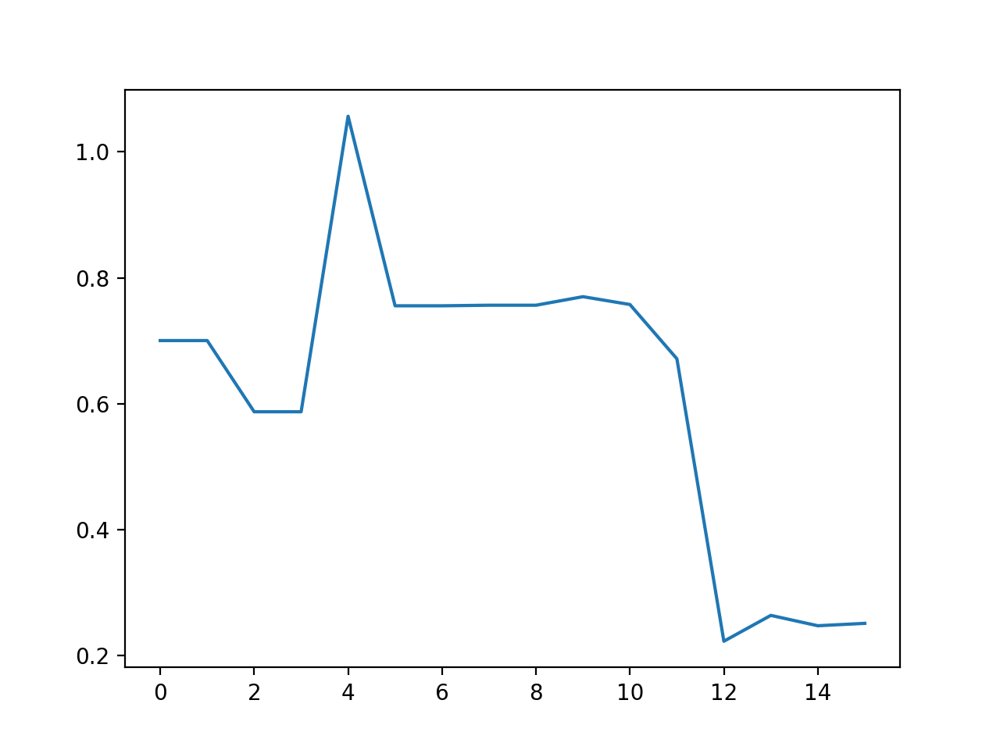

In [369]:
plt.figure()
plt.plot(np.abs(w))

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


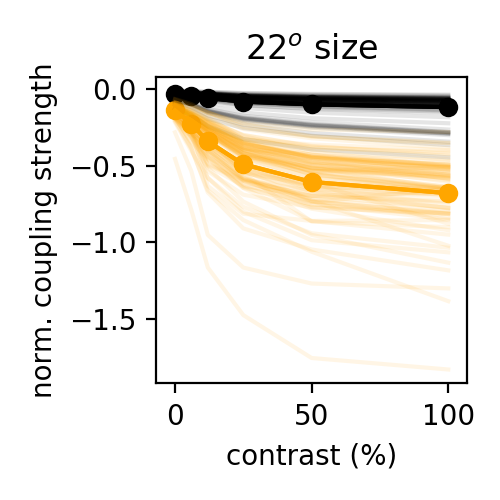

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.03917280614686907
-0.150050953198579


In [379]:
plt.figure(figsize=(2.5,2.5))
isize = 3
i,j = 1,0
polysyn_sst = phis[:,isize,:,i]*Wmys[:,np.newaxis,i,j]*phis[:,isize,:,j]
datas = [polysyn_sst,couplings[:,isize,:,i,j]]
colors = [np.array((0,0,0)),np.array((1,0.65,0))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(ucontrast,(data)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
# plt.legend(['$\phi_{PC}$','$\phi_{SST}\phi_{PC}$','$\phi_{VIP}\phi_{SST}\phi_{PC}$'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(ucontrast,(data).T,alpha=0.1,c=color)
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
plt.title('%d$^o$ size'%usize[isize])
# plt.axhline(0,linestyle='dashed',c='k')
plt.tight_layout()
# plt.savefig('figures/sst_vip_pv_pc_coupling_traces.jpg',dpi=300)

<IPython.core.display.Javascript object>


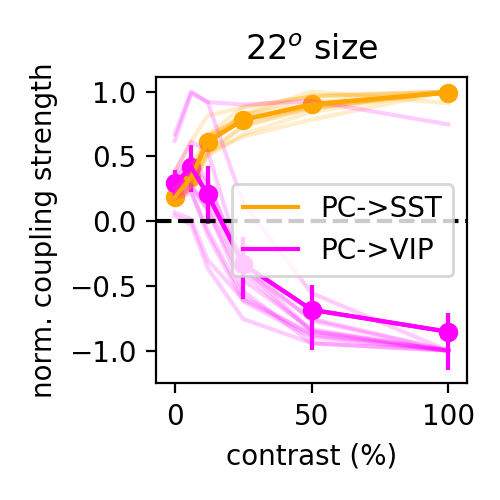

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.9775239571935156
0.2438549595342812


In [262]:
plt.figure(figsize=(2.5,2.5))
isize = 3
datas = [couplings[:,isize,:,0,1][lkat],couplings[:,isize,:,0,2][lkat]]
colors = [np.array((1,0.65,0)),np.array((1,0,1))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(ucontrast,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend(['PC->SST','PC->VIP'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(ucontrast,(data/mx).T,alpha=0.2,c=color)
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
plt.title('%d$^o$ size'%usize[isize])
plt.axhline(0,linestyle='dashed',c='k')
plt.tight_layout()
plt.savefig('figures/pc_sst_vip_coupling_traces.jpg',dpi=300)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


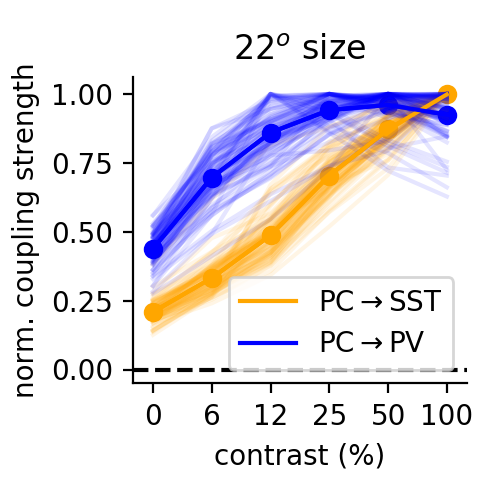

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.9954072593906618
0.9445815973788986


In [460]:
plt.figure(figsize=(2.5,2.5))
isize = 3
x = np.arange(6)
datas = [couplings[:,isize,:,0,1],couplings[:,isize,:,0,3]]
colors = [np.array((1,0.65,0)),np.array((0,0,1))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(x,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend([r'PC$\rightarrow$SST',r'PC$\rightarrow$PV'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(x,(data/mx).T,alpha=0.1,c=color)
plt.xticks(x,ucontrast)
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
plt.title('%d$^o$ size'%usize[isize])
plt.axhline(0,linestyle='dashed',c='k')
erase_top_right()
plt.tight_layout()
plt.savefig('figures/pc_sst_pv_coupling_traces.jpg',dpi=300)

<IPython.core.display.Javascript object>


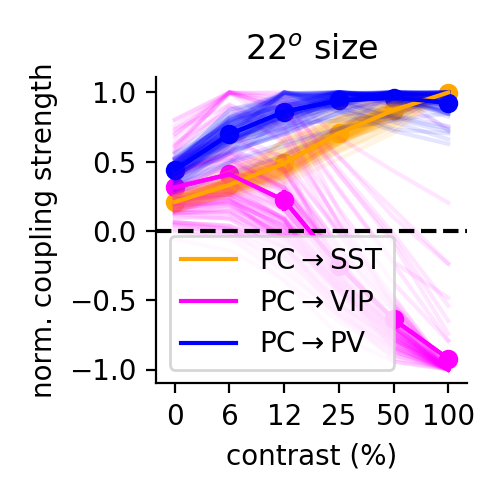

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.9954072593906618
0.33959046626249945
0.9445815973788986


In [244]:
plt.figure(figsize=(2.5,2.5))
isize = 3
x = np.arange(6)
datas = [couplings[:,isize,:,0,1],couplings[:,isize,:,0,2],couplings[:,isize,:,0,3]]
colors = [np.array((1,0.65,0)),np.array((1,0,1)),np.array((0,0,1))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(x,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend([r'PC$\rightarrow$SST',r'PC$\rightarrow$VIP',r'PC$\rightarrow$PV'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(x,(data/mx).T,alpha=0.1,c=color)
plt.xticks(x,ucontrast)
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
erase_top_right()
plt.title('%d$^o$ size'%usize[isize])
plt.axhline(0,linestyle='dashed',c='k')
plt.tight_layout()
plt.savefig('figures/pc_sst_vip_pv_coupling_traces.jpg',dpi=300)

<IPython.core.display.Javascript object>


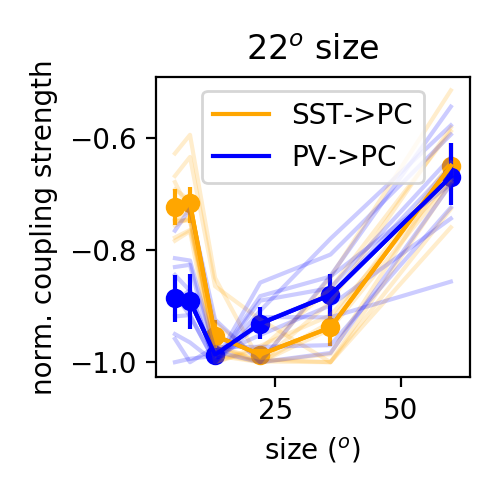

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.6913826093226111
-0.7283928801069505


In [193]:
plt.figure(figsize=(2.5,2.5))
icontrast = 5
datas = [couplings[:,:,icontrast,1,0][lkat],couplings[:,:,icontrast,3,0][lkat]]
colors = [np.array((1,0.65,0)),np.array((0,0,1))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(usize,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend(['SST->PC','PV->PC'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(usize,(data/mx).T,alpha=0.2,c=color)
plt.xlabel('size ($^o$)')
plt.ylabel('norm. coupling strength')
plt.title('%d$^o$ size'%usize[isize])
plt.tight_layout()
# plt.savefig('figures/sst_pc_coupling_traces.jpg',dpi=300)

In [257]:
nlkat

12

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


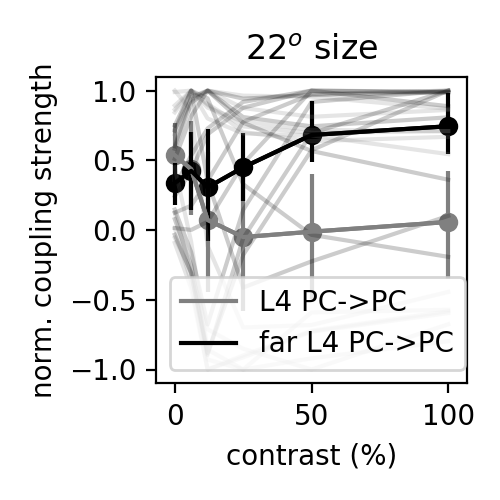

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.3030547878623264
0.5045479222596704


In [318]:
plt.figure(figsize=(2.5,2.5))
isize = 3
datas = [Xcouplings[:,isize,:,0,0][lkat],Xcouplings[:,isize,:,4,0][lkat]]
colors = [np.array((0.5,0.5,0.5)),np.array((0,0,0))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(ucontrast,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend(['L4 PC->PC','far L4 PC->PC'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(ucontrast,(data/mx).T,alpha=0.2,c=color)
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
plt.title('%d$^o$ size'%usize[isize])
plt.tight_layout()
# plt.savefig('figures/far_pc_near_pc_coupling_traces.jpg',dpi=300)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


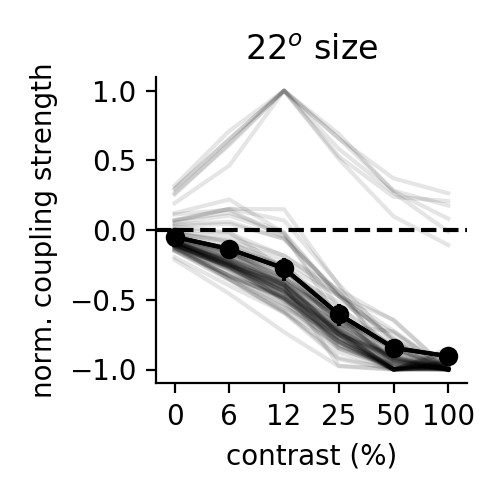

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.07160307643207439


In [374]:
plt.figure(figsize=(2.5,2.5))
isize = 3
x = np.arange(6)
datas = [couplings[:,isize,:,8,0]] #couplings[:,isize,:,0,0],
colors = [np.array((0,0,0))] #np.array((0.5,0.5,0.5)),
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(x,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
# plt.legend([r'PC$\rightarrow$PC',r'far PC$\rightarrow$PC'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(x,(data/mx).T,alpha=0.1,c=color)
plt.xticks(x,ucontrast)
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
erase_top_right()
plt.title('%d$^o$ size'%usize[isize])
plt.axhline(0,linestyle='dashed',c='k')
plt.tight_layout()
plt.savefig('figures/far_pc_coupling_traces.jpg',dpi=300)

In [ ]:
plt.figure(figsize=(2.5,2.5))
isize = 3
datas = [couplings[:,isize,:,0,0],couplings[:,isize,:,8,0]]
colors = [np.array((0.5,0.5,0.5)),np.array((0,0,0))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(ucontrast,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend(['PC->PC','far PC->PC'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(ucontrast,(data/mx).T,alpha=0.1,c=color)
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
plt.title('%d$^o$ size'%usize[isize])
plt.axhline(0,linestyle='dashed',c='k')
plt.tight_layout()
# plt.savefig('figures/far_pc_near_pc_coupling_traces.jpg',dpi=300)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


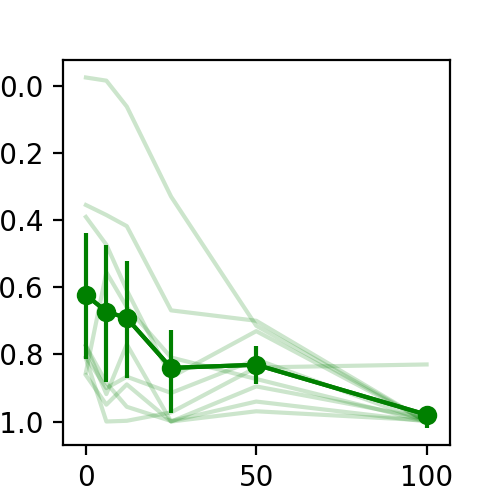

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.808474426536969


In [978]:
plt.figure(figsize=(2.5,2.5))
isize = 3
datas = [Xcouplings[:,isize,:,4,0]]
colors = [np.array((0,0.5,0))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(ucontrast,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
# plt.legend(['far PC->near])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(ucontrast,(data/mx).T,alpha=0.2,c=color)
# plt.xlabel('contrast (%)')
# plt.ylabel('norm. coupling strength')
# plt.tight_layout()
# # plt.savefig('figures/sst_pc_coupling_traces.jpg',dpi=300)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


<IPython.core.display.Javascript object>


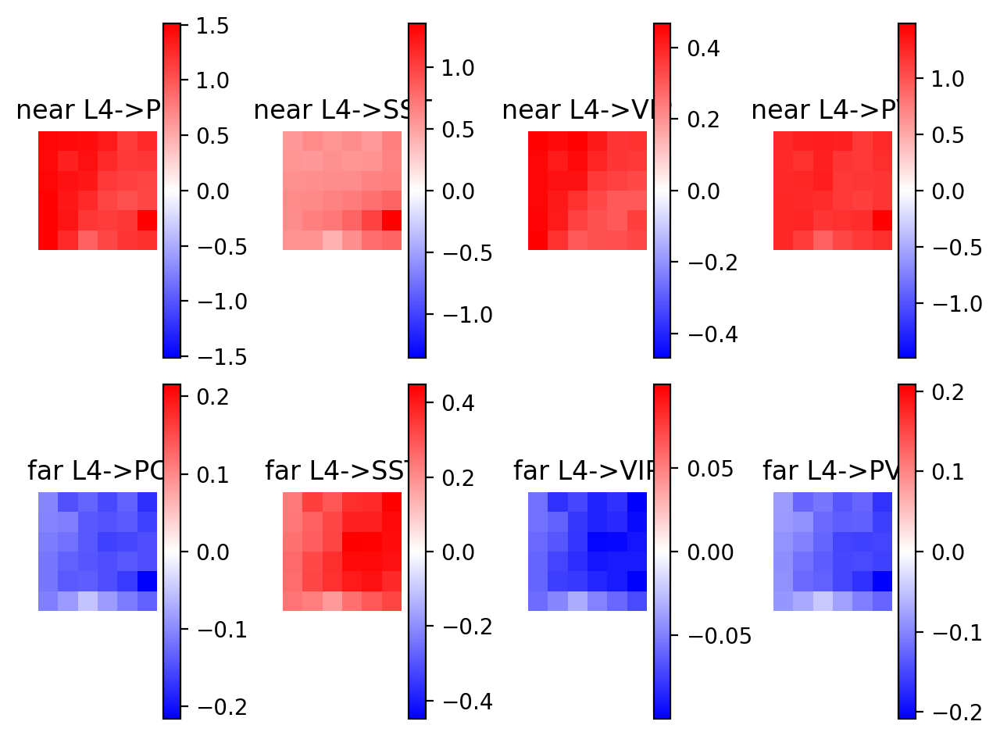

<IPython.core.display.Javascript object>


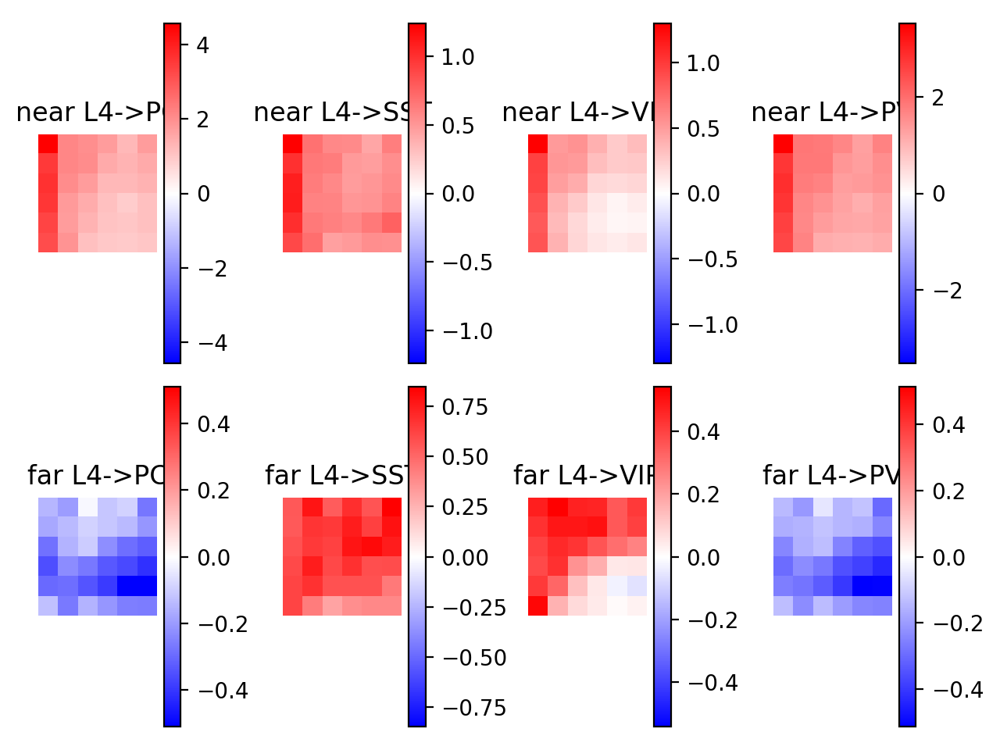

<IPython.core.display.Javascript object>


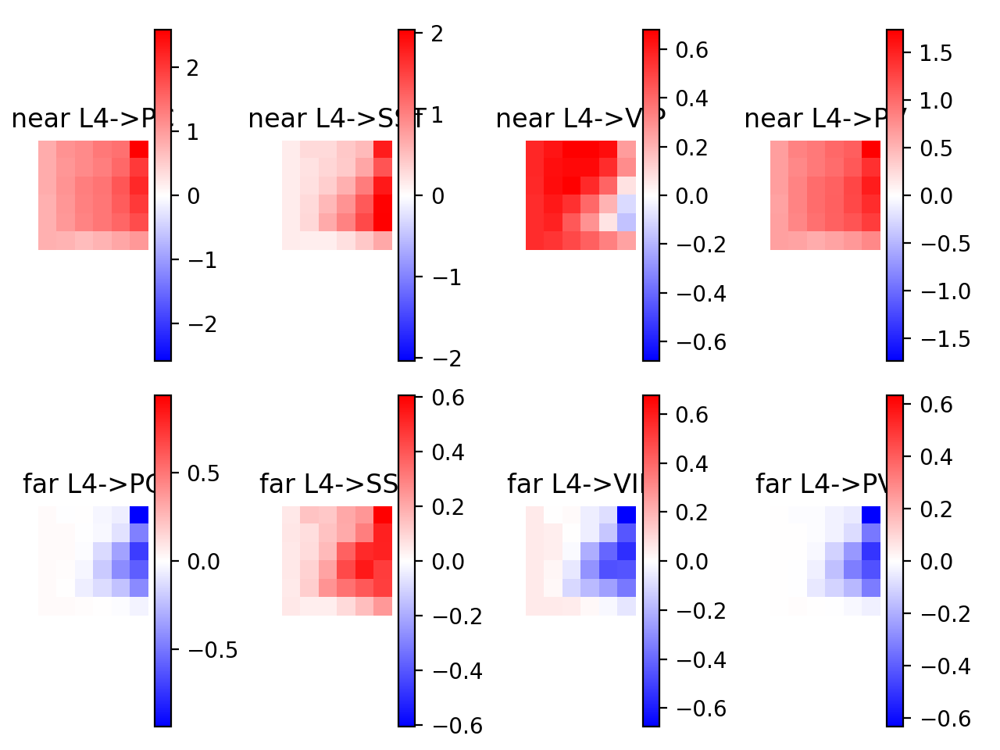

<IPython.core.display.Javascript object>


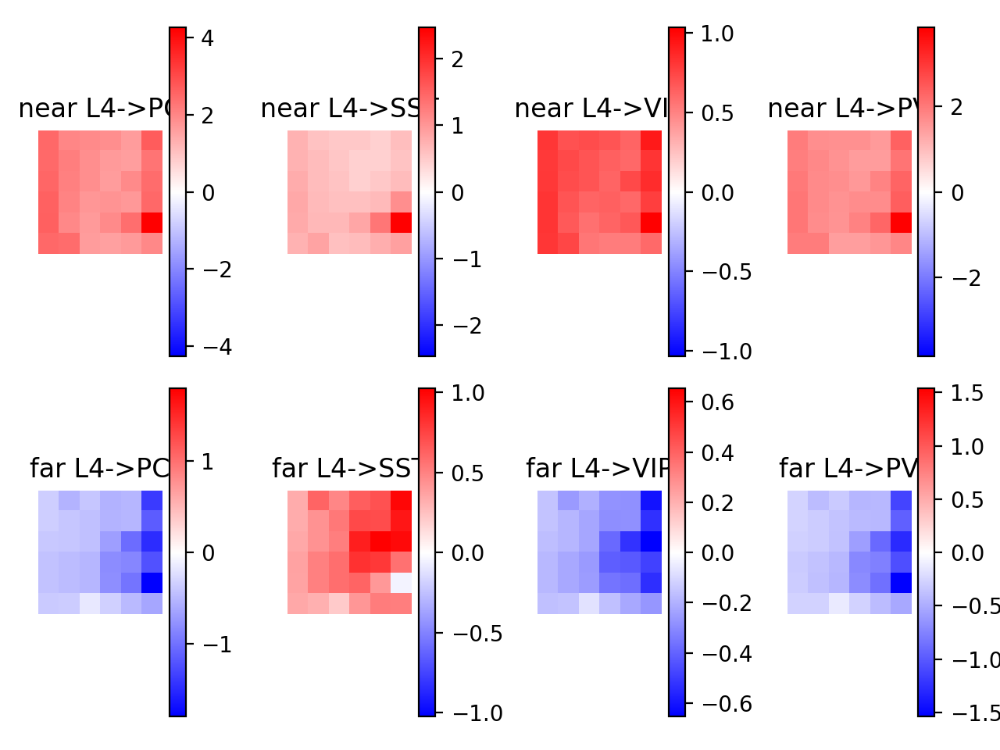

<IPython.core.display.Javascript object>


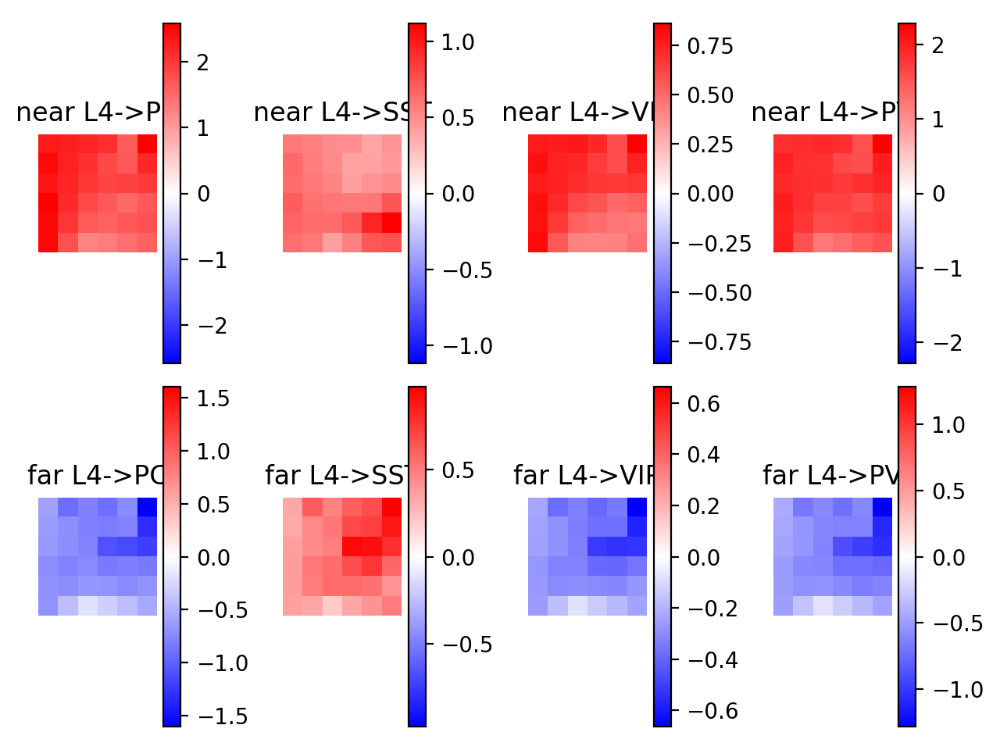

<IPython.core.display.Javascript object>


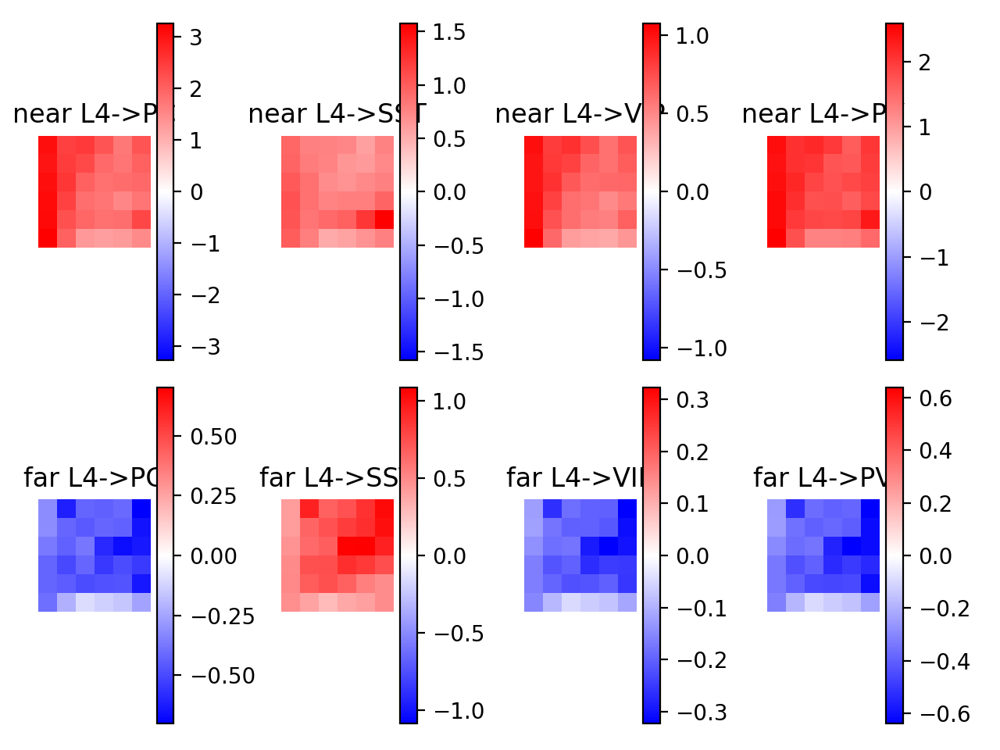

<IPython.core.display.Javascript object>


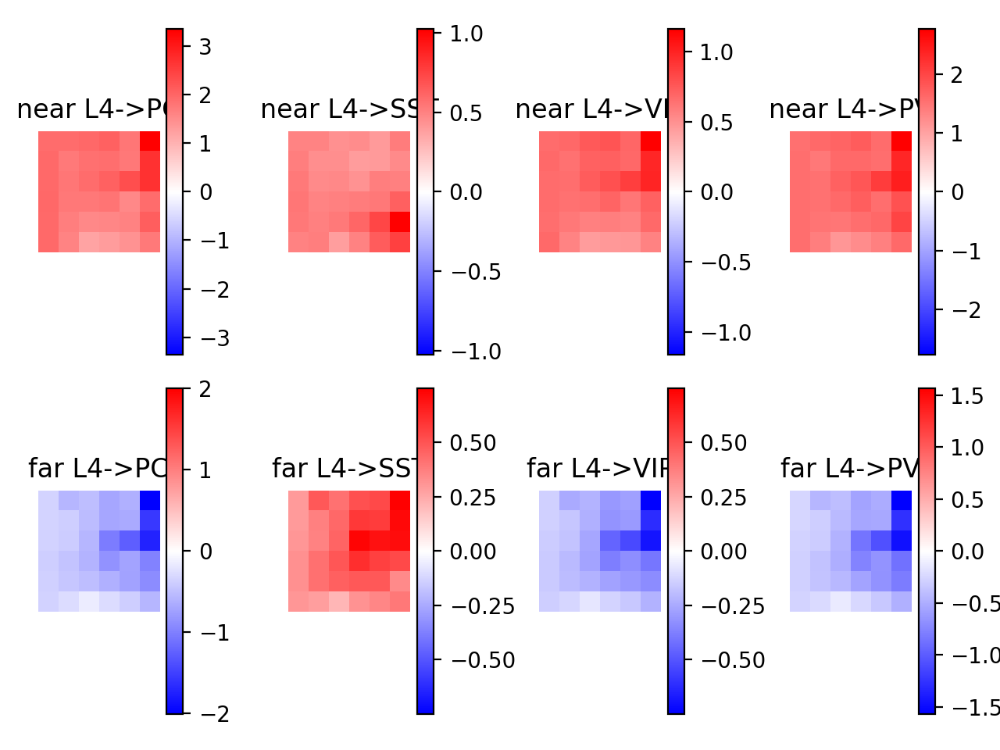

<IPython.core.display.Javascript object>


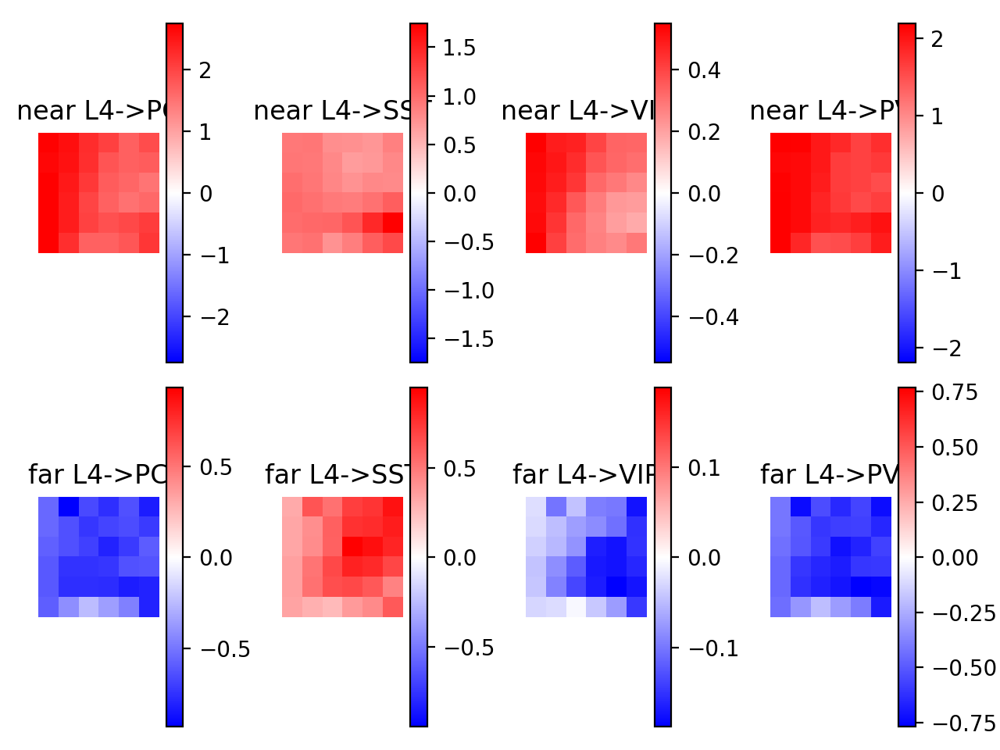

<IPython.core.display.Javascript object>


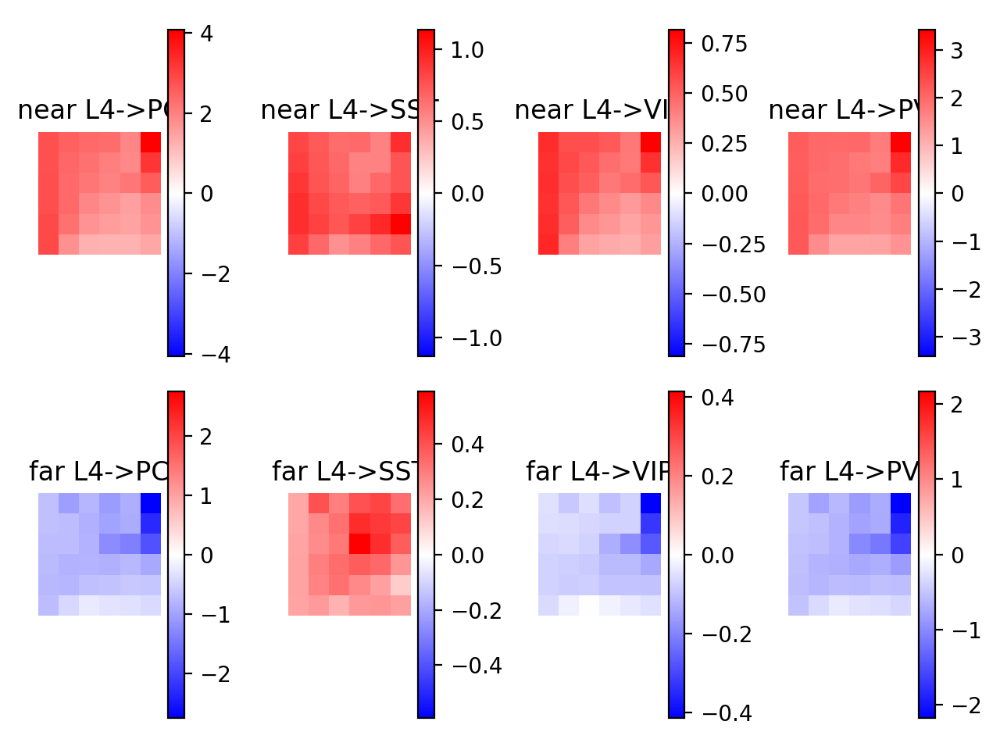

In [979]:
l4_lbls = ['near L4','far L4']
lbls = ['PC','SST','VIP','PV']
for iwt in range(len(weights_files)):
    plt.figure()
    for i2 in range(4):
        plt.subplot(2,4,i2+1)
        data = Xcouplings[iwt][:,:,0,i2]
        plt.imshow(data,cmap='bwr',vmin=-np.abs(data).max(),vmax=np.abs(data).max())
        plt.colorbar()
        plt.axis('off')
        plt.title('%s->%s'%(l4_lbls[0],lbls[i2]))
        
        plt.subplot(2,4,4+i2+1)
        data = Xcouplings[iwt][:,:,4,i2]
        plt.imshow(data,cmap='bwr',vmin=-np.abs(data).max(),vmax=np.abs(data).max())
        plt.colorbar()
        plt.axis('off')
        plt.title('%s->%s'%(l4_lbls[1],lbls[i2]))
    plt.tight_layout()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


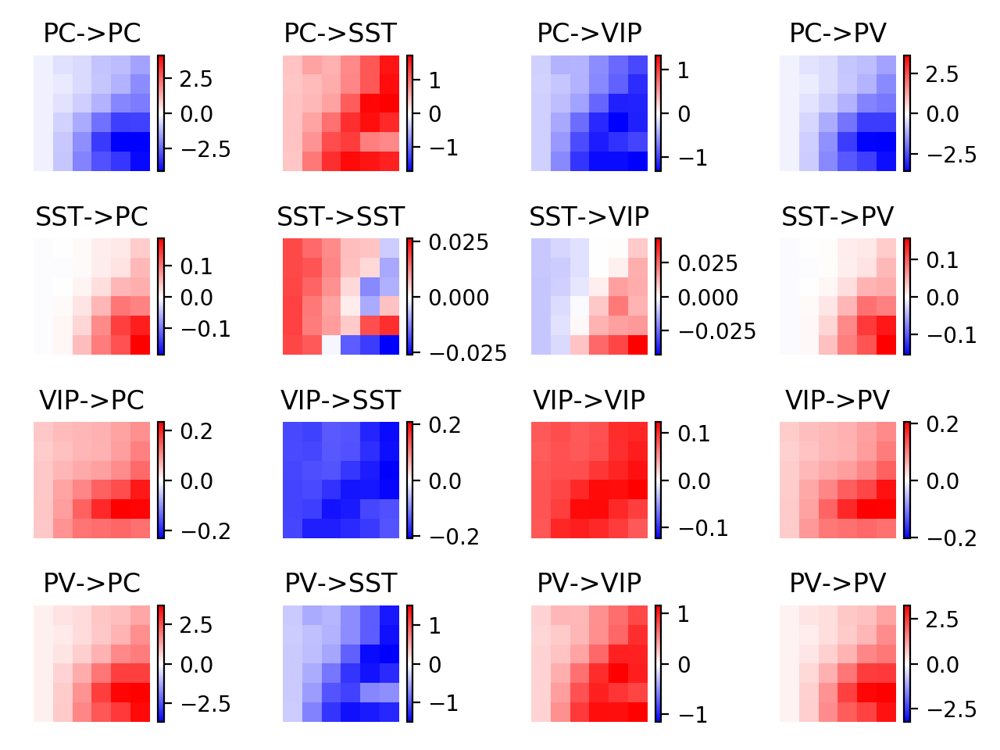

<IPython.core.display.Javascript object>


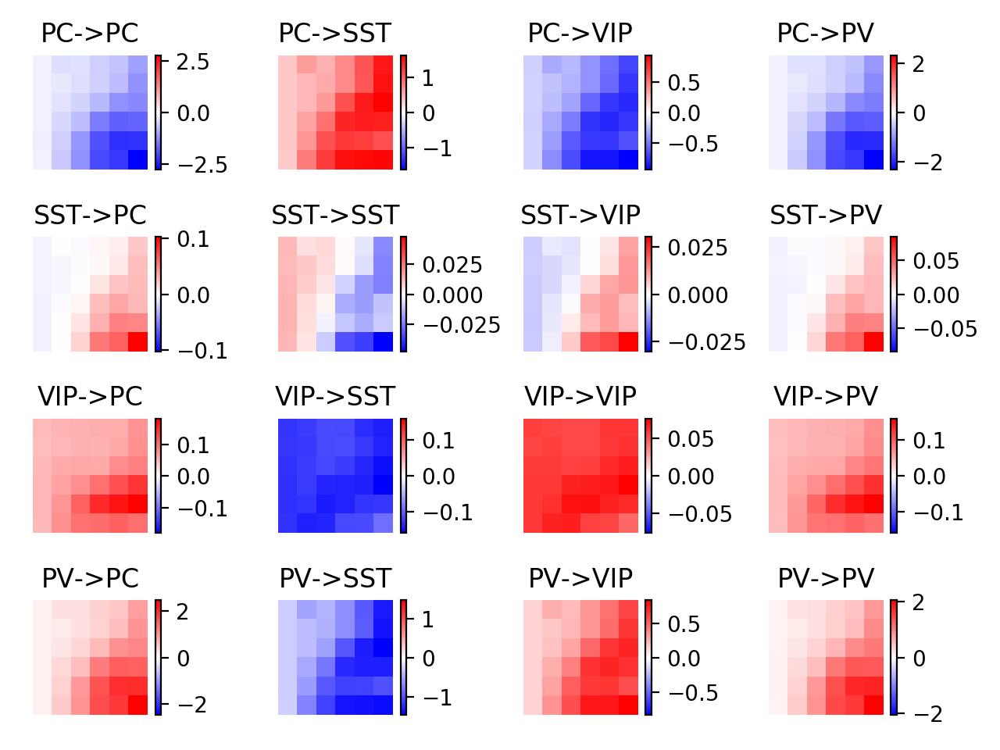

<IPython.core.display.Javascript object>


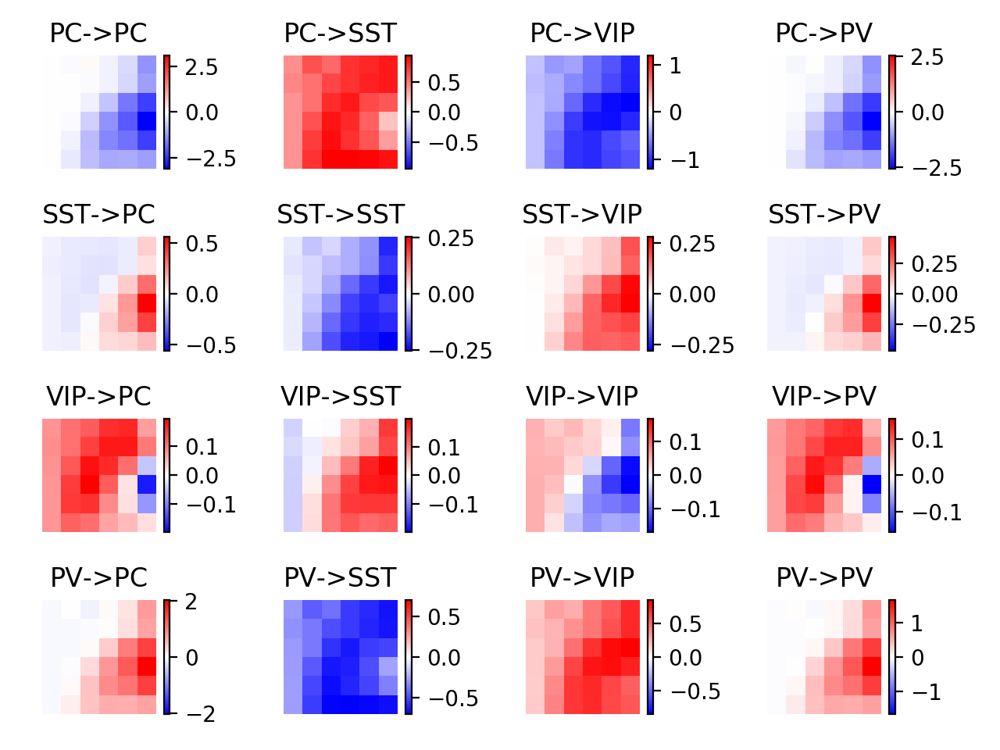

<IPython.core.display.Javascript object>


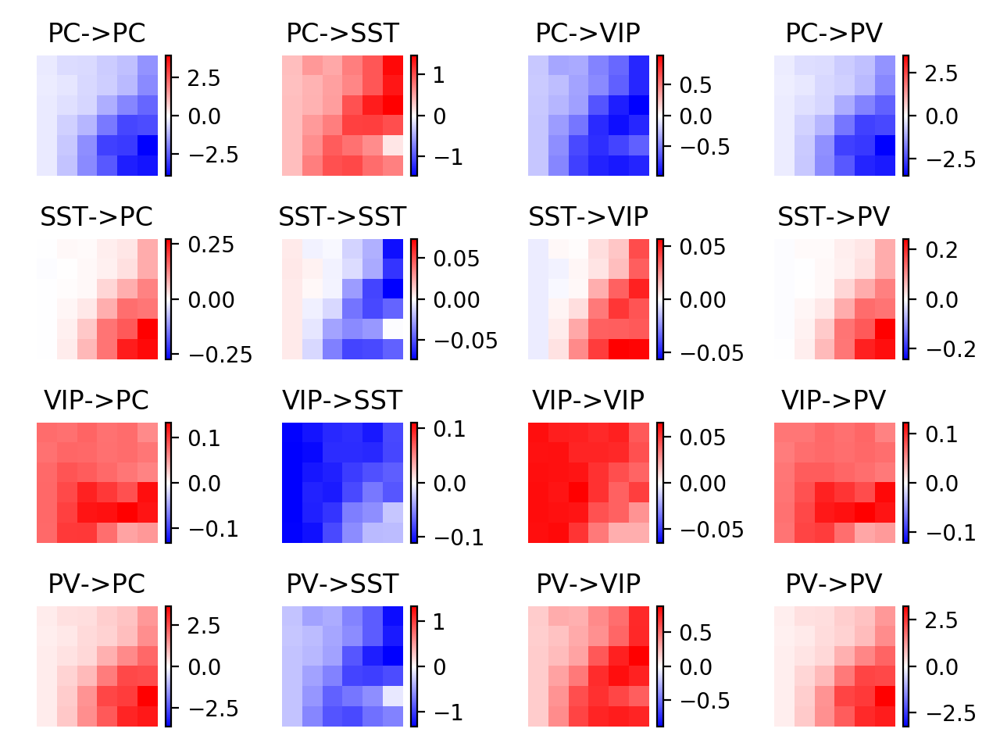

<IPython.core.display.Javascript object>


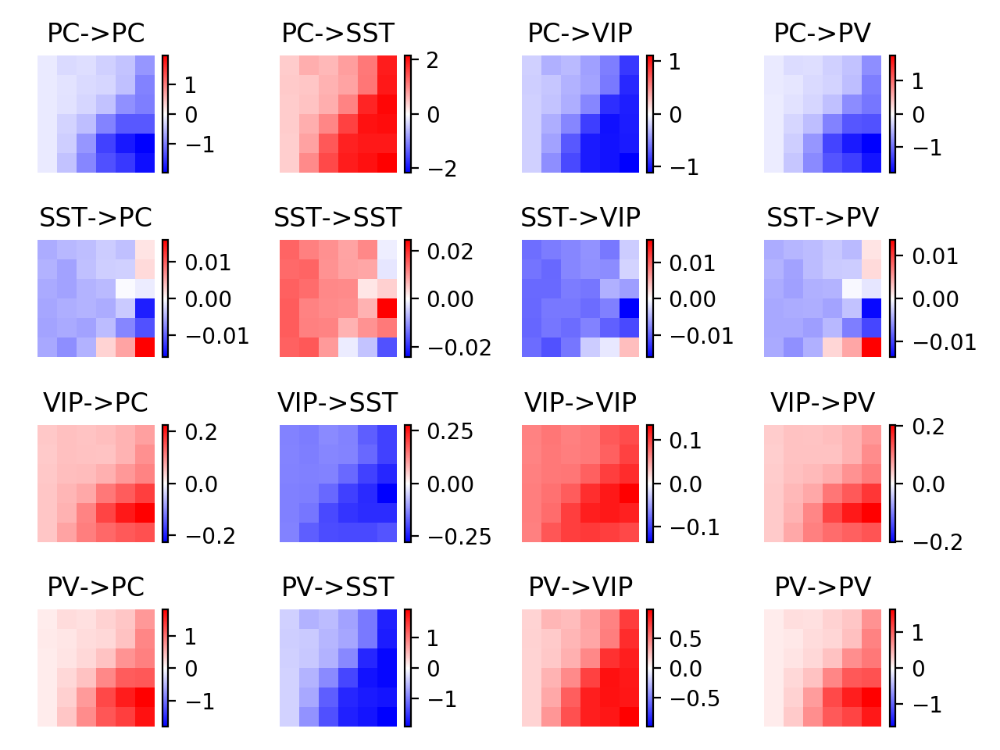

<IPython.core.display.Javascript object>


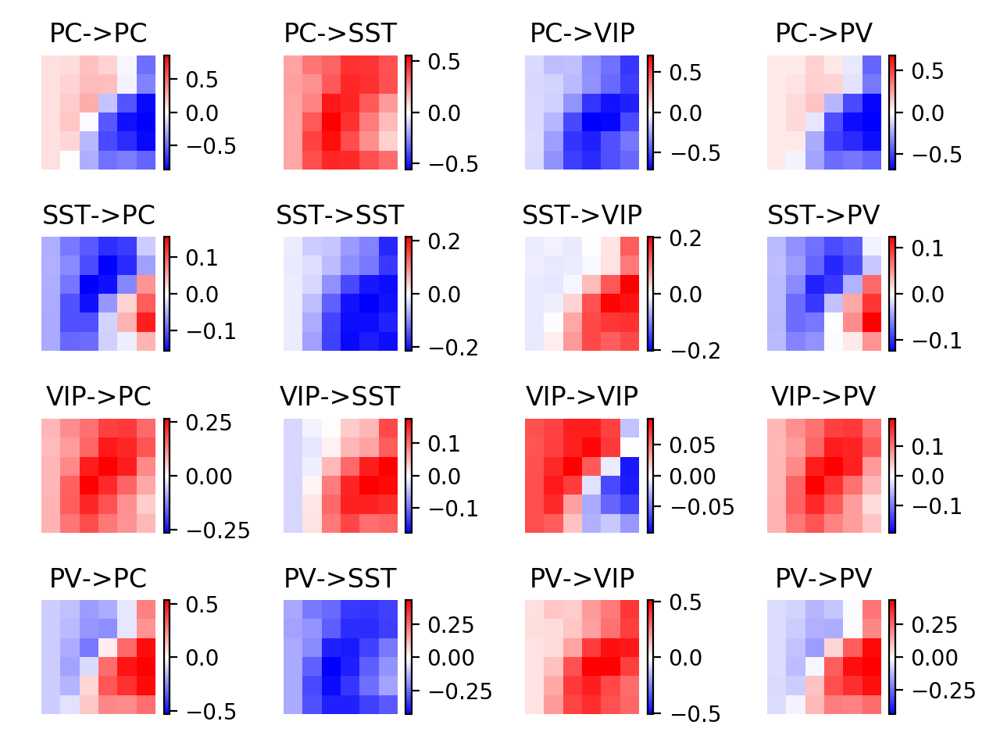

<IPython.core.display.Javascript object>


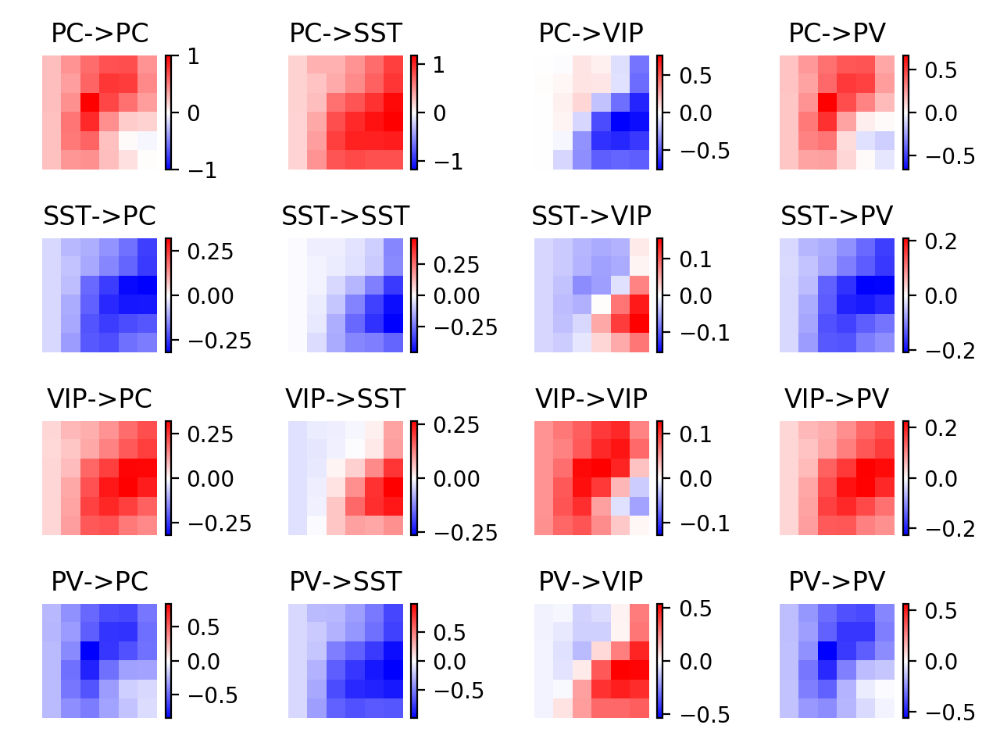

<IPython.core.display.Javascript object>


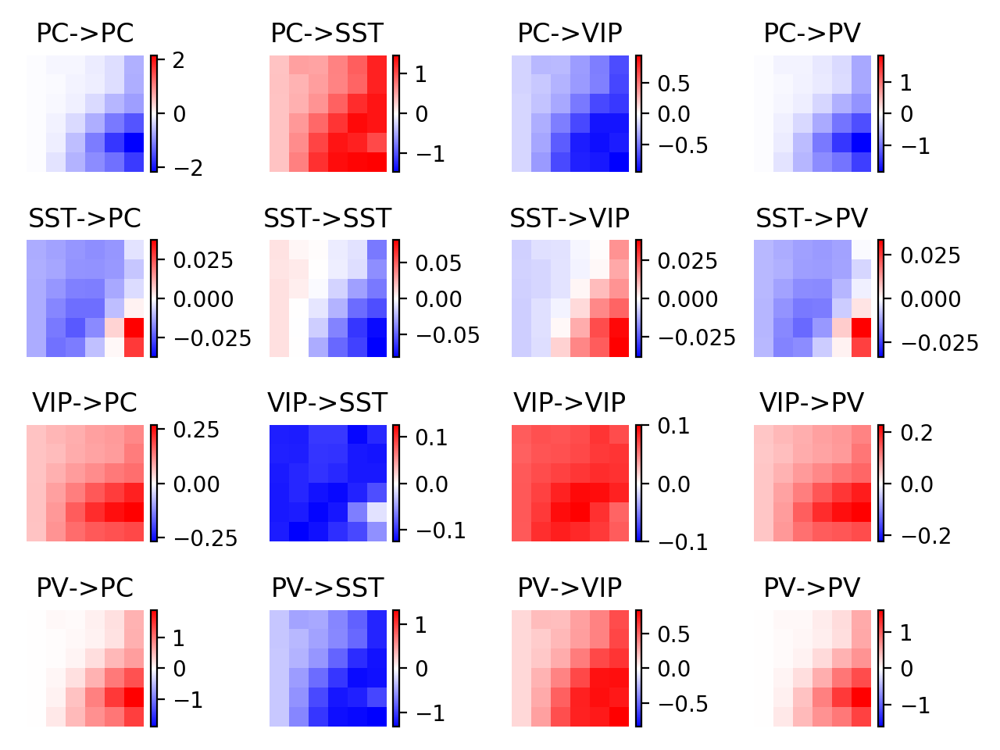

<IPython.core.display.Javascript object>


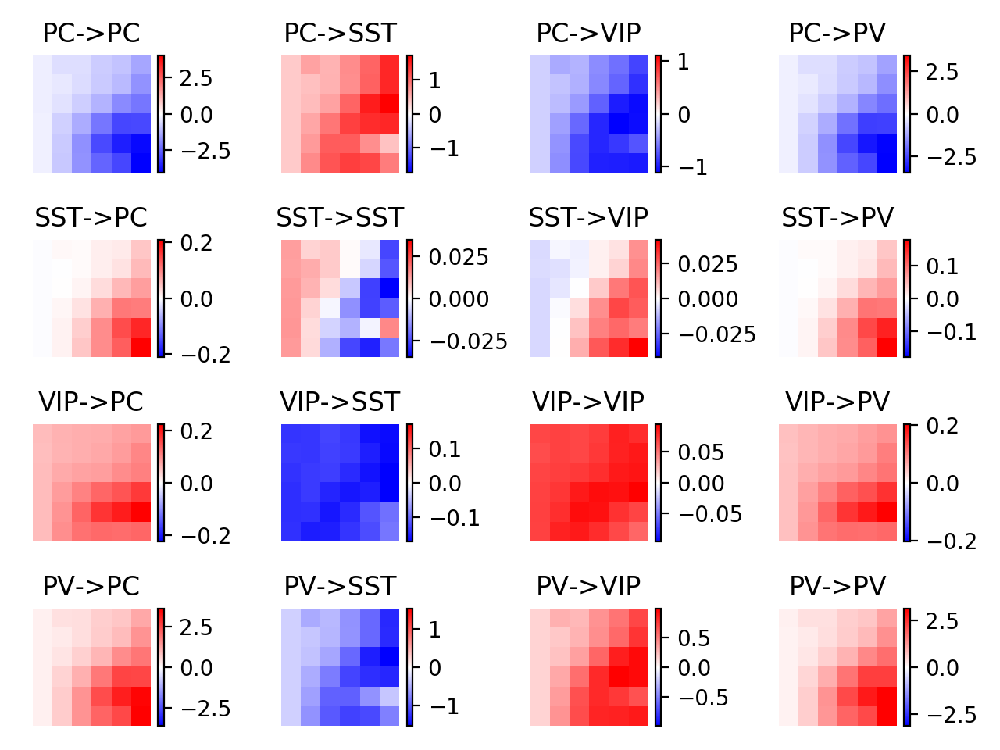

<IPython.core.display.Javascript object>


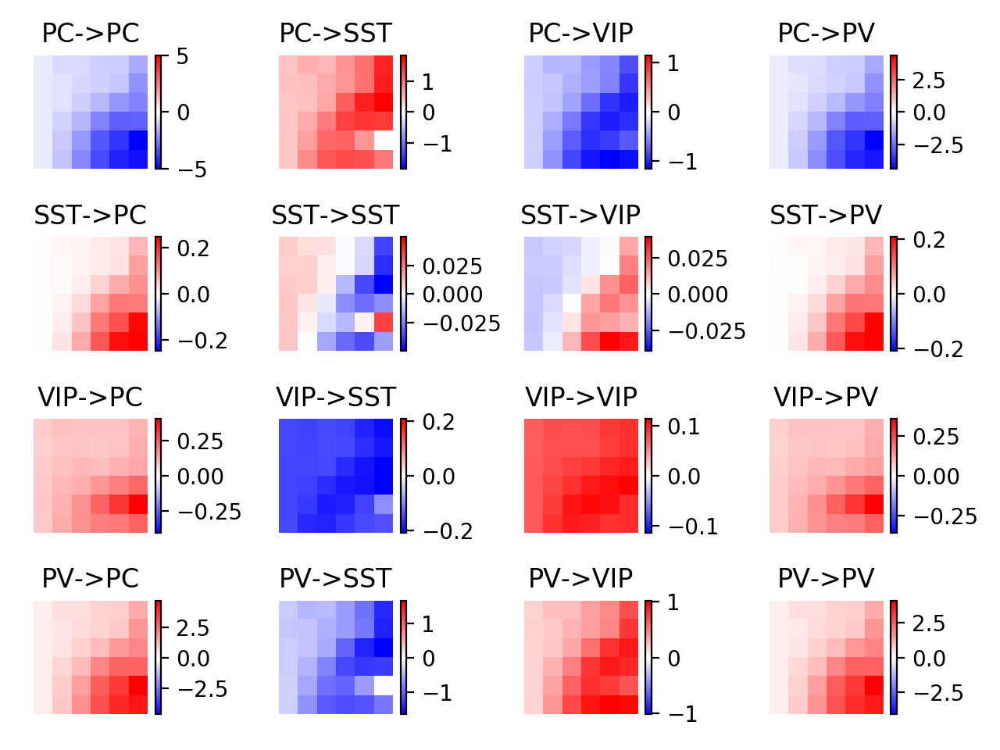

<IPython.core.display.Javascript object>


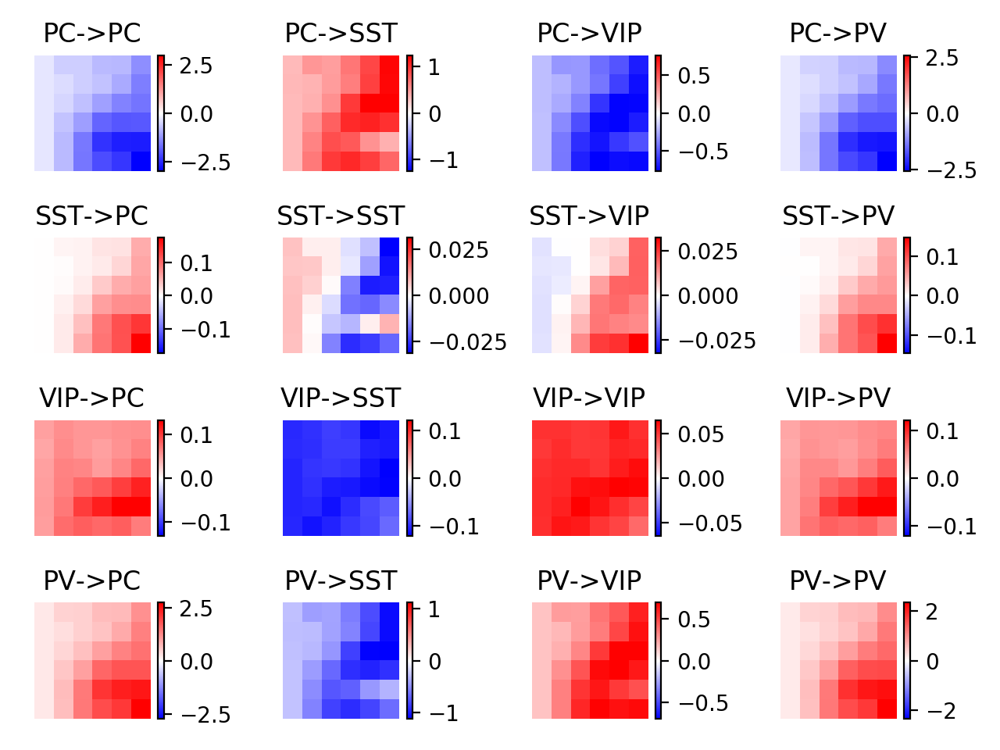

<IPython.core.display.Javascript object>


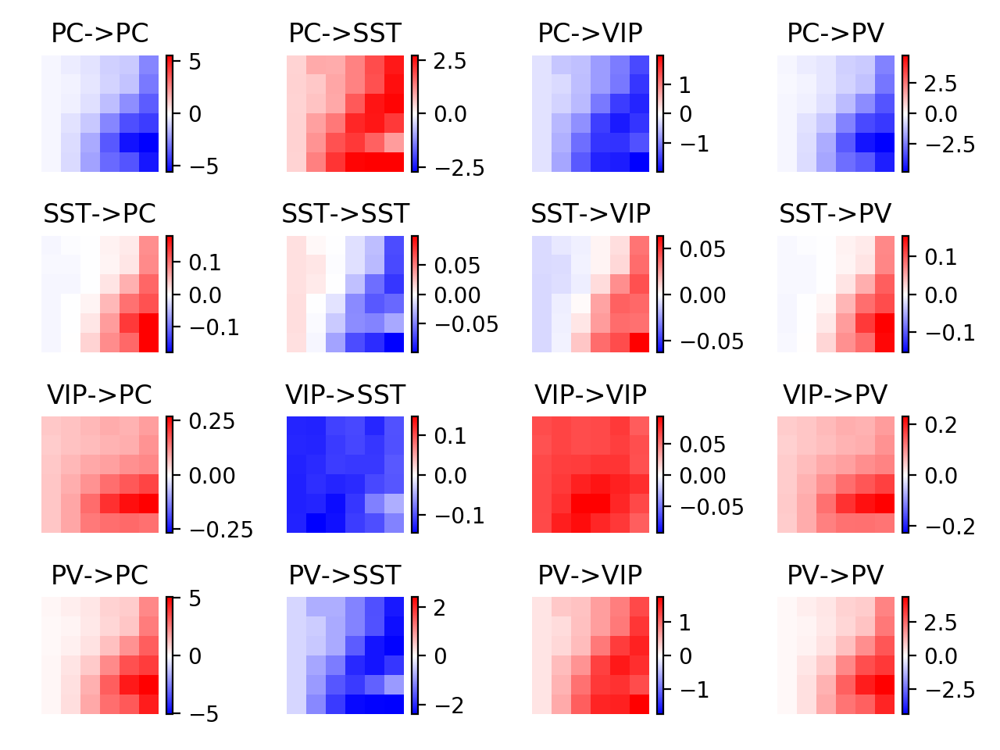

<IPython.core.display.Javascript object>


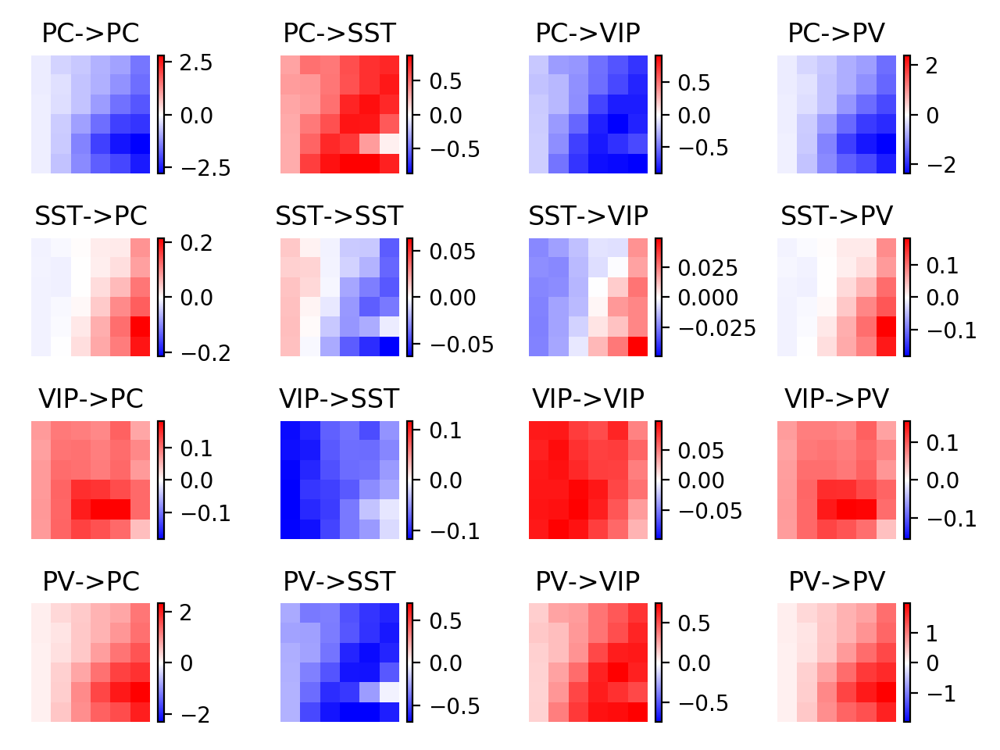

<IPython.core.display.Javascript object>


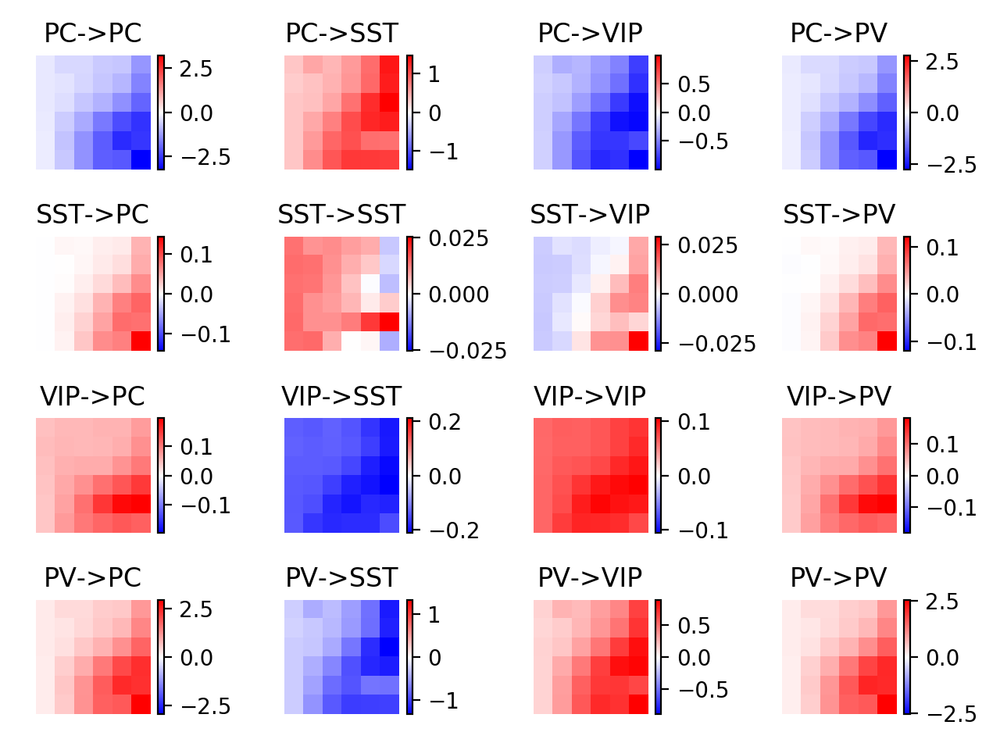

<IPython.core.display.Javascript object>


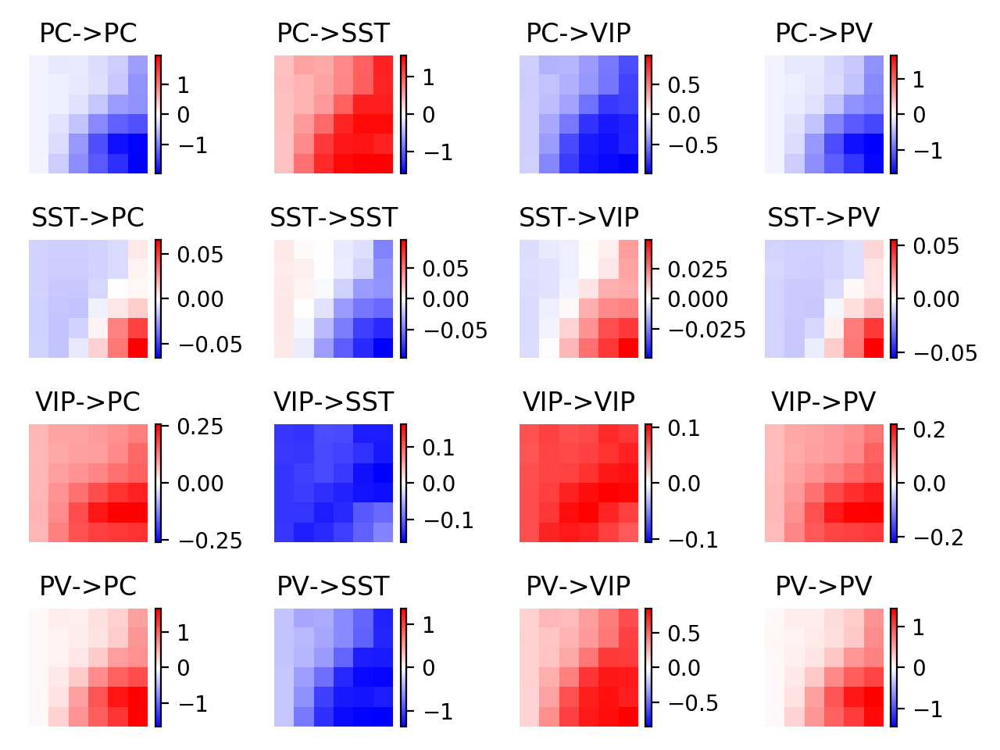

<IPython.core.display.Javascript object>


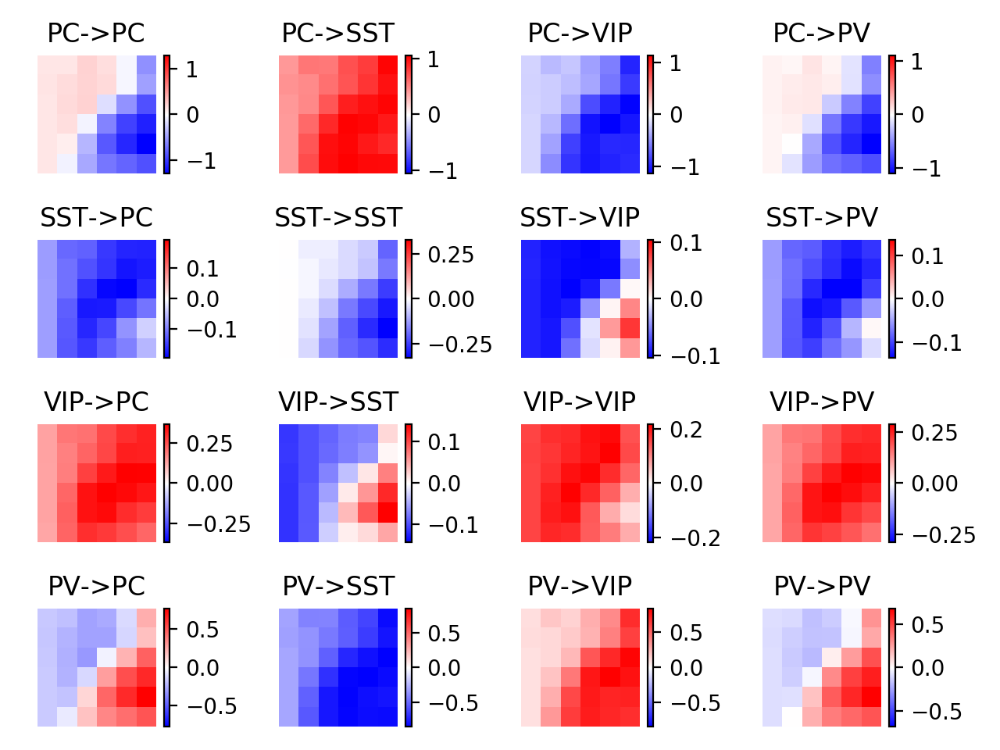

<IPython.core.display.Javascript object>


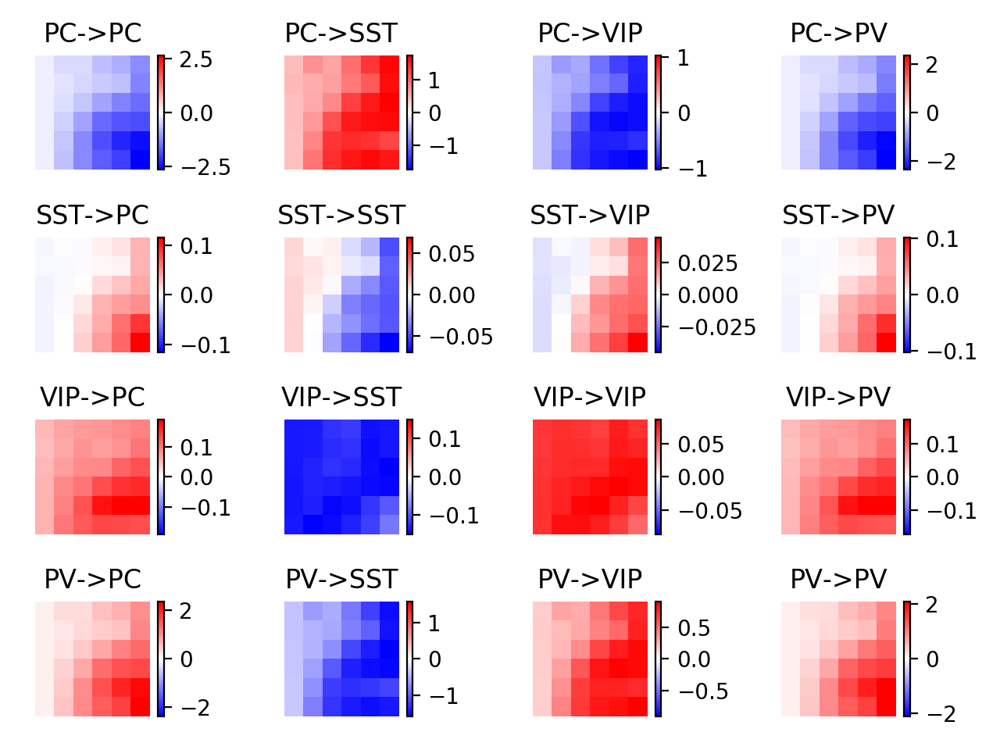

<IPython.core.display.Javascript object>


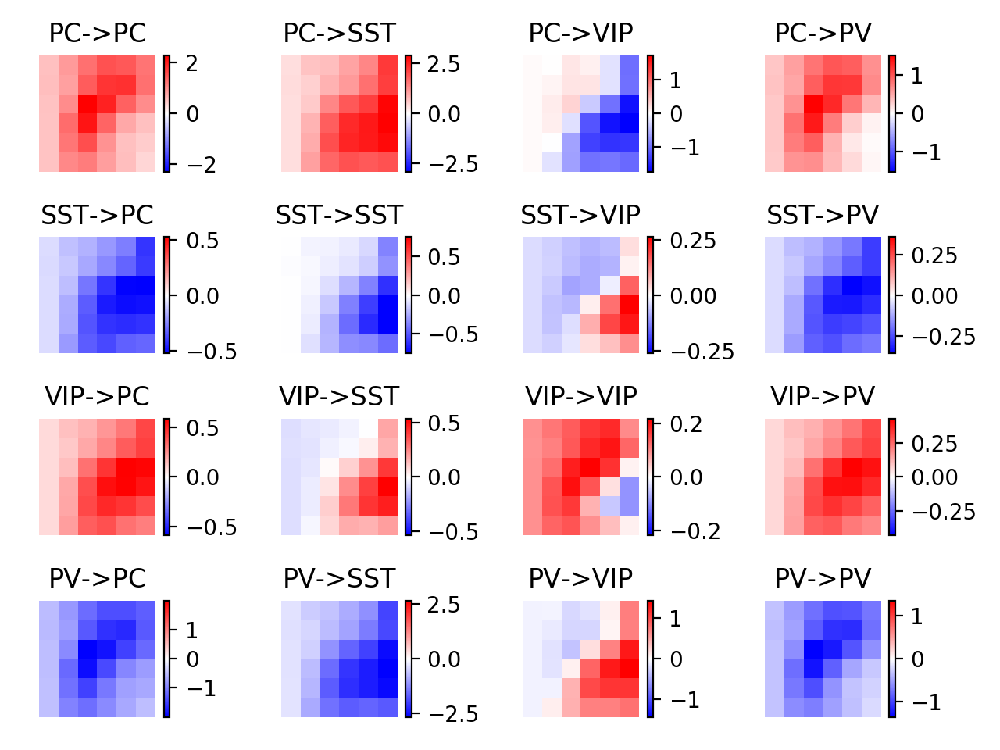

<IPython.core.display.Javascript object>


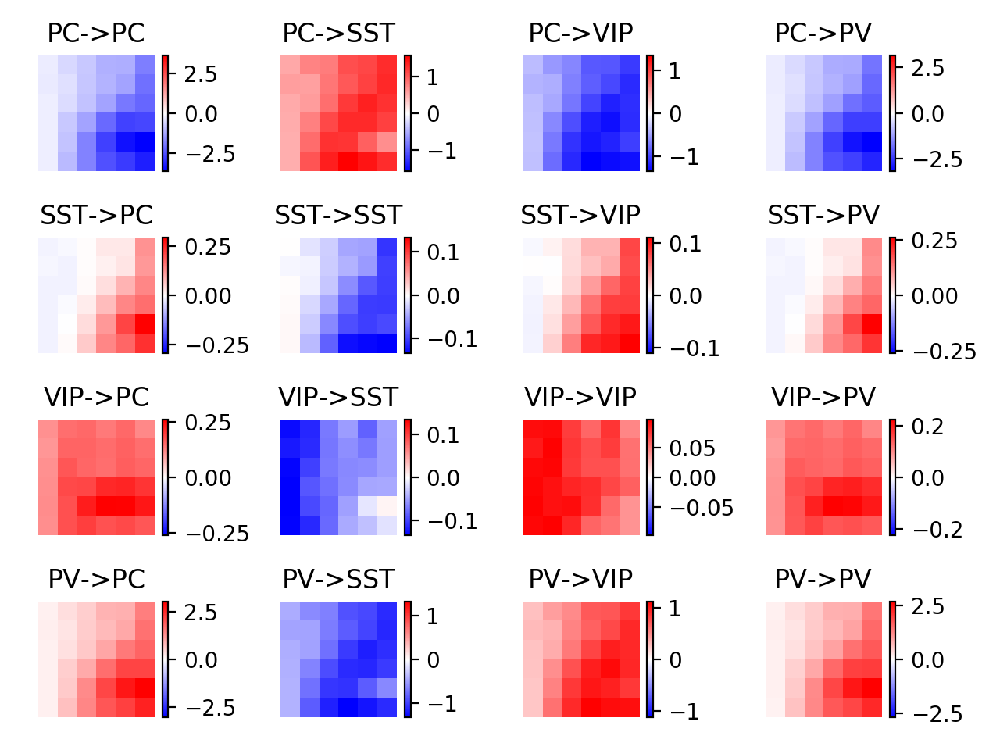

<IPython.core.display.Javascript object>


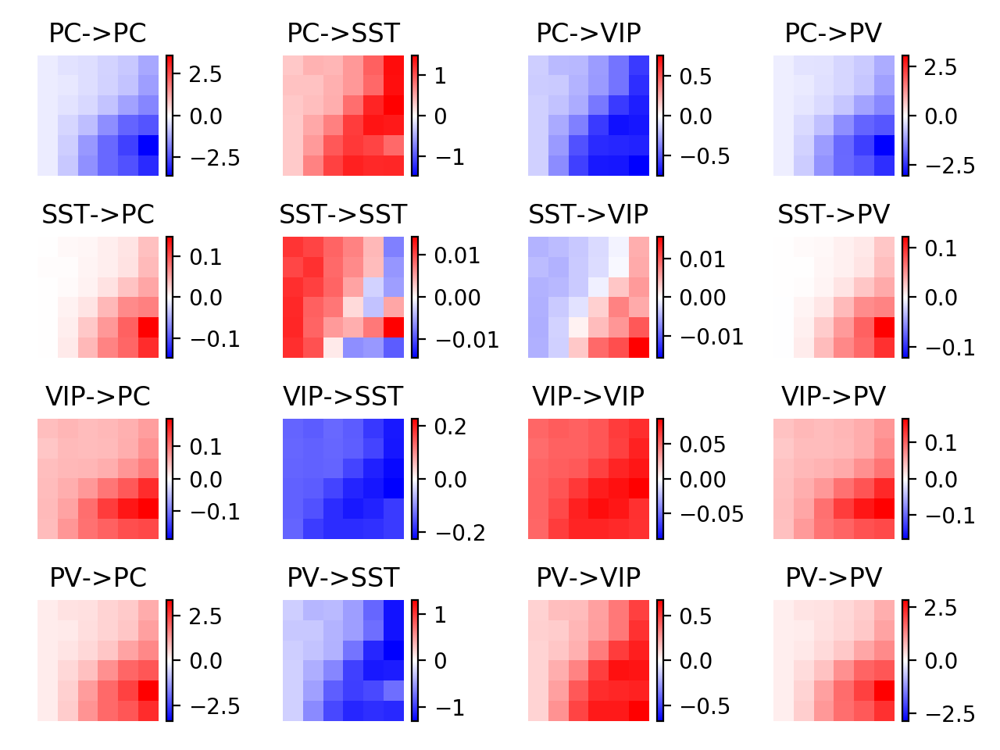

<IPython.core.display.Javascript object>


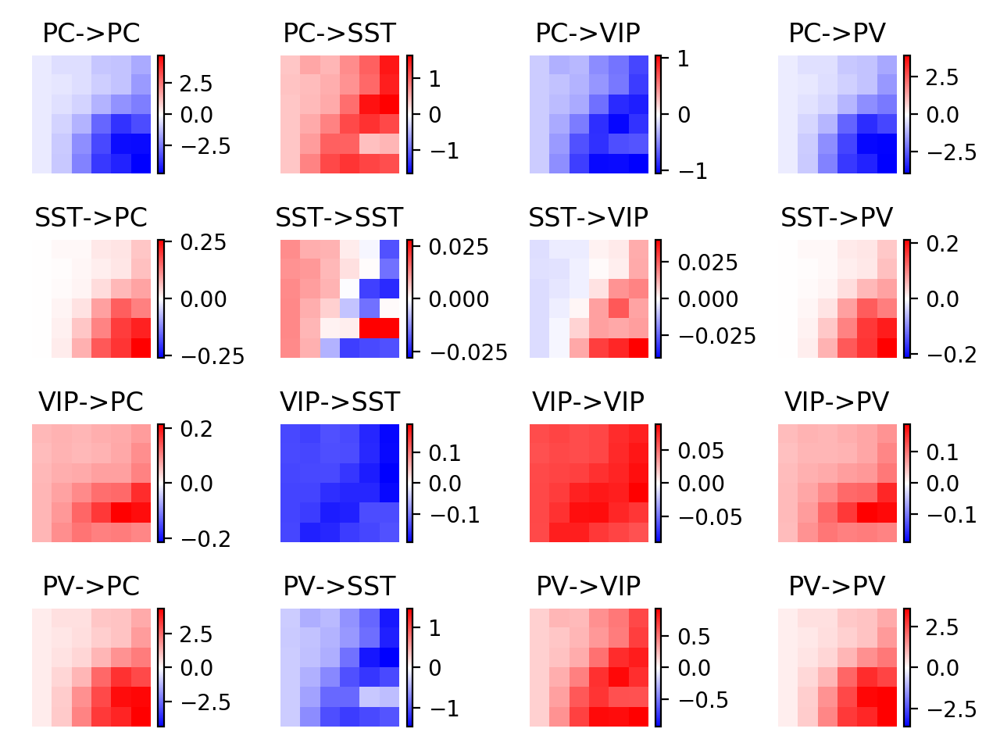

<IPython.core.display.Javascript object>


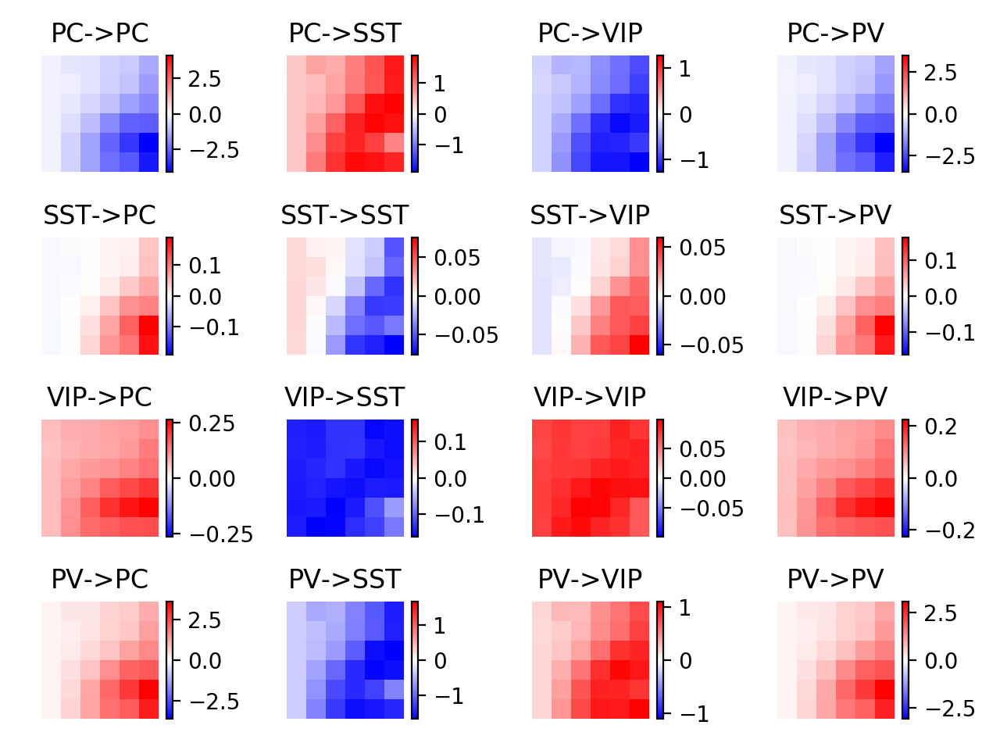

In [74]:
lbls = ['PC','SST','VIP','PV']
for iwt in range(len(weights_files)):
    plt.figure()
    for i1 in range(4):
        for i2 in range(4):
            plt.subplot(4,4,4*i1+i2+1)
            data = couplings[iwt][:,:,8+i1,i2]
            plt.imshow(data,cmap='bwr',vmin=-np.abs(data).max(),vmax=np.abs(data).max())
            plt.colorbar()
            plt.axis('off')
            plt.title('%s->%s'%(lbls[i1],lbls[i2]))
    plt.tight_layout()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


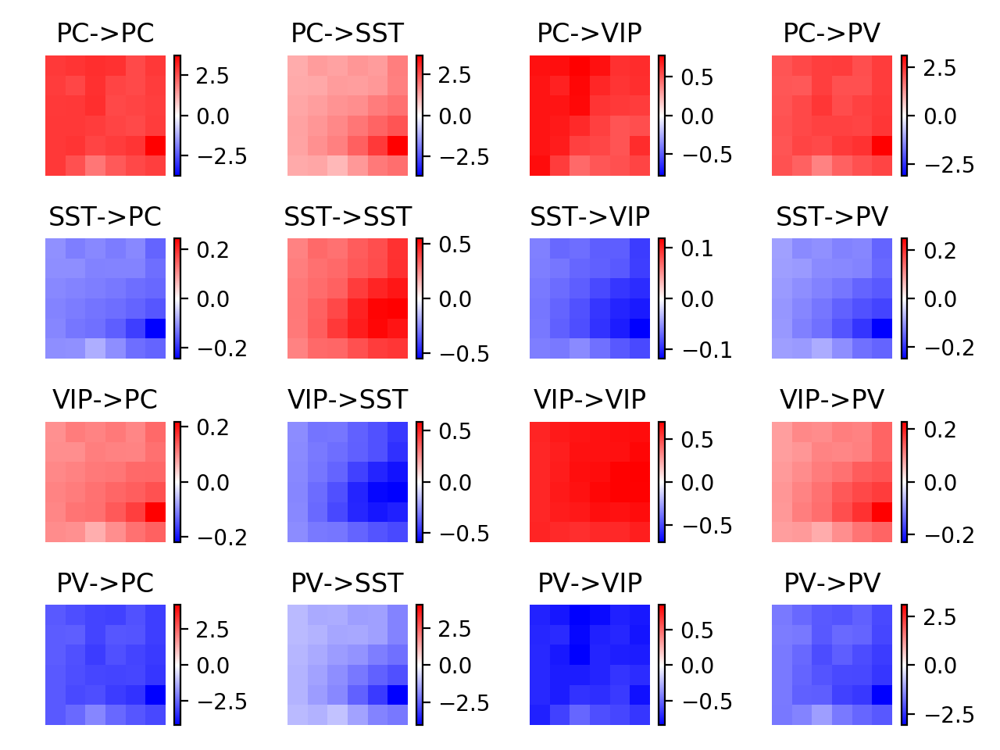

<IPython.core.display.Javascript object>


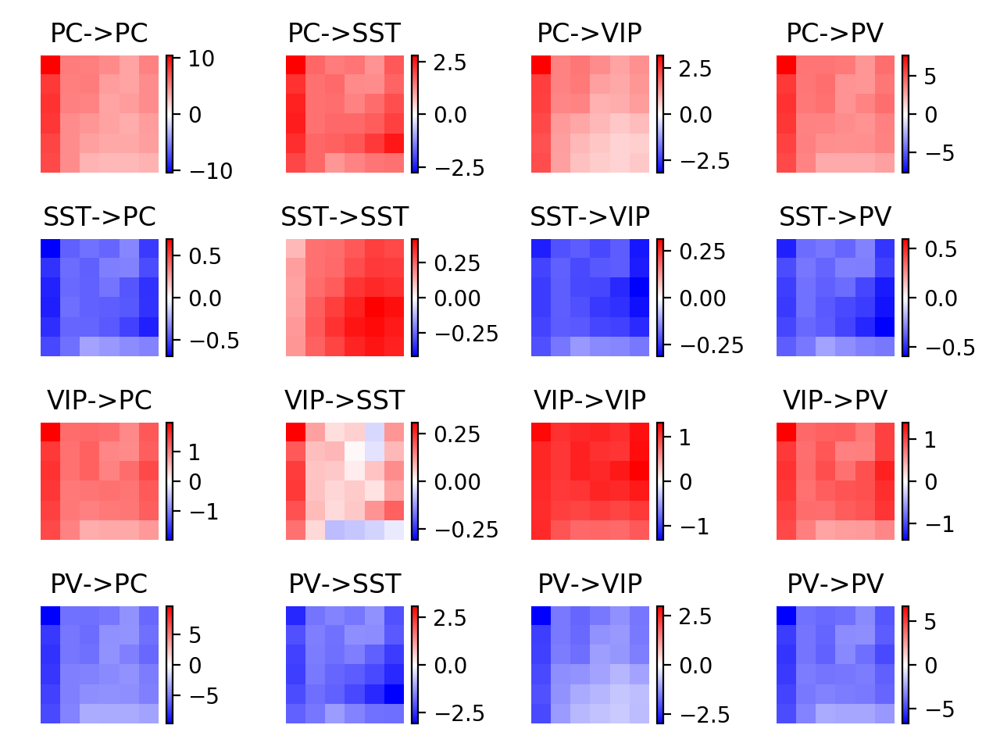

<IPython.core.display.Javascript object>


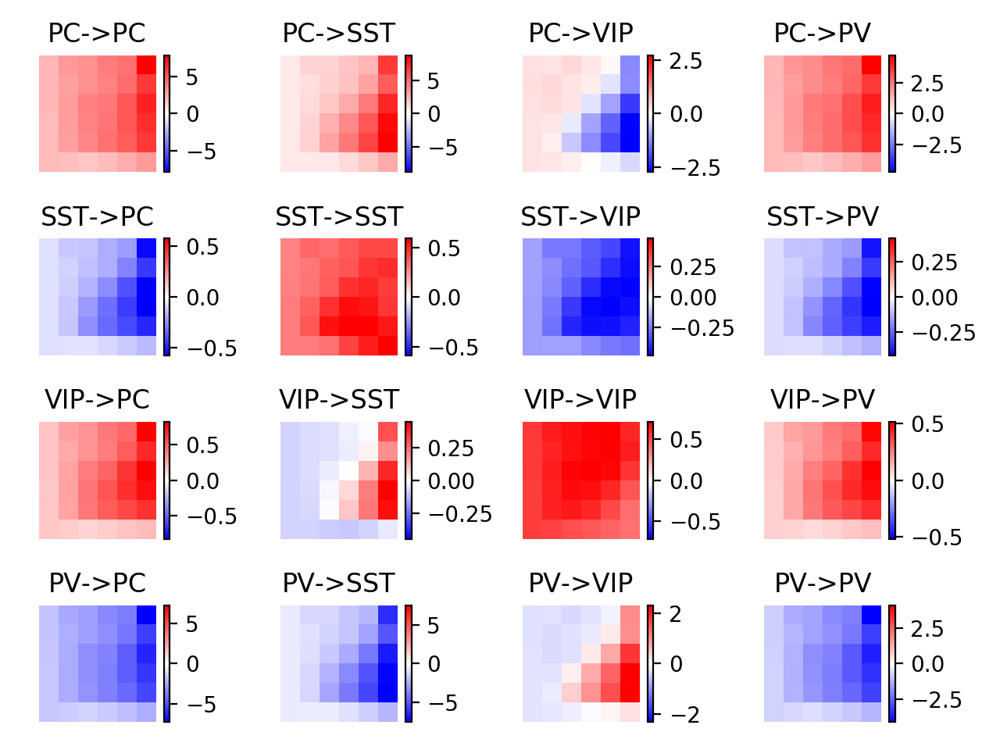

<IPython.core.display.Javascript object>


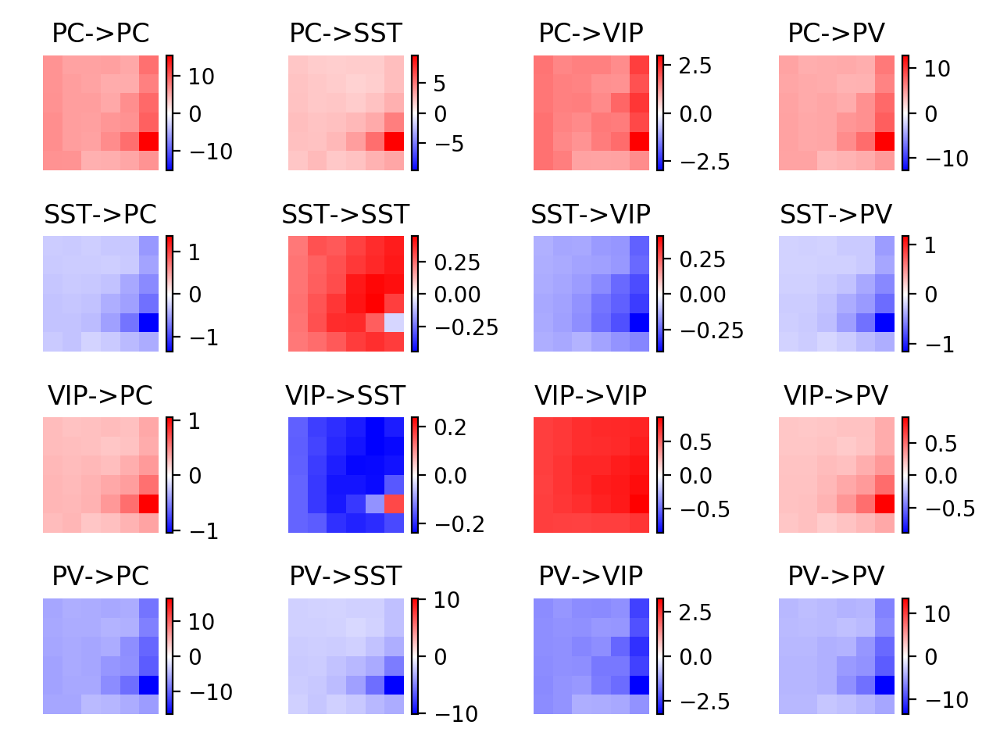

<IPython.core.display.Javascript object>


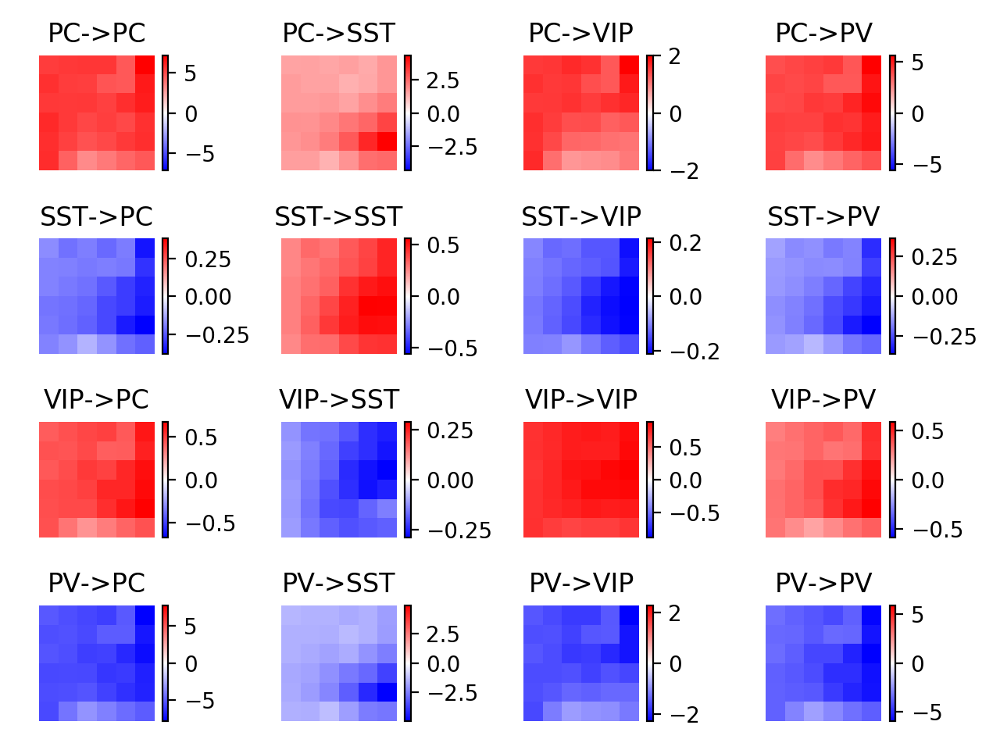

<IPython.core.display.Javascript object>


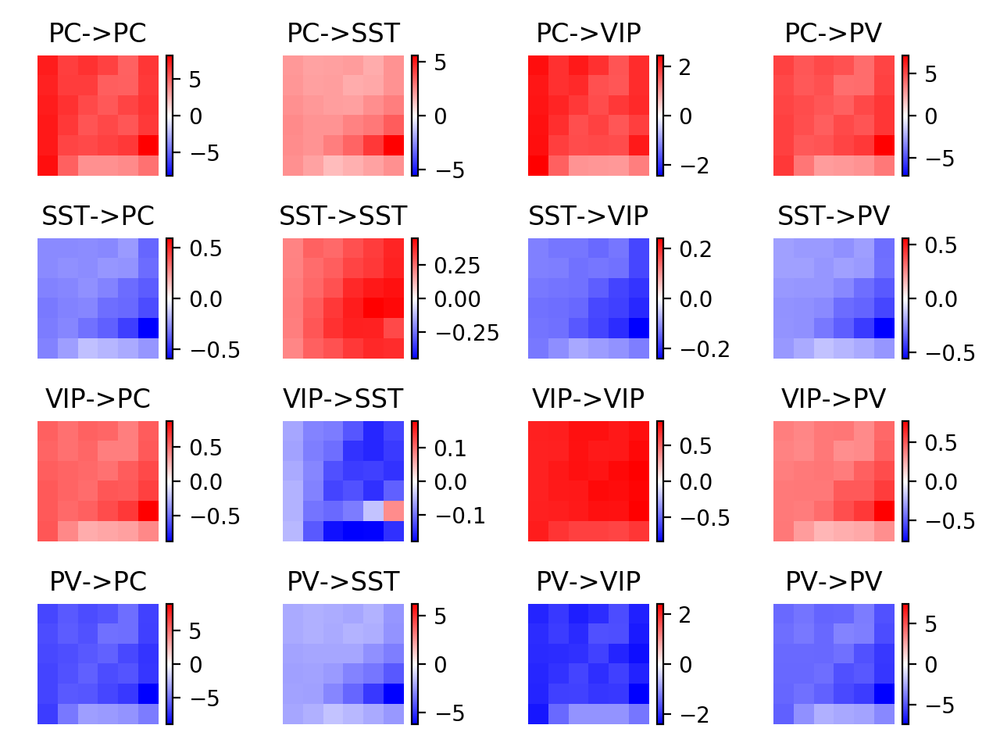

<IPython.core.display.Javascript object>


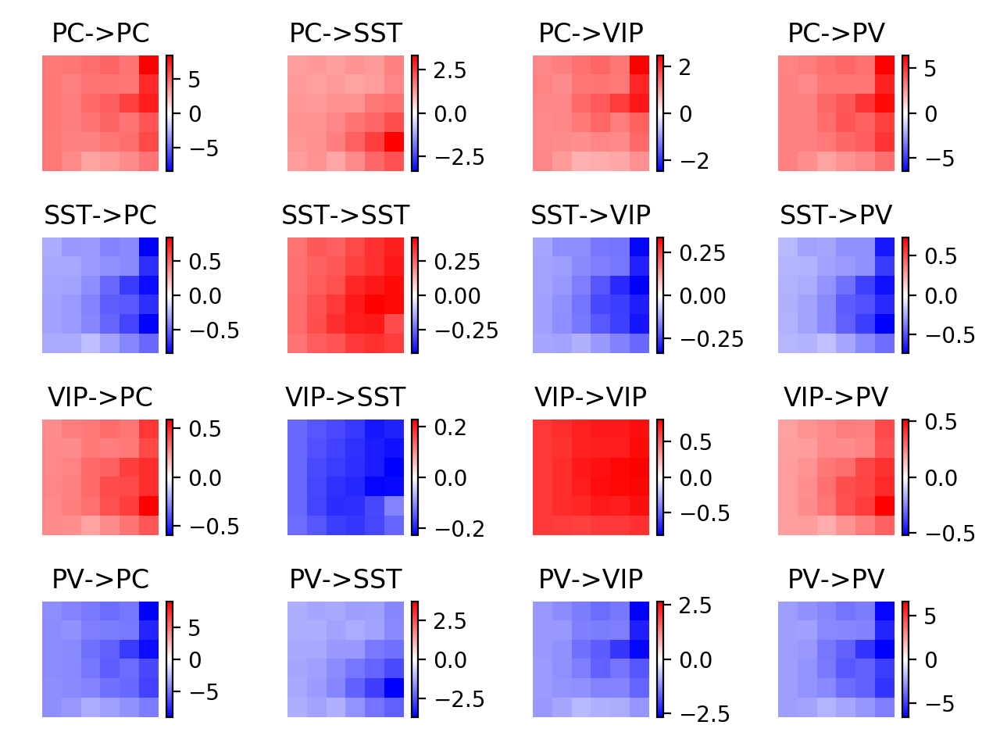

<IPython.core.display.Javascript object>


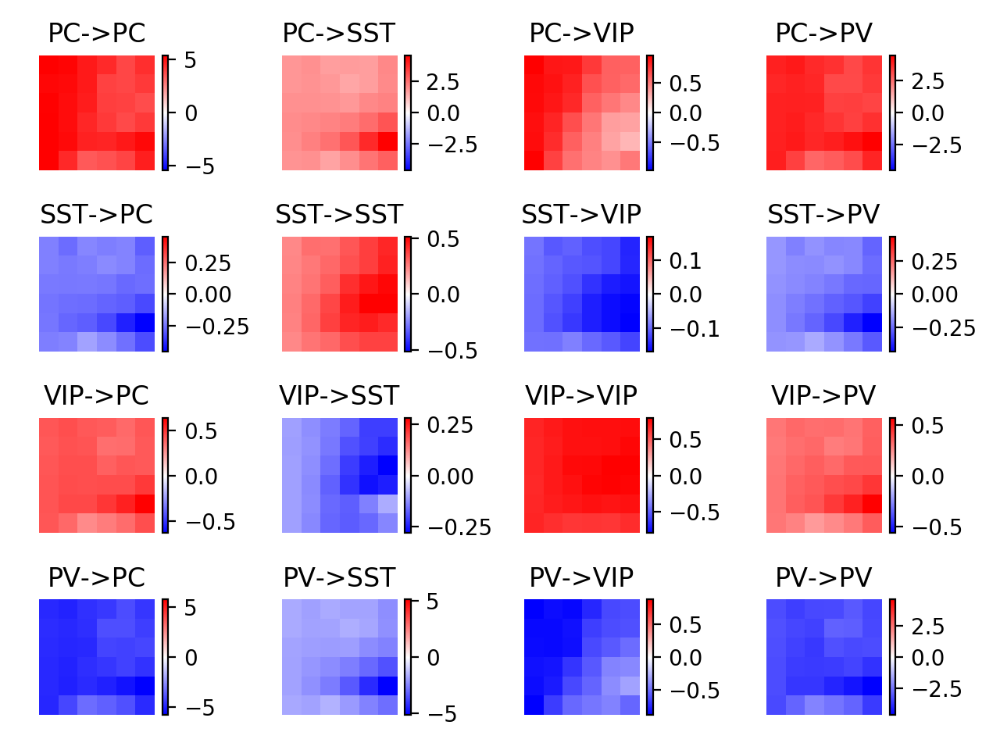

<IPython.core.display.Javascript object>


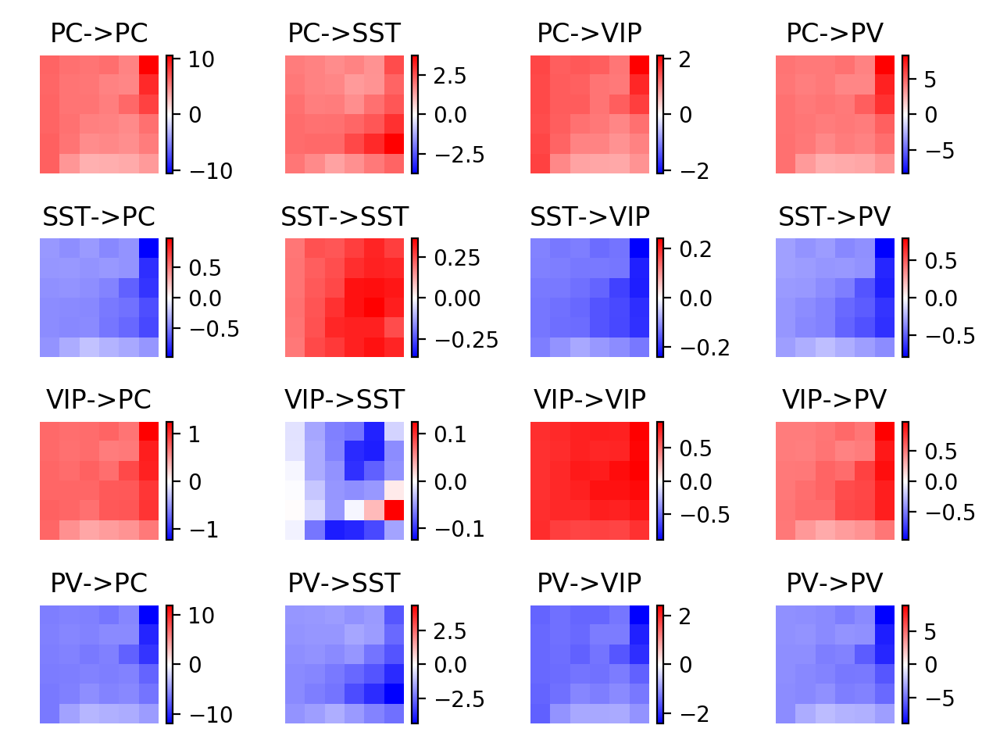

In [988]:
lbls = ['PC','SST','VIP','PV']
for iwt in range(len(weights_files)):
    plt.figure()
    for i1 in range(4):
        for i2 in range(4):
            plt.subplot(4,4,4*i1+i2+1)
            data = couplings[iwt][:,:,i1,i2]
            plt.imshow(data,cmap='bwr',vmin=-np.abs(data).max(),vmax=np.abs(data).max())
            plt.colorbar()
            plt.axis('off')
            plt.title('%s->%s'%(lbls[i1],lbls[i2]))
    plt.tight_layout()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


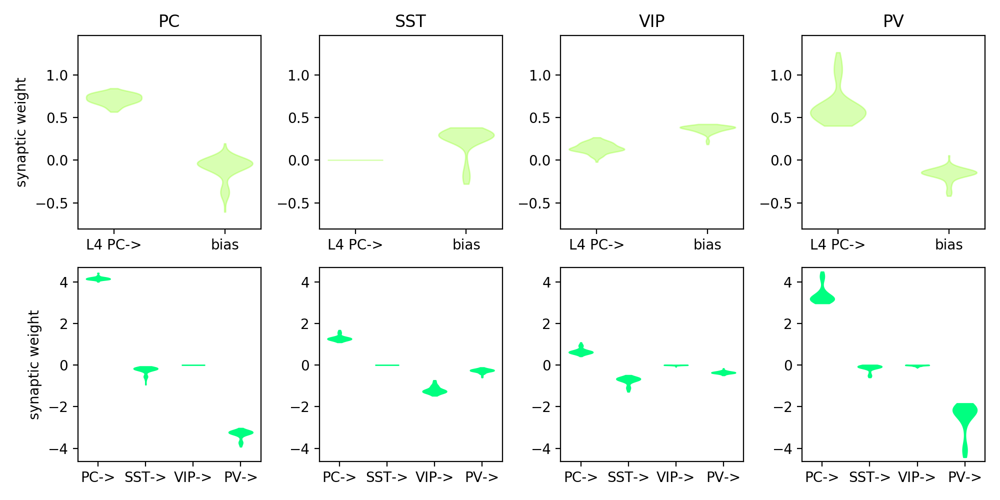

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:33: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:35: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


In [311]:
# ws = [np.concatenate([w[q][np.newaxis] for w in np.concatenate(Wt)],axis=0) for q in range(len(Wt[0][0]))]
# [Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,YY,Eta,Xi] = ws
plt.figure(figsize=(10,5))
for datas in [[Wmxs,Wmys]]:#,[Wsx,Wsy]]:
    titles = ['PC','SST','VIP','PV']
    data = datas[0]
    x = np.arange(1,data.shape[1]+1)
    xlbl = ['L4 PC->','bias']
    for icelltype in range(nQ):
        plt.subplot(2,nQ,icelltype+1)
        violin_parts = plt.violinplot([data[:,i,icelltype] for i in range(data.shape[1])],showextrema=False)
        for pc in violin_parts['bodies']:
            pc.set_facecolor([0.5,1,0.0])
            pc.set_edgecolor([0.5,1,0.0])
        plt.xticks(x,xlbl)
        plt.ylim(data.min()-0.2,data.max()+0.2)
        plt.title(titles[icelltype])
#     plt.figure(figsize=(7.5,2))
    data = datas[1]
    x = np.arange(1,data.shape[1]+1)
    xlbl = ['PC->','SST->','VIP->','PV->']
    for icelltype in range(nQ):
        plt.subplot(2,nQ,nQ+icelltype+1)
#         plt.violinplot([data[:,i,icelltype] for i in range(data.shape[1])])
        violin_parts = plt.violinplot([data[:,i,icelltype] for i in range(data.shape[1])],showextrema=False)
        for pc in violin_parts['bodies']:
            pc.set_facecolor([0.0,1,0.5])
            pc.set_edgecolor([0.0,1,0.5])
            pc.set_alpha(1)
        plt.xticks(x,xlbl)
        plt.ylim(data.min()-0.2,data.max()+0.2)
#         plt.title(titles[icelltype])
    plt.subplot(2,4,1)
    plt.ylabel('synaptic weight')
    plt.subplot(2,4,5)
    plt.ylabel('synaptic weight')
    plt.tight_layout()
plt.savefig('figures/violinplots_fit_weights.jpg',dpi=300)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


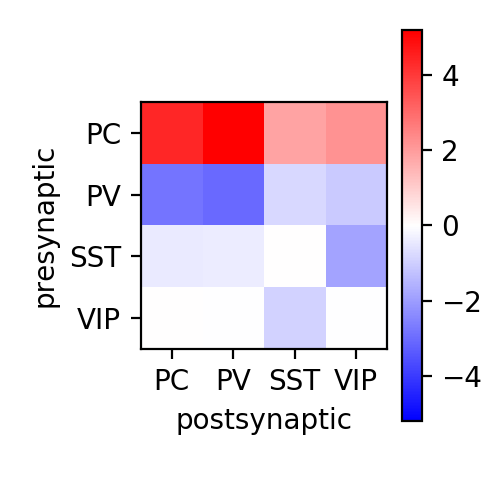

In [822]:
disp_order = [0,3,1,2]
plt.figure(figsize=(2.5,2.5))
data = np.mean(Wmys[ifit][low_loss[ifit]],0)[disp_order][:,disp_order]
mx = np.max(np.abs(data))
plt.imshow(data,cmap='bwr',vmin=-mx,vmax=mx)
plt.xticks(np.arange(4),[lbls[i] for i in disp_order])
plt.yticks(np.arange(4),[lbls[i] for i in disp_order])
plt.ylim(3.5,-0.5)
plt.colorbar()
plt.xlabel('postsynaptic')
plt.ylabel('presynaptic')
plt.tight_layout()
# plt.savefig('figures/Wmy_heatmap.eps')

In [831]:
np.mean(Wmys[ifit][low_loss[ifit]],0)[disp_order][:,disp_order].shape

(4, 4)

In [833]:
np.mean(Wmxs[ifit][low_loss[ifit]],0)[0:1].shape

(1, 4)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


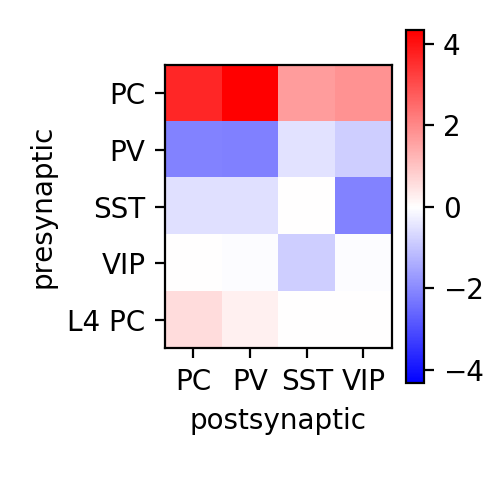

In [937]:
plt.figure(figsize=(2.5,2.5))
data = np.concatenate((np.mean(Wmys[ifit][low_loss[ifit]],0)[disp_order][:,disp_order],np.mean(Wmxs[ifit][low_loss[ifit]],0)[0:1][:,disp_order]),axis=0)
mx = np.max(np.abs(data))
plt.imshow(data,cmap='bwr',vmin=-mx,vmax=mx)
plt.xticks(np.arange(4),[lbls[i] for i in disp_order])
plt.yticks(np.arange(5),[lbls[i] for i in disp_order]+['L4 PC'])
plt.ylim(4.5,-0.5)
plt.colorbar()
plt.xlabel('postsynaptic')
plt.ylabel('presynaptic')
plt.tight_layout()
plt.savefig('figures/Wmy_extended_heatmap_no_opto.jpg',dpi=300)

In [829]:
plt.close('all')

In [942]:
np.mean(Wmys[ifit][low_loss[ifit]],0).shape

(4, 4)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


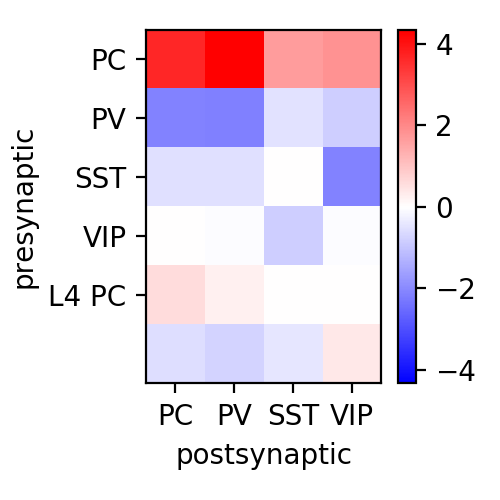

In [945]:
plt.figure(figsize=(2.5,2.5))
data = np.concatenate((np.mean(Wmys[ifit][low_loss[ifit]],0)[disp_order][:,disp_order],np.mean(Wmxs[ifit][low_loss[ifit]],0)[:,disp_order]),axis=0)
mx = np.max(np.abs(data))
plt.imshow(data,cmap='bwr',vmin=-mx,vmax=mx)
plt.xticks(np.arange(4),[lbls[i] for i in disp_order])
plt.yticks(np.arange(5),[lbls[i] for i in disp_order]+['L4 PC'])
plt.ylim(5.5,-0.5)
plt.colorbar()
plt.xlabel('postsynaptic')
plt.ylabel('presynaptic')
plt.tight_layout()
plt.savefig('figures/Wmy_very_extended_heatmap_no_opto.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


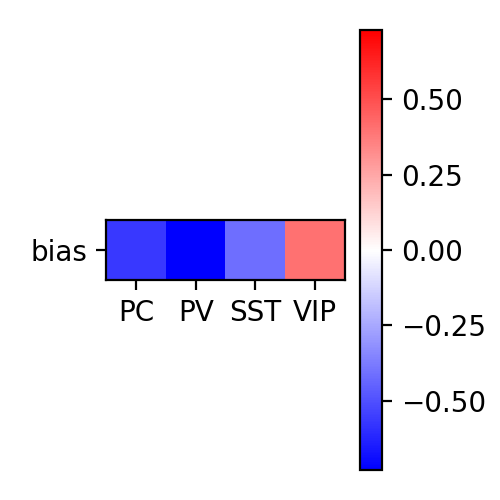

In [948]:
plt.figure(figsize=(2.5,2.5))
data = np.mean(Wmxs[ifit][low_loss[ifit]],0)[1:2][:,disp_order]
mx = np.max(np.abs(data))
plt.imshow(data,cmap='bwr',vmin=-mx,vmax=mx)
plt.xticks(np.arange(4),[lbls[i] for i in disp_order])
plt.yticks([0],['bias'])
plt.ylim(0.5,-0.5)
plt.colorbar()
# plt.xlabel('postsynaptic')
# plt.ylabel('presynaptic')
plt.tight_layout()
# plt.savefig('figures/bias_heatmap.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


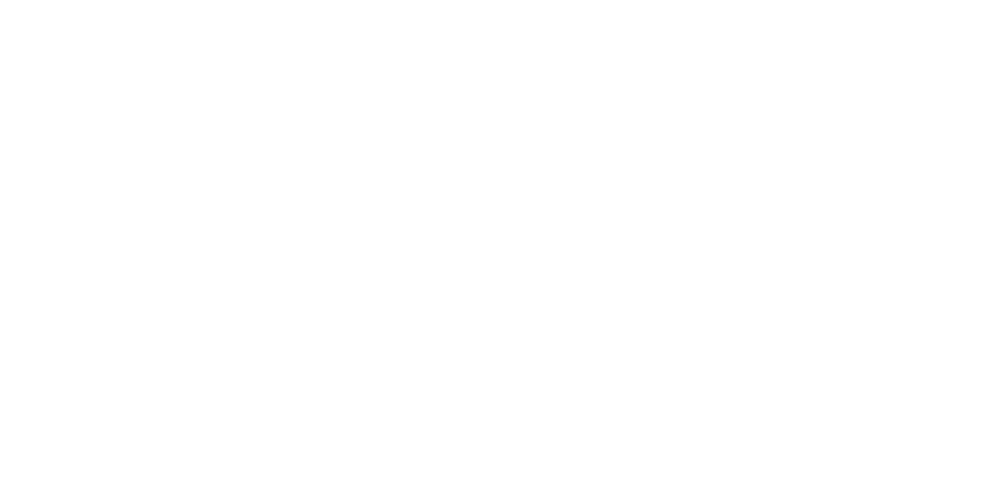

NameError: name 'Ts' is not defined

In [949]:
# ws = [np.concatenate([w[q][np.newaxis] for w in np.concatenate(Wt)],axis=0) for q in range(len(Wt[0][0]))]
# [Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,YY,Eta,Xi] = ws
plt.figure(figsize=(5,2.5))
ylbls = ['cross-space weight','cross-orientation weight']
colors = [[1,0.5,0.5],[0.5,0,0.5]]
for idata,data in enumerate([Ks,Ts]):#,[Wsx,Wsy]]:
#     titles = ['PC','SST','VIP','PV']
    x = np.arange(1,data.shape[1]+1)
    xlbl = ['L2/3 PC','SST','VIP','PV']
    plt.subplot(1,2,idata+1)
#     for icelltype in range(nQ)
#         plt.violinplot([data[:,i,icelltype] for i in range(data.shape[1])])
    violin_parts = plt.violinplot([data[:,icelltype] for icelltype in range(data.shape[1])],showextrema=False)
    for pc in violin_parts['bodies']:
        pc.set_facecolor(colors[idata])
        pc.set_edgecolor(colors[idata])
        pc.set_alpha(1)
    plt.xticks(x,xlbl)
    plt.ylim(data.min()-0.2,data.max()+0.2)
    plt.ylabel(ylbls[idata])
plt.tight_layout()
#         plt.title(titles[icelltype])
# plt.savefig('figures/violinplots_fit_k_t.jpg',dpi=300)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  import sys


<IPython.core.display.Javascript object>


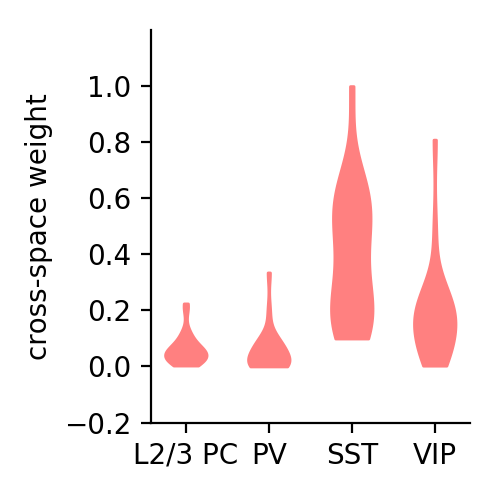

<IPython.core.display.Javascript object>


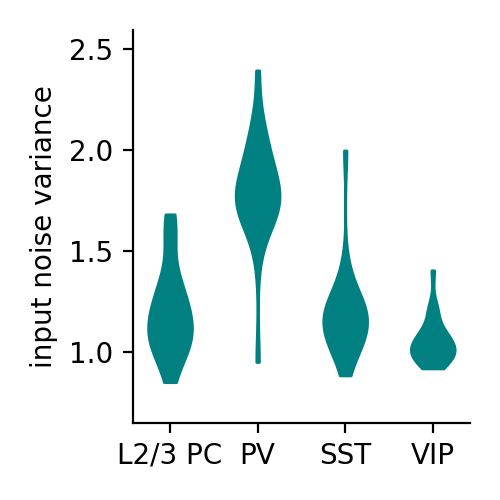

<IPython.core.display.Javascript object>


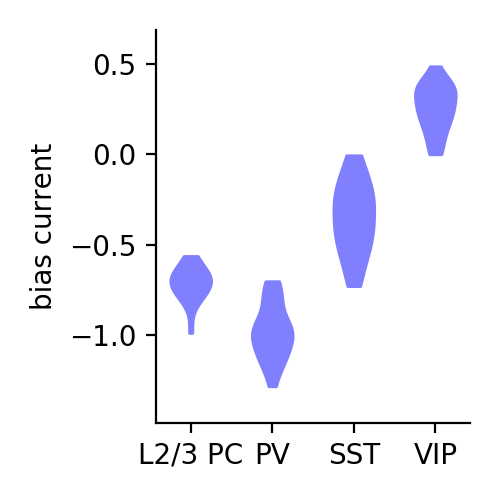

In [1014]:
# ws = [np.concatenate([w[q][np.newaxis] for w in np.concatenate(Wt)],axis=0) for q in range(len(Wt[0][0]))]
# [Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,YY,Eta,Xi] = ws
ylbls = ['cross-space weight','input noise variance','bias current']
titles = ['figures/violinplots_fit_k_pre_opto.jpg','figures/violinplots_fit_s02_pre_opto.jpg','figures/violinplots_fit_bias_pre_opto.jpg']
colors = [[1,0.5,0.5],[0,0.5,0.5],[0.5,0.5,1]]
for idata,data in enumerate([Ks[ifit][low_loss[ifit]][:,disp_order],s02s[ifit][low_loss[ifit]][:,disp_order],Wmxs[ifit][low_loss[ifit]][:,1,:][:,disp_order]]):#,[Wsx,Wsy]]:
    plt.figure(figsize=(2.5,2.5))
#     titles = ['PC','SST','VIP','PV']
    x = np.arange(1,data.shape[1]+1)
    xlbl = ['L2/3 PC','SST','VIP','PV']
    xlbl = [xlbl[i] for i in disp_order]
#     plt.subplot(1,2,idata+1)
#     for icelltype in range(nQ)
#         plt.violinplot([data[:,i,icelltype] for i in range(data.shape[1])])
    violin_parts = plt.violinplot([data[:,icelltype] for icelltype in range(data.shape[1])],showextrema=False)
    for pc in violin_parts['bodies']:
        pc.set_facecolor(colors[idata])
        pc.set_edgecolor(colors[idata])
        pc.set_alpha(1)
    plt.xticks(x,xlbl)
    plt.ylim(data.min()-0.2,data.max()+0.2)
    plt.ylabel(ylbls[idata])
    plt.tight_layout()
    #         plt.title(titles[icelltype])
    ut.erase_top_right()
    plt.savefig(titles[idata],dpi=300)


In [902]:
Ks[ifit][low_loss[ifit]][:,disp_order].shape

(39, 4)

In [901]:
Wmxs[ifit][low_loss[ifit]][:,1,:]

[0, 3, 1, 2]

In [779]:
iwt = 5
i1,i2 = 0,0
# data = couplings[iwt][:,8+i1,i2].reshape((6,6))
data = np.nanmean(couplings[:,:,:,8+i1,i2],0)
mx = np.max(np.abs(data))
plt.figure(figsize=(2.5,2.5))
sca.show_size_contrast(data,cmap='bwr',vmin=-mx,vmax=mx,flipud=True)
plt.title('far PC -> near PC coupling')
plt.colorbar()
# plt.savefig('figures/far_pc_near_pc_coupling_tuning.eps')


IndexError: index 8 is out of bounds for axis 3 with size 8

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


<IPython.core.display.Javascript object>


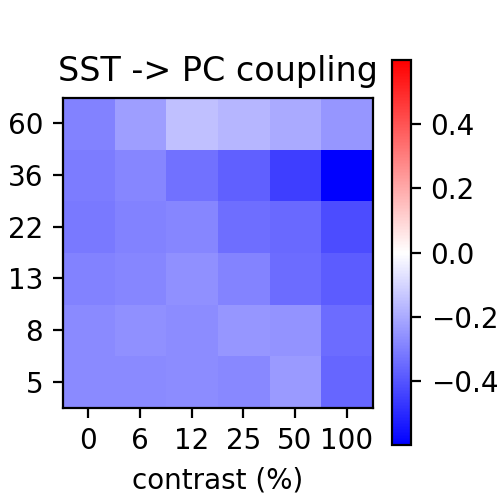

In [987]:
iwt = 5
i1,i2 = 1,0
data = couplings[iwt][:,:,i1,i2]
mx = np.max(np.abs(data))
plt.figure(figsize=(2.5,2.5))
sca.show_size_contrast(data,cmap='bwr',vmin=-mx,vmax=mx,flipud=True)
plt.title('SST -> PC coupling')
plt.colorbar()
# plt.savefig('figures/sst_pc_coupling_tuning.eps')

<IPython.core.display.Javascript object>


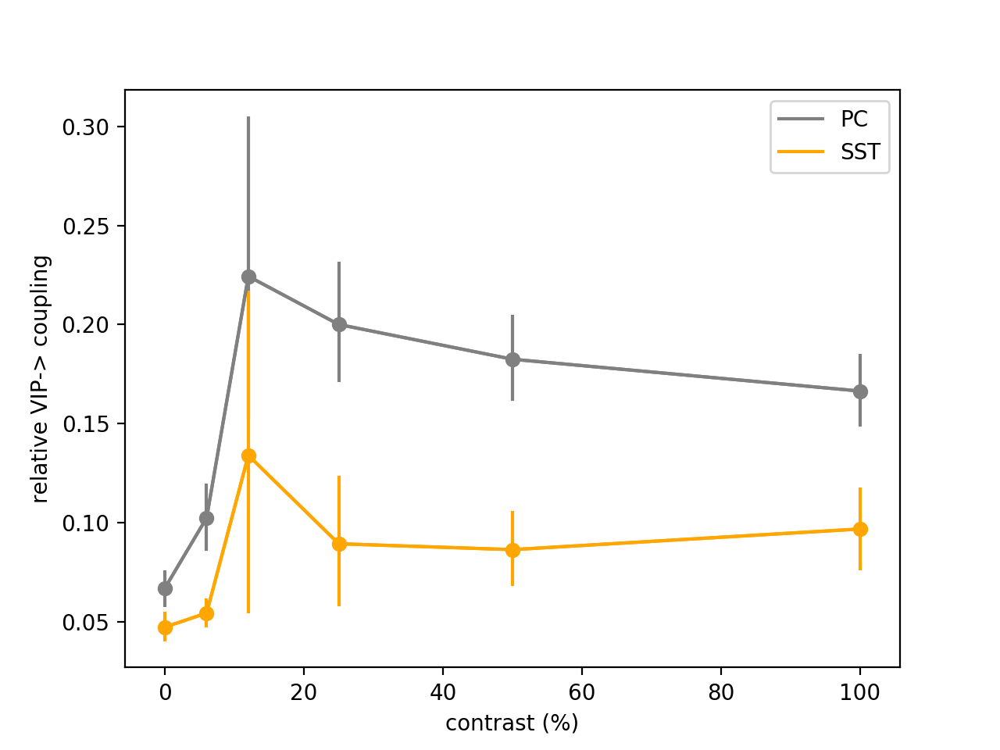

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.16854231968760172
0.07577690981064035


In [239]:
plt.figure()
isize = 0
ucontrast = np.array((0,6,12,25,50,100))
colors = [np.array((0.5,0.5,0.5)),np.array((1,0.65,0)),np.array((0,0,1))]
for target,color in zip([0,1],colors[:2]):
    vip_target = couplings[:,:,2,target].reshape((-1,5,6))
    ut.plot_bootstrapped_errorbars_hillel(ucontrast,np.abs(vip_target[:,isize])[:,np.newaxis]/np.abs(vip_target[:,isize]).max(),colors=color[np.newaxis],pct=(16,84))
plt.xlabel('contrast (%)')
plt.ylabel('relative VIP-> coupling')
plt.legend(['PC','SST'])
# plt.savefig('figures/contrast_dependent_vip_pc_coupling.eps')

<IPython.core.display.Javascript object>


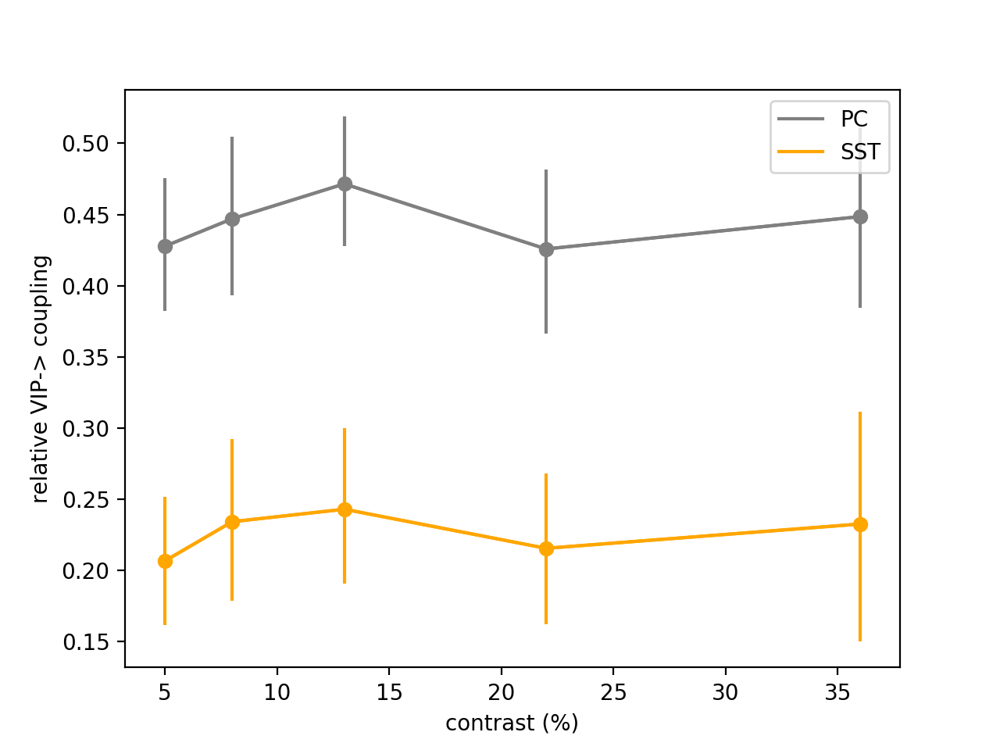

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.424030369834502
0.185940052551597


In [240]:
plt.figure()
isize = 0
ucontrast = np.array((0,6,12,25,50,100))
usize = np.array((5,8,13,22,36))
colors = [np.array((0.5,0.5,0.5)),np.array((1,0.65,0)),np.array((0,0,1))]
for target,color in zip([0,1],colors[:2]):
    vip_target = couplings[:,:,2,target].reshape((-1,5,6))
    ut.plot_bootstrapped_errorbars_hillel(usize,np.abs(vip_target[:,:,-1])[:,np.newaxis]/np.abs(vip_target[:,:,-1]).max(),colors=color[np.newaxis],pct=(16,84))
plt.xlabel('contrast (%)')
plt.ylabel('relative VIP-> coupling')
plt.legend(['PC','SST'])
# plt.savefig('figures/contrast_dependent_vip_pc_coupling.eps')

<IPython.core.display.Javascript object>


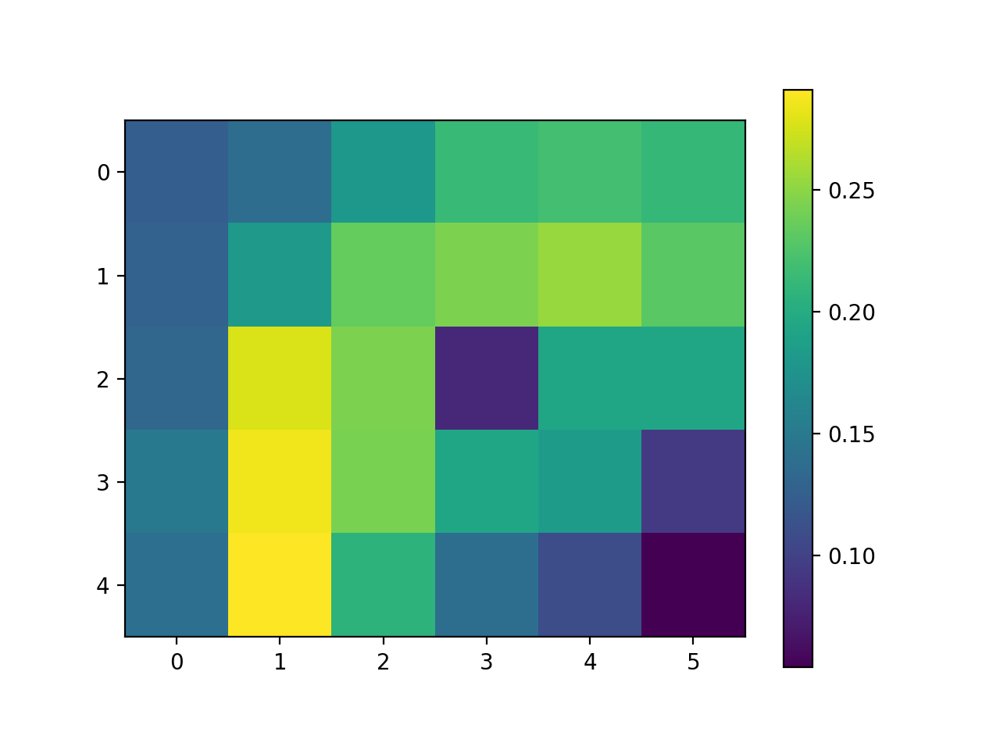

In [172]:
offset = 8
plt.figure()
plt.imshow((coupling[:,offset+0,0]+coupling[:,offset+3,0]).reshape((5,6)))
plt.colorbar()

In [161]:
Phi = calnet.utils.fprime_miller_troyer(Eta,Xi**2+1)
dH = np.zeros_like(Phi)
dH[:,np.arange(2,16,4)] = 1
Wlsq = np.linalg.pinv(dYY) @ (dYY/Phi - h*dH)

<IPython.core.display.Javascript object>


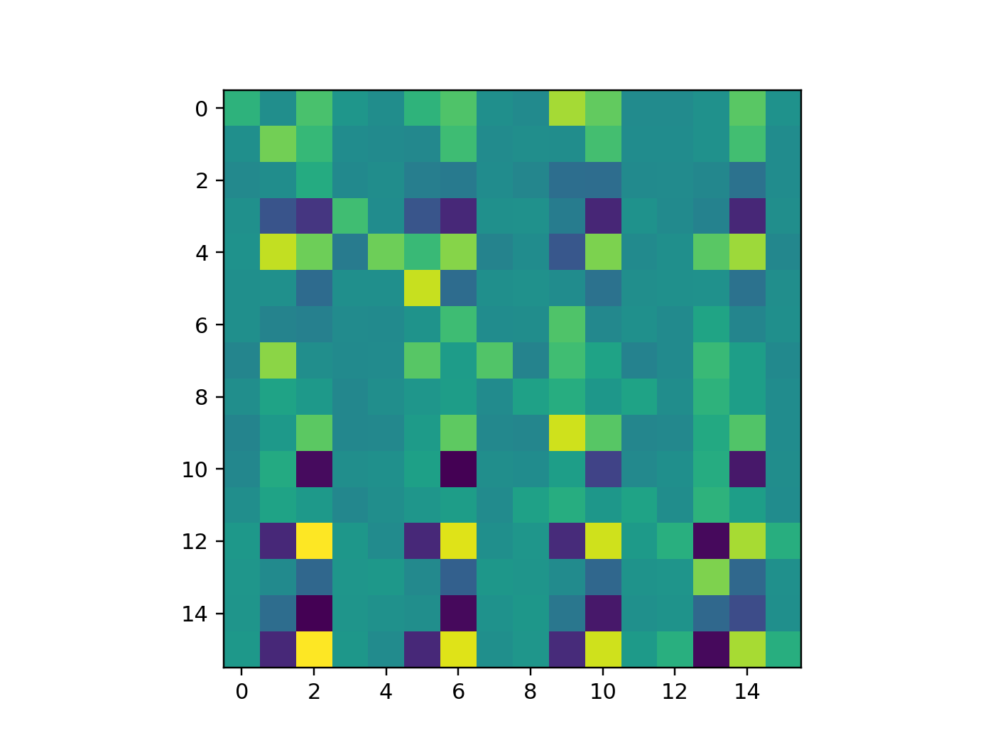

In [162]:
plt.figure()
plt.imshow(Wlsq)

<IPython.core.display.Javascript object>


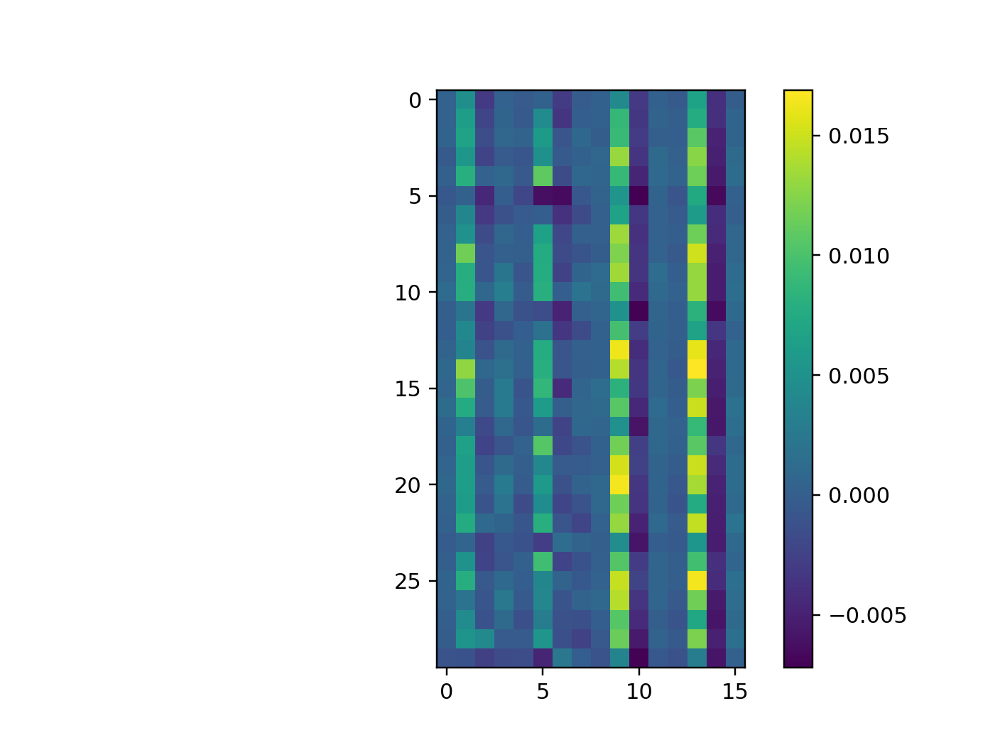

In [151]:
plt.figure()
difference = np.zeros((30,16))
for istim in range(30):
    Phi = np.diag(calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+1))
    difference[istim] = dYY[istim] @ (np.eye(16) - WWmy @ Phi) @ np.linalg.inv(Phi)
plt.imshow(difference)
# plt.imshow(YY)
plt.colorbar()
#,vmin=-0.01,vmax=0)

<IPython.core.display.Javascript object>


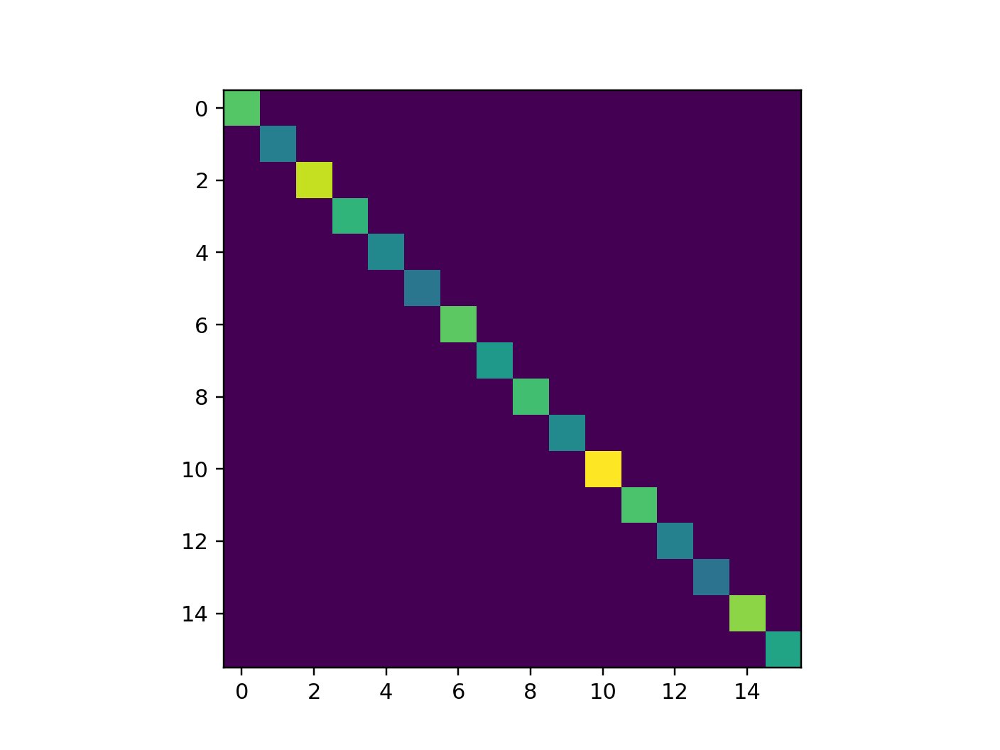

In [140]:
plt.figure()
plt.imshow(Phi)

<IPython.core.display.Javascript object>


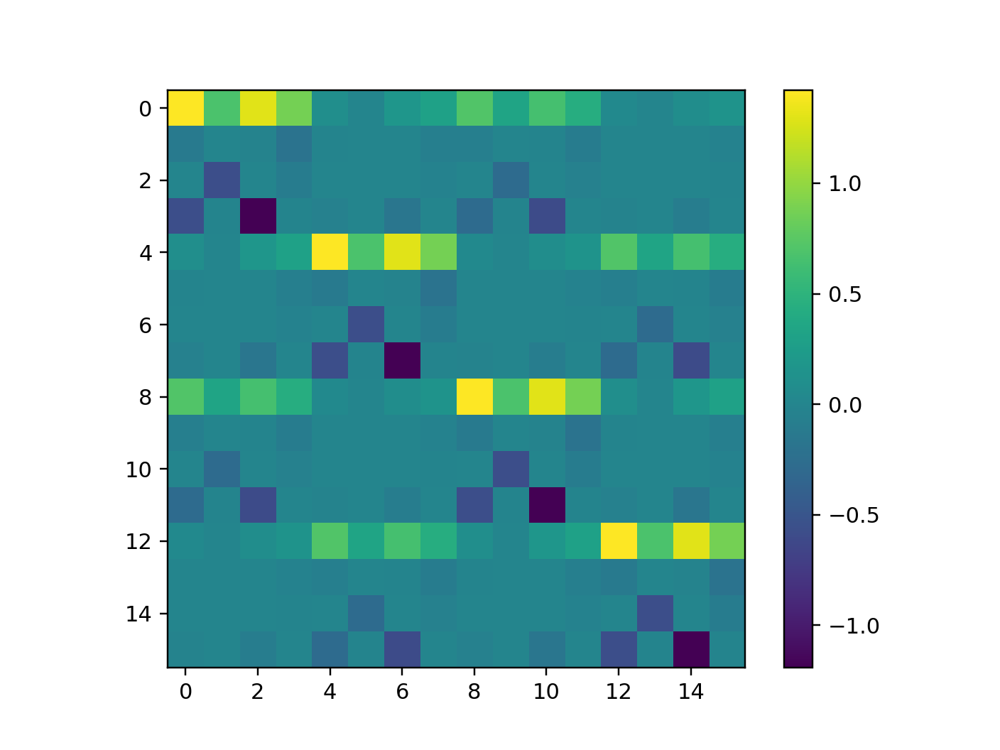

In [133]:
plt.figure()
plt.imshow(WWmy)
plt.colorbar()

<IPython.core.display.Javascript object>


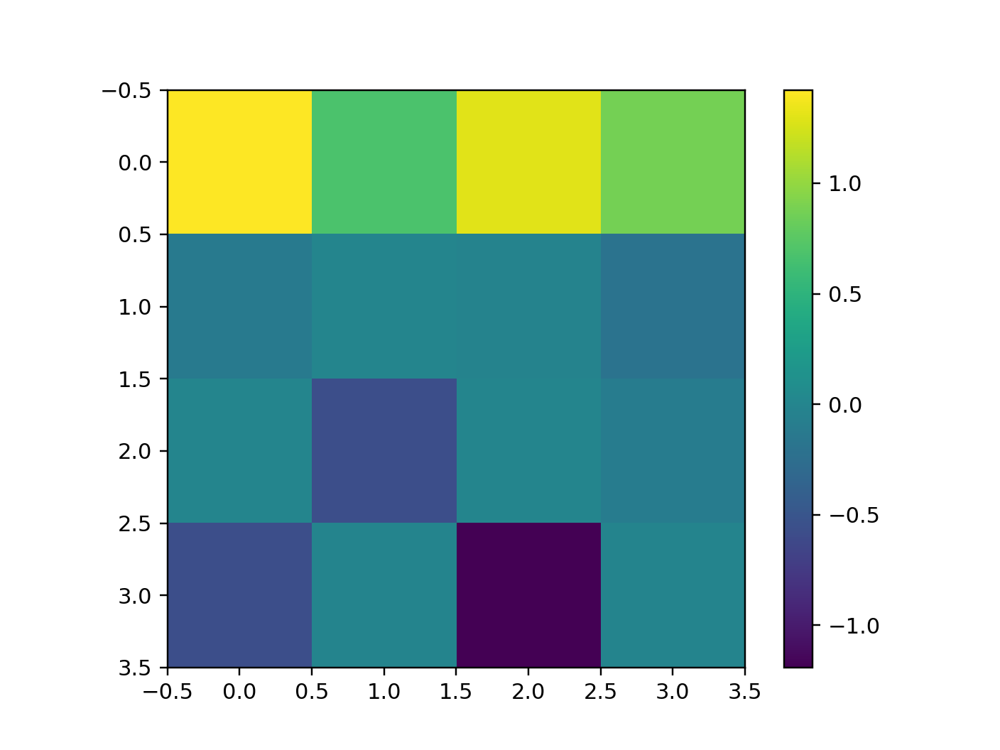

In [135]:
plt.figure()
plt.imshow(Wmy)
plt.colorbar()

In [120]:
Yhat[0][0].shape

(30, 4)

In [121]:
drH,prH = np.linalg.eig(hess)

LinAlgError: 0-dimensional array given. Array must be at least two-dimensional

In [122]:
compute_fprime_m_(Eta,Xi,s02)

array([[-2.93938946e-02,  2.75369280e-02,  9.08498007e-03,
         3.72153299e-03, -2.10674481e-02,  1.67982821e-03,
         4.71064945e-02,  4.35677928e-03, -4.49214988e-02,
        -5.89115025e-03, -6.39171088e-02,  5.31021460e-03,
        -1.65078591e-02, -3.87478400e-03,  4.57578558e-02,
         4.62755360e-03],
       [-2.22999881e-02,  3.03194114e-02, -7.02082757e-03,
         3.46448440e-03, -1.67515155e-02,  4.04586197e-03,
         4.82774184e-02,  3.08535500e-03, -4.42141691e-02,
        -4.10018318e-02, -6.27938658e-02,  6.16927104e-03,
        -1.96755697e-02, -9.60253163e-04,  4.62127404e-02,
         3.12653769e-03],
       [-1.05809605e-02,  3.65528054e-02, -4.78787391e-02,
         2.50561938e-03, -9.41529219e-03,  9.79845890e-03,
         4.68881849e-02,  1.96486279e-03, -2.97966770e-02,
         2.24333286e-03, -1.17349919e-01,  4.29500581e-03,
        -9.71788062e-03,  4.75992645e-03,  4.29238109e-02,
         2.20132829e-03],
       [-2.52148442e-02,  3.82061055e

In [103]:
# nH = drH.shape[0]
hessWy = np.zeros((nQ**2,nQ**2))
blankWlist = parse_W(np.zeros(nH,))
blankWlist[1][:] = 1
allhot = unparse_W(*blankWlist)
Wy_entries = slice(np.where(allhot)[0][0],np.where(allhot)[0][-1]+1)
hessWy = hess[Wy_entries,Wy_entries]
gradWy = gr[Wy_entries]
drH,prH = np.linalg.eig(hessWy)
plt.figure()
for iieig,ieig in enumerate(np.arange(16)):
    plt.subplot(4,4,iieig+1)
    plt.imshow(prH[:,ieig].reshape((nQ,nQ))*np.sign(prH[:,ieig].mean()),vmin=-0.6,vmax=0.6)
plt.figure()
for ieig in np.arange(-1,-5,-1):
    x = np.linspace(-1,1,100)
    y = x*(gradWy @ prH[:,ieig]) + 0.5*x**2*(prH[:,ieig] @ hessWy @ prH[:,ieig])
    plt.plot(x,y)

ValueError: too many values to unpack (expected 12)

In [46]:
hessW = np.zeros((nP*nQ+nQ**2,nP*nQ+nQ**2))
blankWlist = parse_W(np.zeros(nH,))
blankWlist[0][:] = 1
blankWlist[1][:] = 1
allhot = unparse_W(*blankWlist)
W_entries = slice(np.where(allhot)[0][0],np.where(allhot)[0][-1]+1)
hessW = hess[W_entries,W_entries]
gradW = gr[W_entries]
drHW,prHW = np.linalg.eig(hessW)

plt.figure()
for iieig,ieig in enumerate(np.arange(nP*nQ+nQ**2)):
    plt.subplot(6,4,iieig+1)
    these_wts = np.real(prHW[:,ieig])
    these_wx = these_wts[:nP*nQ].reshape((nP,nQ))
    these_wy = these_wts[nP*nQ:].reshape((nQ,nQ))
    these_w = np.concatenate((these_wy,these_wx),axis=0)
    plt.imshow(these_w*np.sign(these_w.mean()),vmin=-0.6,vmax=0.6)
plt.figure()
for ieig in np.arange(-1,-5,-1):
    x = np.linspace(-0.5,0.5,100)
    y = x*(gradW @ prHW[:,ieig]) + 0.5*x**2*(prHW[:,ieig] @ hessW @ prHW[:,ieig])
    plt.plot(x,y)

NameError: name 'nH' is not defined

<IPython.core.display.Javascript object>


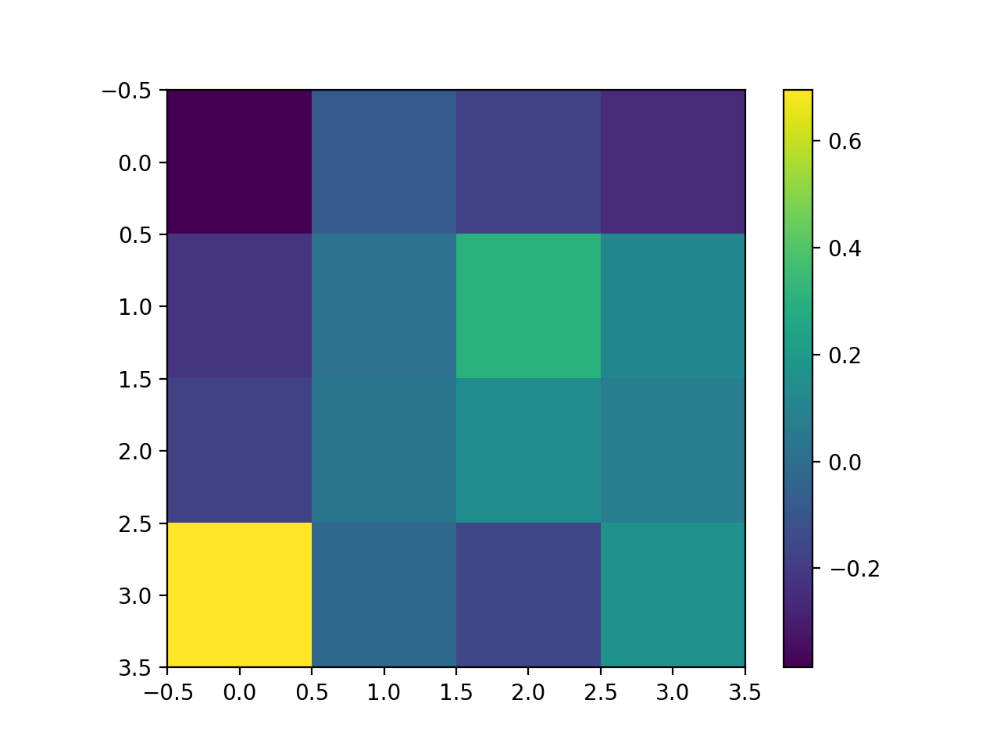

In [2079]:
plt.figure()
plt.imshow(prH[:,-3].reshape((nQ,nQ)))
plt.colorbar()

<IPython.core.display.Javascript object>


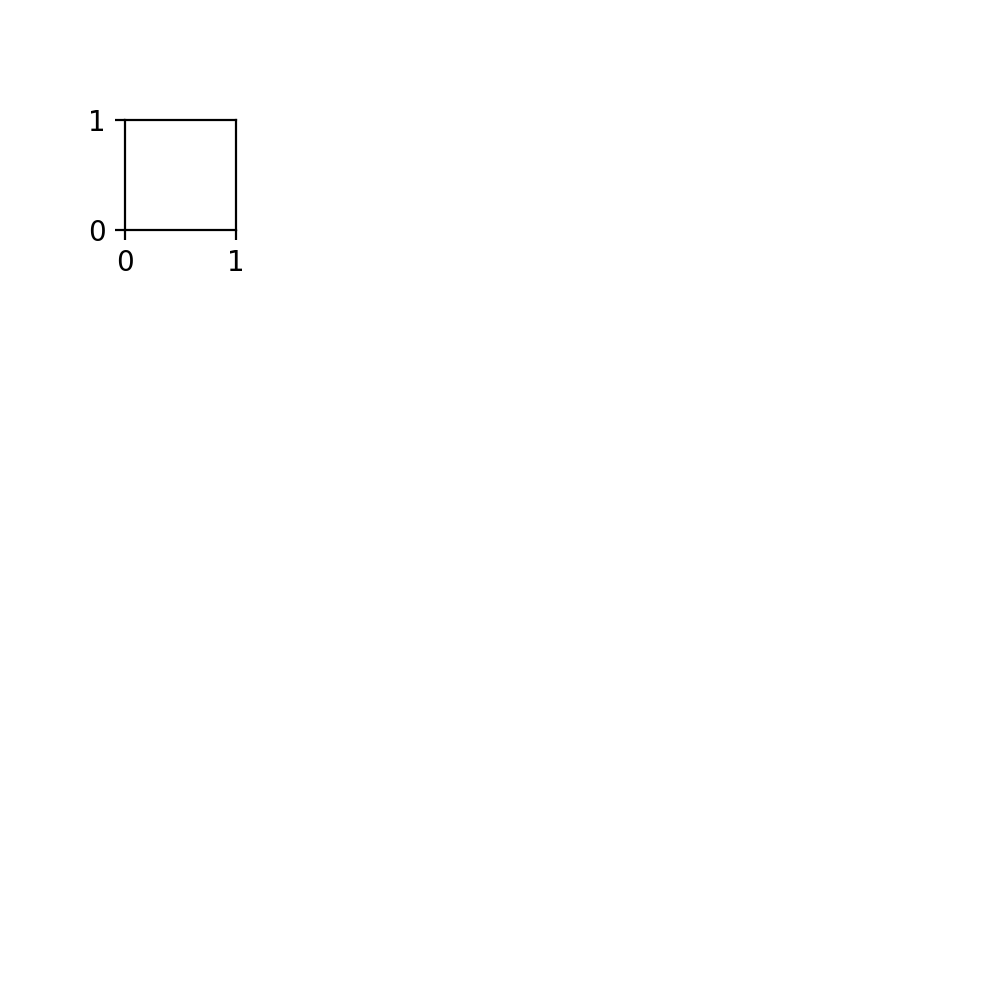

ValueError: cannot reshape array of size 8 into shape (4,4)

In [2080]:
mag = 1
plt.figure(figsize=(5*mag,5*mag))
for iidim,idim in enumerate(np.where(wheavy)[0]):
    plt.subplot(6,6,iidim+1)
    eiglist = parse_W(prH[:,idim])
    plt.imshow(np.real(eiglist[1])*np.sign(np.real(eiglist[1].sum())),vmin=-0.5,vmax=0.5)
    plt.axis('off')
    
mag = 1
plt.figure(figsize=(5*mag,5*mag))
for iidim,idim in enumerate(np.where(wheavy)[0]):
    plt.subplot(6,6,iidim+1)
    eiglist = parse_W(prH[:,idim])
    plt.imshow(np.real(eiglist[3])*np.sign(np.real(eiglist[3].sum())),vmin=-0.5,vmax=0.5)
    plt.axis('off')
#     plt.colorbar()
# plt.tight_layout()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


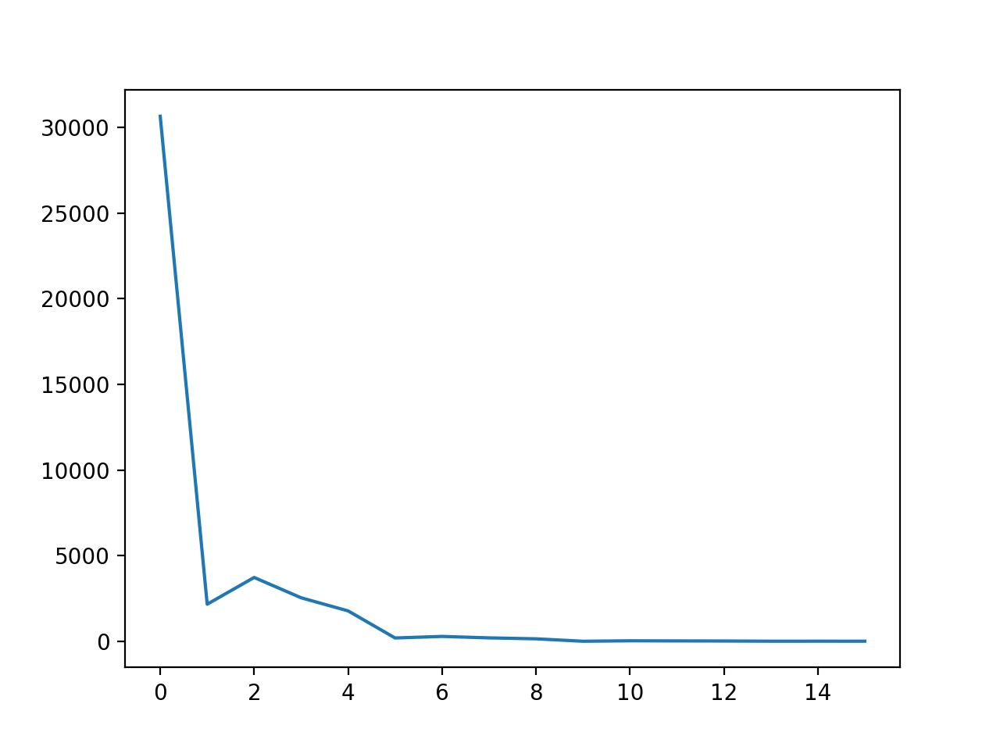

In [1796]:
plt.figure()
plt.plot(np.abs(drH))

In [1247]:
# [Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,YY,Eta,Xi]
# nans: s02, XXp, Eta, Xi

In [1756]:
drW,prW = np.linalg.eig(Wmy-np.eye(Wmy.shape[0]))

In [66]:
len(Wt[0][0])

12

In [275]:
trystars_i = (0,)
trystars_j = (0,)
itry = 0
Wmx,Wmy,Wsx,Wsy,s02,k,kappa,T,XX,XXp,Eta,Xi,h = Wt[trystars_i[itry]][trystars_j[itry]]
labels = ['Wmx','Wmy','Wsx','Wsy','s02','k','kappa','T','XX','XXp','Eta','Xi','h']
Wstar_dict = {}
for i,label in enumerate(labels):
    Wstar_dict[label] = Wt[trystars_i[itry]][trystars_j[itry]][i]
Wstar_dict['as_list'] = [Wmx,Wmy,Wsx,Wsy,s02,k,kappa,T,XX,XXp,Eta,Xi,h]
np.save('weights_from_opto_200702.npy',Wstar_dict)

In [72]:
Wstar_dict = np.load('weights_200607.npy',allow_pickle=True)[()]
Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi = Wstar_dict['as_list']

In [95]:
dYY = Yhat_opto[1::2]-Yhat_opto[0::2]

<IPython.core.display.Javascript object>


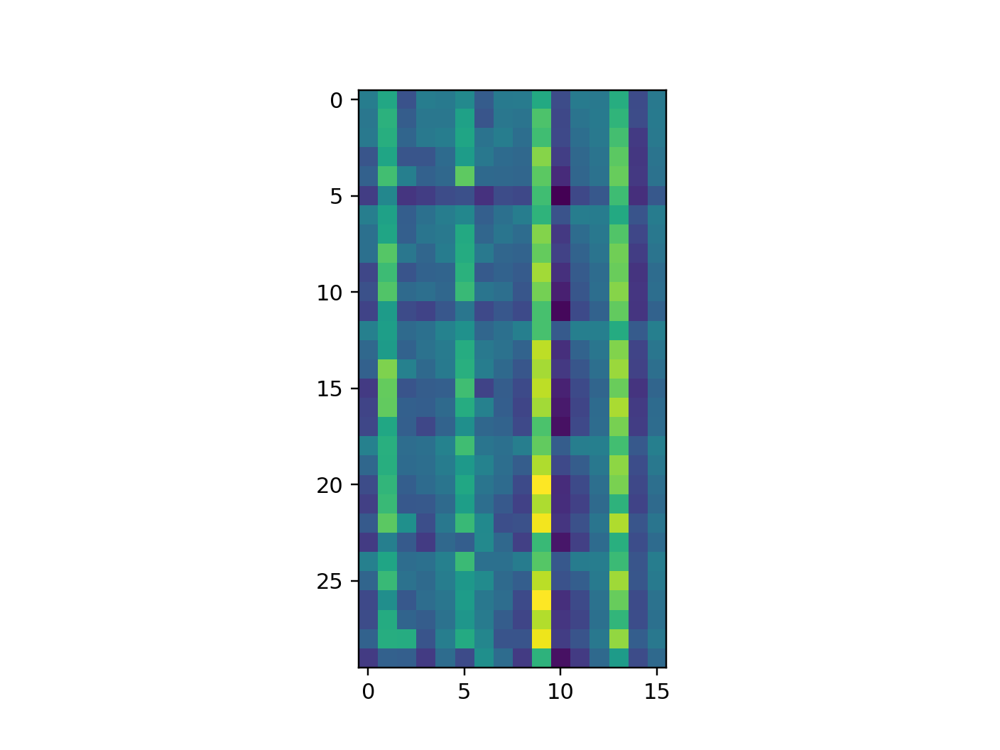

In [97]:
plt.figure()
plt.imshow(dYY)

In [117]:
reload(calnet.utils)
WWy = calnet.utils.gen_Weight_k_kappa_t(Wmy,K,kappa,T)
Phi = compute_fprime_m_(Eta,Xi,s02)
dHH = np.zeros((30,16))
dHH[:,[2,6,10,14]] = -1
dYYz = 0*dYY
x = np.linspace(-0.02,0.02,100)
score = np.zeros_like(x)
for ix in range(len(x)):
    score[ix] = np.sum((dYYz - (dYYz @ WWy) * Phi - dHH * x[ix] * Phi)**2)

In [123]:
(Phi*dHH).mean()

0.002498112101476194

<IPython.core.display.Javascript object>


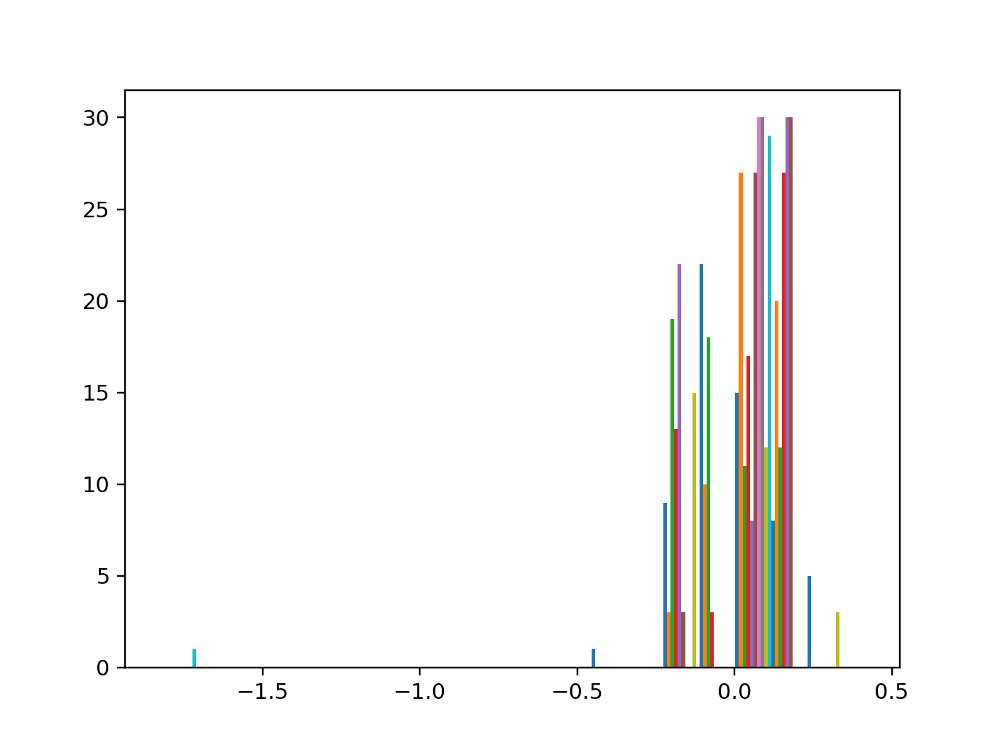

([array([ 0.,  0.,  0.,  0.,  0.,  0.,  1.,  9., 15.,  5.]),
  array([ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  3., 27.,  0.]),
  array([ 0.,  0.,  0.,  0.,  0.,  0.,  0., 19., 11.,  0.]),
  array([ 0.,  0.,  0.,  0.,  0.,  0.,  0., 13., 17.,  0.]),
  array([ 0.,  0.,  0.,  0.,  0.,  0.,  0., 22.,  8.,  0.]),
  array([ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  3., 27.,  0.]),
  array([ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0., 30.,  0.]),
  array([ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0., 30.,  0.]),
  array([ 0.,  0.,  0.,  0.,  0.,  0.,  0., 15., 12.,  3.]),
  array([ 1.,  0.,  0.,  0.,  0.,  0.,  0.,  0., 29.,  0.]),
  array([ 0.,  0.,  0.,  0.,  0.,  0.,  0., 22.,  8.,  0.]),
  array([ 0.,  0.,  0.,  0.,  0.,  0.,  0., 10., 20.,  0.]),
  array([ 0.,  0.,  0.,  0.,  0.,  0.,  0., 18., 12.,  0.]),
  array([ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  3., 27.,  0.]),
  array([ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0., 30.,  0.]),
  array([ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0., 30.,  0.])],
 array([-1.84833978, -1

In [122]:
plt.figure()
plt.hist(Phi)

<IPython.core.display.Javascript object>


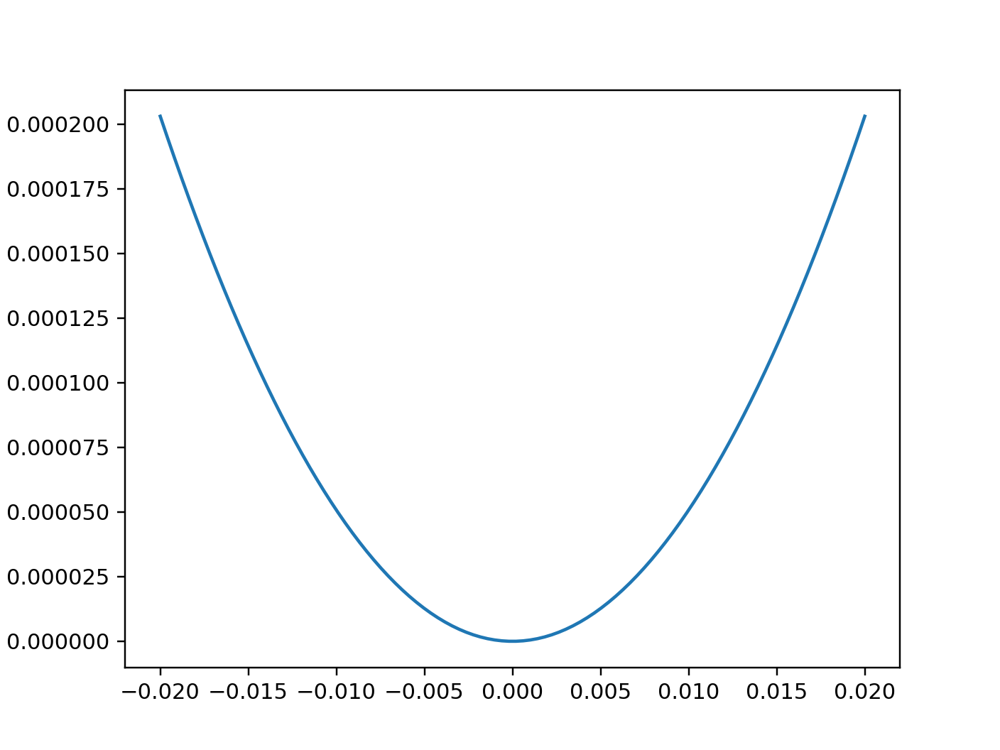

In [119]:
plt.figure()
plt.plot(x,score)

<IPython.core.display.Javascript object>


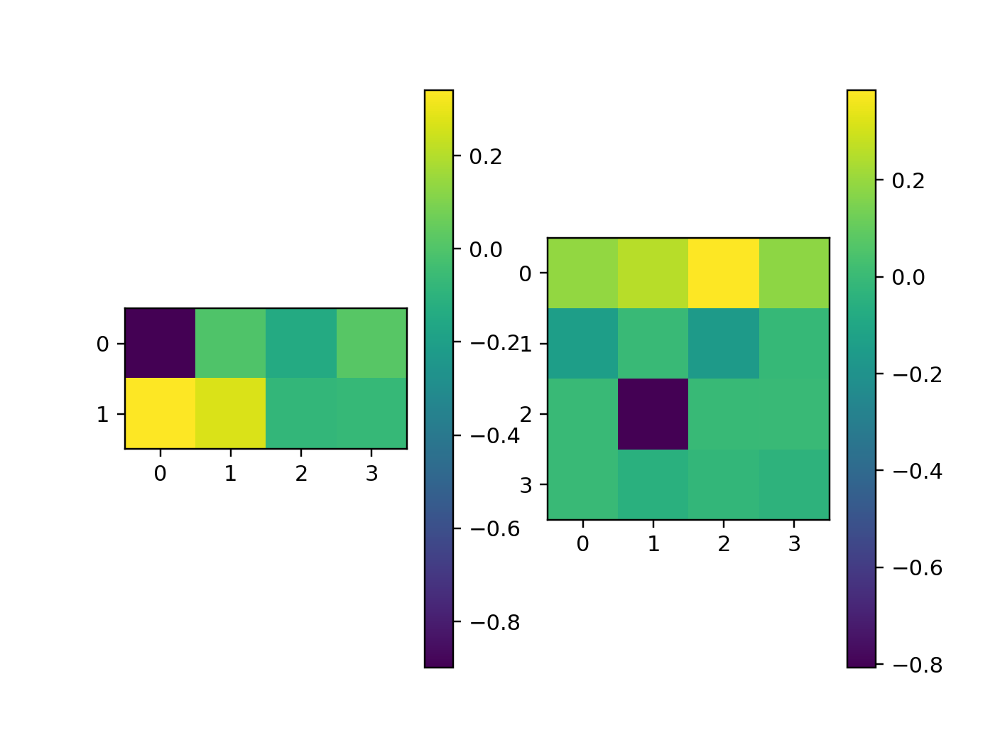

In [109]:
plt.figure()
plt.subplot(1,2,1)
plt.imshow(Wmx)
plt.colorbar()
plt.subplot(1,2,2)
plt.imshow(Wmy)
plt.colorbar()

In [110]:
def show_four_celltypes(YYstar):
    lbls = ['PC','SST','VIP','PV']
    mag = 2
    plt.figure(figsize=(mag*nQ,mag))
    for itype in range(nQ):
        plt.subplot(1,nQ,itype+1)
        plt.title(lbls[itype])
        sca.show_size_contrast(YYstar[:,itype].reshape((5,6)),flipud=True)
    plt.tight_layout()

<IPython.core.display.Javascript object>


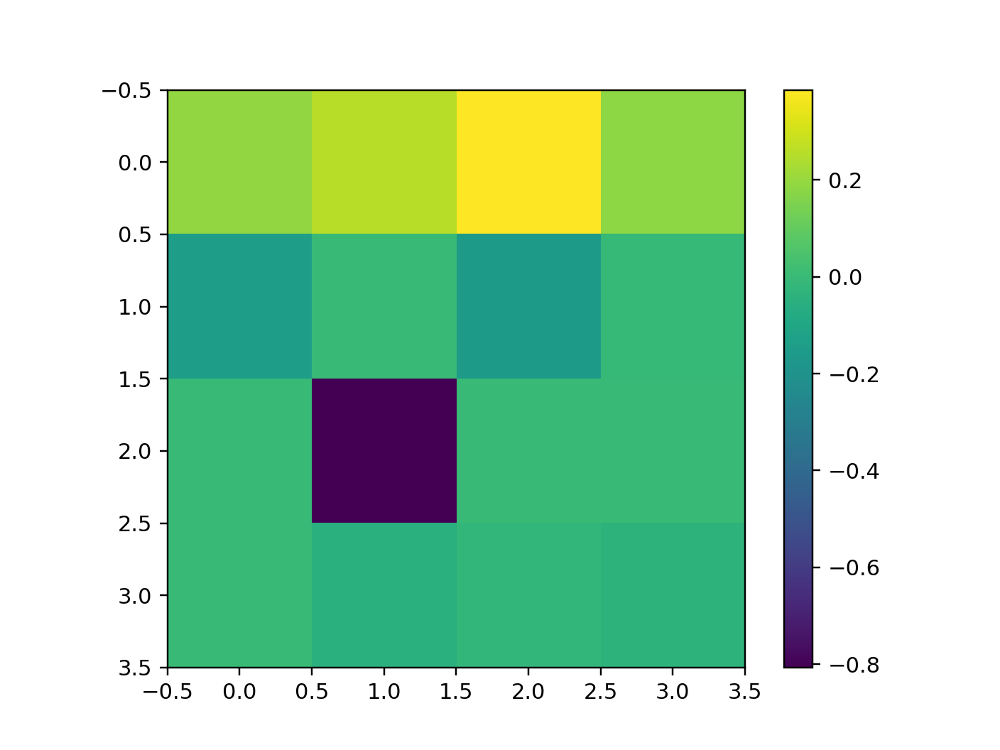

In [111]:
plt.figure()
plt.imshow(Wmy)
plt.colorbar()

In [88]:
for itry in range(1): #ntries): 
    Wmx,Wmy,Wsx,Wsy,s02,k,kappa,T,XX,XXp,Eta,Xi = Wt[trystars_i[itry]][trystars_j[itry]]
#     Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wstar_dict['as_list'] #Wt[0][itry]
    XXhat = np.concatenate(Xhat,axis=1)
    YYhat = np.concatenate(Yhat,axis=1)
    YY = compute_f_(Eta,Xi,s02)
    Etastar = u_fn(XX,YY,Wmx,Wmy,k,kappa,T)
    Xistar = u_fn(XX,YY,Wsx,Wsy,k,kappa,T)
    YYstar = compute_f_(Etastar,Xistar,s02)
    show_four_celltypes(YY)
#     mag = 2
#     plt.figure(figsize=(mag*nQ,mag))
#     for itype in range(nQ):
#         plt.subplot(1,nQ,itype+1)
#         plt.title(lbls[itype])
#         sca.show_size_contrast(YYstar[:,itype].reshape((5,6)),flipud=True)
#     plt.tight_layout()
#     plt.savefig('figures/modeled_four_cell_types.jpg',dpi=300)

NameError: name 'Wt' is not defined

In [ ]:
plt.plot(YY)

<IPython.core.display.Javascript object>


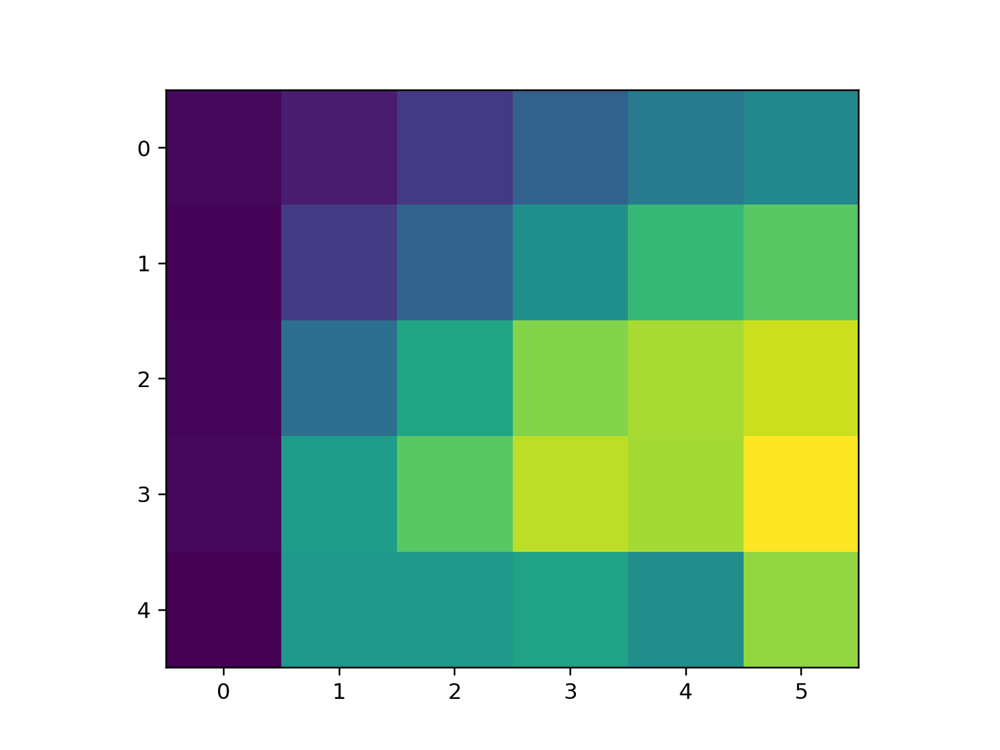

In [119]:
plt.figure()
plt.imshow(YY[:,0].reshape((5,6)))

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


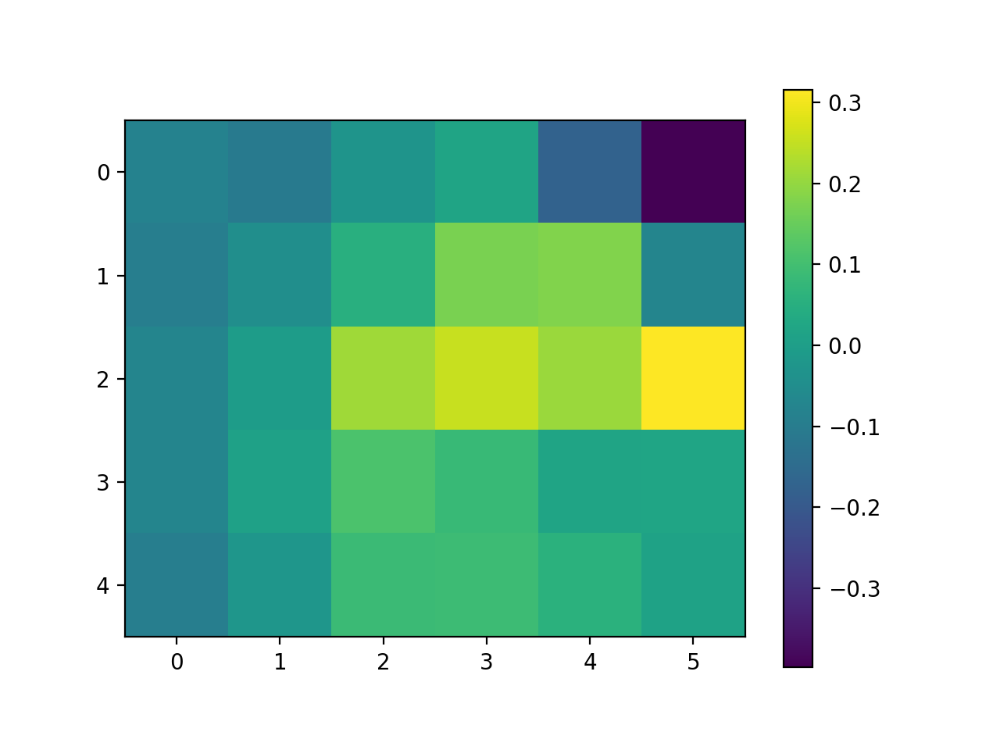

In [2088]:
plt.figure()
plt.imshow((YY-YYstar)[:,0].reshape((nsize,ncontrast)))
plt.colorbar()

In [2089]:
ww = gen_Weight(Wmy,k,kappa)
eig_actual = np.zeros((Etastar.shape[0],))
for istim in range(Etastar.shape[0]):
    eig_actual[istim] = np.max(np.real(np.linalg.eig(compute_fprime_(Eta,Xi,s02)[istim]@ww - np.eye(nS*nQ))[0]))
#     eig_actual[istim] = np.max(np.real(np.linalg.eig(compute_fprime_(Etastar,Xistar,s02)[istim]@ww - np.eye(ww.shape[0]))[0]))
    eig_no_gain = np.max(np.real(np.linalg.eig(ww - np.eye(ww.shape[0]))[0]))
    print((eig_actual[istim],eig_no_gain))

(-0.9999999999999993, -0.009993623305414886)
(-0.9999999999999992, -0.009993623305414886)
(-0.9999999999999993, -0.009993623305414886)
(-0.2368478149902454, -0.009993623305414886)
(1.7106625867160918, -0.009993623305414886)
(3.1400013220281733, -0.009993623305414886)
(-0.9999999999999987, -0.009993623305414886)
(-0.9999999999999996, -0.009993623305414886)
(-0.9999999999999994, -0.009993623305414886)
(-0.9999999999999991, -0.009993623305414886)
(-0.2759527000179595, -0.009993623305414886)
(1.0103883331405459, -0.009993623305414886)
(-0.9999999999999998, -0.009993623305414886)
(-0.9999999999999993, -0.009993623305414886)
(-0.9999999999999996, -0.009993623305414886)
(-0.3950126606634954, -0.009993623305414886)
(-0.003739102238442815, -0.009993623305414886)
(2.0213250147711292, -0.009993623305414886)
(-0.9999999999999996, -0.009993623305414886)
(-0.9999999999999998, -0.009993623305414886)
(-0.9999999999999993, -0.009993623305414886)
(-0.9103041883195016, -0.009993623305414886)
(1.172059055

In [2090]:
istim = 29
drf,prf = np.linalg.eig(compute_fprime_(Eta,Xi,s02)[istim]@ww - np.eye(nS*nQ))

In [2091]:
prf[:,1]

array([-0.99856234, -0.02025994, -0.02025994, -0.02025994, -0.02025994,
       -0.02025994, -0.02025994, -0.02025994])

In [2092]:
istim = -1
np.linalg.eig(compute_fprime_(Eta,Xi,s02)[istim]@ww - np.eye(nS*nQ))[1][0]

array([-0.35355339, -0.99856234,  0.22670029, -0.41994402, -0.11058865,
       -0.05784502,  0.22710208, -0.6688424 ])

In [2093]:
(Wmy[1,2],Wmy[2,1],Wmy[3,0],Wmy[1,0])

(-0.6628473584947526,
 -1.1850025100315922,
 -1.9382457900390289,
 -0.07592391320035187)

In [2094]:
YY = compute_f_(Eta,Xi,s02)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


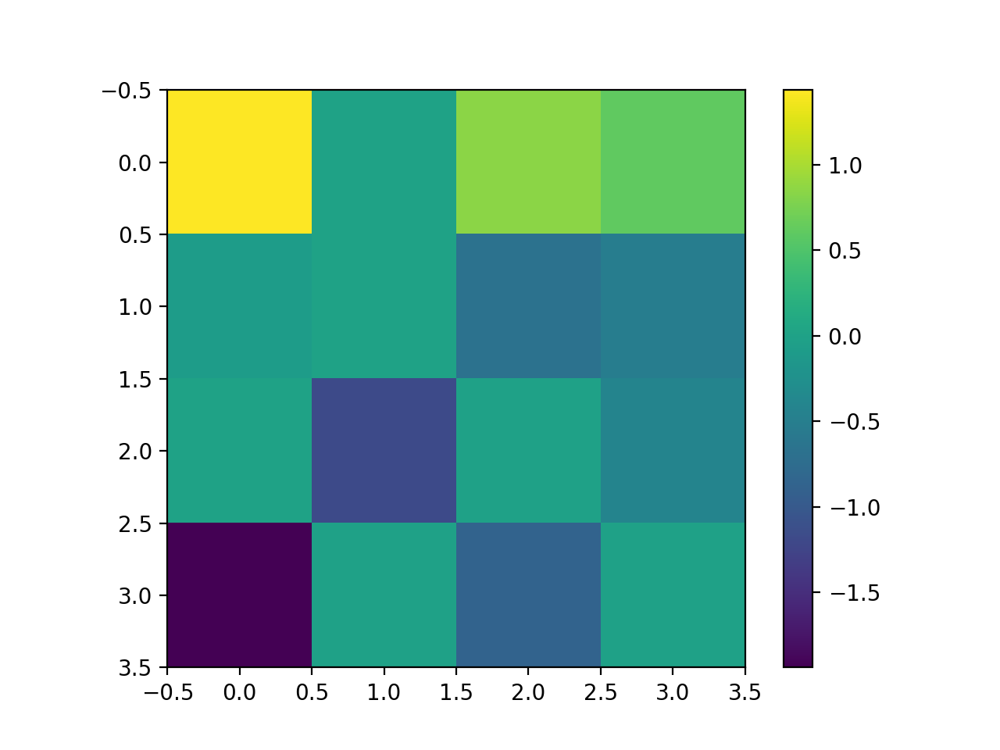

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


<IPython.core.display.Javascript object>


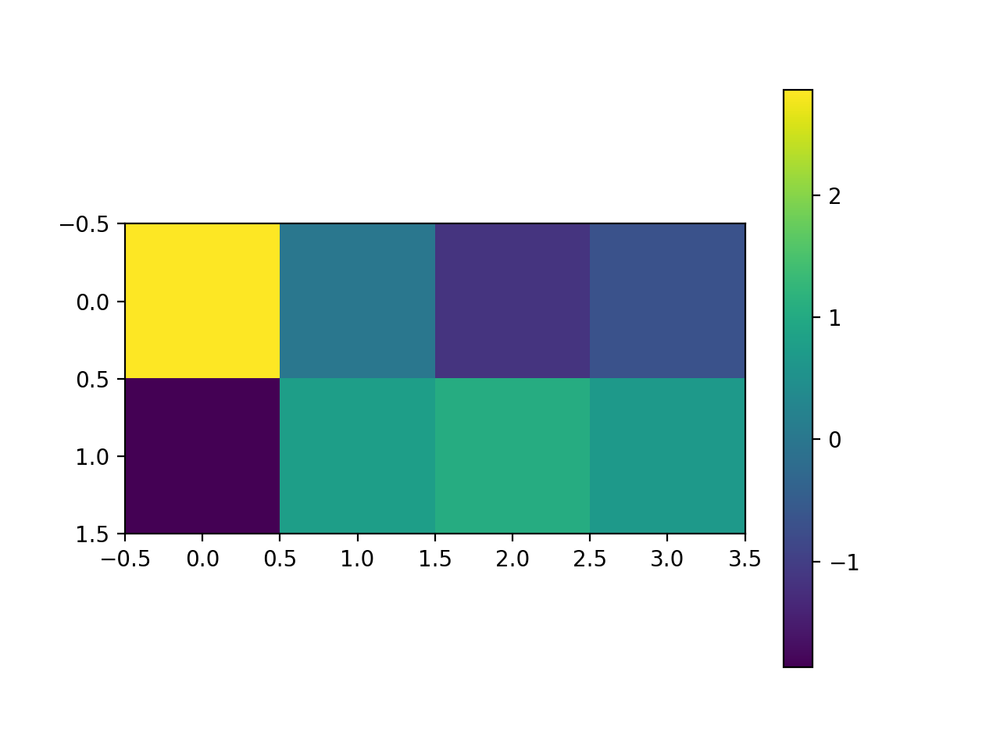

In [2095]:
plt.figure()
plt.imshow(Wmy)
plt.colorbar()
plt.figure()
plt.imshow(Wmx)#,vmin=-2,vmax=2)
plt.colorbar()

In [2096]:
Wmy_bounds

array([[ 2,  2,  2,  2],
       [-2,  0, -2, -2],
       [ 0, -2, -2, -2],
       [-2, -2, -2, -2]])

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


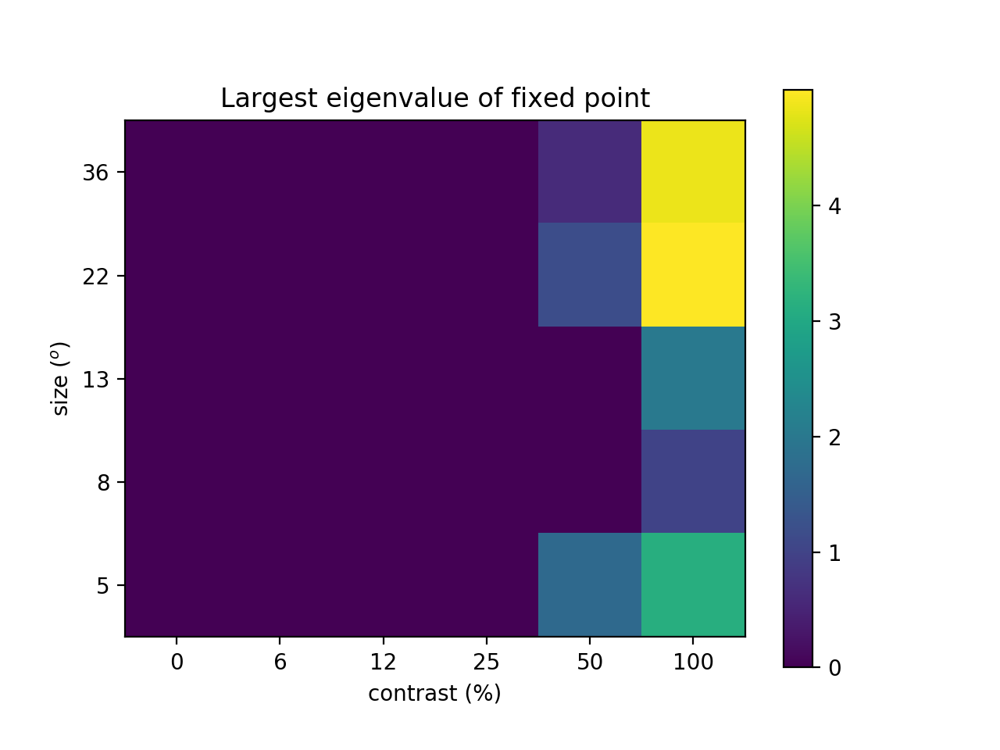

Text(0.5, 1.0, 'Largest eigenvalue of fixed point')

In [2097]:
plt.figure()
sca.show_size_contrast(eig_actual.reshape((nsize,ncontrast)),vmin=0,flipud=True)#,vmin=-1,vmax=1)
plt.colorbar()
plt.title('Largest eigenvalue of fixed point')
# plt.savefig('figures/possible_gamma_substrate.jpg',dpi=300)

In [1915]:
# Wstar_dict = np.load('weights_200111b.npy',allow_pickle=True)[()]

0
0
1
2
3
4
5
6
7
8
9


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:36: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


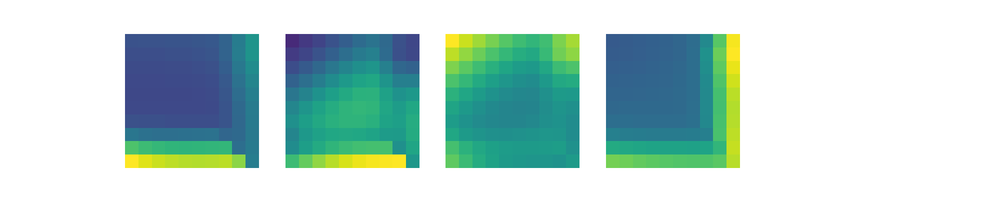

In [1945]:
nstar = len(trystars_i)
YY = [None for istar in range(nstar)]
Nvals = 10
max_val = 1
Niter = int(1e3)
for istar in range(nstar):
    print(istar)
    ti,tj = trystars_i[istar],trystars_j[istar]
    Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wstar_dict['as_list'] #Wt[ti][tj]
    def fY(XX,YY):
        return compute_f_(u_fn(XX,YY,Wmx,Wmy,k,kappa),u_fn(XX,YY,Wsx,Wsy,k,kappa),s02)
    def predict_YY(XX,YY0,eta=1e-2):
        def dYYdt(YY):
            return -YY + fY(XX,YY)
        YY = np.zeros((Niter+1,nS*nQ))
        YY[0] = YY0.copy() #np.zeros((nN,nS*nQ))
        dYY = np.zeros_like(YY[0])
        iiter = 0
        while iiter < Niter: #np.abs(dYY).sum()>1e-8*np.abs(YY).sum():
            dYY = eta*dYYdt(YY[iiter])
            YY[iiter+1] = YY[iiter] + dYY
            iiter = iiter+1
        return YY
    YY = np.zeros((Nvals,Nvals,Niter+1,nS*nQ))
    YY0 = compute_f_(Eta[0],Xi[0],s02)
    XX = np.ones((Nvals,Nvals,4))
    XX[:,:,0],XX[:,:,2] = np.meshgrid(np.linspace(0,max_val,Nvals),np.linspace(0,max_val,Nvals),indexing='ij')
#     XX[:,2] = np.linspace(0,max_val,Nvals)
    for ival in range(Nvals):
        YY[ival,0] = predict_YY(XX[ival,0],YY0)
        print(ival)
        for jval in range(1,Nvals):
            YY[ival,jval] = predict_YY(XX[ival,jval],YY[ival-1,jval,-1])
            
    mag = 2
    plt.figure(figsize=(mag*ncelltypes,mag))
    for icelltype in range(nQ):
        plt.subplot(1,ncelltypes,icelltype+1)
        plt.imshow(YY[:,:,-1,icelltype],vmin=0)#,interpolation='bilinear')
        plt.axis('off')

In [1946]:
nstar = len(trystars_i)
YYsc = [None for istar in range(nstar)]
Niter = int(2e3)
for istar in range(nstar):
    print(istar)
    ti,tj = trystars_i[istar],trystars_j[istar]
    Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wt[ti][tj]
    fval = compute_f_(Eta,Xi,s02)
    resEta = Eta - u_fn(XX,fval,Wmx,Wmy,k,kappa)
    resXi = Xi - u_fn(XX,fval,Wsx,Wsy,k,kappa)
    def fY(XX,YY):
        return compute_f_(resEta[ival]+u_fn(XX,YY,Wmx,Wmy,k,kappa),resXi[ival]+u_fn(XX,YY,Wsx,Wsy,k,kappa),s02)
    def predict_YY(XX,YY0,eta=2e-2):
        def dYYdt(YY):
            return -YY + fY(XX,YY)
        YY = np.zeros((Niter+1,nS*nQ))
        YY[0] = YY0.copy() #np.zeros((nN,nS*nQ))
        dYY = np.zeros_like(YY[0])
        iiter = 0
        while iiter < Niter: #np.abs(dYY).sum()>1e-8*np.abs(YY).sum():
            dYY = eta*dYYdt(YY[iiter])
            YY[iiter+1] = YY[iiter] + dYY
            iiter = iiter+1
        return YY
    
    YYsc[istar] = np.zeros((nN,Niter+1,nS*nQ))
    YY0 = compute_f_(Eta,Xi,s02) + 0.05*np.tile(np.array((0,1,0,0,0,1,0,0))[np.newaxis],(nN,1)) #*np.random.randn(nN,nS*nQ)
#     XX[:,2] = np.linspace(0,max_val,Nvals)
    for ival in range(nN):
        YYsc[istar][ival] = predict_YY(XX[ival],YY0[ival])
        print(ival)
            
#     mag = 2
#     plt.figure(figsize=(mag*ncelltypes,mag))
#     for icelltype in range(nQ):
#         plt.subplot(1,ncelltypes,icelltype+1)
#         plt.imshow(YY[:,:,-1,icelltype],vmin=0,interpolation='bilinear')
#         plt.axis('off')

0
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


<IPython.core.display.Javascript object>


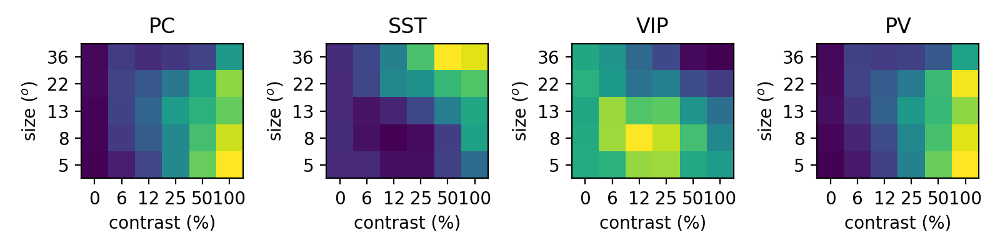

In [1947]:
show_four_celltypes(YYsc[0][:,-1])
# plt.savefig('figures/self_consistent_model_no_residual_currents.jpg',dpi=300)

In [1948]:
YY = compute_f_(Eta,Xi,s02)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


<IPython.core.display.Javascript object>


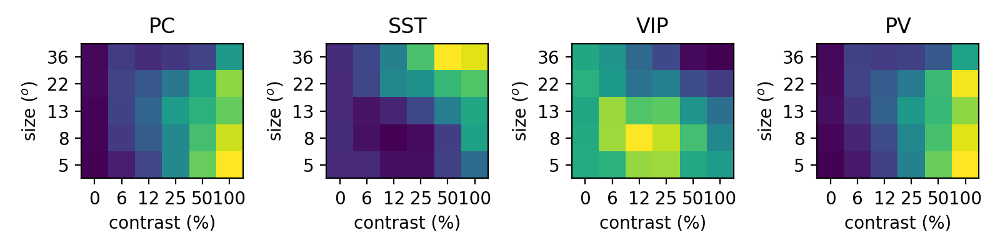

In [1949]:
show_four_celltypes(YY)#[0][:,-1])
# plt.savefig('figures/self_consistent_model_with_residual_currents.jpg',dpi=300)

In [2100]:
nstar = len(trystars_i)
Niter = int(3e3)
fix_dim = [0,1,2,3]
Nfix = len(fix_dim)
# YY = [None for ifix in range(Nfix)]
Ny = 50
max_val = 2.5
yvals = np.linspace(0,max_val,Ny)
stim_vals = np.arange(30)
Nstim = len(stim_vals)
for istar in (0,): #range(nstar):
    print(istar)
#     ti,tj = trystars_i[istar],trystars_j[istar]
    Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wstar_dict['as_list'] #Wt[ti][tj]
    fval = compute_f_(Eta,Xi,s02)
    resEta = Eta - u_fn(XX,fval,Wmx,Wmy,k,kappa)
    resXi = Xi - u_fn(XX,fval,Wsx,Wsy,k,kappa)
    def fY(XX,YY):
        return compute_f_(resEta[stim_val]+u_fn(XX,YY,Wmx,Wmy,k,kappa),resXi[stim_val]+u_fn(XX,YY,Wsx,Wsy,k,kappa),s02)
    def predict_YY_fix_dim(XX,YY0,eta=1e-2,fix_dim=None,run_backward=False):
        def dYYdt(YY):
            return -YY + fY(XX,YY)
        YY = np.zeros((Niter+1,nS*nQ))
        YY[0] = YY0.copy() #np.zeros((nN,nS*nQ))
        dYY = np.zeros_like(YY[0])
        iiter = 0
        while iiter < Niter: #np.abs(dYY).sum()>1e-8*np.abs(YY).sum():
            dYY = eta*dYYdt(YY[iiter])
            if not fix_dim is None:
                dYY[fix_dim] = 0
            if run_backward:
                dYY = -dYY
            YY[iiter+1] = YY[iiter] + dYY
            iiter = iiter+1
        return YY
    
    YY_ss = np.zeros((Nfix,Nstim,Ny,Niter+1,nS*nQ))
    YY0 = compute_f_(Eta,Xi,s02)
#     XX[:,2] = np.linspace(0,max_val,Nvals)
    for istim,stim_val in enumerate(stim_vals): #range(nN):
        print(istim)
        for iy,yval in enumerate(yvals):
            for ifix in range(Nfix):
                yy0 = YY0[stim_val] #+np.random.randn(yy0.shape)
                yy0[fix_dim[ifix]] = yval
                YY_ss[ifix,istim,iy] = predict_YY_fix_dim(XX[stim_val],yy0,fix_dim=fix_dim[ifix])

0
0


KeyboardInterrupt: 

In [1040]:
# YY_ss = YY.copy()

In [ ]:
# def u_fn(XX,YY,Wx,Wy,k,kappa):
#     WWx,WWy = [gen_Weight(W,k,kappa) for W in [Wx,Wy]]
#     return XX @ WWx + YY @ WWy

In [1527]:
reload(utils)
nstar = len(trystars_i)
Niter = int(4e3)
fix_dim = [0,1,2,3]
Nfix = len(fix_dim)
# YY = [None for ifix in range(Nfix)]
Ny = 50
Nx = 20
max_val = 2.5
yvals = np.linspace(0,max_val,Ny)
xvals = np.linspace(0,max_val,Nx)
stim_vals = np.arange(30)
Nstim = len(stim_vals)
for istar in (0,): #range(nstar):
    print(istar)
    ti,tj = trystars_i[istar],trystars_j[istar]
    Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wt[ti][tj]
    fval = compute_f_(Eta,Xi,s02)
    resEta = Eta - u_fn(XX,fval,Wmx,Wmy,k,kappa)
    resXi = Xi - u_fn(XX,fval,Wsx,Wsy,k,kappa)
    WWmx,WWmy = [gen_Weight(W,k,kappa) for W in [Wmx,Wmy]]
    WWsx,WWsy = [gen_Weight(W,k,kappa) for W in [Wsx,Wsy]]
    def u_fn_m(XX,YY):
        return u_fn_WW(XX,YY,WWx=WWmx,WWy=WWmy)
    def u_fn_s(XX,YY):
        return u_fn_WW(XX,YY,WWx=WWsx,WWy=WWsy)
    def dfYdY(XX,YY):
        # derivs: (nN,nS*nQ)
        # WWy: (nS*nQ,nS*nQ)
        # (dfYdY)ij = dfj(Y)/dYi
        deriv_m = compute_fprime_m_(resEta[stim_val]+u_fn_m(XX,YY),resXi[stim_val]+u_fn_s(XX,YY),s02)
        deriv_s = compute_fprime_s_(resEta[stim_val]+u_fn_m(XX,YY),resXi[stim_val]+u_fn_s(XX,YY),s02)
        return deriv_m[:,np.newaxis,:]*WWmy[np.newaxis,:,:] + deriv_s[:,np.newaxis,:]*WWsy[np.newaxis,:,:]
    def fY(XX,YY):
        return compute_f_(resEta[stim_val:stim_val+1]+u_fn_m(XX,YY),resXi[stim_val:stim_val+1]+u_fn_s(XX,YY),s02)
    def predict_YY_fix_dim(XX,YY0,eta=2e-1,fix_dim=0,run_backward=False):
        def F(YY):
            # YY: (nN,nS*nQ)
            # F: (nN,nS*nQ)
            return -YY + fY(XX,YY)
        def dFdYY(YY):
            # dFdYY: (nN,nS*nQ,nS*nQ)
            # (dFdYY)ij = dFj(Y)/dYi, inherited from dfYdY convention
            return -np.eye(nS*nQ)[np.newaxis,:,:] + dfYdY(XX,YY)
        def dF2dYY(YY):
            # dFdYY: (nN,nS*nQ,nS*nQ)
            # F: (nN,nS*nQ)
            # dF2dYY: (nN,nS*nQ)
            # (dFdYY)ij = dFj(Y)/dYi, so sum_j ( dFj(Y)/dYi Fj(Y) = sum_j (dFdYY)ij Fj) yields the right answer
            return np.einsum('hij,hj->hi',dFdYY(YY),F(YY))
        YY = np.zeros((1,Niter+1,nS*nQ))
        YY[:,0] = YY0.copy() #np.zeros((nN,nS*nQ))
        dYY = np.zeros_like(YY[:,0])
        iiter = 0
        while iiter < Niter: #np.abs(dYY).sum()>1e-8*np.abs(YY).sum():
            dYY = -eta*dF2dYY(YY[:,iiter])
            dYY[:,fix_dim] = 0
            if run_backward:
                dYY = -dYY
            YY[:,iiter+1] = YY[:,iiter] + dYY
            iiter = iiter+1
        return YY
    
    YY_F2 = np.zeros((Nfix,Nstim,Ny,Nx,Niter+1,nS*nQ))
    YY0 = compute_f_(Eta,Xi,s02)
#     XX[:,2] = np.linspace(0,max_val,Nvals)
    for istim,stim_val in enumerate(stim_vals): #range(nN):
        print(istim)
        for iy,yval in enumerate(yvals):
            for ix,xval in enumerate(xvals):
                for ifix in range(Nfix):
    #                 yy0 = YY0[stim_val] #+np.random.randn(yy0.shape)
                    yy0[:] = np.random.rand(*yy0.shape)
                    yy0[fix_dim[ifix]] = yval
                    YY_F2[ifix,istim:istim+1,iy,ix] = predict_YY_fix_dim(XX[stim_val:stim_val+1],yy0[np.newaxis],fix_dim=fix_dim[ifix])
    #             if np.remainder(iy,10)==0:
#                 print(iy)
            
#     mag = 2
#     plt.figure(figsize=(mag*ncelltypes,mag))
#     for icelltype in range(nQ):
#         plt.subplot(1,ncelltypes,icelltype+1)
#         plt.imshow(YY[:,:,-1,icelltype],vmin=0,interpolation='bilinear')
#         plt.axis('off')

0
0


KeyboardInterrupt: 

In [1057]:
pdb.pm()

> <ipython-input-1056-9146c9d1360a>(48)dF2dYY()
-> return dFdYY(YY) @ F(YY)
(Pdb) dFdYY.shape
*** AttributeError: 'function' object has no attribute 'shape'
(Pdb) dFdYY(YY).shape
(1, 8, 8)
(Pdb) F(YY).shape
(1, 8)
(Pdb) exit


<IPython.core.display.Javascript object>


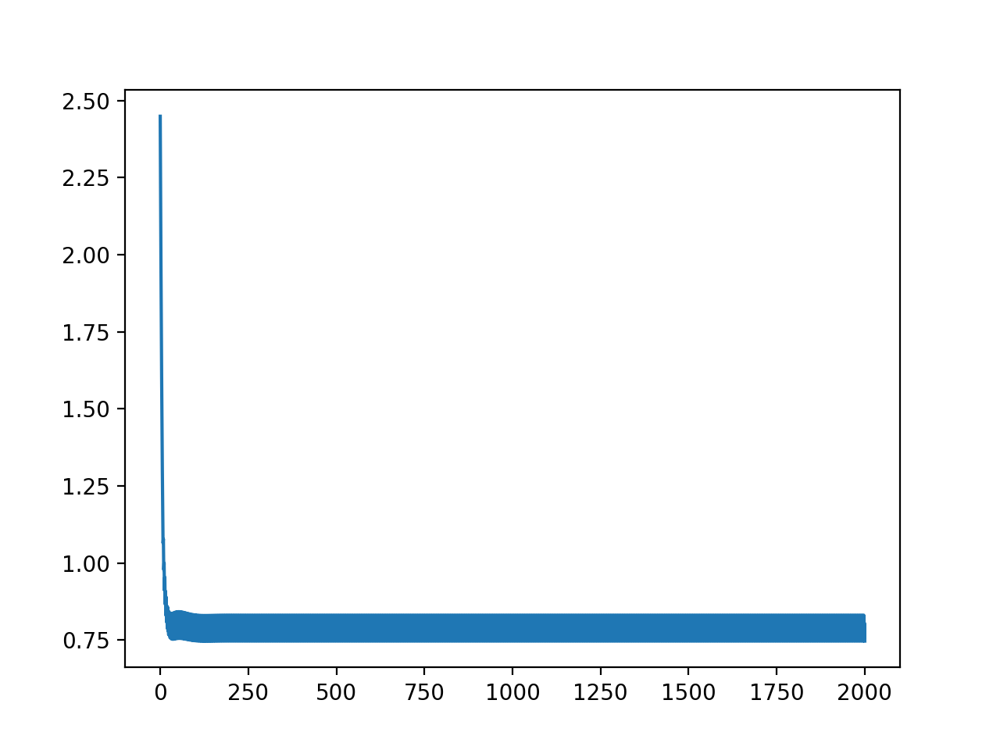

In [604]:
plt.figure()
plt.plot(YY[ix,istim,-1,:,iy])

In [1960]:
Wmy[2,1],Wmy[1,2]

(-2.144034644009146, -0.5218867289146812)

<IPython.core.display.Javascript object>


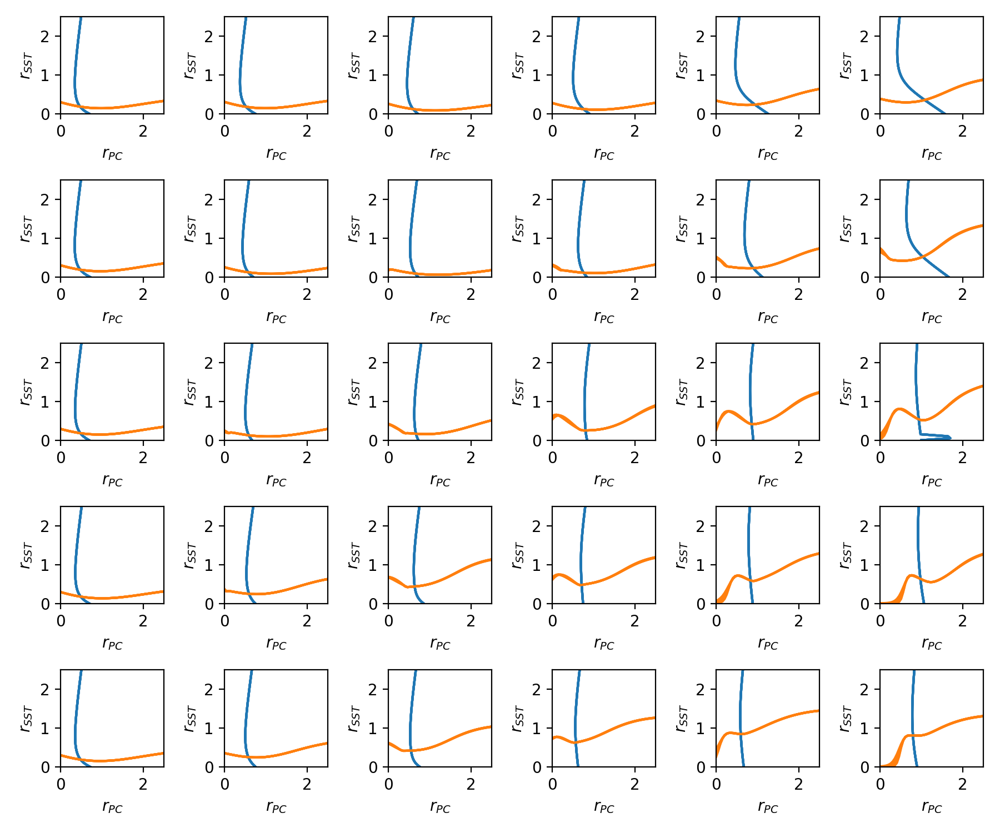

In [1986]:
mag = 1.5
plt.figure(figsize=(ncontrast*mag,nsize*mag))
# YY = np.zeros((Nfix,Nstim,Ny,Niter+1,nS*nQ))
ix = 0
iy = 1
for yy in [YY_ss]:#,YY_F2]:
    linestyles = ['solid','dashed']
    for istim in range(Nstim):
        plt.subplot(nsize,ncontrast,stim_vals[istim]+1)
        for it in np.arange(-1001,0,200):
            xvals = yy[iy,istim,:,it,ix]
            gd = xvals < max_val
            plt.plot(xvals[gd],yvals[gd],label='$dr_{PC}/dt=0$',c='C0',linestyle=linestyles[idir])
            xvals = yy[ix,istim,:,it,iy]
            gd = xvals < max_val
            plt.plot(yvals[gd],xvals[gd],label='$dr_{SST}/dt=0$',c='C1',linestyle=linestyles[idir])
    #     plt.legend()
        plt.xlabel('$r_{%s}$' % lbls[ix])
        plt.ylabel('$r_{%s}$' % lbls[iy])
#         plt.axis('equal')
        plt.ylim((0,1*max_val))
        plt.xlim((0,1*max_val))
    plt.tight_layout()

In [2101]:
nstar = len(trystars_i)
Niter = int(3e3)
fix_dim = [0,1,2,3]
Nfix = len(fix_dim)
# YY = [None for ifix in range(Nfix)]
Ny = 50
max_val = 2.5
yvals = np.linspace(0,max_val,Ny)
stim_vals = np.arange(30)
Nstim = len(stim_vals)
for istar in (0,): #range(nstar):
    print(istar)
#     ti,tj = trystars_i[istar],trystars_j[istar]
    Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wstar_dict['as_list'] #Wt[ti][tj]
    YY_ctrl = compute_steady_state(Wstar_dict['as_list'],Niter=int(5e2),dt=1e-1,perturbation_size=5e-2,max_val=None,Ny=None,fix_dim=None,stim_vals=None)

0
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


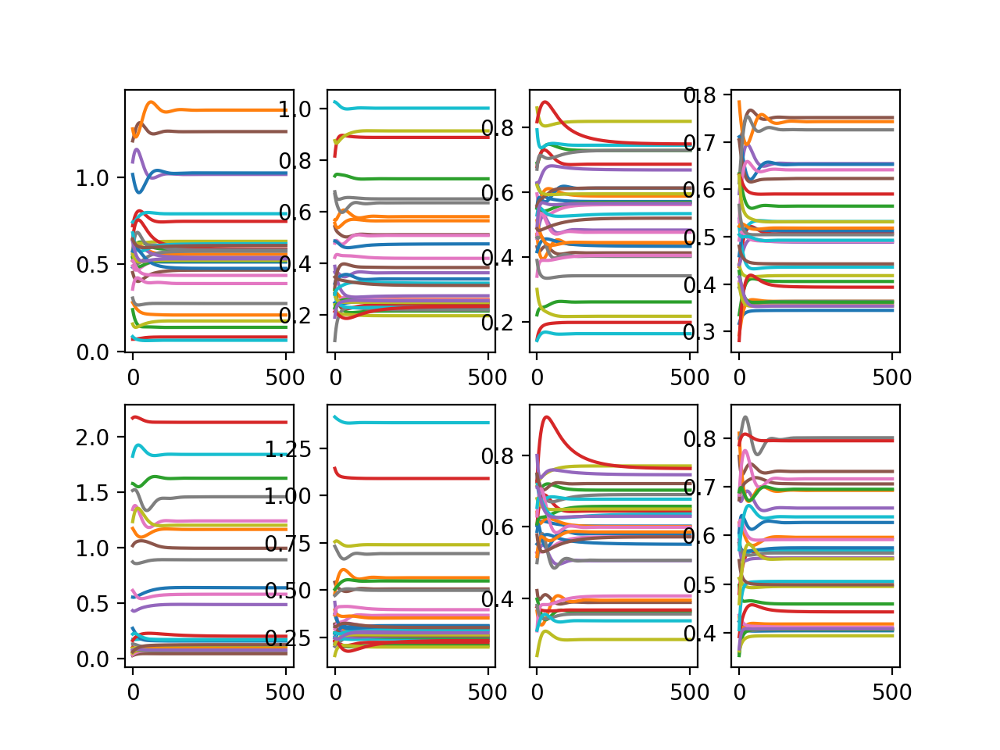

In [2104]:
plt.figure()
for icelltype in range(8):
    plt.subplot(2,4,icelltype+1)
    plt.plot(YY_ctrl[:,:,icelltype].T)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if __name__ == '__main__':


<IPython.core.display.Javascript object>


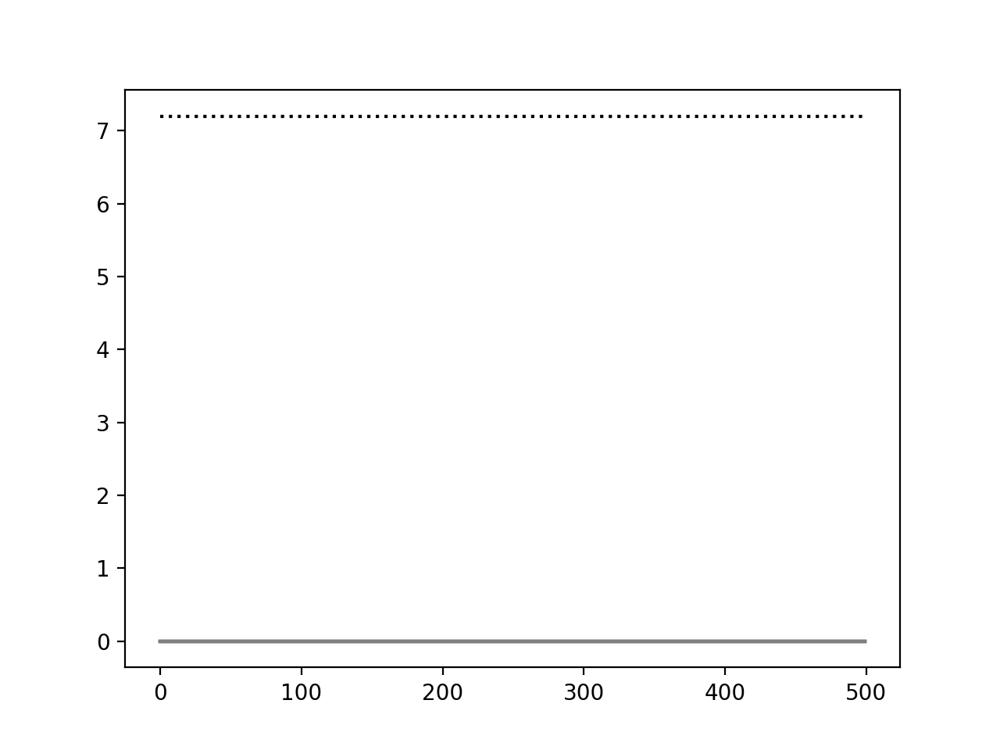

In [2105]:
istim = 29
iy = 0
others = np.arange(8)!=iy
# this_yy = YY_F2[iy,istim,:,iinit,:,:]
this_yy = YY_ss[iy,istim,:,:,:]
def fY(XX,YY):
    return compute_f_(resEta[istim]+u_fn(XX,YY,Wmx,Wmy,k,kappa),resXi[istim]+u_fn(XX,YY,Wsx,Wsy,k,kappa),s02)
speed = np.sum(np.abs(fY(XX[istim],this_yy)-this_yy)[:,:,others],-1)
plt.figure()
this_one = 25
plt.plot(speed[this_one,-500:].T,c='k',linestyle='dotted')
plt.plot(YY_ss[iy,istim,this_one,-500:,:])

In [1414]:
fY(XX[istim],this_yy).shape

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: overflow encountered in square
  


(50, 4001, 8)

<IPython.core.display.Javascript object>


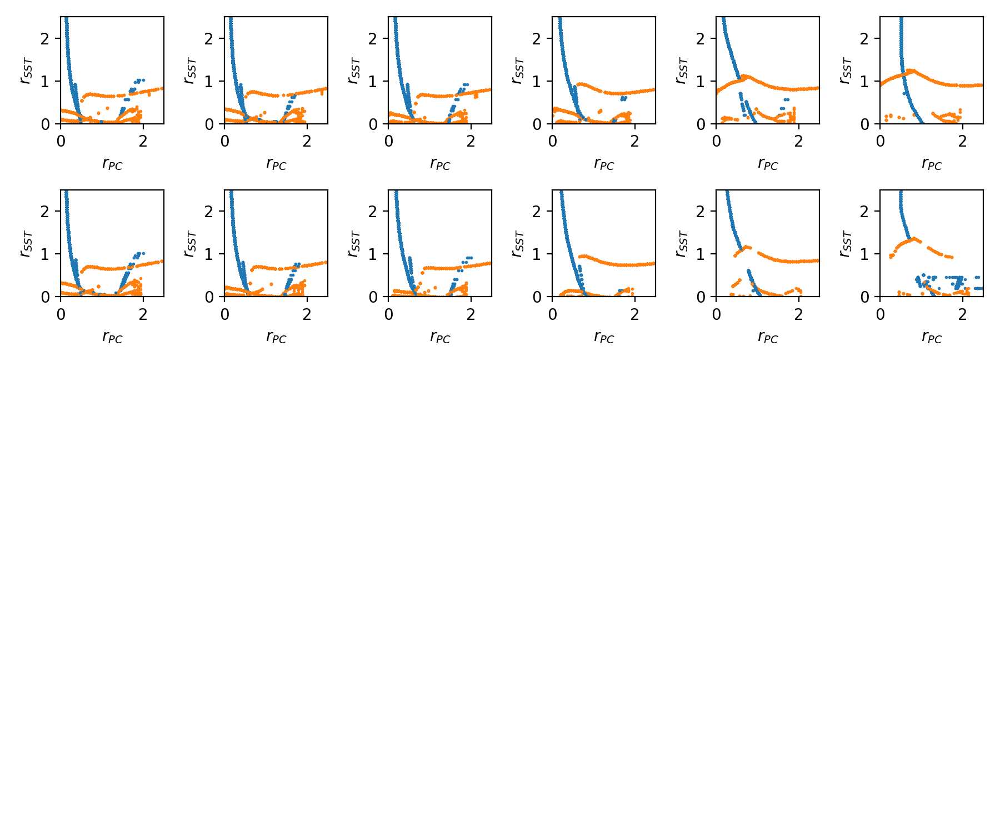

In [1399]:
mag = 1.5
plt.figure(figsize=(ncontrast*mag,nsize*mag))
# YY = np.zeros((Nfix,Nstim,Ny,Niter+1,nS*nQ))
ix = 0
iy = 1
idir = 0
for yy in [YY_F2]:
    linestyles = ['solid','dashed']
    for istim in range(12):#Nstim):
        def fY(YY):
            return compute_f_(resEta[stim_vals[istim]]+u_fn(XX[stim_vals[istim]],YY,Wmx,Wmy,k,kappa),resXi[stim_vals[istim]]+u_fn(XX[stim_vals[istim]],YY,Wsx,Wsy,k,kappa),s02)
        plt.subplot(nsize,ncontrast,stim_vals[istim]+1)
        for it in (-250,-100,-1):
            for iinit in range(Nx):
                this_yy = yy[iy,istim,:,iinit,it,:]
                xvals = yy[iy,istim,:,iinit,it,ix]
                gd = (xvals < max_val) & np.sum(np.abs(fY(this_yy)-this_yy),-1)<1e-4
                plt.scatter(xvals[gd],yvals[gd],label='$dr_{PC}/dt=0$',c='C0',linestyle=linestyles[idir],s=1)
                xvals = yy[ix,istim,:,iinit,it,iy]
                gd = xvals < max_val
                plt.scatter(yvals[gd],xvals[gd],label='$dr_{SST}/dt=0$',c='C1',linestyle=linestyles[idir],s=1)
    #     plt.legend()
        plt.xlabel('$r_{%s}$' % lbls[ix])
        plt.ylabel('$r_{%s}$' % lbls[iy])
#         plt.axis('equal')
        plt.ylim((0,1*max_val))
        plt.xlim((0,1*max_val))
    plt.tight_layout()

<IPython.core.display.Javascript object>


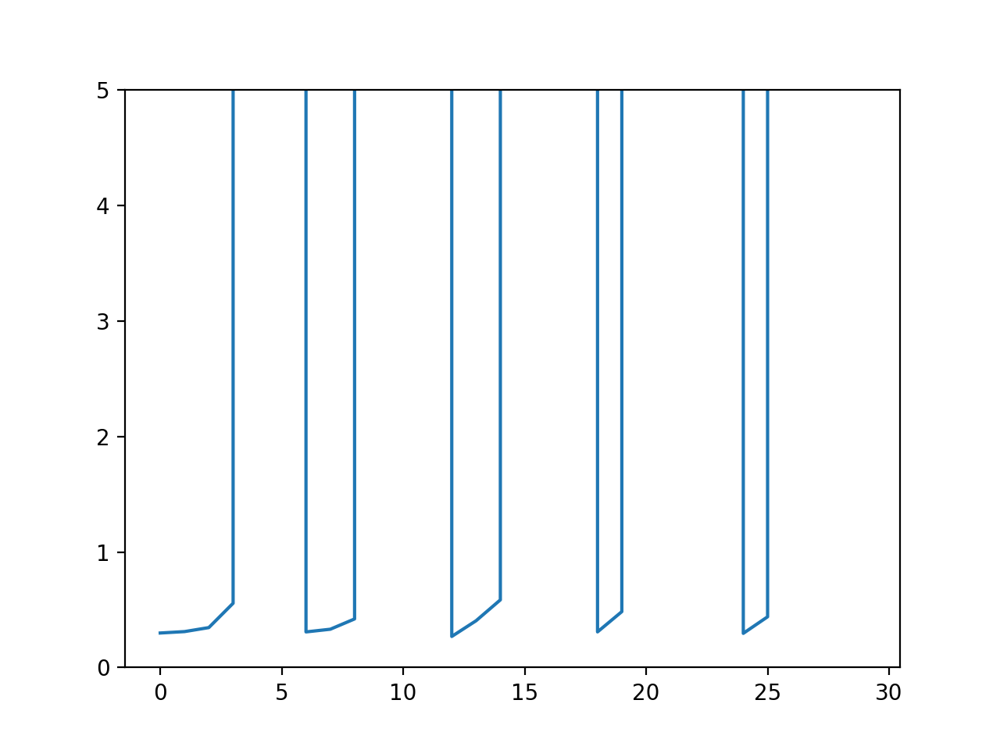

(0, 5)

In [873]:
plt.figure()
plt.plot(YY[iy,:,0,it,ix])
plt.ylim((0,5))

<IPython.core.display.Javascript object>


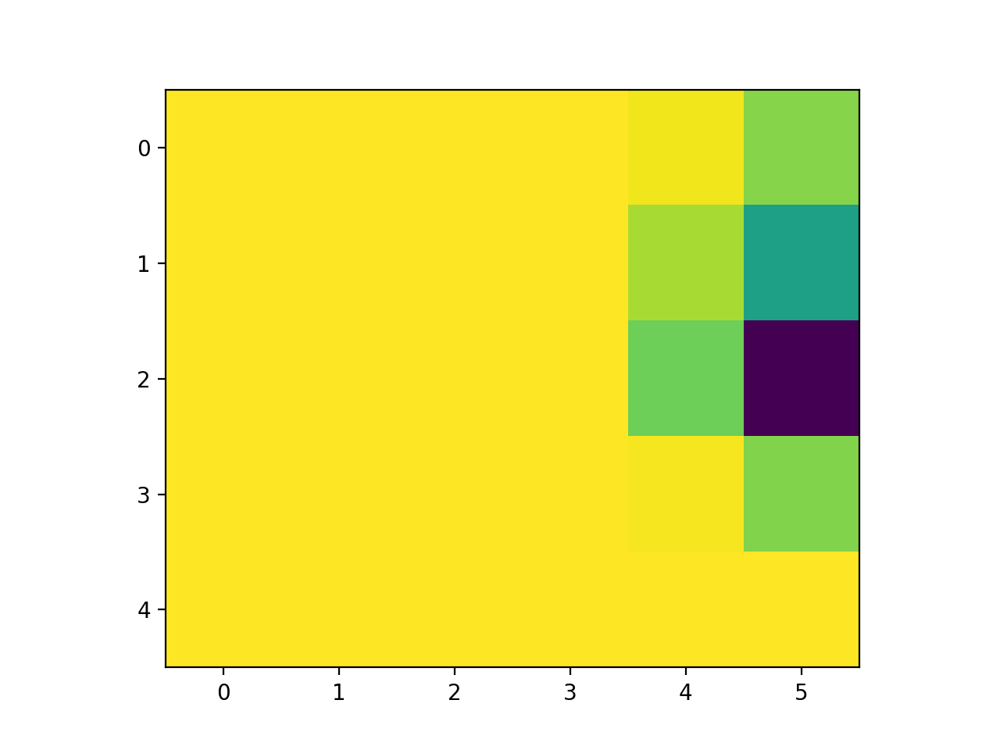

In [464]:
plt.figure()
istim = -12
plt.imshow((YY[0][:,1000,0]-YY[0][:,-1,0]).reshape((nsize,ncontrast)))

In [424]:
YY[0].shape

(30, 2001, 8)

<IPython.core.display.Javascript object>


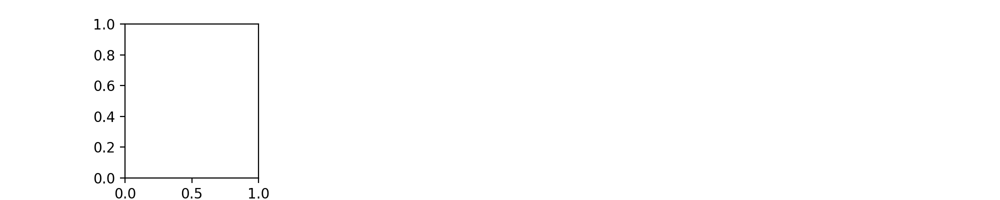

IndexError: too many indices for array

In [1268]:
mag = 2
plt.figure(figsize=(mag*ncelltypes,mag))
for icelltype in range(nQ):
    plt.subplot(1,ncelltypes,icelltype+1)
    plt.imshow(YY[:,:,-1,icelltype],vmin=0,interpolation='bilinear')
    plt.axis('off')

In [1278]:
nstar = len(trystars_i)
YY_no_vip = [None for istar in range(nstar)]
YY_no_sst = [None for istar in range(nstar)]
for istar in range(nstar):
    print(istar)
    ti,tj = trystars_i[istar],trystars_j[istar]
    Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wt[ti][tj]
    YY = compute_f_(Eta,Xi,s02)
    resEta = Eta - u_fn(XX,YY,Wmx,Wmy,k,kappa)
    resXi = Xi - u_fn(XX,YY,Wsx,Wsy,k,kappa)
    def fY(XX,YY,resEta,resXi):
        return compute_f_(u_fn(XX,YY,Wmx,Wmy,k,kappa)+resEta,u_fn(XX,YY,Wsx,Wsy,k,kappa)+resXi,s02)
    def thisfY(YY0):
        return fY(XX,YY0,resEta,resXi)
    def predict_YY_silencing(YY0,XX,resEta,resXi,silenced,eta=1e-4):
        def dYYdt(YY):
            return -YY + thisfY(YY)
        YY = YY0.copy() #np.zeros((nN,nS*nQ))
        dYY = np.ones_like(YY)
        iiter = 0
        while iiter < 1e4: #np.abs(dYY).sum()>1e-8*np.abs(YY).sum():
            iiter = iiter+1
            dYY = eta*dYYdt(YY)
            YY = YY + dYY
            YY[:,silenced] = 0
        return YY
    silenced = np.array((0,0,1,0,0,0,1,0),dtype='bool')
    YY_no_vip[istar] = predict_YY_silencing(YY,XX,resEta,resXi,silenced)
    silenced = np.array((0,1,0,0,0,1,0,0),dtype='bool')
    YY_no_sst[istar] = predict_YY_silencing(YY,XX,resEta,resXi,silenced)

0


In [1224]:
# plt.figure()
# inputs = XXhat[:,[0,2]]
# sort_inp = np.argsort(inputs[:,0])
# plt.scatter(inputs[:,0],inputs[:,1])

<IPython.core.display.Javascript object>


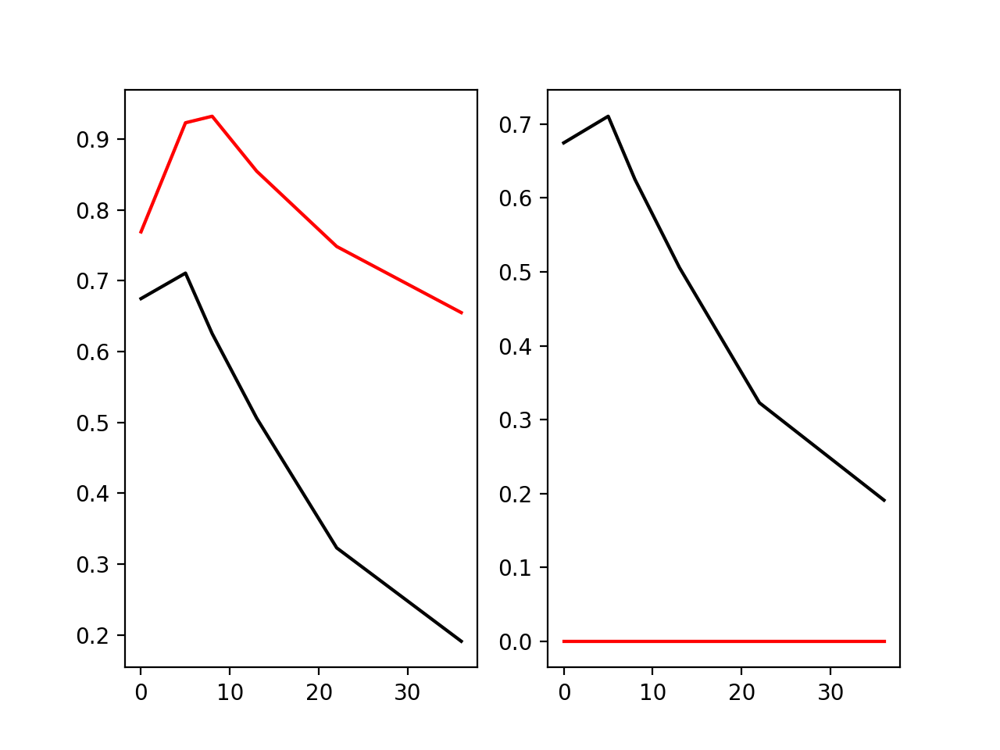

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:35: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


In [1270]:
plt.figure()
alpha1 = 0.25
ic = 2
icontrast = 5
colors = ['k','r']
def norm01(arr):
    return (arr-arr.min())/(arr.max()-arr.min())
for istar in range(nstar):
    ti,tj = trystars_i[istar],trystars_j[istar]
    Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wt[ti][tj]
    YY = compute_f_(Eta,Xi,s02)
    plt.subplot(1,2,1)
    usize0 = (0,5,8,13,22,36)
    sc = YY[:,ic].reshape((nsize,ncontrast))
    to_plot = np.concatenate(((sc[:,0].mean(),),sc[:,icontrast]))
    if istar == 0:
        avg_curves = np.zeros((2,2,)+to_plot.shape)
    avg_curves[0,0] = avg_curves[0,0] + to_plot/nstar
    plt.plot(usize0,to_plot,c=colors[0],alpha=alpha1)
    sc = YY_no_sst[istar][:,ic].reshape((nsize,ncontrast))
    to_plot = np.concatenate(((sc[:,0].mean(),),sc[:,icontrast]))
    avg_curves[0,1] = avg_curves[0,1] + to_plot/nstar
    plt.plot(usize0,to_plot,c=colors[1],alpha=alpha1)
    plt.subplot(1,2,2)
    usize0 = (0,5,8,13,22,36)
    sc = YY[:,ic].reshape((nsize,ncontrast))
    to_plot = np.concatenate(((sc[:,0].mean(),),sc[:,icontrast]))
    avg_curves[1,0] = avg_curves[1,0] + to_plot/nstar
    plt.plot(usize0,to_plot,c=colors[0],alpha=alpha1)
    sc = YY_no_vip[istar][:,ic].reshape((nsize,ncontrast))
    to_plot = np.concatenate(((sc[:,0].mean(),),sc[:,icontrast]))
    avg_curves[1,1] = avg_curves[1,1] + to_plot/nstar
    plt.plot(usize0,to_plot,c=colors[1],alpha=alpha1)
for imanip in range(2):
    plt.subplot(1,2,imanip+1)
    plt.plot(usize0,avg_curves[imanip,0],c=colors[0])
    plt.plot(usize0,avg_curves[imanip,1],c=colors[1])
    

<IPython.core.display.Javascript object>


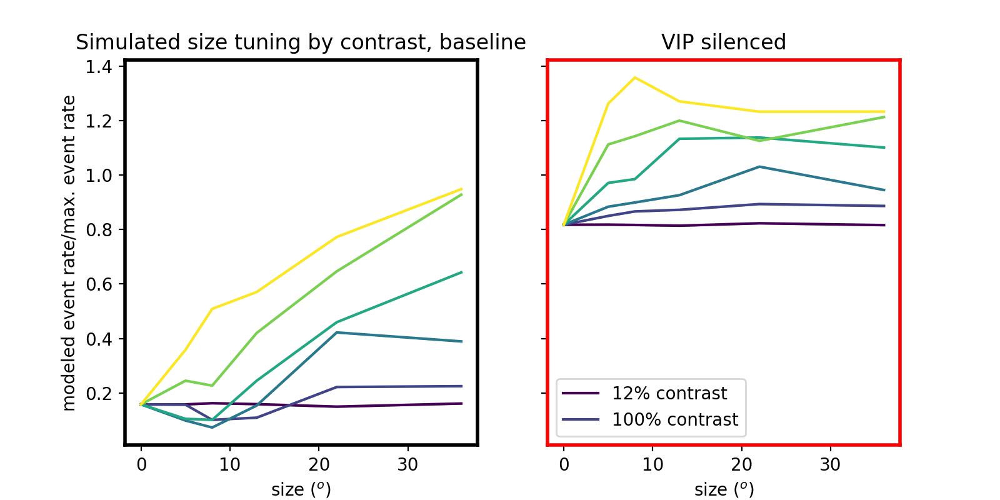

In [1281]:
fig,axes = plt.subplots(1,2,sharey=True,figsize=(8,4))
alpha1 = 0.25
ic = 1
icontrasts = np.arange(6)
colors = ['k','r']
colors = plt.cm.viridis(np.linspace(0,1,6))
nstar = 1
def norm01(arr):
    return (arr-arr.min())/(arr.max()-arr.min())
for icontrast in icontrasts:
    for istar in range(nstar):
        ti,tj = trystars_i[istar],trystars_j[istar]
        Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wt[ti][tj]
        YY = compute_f_(Eta,Xi,s02)
        usize0 = (0,5,8,13,22,36)
        sc = YY[:,ic].reshape((nsize,ncontrast))
        to_plot = np.concatenate(((sc[:,0].mean(),),sc[:,icontrast]))
        if istar == 0:
            avg_curves = np.zeros((2,2,)+to_plot.shape)
            to_plots = [np.zeros((0,)+to_plot.shape) for il in range(2)]
        avg_curves[1,0] = avg_curves[1,0] + to_plot/nstar
#         plt.subplot(1,2,1)
        to_plots[0] = np.concatenate((to_plots[0],to_plot[np.newaxis]))
#         plt.plot(usize0,to_plot,c=colors[icontrast],alpha=alpha1)
        sc = YY_no_vip[istar][:,ic].reshape((nsize,ncontrast))
        to_plot = np.concatenate(((sc[:,0].mean(),),sc[:,icontrast]))
        avg_curves[1,1] = avg_curves[1,1] + to_plot/nstar
#         plt.subplot(1,2,2)
#         plt.plot(usize0,to_plot,c=colors[icontrast],alpha=alpha1)
        to_plots[1] = np.concatenate((to_plots[1],to_plot[np.newaxis]))
    for il in range(2):
#         plt.subplot(1,2,il+1)
        axes[il].plot(usize0,avg_curves[1,il],c=colors[icontrast])
        lb,ub = ut.bootstrap(to_plots[il],pct=(16,84),fn=np.nanmean,axis=0)
        axes[il].fill_between(usize0,lb,ub,color=colors[icontrast],alpha=alpha1)
# plt.subplot(1,2,1)
# plt.title('Center-aligned, response to 12% contrast')
# plt.subplot(1,2,1)
axes[0].set_ylabel('modeled event rate/max. event rate')
axes[0].set_xlabel('size ($^o$)')
axes[1].set_xlabel('size ($^o$)')
plt.setp(axes[0].spines.values(),color='k',linewidth=2)
plt.setp(axes[1].spines.values(),color='r',linewidth=2)
axes[0].set_title('Simulated size tuning by contrast, baseline')
axes[1].set_title('VIP silenced')
axes[1].legend(['12% contrast','100% contrast'])
# plt.savefig('figures/modeled_vip_halo_size_tuning_by_contrast_fill_between.jpg',dpi=300)

In [428]:
(ti,),(tj,) = np.where(loss==np.min(loss)) #2*loss.min()
[Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,YY,Eta,Xi] = Wt[ti][tj]

/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


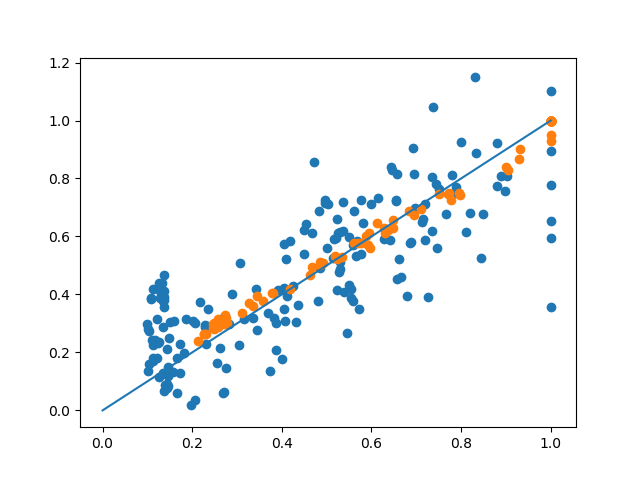

In [429]:
plt.figure()
XXhat = np.concatenate(Xhat,axis=1)
YYhat = np.concatenate(Yhat,axis=1)
plt.scatter(YYhat.flatten(),YY.flatten())
plt.scatter(XXhat.flatten(),XX.flatten())
plt.plot((0,1),(0,1))

/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


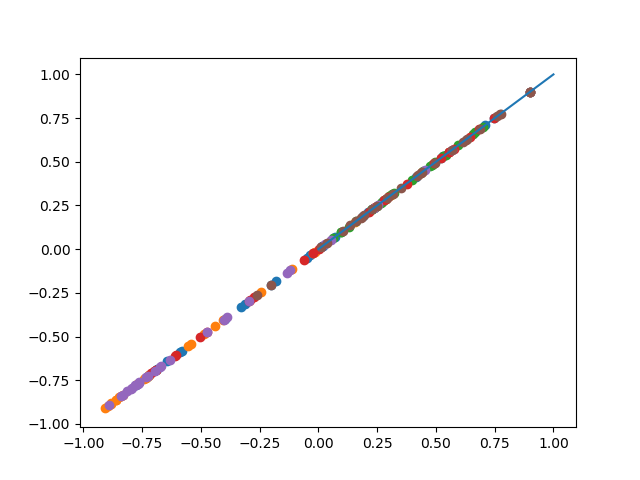

In [430]:
Etas = u_fn(XX,YY,Wmx,Wmy,k,kappa)
plt.figure()
for ic in range(6):
    plt.scatter(Eta[:,ic],Etas[:,ic])
plt.plot((0,1),(0,1))

/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


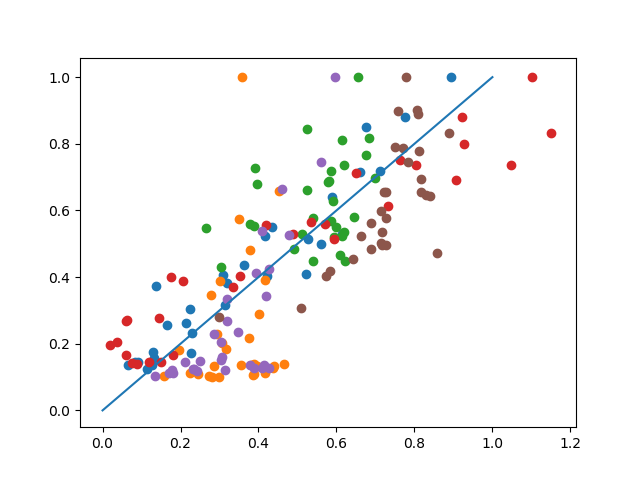

In [431]:
plt.figure()
YYs = compute_f_(Eta,Xi,s02)
for ic in range(6):
    plt.scatter(YY[:,ic],YYs[:,ic])
plt.plot((0,1),(0,1))

<IPython.core.display.Javascript object>


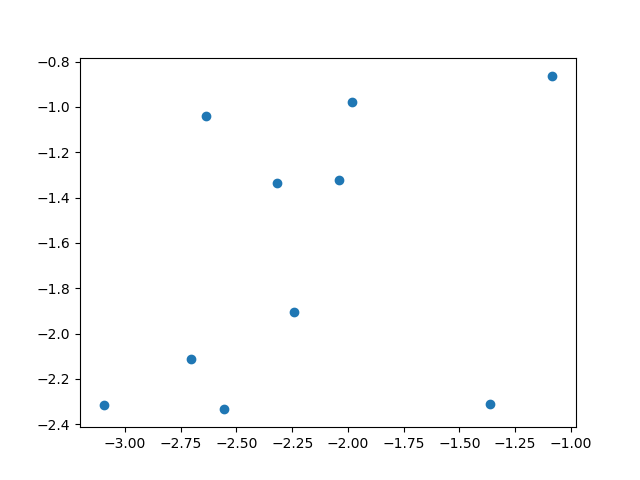

In [291]:
plt.figure()
plt.scatter(wmys[:,1,0],wmys[:,2,1])

In [514]:
wmys = np.concatenate([w[1][np.newaxis] for w in np.concatenate(Wt)],axis=0)
# trystar = np.argmax(wmys[:,1,0]*wmys[:,2,1])
# trystar = np.argmin(loss)

/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


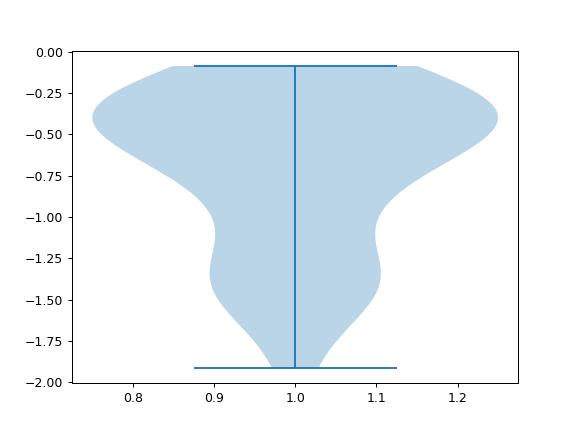

{'bodies': [<matplotlib.collections.PolyCollection at 0x7f1bdc083a90>],
 'cmaxes': <matplotlib.collections.LineCollection at 0x7f1bdb9cec50>,
 'cmins': <matplotlib.collections.LineCollection at 0x7f1bdc083790>,
 'cbars': <matplotlib.collections.LineCollection at 0x7f1bdc083990>}

In [516]:
plt.figure()
plt.violinplot(wmys[:,1,0])

/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


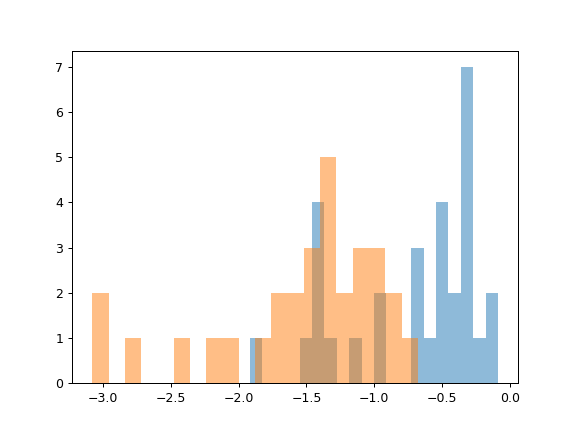

(array([2., 0., 1., 0., 0., 1., 0., 1., 1., 0., 1., 2., 2., 3., 5., 2., 3.,
        3., 2., 1.]),
 array([-3.08046601, -2.96038626, -2.84030651, -2.72022677, -2.60014702,
        -2.48006727, -2.35998753, -2.23990778, -2.11982804, -1.99974829,
        -1.87966854, -1.7595888 , -1.63950905, -1.51942931, -1.39934956,
        -1.27926981, -1.15919007, -1.03911032, -0.91903057, -0.79895083,
        -0.67887108]),
 <a list of 20 Patch objects>)

In [515]:
plt.figure()
plt.hist(wmys[:,1,0],bins=20,alpha=0.5)
plt.hist(wmys[:,2,1],bins=20,alpha=0.5)

In [518]:
ws = [np.concatenate([w[q][np.newaxis] for w in np.concatenate(Wt)],axis=0) for q in range(len(Wt[0][0]))]
[Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,YY,Eta,Xi] = ws

In [541]:
ws = [np.concatenate([Wt[ti][tj][q][np.newaxis] for ti,tj in zip(trystars_i,trystars_j)],axis=0) for q in range(len(Wt[0][0]))]
[Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,YY,Eta,Xi] = ws

/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


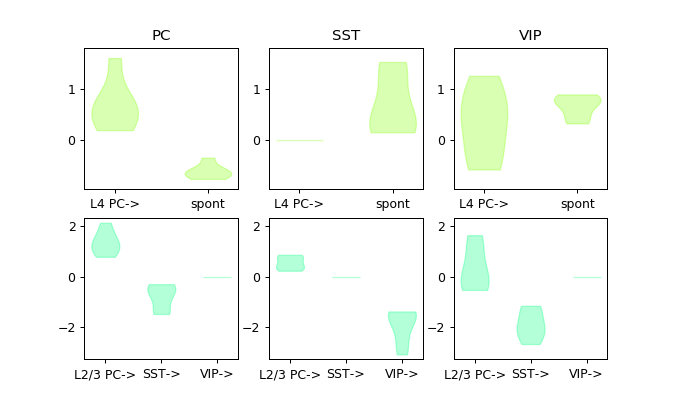

In [552]:
# ws = [np.concatenate([w[q][np.newaxis] for w in np.concatenate(Wt)],axis=0) for q in range(len(Wt[0][0]))]
# [Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,YY,Eta,Xi] = ws
plt.figure(figsize=(7.5,4.5))
for datas in [[Wmx,Wmy]]:#,[Wsx,Wsy]]:
    titles = ['PC','SST','VIP']
    data = datas[0]
    x = np.arange(1,data.shape[1]+1)
    xlbl = ['L4 PC->','spont']
    for icelltype in range(3):
        plt.subplot(2,3,icelltype+1)
        violin_parts = plt.violinplot([data[:,i,icelltype] for i in range(data.shape[1])],showextrema=False)
        for pc in violin_parts['bodies']:
            pc.set_facecolor([0.5,1,0.0])
            pc.set_edgecolor([0.5,1,0.0])
        plt.xticks(x,xlbl)
        plt.ylim(data.min()-0.2,data.max()+0.2)
        plt.title(titles[icelltype])
#     plt.figure(figsize=(7.5,2))
    data = datas[1]
    x = np.arange(1,data.shape[1]+1)
    xlbl = ['L2/3 PC->','SST->','VIP->']
    for icelltype in range(3):
        plt.subplot(2,3,3+icelltype+1)
#         plt.violinplot([data[:,i,icelltype] for i in range(data.shape[1])])
        violin_parts = plt.violinplot([data[:,i,icelltype] for i in range(data.shape[1])],showextrema=False)
        for pc in violin_parts['bodies']:
            pc.set_facecolor([0.0,1,0.5])
            pc.set_edgecolor([0.0,1,0.5])
        plt.xticks(x,xlbl)
        plt.ylim(data.min()-0.2,data.max()+0.2)
#         plt.title(titles[icelltype])
plt.savefig('violinplots_fit_weights.jpg',dpi=300)

/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


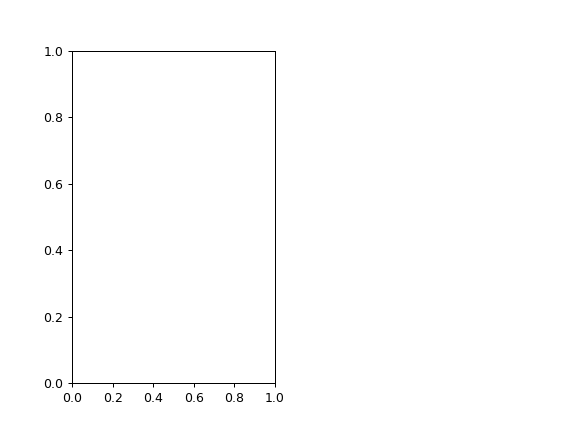

TypeError: list indices must be integers or slices, not tuple

In [543]:
plt.figure()
plt.subplot(1,2,1)
for ic in (0,):
    sca.scatter_size_contrast(YY[:,ic],YY_no_vip[:,ic])
    plt.plot((0,1),(0,1),c='k')
plt.axis('equal')
plt.subplot(1,2,2)
for ic in (0,):
    sca.scatter_size_contrast(YY[:,ic],YY_no_sst[:,ic])
    plt.plot((0,1),(0,1),c='k')
plt.axis('equal')

<IPython.core.display.Javascript object>


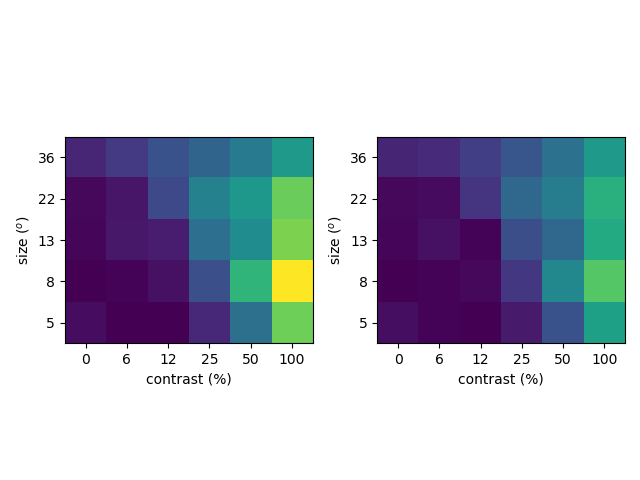

In [327]:
plt.figure()
ic = 0
plt.subplot(1,2,1)
sca.show_size_contrast(YY[:,ic].reshape((nsize,ncontrast)),flipud=True,vmax=YY[:,ic].max())
plt.subplot(1,2,2)
sca.show_size_contrast(YY_no_vip[:,ic].reshape((nsize,ncontrast)),flipud=True,vmax=YY[:,ic].max())
plt.tight_layout()

<IPython.core.display.Javascript object>


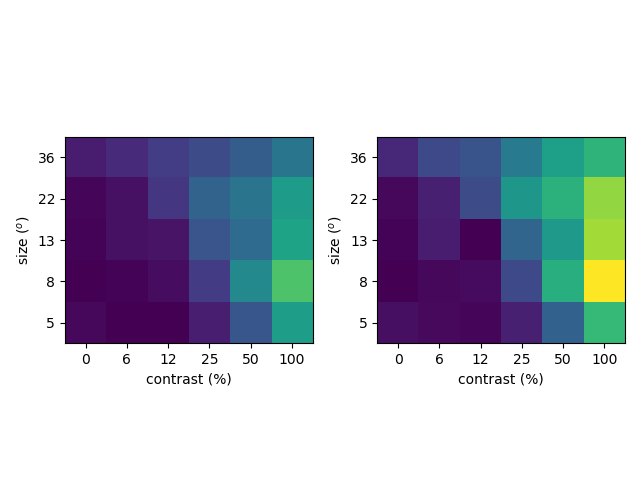

In [330]:
plt.figure()
ic = 0
mx = np.maximum(YY[:,ic].max(),YY_no_sst[:,ic].max())
plt.subplot(1,2,1)
sca.show_size_contrast(YY[:,ic].reshape((nsize,ncontrast)),flipud=True,vmax=mx)
plt.subplot(1,2,2)
sca.show_size_contrast(YY_no_sst[:,ic].reshape((nsize,ncontrast)),flipud=True,vmax=mx)
plt.tight_layout()

<IPython.core.display.Javascript object>


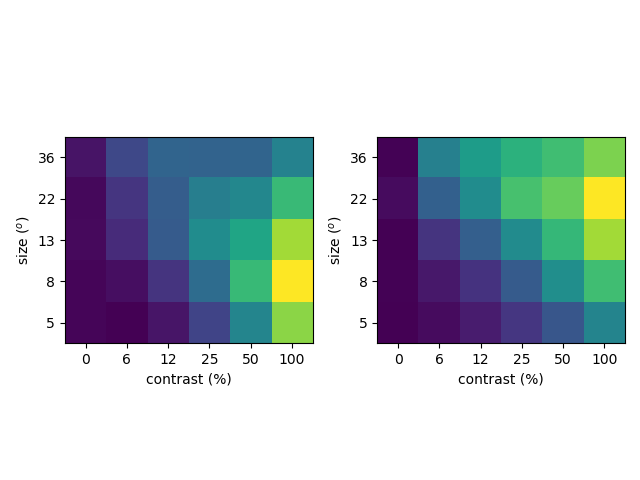

<IPython.core.display.Javascript object>


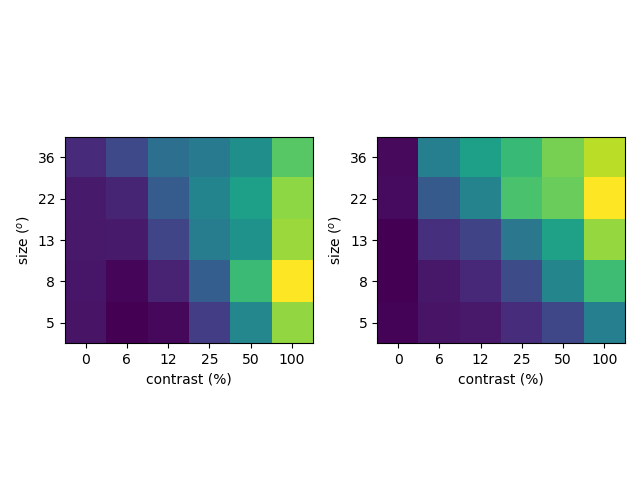

<IPython.core.display.Javascript object>


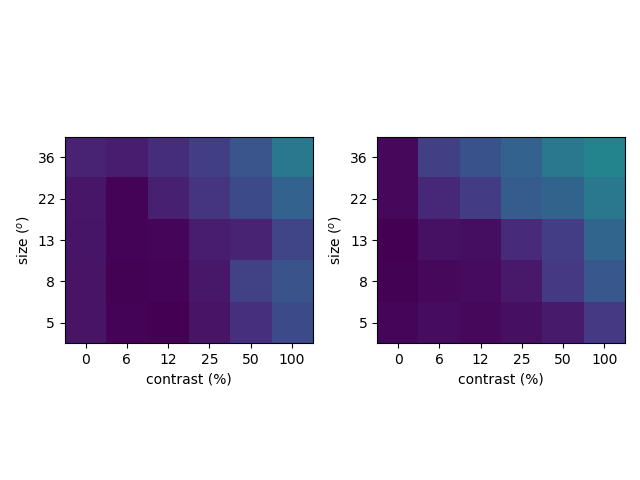

In [296]:
plt.figure()
reload(sca)
plt.subplot(1,2,1)
sca.show_size_contrast(YYhat[:,0].reshape((5,6)),flipud=True)
plt.subplot(1,2,2)
sca.show_size_contrast(YYhat[:,3].reshape((5,6)),flipud=True)
plt.tight_layout()

plt.figure()
reload(sca)
plt.subplot(1,2,1)
sca.show_size_contrast(YY[:,0].reshape((5,6)),flipud=True)
plt.subplot(1,2,2)
sca.show_size_contrast(YY[:,3].reshape((5,6)),flipud=True)
plt.tight_layout()

plt.figure()
reload(sca)
plt.subplot(1,2,1)
sca.show_size_contrast(YY_no_vip[:,0].reshape((5,6)),flipud=True,vmax=YY[:,0].max())
plt.subplot(1,2,2)
sca.show_size_contrast(YY_no_vip[:,3].reshape((5,6)),flipud=True,vmax=YY[:,3].max())
plt.tight_layout()

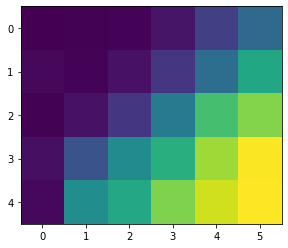

In [382]:
plt.figure()
plt.imshow(XX[:,2].reshape((5,6)))

In [383]:
vip_silencing = np.array((1,1,0,1,1,0))[np.newaxis,:]
Etas = u_fn(XX,YY,Wmx,Wmy,k)
Eta_no_vip = u_fn(XX,vip_silencing*YY,Wmx,Wmy,k) + Eta - Etas
YY_no_vip = compute_f_(Eta_no_vip,Xi,s02)*vip_silencing

In [ ]:
labels = ['Wmx','Wmy','Wsx','Wsy','s02','k','Y','momentum','loss']
Wstar_dict = {}
for i,label in enumerate(labels):
    Wstar_dict[label] = Wstar_t[i]

In [ ]:
evaluate_stability(W0my,k0)

In [ ]:
t = 999
W0mx,W0my,W0sx,W0sy,s020,k0 = [Wstar_t2[i][t].copy() for i in range(6)]

In [ ]:
nbeta = 51
loss = np.zeros((nbeta,))
stability = np.zeros((nbeta,))
betas = np.linspace(-1,1,nbeta)
vecY = np.random.randn(nQ,nQ)
vecX = np.random.randn(nP,nQ)
for ibeta,beta in enumerate(betas):
    perturbationY = beta*vecY
    perturbationX = beta*vecX
#     perturbationY = beta*np.array(((-1,0,0),(0,0,-1),(0,-1,0))) #beta*np.array(((2,0,0),(0,0,0),(0,0,0))) #perturbationY = beta*np.array(((0,0,0),(0,0,-1),(0,0,0))) # np.array(((0,0,0),(-1,0,0),(0,0,0)))
#     perturbationX = beta*np.array(((-1,0,0),(0,0,0))) #beta*np.array(((-1,0,0),(0,0,0))) #perturbationX = beta*np.array(((0,0,1),(0,0,0)))
#     perturbationSY = 0*beta*np.array(((0,0,0),(0,0,1),(0,0,0)))
    Wmy_beta = perturbationY+W0my.copy()
    Wmx_beta = perturbationX+W0mx.copy()
#     Wsy_beta = perturbationSY+W0sy.copy()
    loss[ibeta] = evaluate_LW(X.copy(),Yhat.copy(),pop_rate_fn=f_miller_troyer,neuron_rate_fn=evaluate_f_mt,Y0=Y0.copy(),W0mx=Wmx_beta,W0my=Wmy_beta,W0sx=W0sx.copy(),W0sy=W0sy,s020=s020.copy(),k0=k0.copy(),bounds=bounds,weight=weight)
    stability[ibeta] = evaluate_stability(Wmy_beta,k0)

In [ ]:
plt.figure()
lkat = stability < 0
plt.plot(betas[lkat],loss[lkat])
plt.plot(betas[lkat],stability[lkat])
plt.ylim(-1,0.5)

In [ ]:
(betas[lkat][np.argmin(loss[lkat])],np.min(loss[lkat]))

In [ ]:
beta_star = betas[lkat][np.argmin(loss[lkat])]

In [ ]:
niter = int(1e3)
eta = 0.3
gamma = 0.9
weight = np.array((0,1,0))
beta = 0
perturbationY = beta*beta_star*vecY*1e-2
perturbationX = beta*beta_star*vecX*1e-2
# perturbationY = 0*beta*np.array(((-1,0,0),(0,0,-1),(0,-1,0))) #beta*np.array(((2,0,0),(0,0,0),(0,0,0))) #perturbationY = beta*np.array(((0,0,0),(0,0,-1),(0,0,0))) # np.array(((0,0,0),(-1,0,0),(0,0,0)))
# perturbationX = 0*beta*np.array(((-1,0,0),(0,0,0))) #beta*np.array(((-1,0,0),(0,0,0))) #perturbationX = beta*np.array(((0,0,1),(0,0,0)))
# # perturbationSY = beta*np.array(((0,0,0),(0,0,1),(0,0,0)))
# thisY0 = np.ones_like(Y0)
Y0 = [np.concatenate([x.mean(0)[:,np.newaxis] for x in Yhat[ialign]],axis=1) for ialign in range(npixels)]
Wstar_t2 = fit_W_momentum(X.copy(),Yhat.copy(),pop_rate_fn=f_miller_troyer,neuron_rate_fn=evaluate_f_mt,Y0=Y0.copy(),W0mx=perturbationX+W0mx.copy(),W0my=perturbationY+W0my.copy(),W0sx=W0sx.copy(),W0sy=W0sy.copy(),s020=s020.copy(),k0=k0.copy(),bounds=bounds,niter=niter,weight=weight,eta=eta,gamma=gamma,barrier_wt=100e-4)#,eta_decay=eta_decay)

In [ ]:
np.linalg.eig(Wstar_dict2['Wmy'][400]-np.eye(nQ))

In [ ]:
titles = ['PC','SST','VIP']
t = 500
plt.figure(figsize=(6,2))
lbl = 'Wmx'
data = Wstar_dict2[lbl][t]
x = np.arange(data.shape[0])
xlbl = ['L4 PC->','spont']
for icelltype in range(3):
    plt.subplot(1,3,icelltype+1)
    plt.bar(x,data[:,icelltype])
    plt.xticks(x,xlbl)
    plt.ylim(data.min()-0.2,data.max()+0.2)
    plt.title(titles[icelltype])

plt.figure(figsize=(9,2))
lbl = 'Wmy'
data = Wstar_dict2[lbl][t]
x = np.arange(data.shape[0])
xlbl = ['L2/3 PC->','SST->','VIP->']
for icelltype in range(3):
    plt.subplot(1,3,icelltype+1)
    plt.bar(x,data[:,icelltype])
    plt.xticks(x,xlbl)
    plt.ylim(data.min()-0.2,data.max()+0.2)
    plt.title(titles[icelltype])
    
plt.figure(figsize=(6,2))
lbl = 'Wsx'
data = Wstar_dict2[lbl][t]
x = np.arange(data.shape[0])
xlbl = ['L4 PC->','spont']
for icelltype in range(3):
    plt.subplot(1,3,icelltype+1)
    plt.bar(x,data[:,icelltype])
    plt.xticks(x,xlbl)
    plt.ylim(data.min()-0.2,data.max()+0.2)
    plt.title(titles[icelltype])

plt.figure(figsize=(9,2))
lbl = 'Wsy'
data = Wstar_dict2[lbl][t]
x = np.arange(data.shape[0])
xlbl = ['L2/3 PC->','SST->','VIP->']
for icelltype in range(3):
    plt.subplot(1,3,icelltype+1)
    plt.bar(x,data[:,icelltype])
    plt.xticks(x,xlbl)
    plt.ylim(data.min()-0.2,data.max()+0.2)
    plt.title(titles[icelltype])


In [ ]:
#Wstar_dict = np.load('w_over_time_miller_troyer_data_loss.npy',allow_pickle=True)[()]

In [ ]:
Wstar_t_init = [ww[-1].copy() for ww in Wstar_t2]
W0mx,W0my,W0sx,W0sy,s020 = [Wstar_t_init[i].copy() for i in range(5)]
Y0 = Wstar_t_init[-3].copy()

In [ ]:
niter = int(1e4)
eta = 1
gamma = 0.9
eta_decay = 1e-3
weight = np.array((1,1,1))
thisY0 = np.ones_like(Y0)
Wstar_t_novar = fit_W_momentum(X.copy(),Yhat.copy(),pop_rate_fn=f_miller_troyer,neuron_rate_fn=evaluate_f_mt,Y0=thisY0,W0mx=W0mx.copy(),W0my=W0my.copy(),W0sx=W0sx.copy(),W0sy=W0sy.copy(),s020=s020.copy(),bounds=bounds,niter=niter,weight=weight,eta=eta,gamma=gamma)#,eta_decay=eta_decay)

In [ ]:
# niter = int(1e3)
plt.figure()
for i in range(4):
    plt.subplot(2,2,i+1)
    plt.plot(Wstar_t2[i].reshape((niter+1,-1)))
plt.figure()
plt.plot(Wstar_t2[4].reshape((niter+1,-1)))

In [ ]:
# labels = ['Wmx','Wmy','Wsx','Wsy','s02','Y','momentum','loss']
# Wstar_dict = {}
# for i,label in enumerate(labels):
#     Wstar_dict[label] = Wstar_t[i]
# np.save('w_over_time_miller_troyer_data_loss.npy',Wstar_dict,allow_pickle=True)

In [ ]:
# labels = ['Wmx','Wmy','Wsx','Wsy','s02','Y','momentum','loss']
#Wstar_dict = {}
#for i,label in enumerate(labels):
#    Wstar_dict[label] = Wstar_t[i]


In [ ]:
def plot_tuning_and_loss(this_Wstar):
    plt.figure()
    plt.plot((this_Wstar[-3]/this_Wstar[-3].sum(1)[:,np.newaxis]).reshape((niter+1,-1)))
    plt.figure()
    plt.plot(this_Wstar[-1].reshape((niter+1,-1)))

In [ ]:
#niter = 300
plot_tuning_and_loss([x[:niter+1] for x in Wstar_t2])

In [ ]:
def scatter_results_spatial(this_Wstar,t=-1):
    plt.figure(figsize=(9,6))
    celltype = ['PC','SST','VIP']
    ialign = 0
    for ialign in range(2):
        for i in range(3):
            plt.subplot(2,3,3*ialign+i+1)
            plt.title(celltype[i])
            xx = Yhat[ialign][i].mean(0)/Yhat[ialign][i].mean(0).sum()
            yy = this_Wstar[-3][t,:,3*ialign+i]/this_Wstar[-3][t,:,3*ialign+i].sum()
            sca.scatter_size_contrast(xx,yy)
            plt.plot((0,xx.max()),(0,xx.max()),c='k')
            plt.xlabel('measured')
            plt.ylabel('modeled')
            plt.tight_layout()

In [ ]:
t = 500
scatter_results_spatial(Wstar_t2,t=t) #int(5e3))
# plt.savefig('figures/pc_sst_vip_measured_modeled_miller_troyer.pdf')

In [ ]:
def gaussian_fn(mu,sigma):
    return lambda x: 1/np.sqrt(2*np.pi)/np.abs(sigma)*np.exp(-0.5*(x-mu)/sigma**2)
xs = np.linspace(0,1,100)
ipt = 0
# plt.figure()
# for icelltype in range(2):
#     plt.plot(xs,gaussian_fn(um_fn(X[ipt],Y[ipt])[icelltype],us_fn(X[ipt],Y[ipt])[icelltype])(xs))

In [224]:
iiter = -1
Wmx,Wmy,Wsx,Wsy = [Wstar_t[i][iiter] for i in range(4)]

def fXY(x,y):
    return f_miller_troyer(x @ Wmx + y @ Wmy, x @ Wsx + y @ Wsy)

def u_fn_fn(Wx,Wy):
    return lambda x,y: x @ Wx + y @ Wy

def um_fn(x,y):
    return u_fn_fn(Wmy,Wmx)(x,y)

def us_fn(x,y):
    return u_fn_fn(Wsy,Wsx)(x,y)

# Ysolns = compute_Y_nonlinear_t_evolution(X,Wmx,Wmy,Wsx,Wsy,f_miller_troyer,Y0=Wstar_t[-2][iiter+1].copy())

NameError: name 'Wstar_t' is not defined

In [327]:
Xlbl = [['L4','spont'],['PC','SST','VIP']]
Ylbl = ['PC','SST','VIP']

In [283]:
for i in range(2):
    values0 = np.round(Wstar_t_novar[i][-1],decimals=2)
    values1 = np.round(Wstar_t_novar[i+2][-1],decimals=2)
    to_print = np.zeros_like(values0,dtype='<U32')
    if np.mod(i,2)==0:
        for i in range(to_print.shape[0]):
            for j in range(to_print.shape[1]):
                to_print[i,j] = Xlbl[0][i] + ' -> ' + Xlbl[1][j] + ': ' + str(values0[i,j]) + ' +/- ' + str(values1[i,j])
    else: 
        for i in range(to_print.shape[0]):
            for j in range(to_print.shape[1]):
                to_print[i,j] = Ylbl[i] + ' -> ' + Ylbl[j] + ': ' + str(values0[i,j]) + ' +/- ' + str(values1[i,j])
    print(to_print)
    print('\n')
# for i in range(4,5):
#     values = np.round(Wstar_t[i][-1],decimals=2)
#     print(values)

NameError: name 'Wstar_t_novar' is not defined

<IPython.core.display.Javascript object>


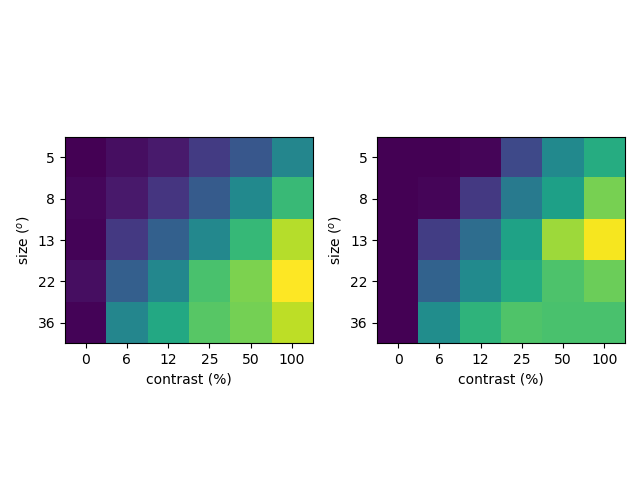

<IPython.core.display.Javascript object>


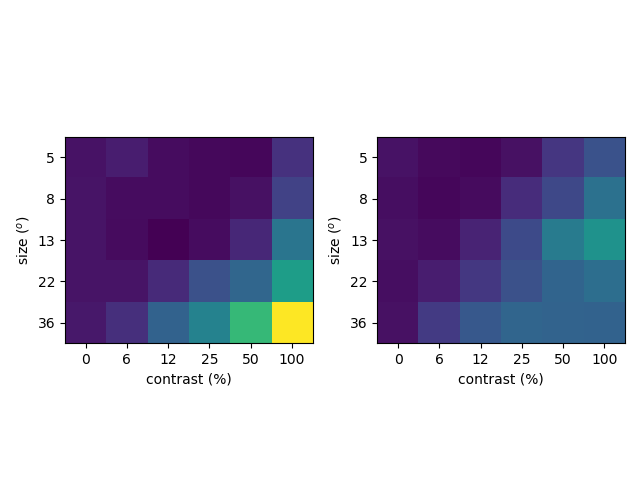

<IPython.core.display.Javascript object>


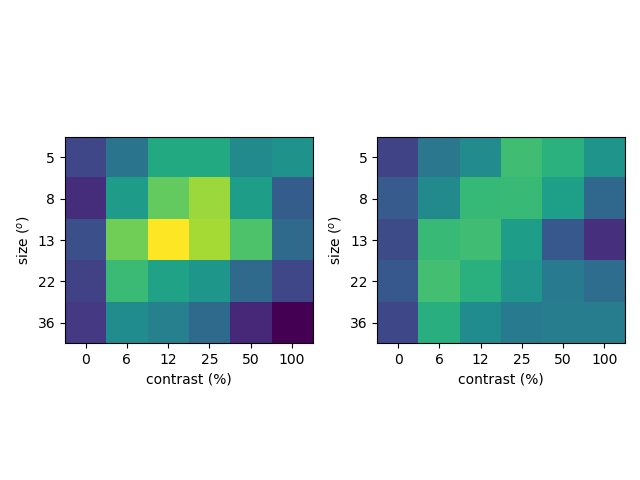

In [541]:
#lbl = ['pc','sst','vip']
#for icelltype in range(3):
#    this_Wstar = Wstar_t_novar
#    t = -1
#    display_model_fit(Yhat[icelltype].mean(0)/Yhat[icelltype].mean(0).sum(),this_Wstar[-3][t,:,icelltype]/this_Wstar[-3][t,:,icelltype].sum())
#    plt.savefig('figures/' + lbl[icelltype] + '_measured_modeled.pdf')

In [585]:
labels = ['Wmx','Wmy','Wsx','Wsy','s02','Y','momentum','loss']
Wstar_dict = {}
for i,label in enumerate(labels):
    Wstar_dict[label] = Wstar_t[i]

In [586]:
np.save('w_over_time_miller_troyer_data_loss_momentum.npy',Wstar_dict,allow_pickle=True)

In [270]:
def scatter_results(this_Wstar,t=-1):
    plt.figure(figsize=(9,3))
    celltype = ['PC','SST','VIP']
    for i in range(3):
        plt.subplot(1,3,i+1)
        plt.title(celltype[i])
        xx = Yhat[i].mean(0)/Yhat[i].mean(0).sum()
        yy = this_Wstar[-3][t,:,i]/this_Wstar[-3][t,:,i].sum()
        sca.scatter_size_contrast(xx,yy)
        plt.plot((0,xx.max()),(0,xx.max()),c='k')
        plt.xlabel('measured')
        plt.ylabel('modeled')
        plt.tight_layout()

In [1]:
icelltype = 3
u,s,v = np.linalg.svd(Rs[icelltype][~np.isnan(Rs[icelltype][:,0])])
# plt.figure()
# plt.imshow(Rs[1][])

NameError: name 'np' is not defined

<IPython.core.display.Javascript object>


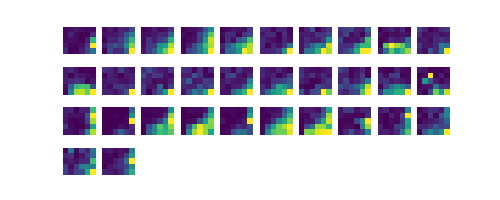

In [500]:
ut.imshow_in_rows(Rs[icelltype][~np.isnan(Rs[icelltype][:,0])][np.where(np.logical_and(u[:,0]<np.percentile(u[:,0],52.5),u[:,0]>np.percentile(u[:,0],47.5)))].reshape((-1,5,6)))

<IPython.core.display.Javascript object>


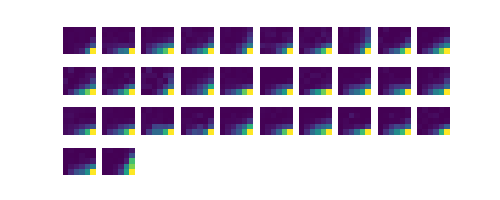

In [501]:
ut.imshow_in_rows(Rs[icelltype][~np.isnan(Rs[icelltype][:,0])][np.where(u[:,0]<np.percentile(u[:,0],5))].reshape((-1,5,6)))

<IPython.core.display.Javascript object>


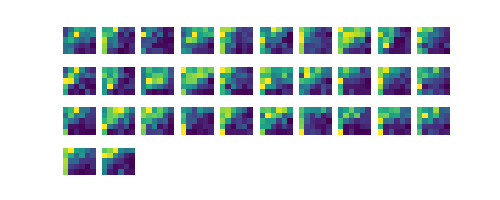

In [502]:
ut.imshow_in_rows(Rs[icelltype][~np.isnan(Rs[icelltype][:,0])][np.where(u[:,0]>np.percentile(u[:,0],95))].reshape((-1,5,6)))

<IPython.core.display.Javascript object>


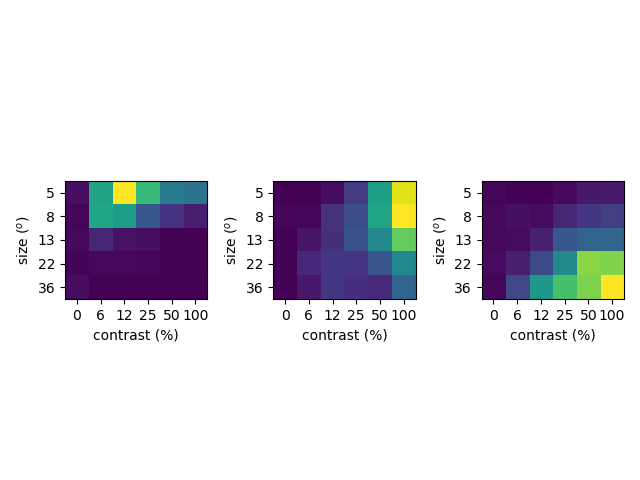

In [508]:
# ut.imshow_in_rows(Rs[1][~np.isnan(Rs[1][:,0])][np.where(u[:,0]>np.percentile(u[:,0],95))].reshape((-1,5,6)))
lower = np.where(u[:,0]<np.percentile(u[:,0],5))[0][28]
middle = np.where(np.logical_and(u[:,0]<np.percentile(u[:,0],52.5),u[:,0]>np.percentile(u[:,0],47.5)))[0][19]
upper = np.where(u[:,0]>np.percentile(u[:,0],95))[0][90]
plt.figure()
for i,thisone in enumerate([upper,middle,lower]):
    plt.subplot(1,3,i+1)
    sca.show_size_contrast(Rs[1][~np.isnan(Rs[1][:,0])][thisone].reshape((5,6)))
plt.tight_layout()
plt.savefig('figures/l23_pc_variability.pdf')

<IPython.core.display.Javascript object>


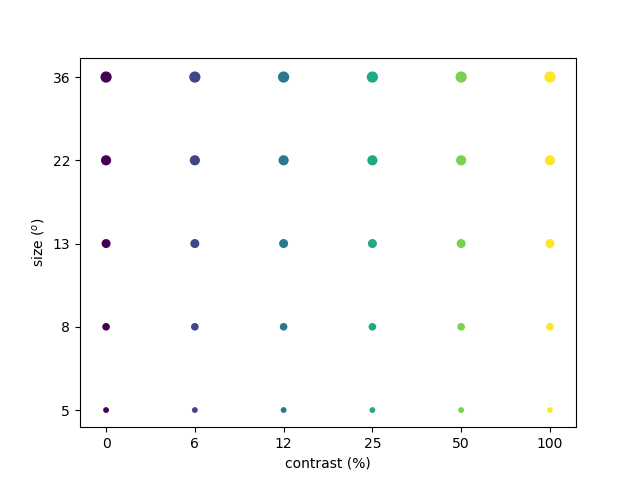

In [519]:
plt.figure()
xx,yy = np.meshgrid(np.arange(6),np.arange(5))
xx = xx.flatten()
yy = yy.flatten()
sca.scatter_size_contrast(xx,yy)
plt.xticks(np.arange(6),(0,6,12,25,50,100))
plt.xlabel('contrast (%)')
plt.yticks(np.arange(5),(5,8,13,22,36))
plt.ylabel('size ($^o$)')
plt.savefig('figures/measured_modeled_legend.pdf')
# plt.axis('off')

In [278]:
#niter = int(1e3)
#Ws = [Wstar_t[i][-1].copy() + 1e-2*np.random.randn(*Wstar_t[i][-1].shape) for i in range(4)]
#Wstar_t2 = fit_W_linearized_pointwise(X.copy(),Yhat.copy(),f_miller_troyer,Y0=Yhat.copy(),W0mx=Ws[0],W0my=Ws[1],W0sx=Ws[2],W0sy=Ws[3],bounds=bounds,niter=niter,weight=np.array((1,10,1)))
#scatter_results(Wstar_t2)

In [308]:
def pca_denoise(arr,Npc):
    u,s,v = np.linalg.svd(arr)
    return u[:,:Npc] @ np.diag(s[:Npc]) @ v[:Npc,:]

In [309]:
Rpc2 = pca_denoise(Rpc[~np.isnan(Rpc.sum(1))],10)

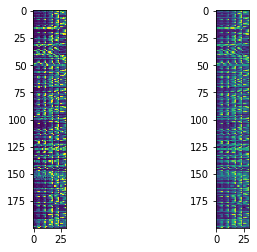

In [312]:
plt.figure()
plt.subplot(1,2,1)
plt.imshow(Rpc[:200])
plt.subplot(1,2,2)
plt.imshow(Rpc2[:200])